# imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# api overview

## Overview of seaborn plotting functions

### Similar functions for similar tasks

In [2]:
penguins = sns.load_dataset('penguins')

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Count'>

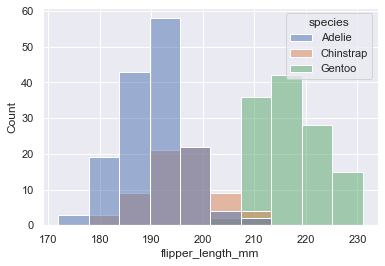

In [3]:
sns.set()
sns.histplot(data=penguins, x='flipper_length_mm', hue='species')

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Count'>

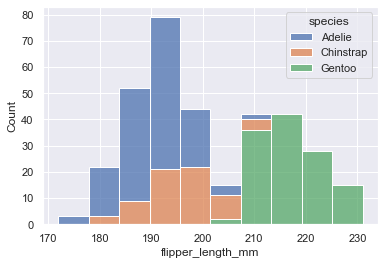

In [4]:
sns.histplot(data=penguins, x='flipper_length_mm', hue='species', multiple='stack')

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Density'>

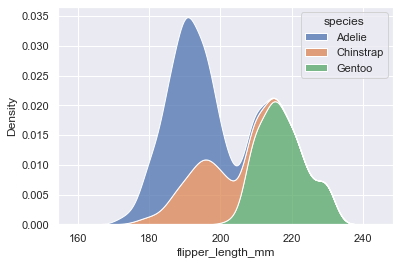

In [5]:
sns.kdeplot(data=penguins, x='flipper_length_mm', hue='species', multiple='stack')

### Figure-level vs. axes-level functions

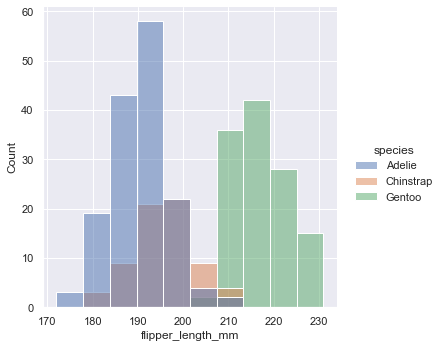

In [6]:
sns.displot(data=penguins, x='flipper_length_mm', hue='species')

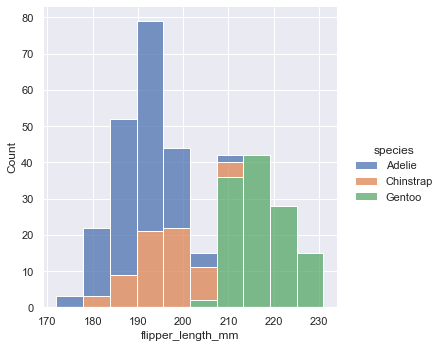

In [7]:
sns.displot(data=penguins, x='flipper_length_mm', hue='species', multiple='stack')

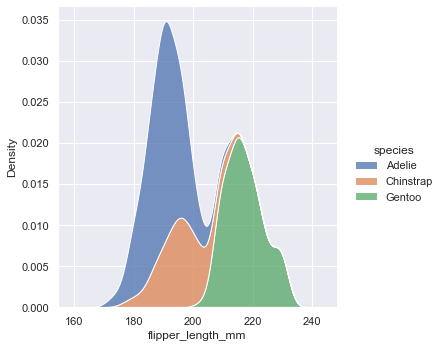

In [8]:
sns.displot(data=penguins, x='flipper_length_mm', hue='species', multiple='stack', kind='kde')

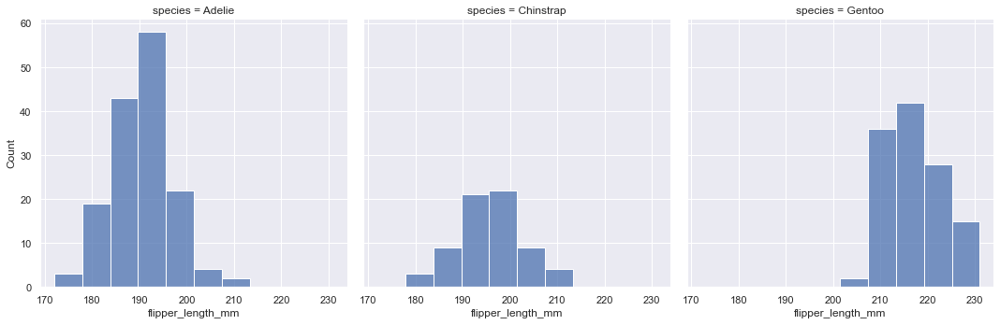

In [9]:
sns.displot(data=penguins, x='flipper_length_mm', col='species')

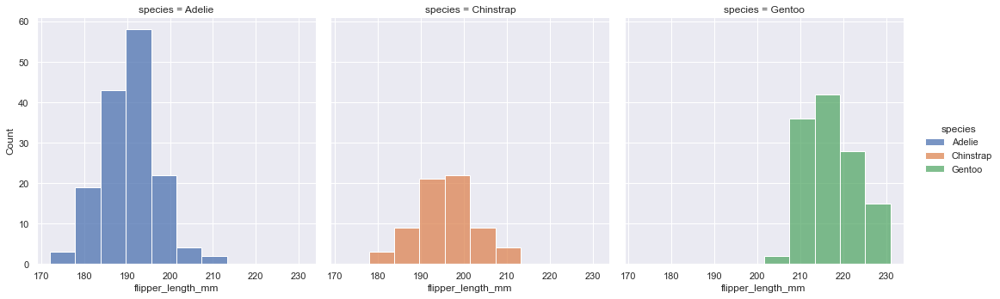

In [10]:
sns.displot(data=penguins, x='flipper_length_mm', hue='species', col='species')

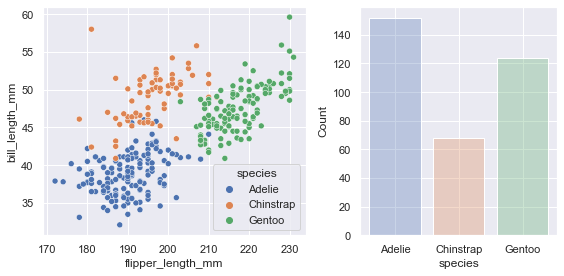

In [11]:
f, axs = plt.subplots(
    1, 2,                  # 차트 행, 열
    figsize=(8, 4),        # 전체 크기
    gridspec_kw=dict(width_ratios=[4, 3]) # 가로/세로 비율
)

sns.scatterplot(
    data=penguins,
    x='flipper_length_mm', # 연속형
    y='bill_length_mm',    # 연속형
    hue='species',         # 범주형
    ax=axs[0]              # 차트 위치
)

sns.histplot(
    data=penguins,
    x='species',           # 분포
    hue='species',         # 범주형
    shrink=.8,             # ??
    alpha=.3,              # 투명도
    legend=False,          # 범례
    ax=axs[1]              # 차트 위치
)

f.tight_layout()

In [12]:
tips = sns.load_dataset('tips')

In [13]:
tips

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4
...,...,...,...,...,...,...,...
239,29.03,5.92,Male,No,Sat,Dinner,3
240,27.18,2.00,Female,Yes,Sat,Dinner,2
241,22.67,2.00,Male,Yes,Sat,Dinner,2
242,17.82,1.75,Male,No,Sat,Dinner,2


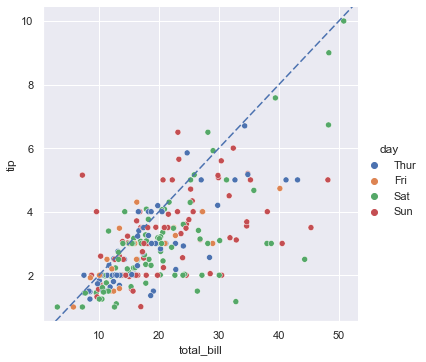

In [14]:
g = sns.relplot(    # default : scatter
    data=tips,      # data
    x='total_bill', # data.column
    y='tip',        # data.column
    hue='day'
)
g.ax.axline(       # 선 긋기
    xy1=(10, 2),   # x, y의 첫번째 축 값
    slope=.2,      # 기울기
    color='b',
    dashes=(5, 2), # 점선의 선과 공백의 비율
)

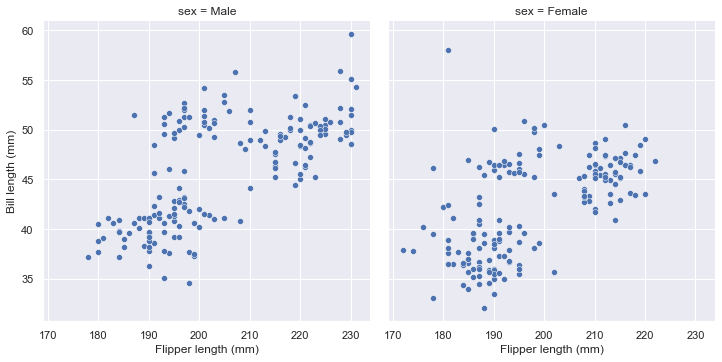

In [15]:
g = sns.relplot(
    data=penguins,
    x='flipper_length_mm',
    y='bill_length_mm',
    col='sex',
)
g.set_axis_labels("Flipper length (mm)", "Bill length (mm)")

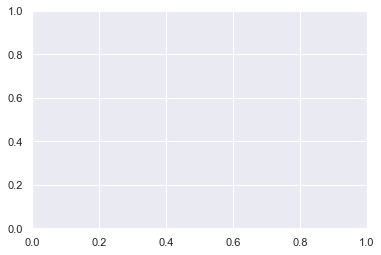

In [16]:
f, ax = plt.subplots()

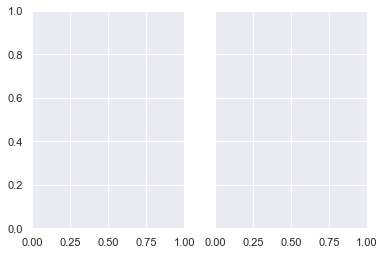

In [17]:
f, ax = plt.subplots(
    1, 2,        # 행, 렬
    sharey=True, # 축 공유
)

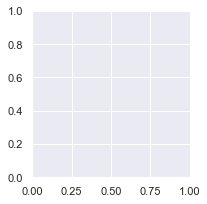

In [18]:
g = sns.FacetGrid(penguins)

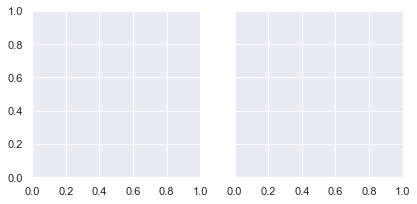

In [19]:
g = sns.FacetGrid(penguins, col='sex')

### Combining multiple views on the data

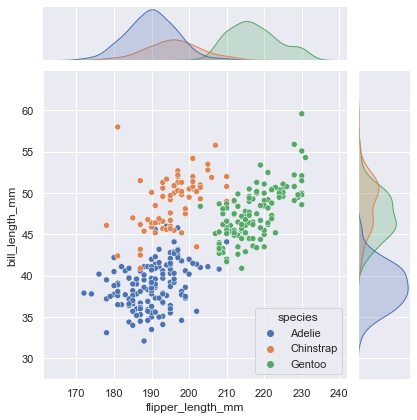

In [20]:
sns.jointplot(
    data=penguins,
    x='flipper_length_mm',
    y='bill_length_mm',
    hue='species'
)

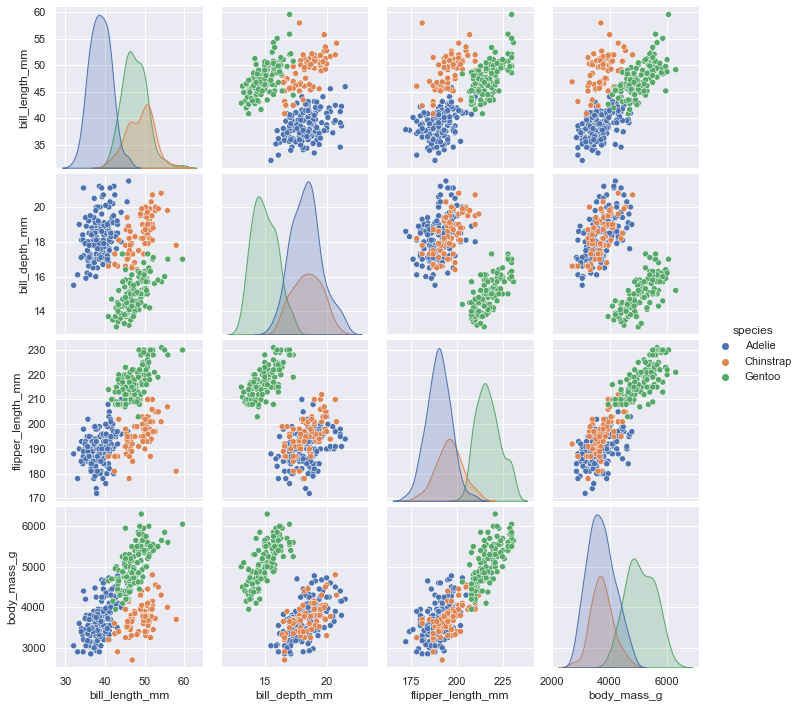

In [21]:
sns.pairplot(
    data=penguins,
    hue='species'
)

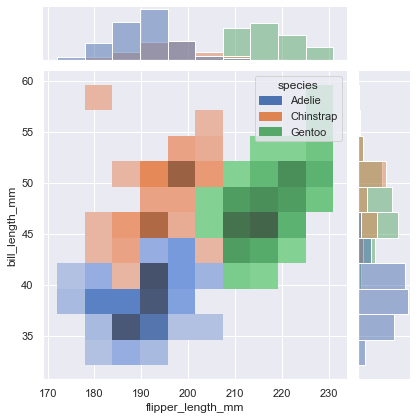

In [22]:
sns.jointplot(
    data=penguins,
    x='flipper_length_mm',
    y='bill_length_mm',
    hue='species',
    kind='hist'
)

## Data structures accepted by seaborn

### Long-form vs. wide-form data

In [23]:
flights = sns.load_dataset('flights')
flights.head()

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121


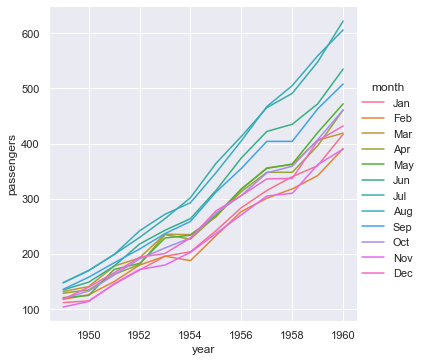

In [24]:
sns.relplot(
    data=flights,
    x='year',
    y='passengers',
    hue='month',
    kind='line'
)

In [25]:
flights_wide = flights.pivot(
    index='year',
    columns='month',
    values='passengers'
)
flights_wide.head()

month,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec
year,,,,,,,,,,,,
1949,112,118,132,129,121,135,148,148,136,119,104,118
1950,115,126,141,135,125,149,170,170,158,133,114,140
1951,145,150,178,163,172,178,199,199,184,162,146,166
1952,171,180,193,181,183,218,230,242,209,191,172,194
1953,196,196,236,235,229,243,264,272,237,211,180,201


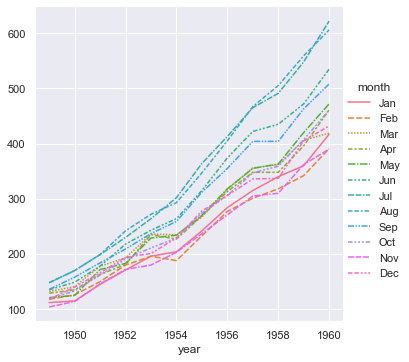

In [26]:
sns.relplot(
    data=flights_wide,
    kind='line'
)

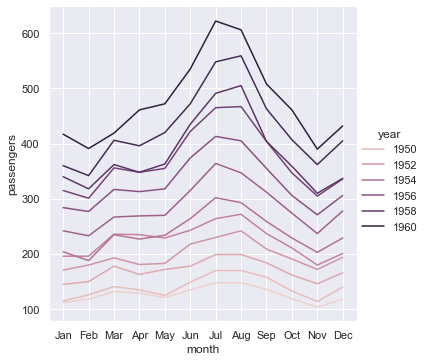

In [27]:
sns.relplot(
    data=flights,
    x='month',
    y='passengers',
    hue='year',
    kind='line',
)

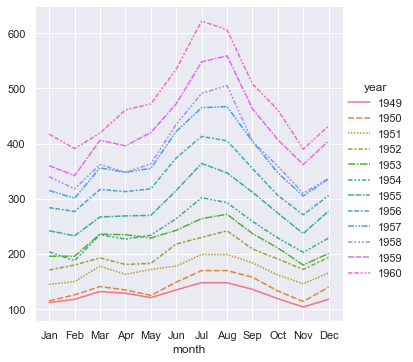

In [28]:
sns.relplot(
    data=flights_wide.transpose(),
    kind='line'
)

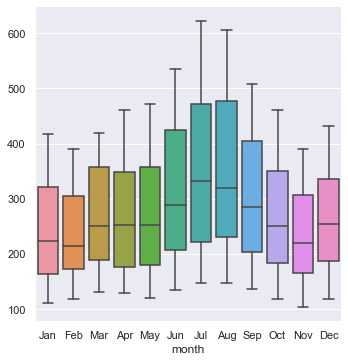

In [29]:
sns.catplot(
    data=flights_wide,
    kind='box'
)

In [30]:
anagrams = sns.load_dataset('anagrams')
anagrams

,subidr,attnr,num1,num2,num3
0,1,divided,2,4.0,7
1,2,divided,3,4.0,5
2,3,divided,3,5.0,6
3,4,divided,5,7.0,5
4,5,divided,4,5.0,8
5,6,divided,5,5.0,6
6,7,divided,5,4.5,6
7,8,divided,5,7.0,8
8,9,divided,2,3.0,7
9,10,divided,6,5.0,6


In [31]:
anagrams.melt()

,variable,value
0,subidr,1
1,subidr,2
2,subidr,3
3,subidr,4
4,subidr,5
...,...,...
95,num3,7
96,num3,6
97,num3,6
98,num3,6


In [32]:
anagrams_long = anagrams.melt(id_vars=['subidr', 'attnr'], var_name='solutions', value_name='score')
anagrams_long.head()

,subidr,attnr,solutions,score
0,1,divided,num1,2.0
1,2,divided,num1,3.0
2,3,divided,num1,3.0
3,4,divided,num1,5.0
4,5,divided,num1,4.0


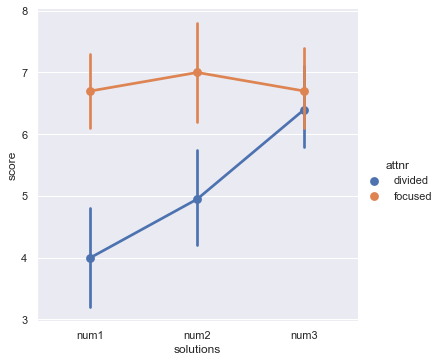

In [33]:
sns.catplot(
    data=anagrams_long,
    x='solutions',
    y='score',
    hue='attnr',
    kind='point',
)

### Options for visualizing long-form data

In [34]:
flights

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121
...,...,...,...
139,1960,Aug,606
140,1960,Sep,508
141,1960,Oct,461
142,1960,Nov,390


In [35]:
flights_dict = flights.to_dict(); flights_dict

{'year': {0: 1949,
  1: 1949,
  2: 1949,
  3: 1949,
  4: 1949,
  5: 1949,
  6: 1949,
  7: 1949,
  8: 1949,
  9: 1949,
  10: 1949,
  11: 1949,
  12: 1950,
  13: 1950,
  14: 1950,
  15: 1950,
  16: 1950,
  17: 1950,
  18: 1950,
  19: 1950,
  20: 1950,
  21: 1950,
  22: 1950,
  23: 1950,
  24: 1951,
  25: 1951,
  26: 1951,
  27: 1951,
  28: 1951,
  29: 1951,
  30: 1951,
  31: 1951,
  32: 1951,
  33: 1951,
  34: 1951,
  35: 1951,
  36: 1952,
  37: 1952,
  38: 1952,
  39: 1952,
  40: 1952,
  41: 1952,
  42: 1952,
  43: 1952,
  44: 1952,
  45: 1952,
  46: 1952,
  47: 1952,
  48: 1953,
  49: 1953,
  50: 1953,
  51: 1953,
  52: 1953,
  53: 1953,
  54: 1953,
  55: 1953,
  56: 1953,
  57: 1953,
  58: 1953,
  59: 1953,
  60: 1954,
  61: 1954,
  62: 1954,
  63: 1954,
  64: 1954,
  65: 1954,
  66: 1954,
  67: 1954,
  68: 1954,
  69: 1954,
  70: 1954,
  71: 1954,
  72: 1955,
  73: 1955,
  74: 1955,
  75: 1955,
  76: 1955,
  77: 1955,
  78: 1955,
  79: 1955,
  80: 1955,
  81: 1955,
  82: 1955,
  83: 

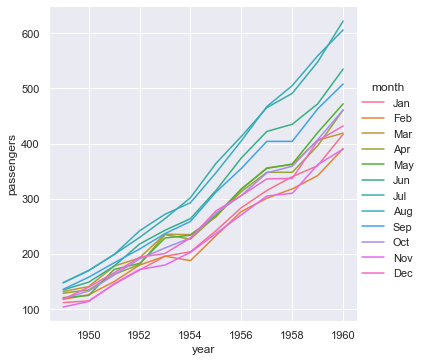

In [36]:
sns.relplot(
    data=flights_dict,
    x='year',
    y='passengers',
    hue='month',
    kind='line'
)

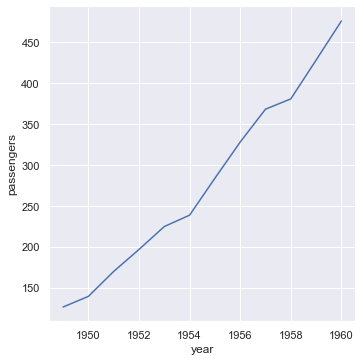

In [37]:
flights_avg = flights.groupby('year').mean()
sns.relplot(
    data=flights_avg,
    x='year',
    y='passengers',
    kind='line'
)

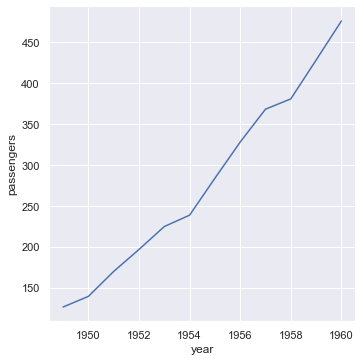

In [38]:
year = flights_avg.index
passengers = flights_avg['passengers']

sns.relplot(
    x=year,
    y=passengers,
    kind='line'
)

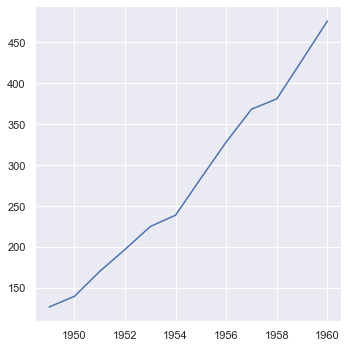

In [39]:
sns.relplot(
    x=year.to_numpy(),
    y=passengers.to_list(),
    kind='line'
)

### Options for visualizing wide-form data

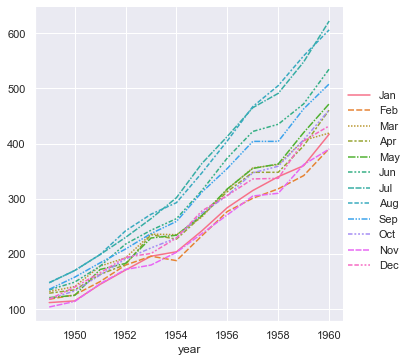

In [40]:
flights_wide_list = [col for _, col in flights_wide.items()]
sns.relplot(
    data=flights_wide_list,
    kind='line'
)

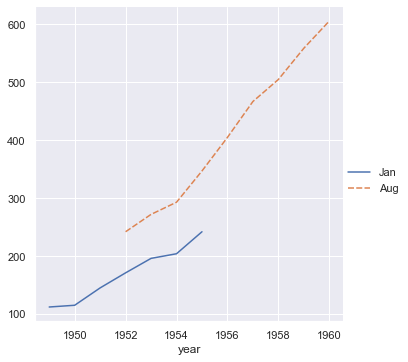

In [41]:
two_series = [flights_wide.loc[:1955, 'Jan'], flights_wide.loc[1952:, 'Aug']]
sns.relplot(
    data=two_series,
    kind='line'
)


In [42]:
[s.to_numpy() for s in two_series]

[array([112, 115, 145, 171, 196, 204, 242], dtype=int64),
 array([242, 272, 293, 347, 405, 467, 505, 559, 606], dtype=int64)]

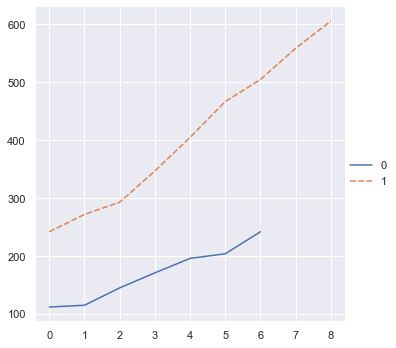

In [43]:
two_arrays = [s.to_numpy() for s in two_series]
sns.relplot(
    data=two_arrays,
    kind='line'
)

In [44]:
{s.name:s.to_numpy() for s in two_series}

{'Jan': array([112, 115, 145, 171, 196, 204, 242], dtype=int64),
 'Aug': array([242, 272, 293, 347, 405, 467, 505, 559, 606], dtype=int64)}

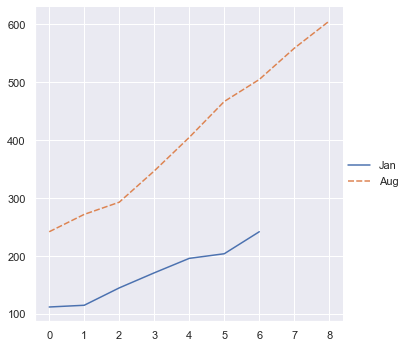

In [45]:
two_arrays_dict = {s.name:s.to_numpy() for s in two_series}
sns.relplot(
    data=two_arrays_dict,
    kind='line'
)

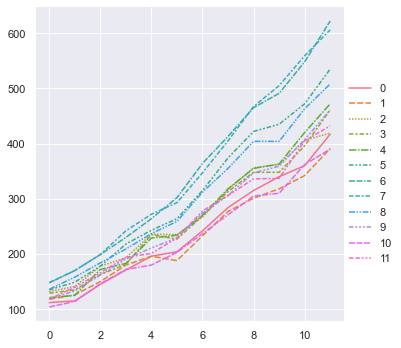

In [46]:
flights_array = flights_wide.to_numpy()
sns.relplot(data=flights_array, kind="line")

# plotting functions

## Visualizing statistical relationships

### Relating variables with scatter plots

In [47]:
sns.set_theme(style='darkgrid')

In [48]:
tips = sns.load_dataset('tips')
tips

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4
...,...,...,...,...,...,...,...
239,29.03,5.92,Male,No,Sat,Dinner,3
240,27.18,2.00,Female,Yes,Sat,Dinner,2
241,22.67,2.00,Male,Yes,Sat,Dinner,2
242,17.82,1.75,Male,No,Sat,Dinner,2


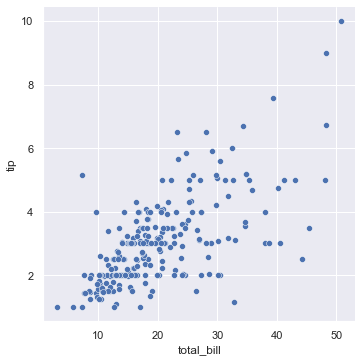

In [49]:
sns.relplot(
    x='total_bill',
    y='tip',
    data=tips
)

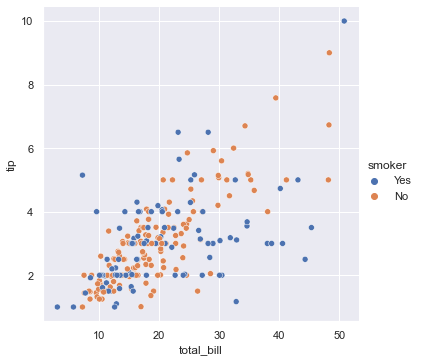

In [50]:
sns.relplot(
    x='total_bill',
    y='tip',
    hue='smoker',
    data=tips
)

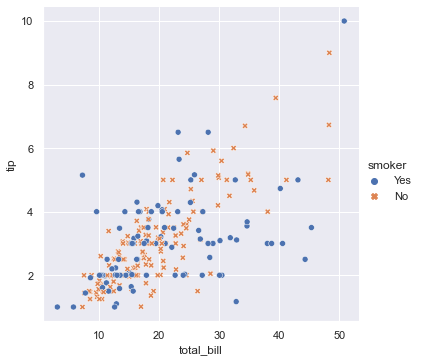

In [51]:
sns.relplot(
    x='total_bill',
    y='tip',
    hue='smoker',
    style='smoker',
    data=tips
)

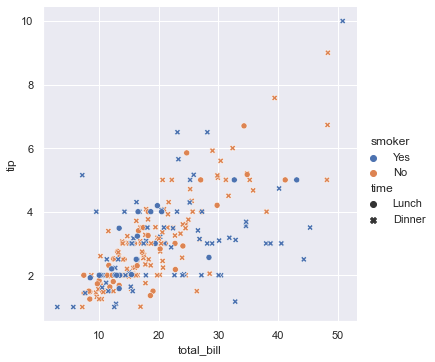

In [52]:
sns.relplot(
    x='total_bill',
    y='tip',
    hue='smoker',
    style='time',
    data=tips
)

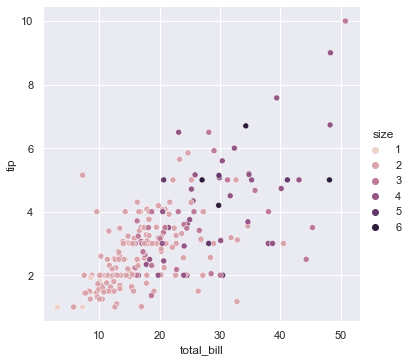

In [53]:
sns.relplot(
    x='total_bill',
    y='tip',
    hue='size',
    data=tips
)

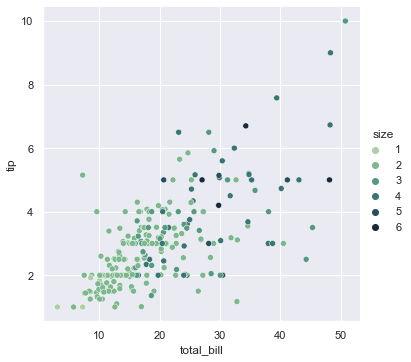

In [54]:
sns.relplot(
    x='total_bill',
    y='tip',
    hue='size', 
    palette='ch:r=-.5, l=.75', 
    data=tips,
)

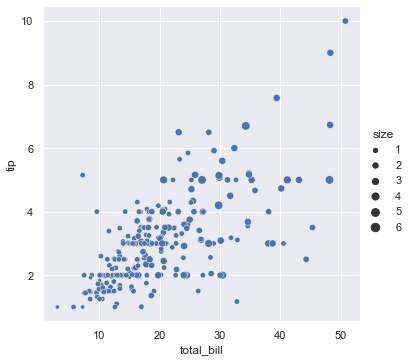

In [55]:
sns.relplot(
    x='total_bill', 
    y='tip', 
    size='size', 
    data=tips
)

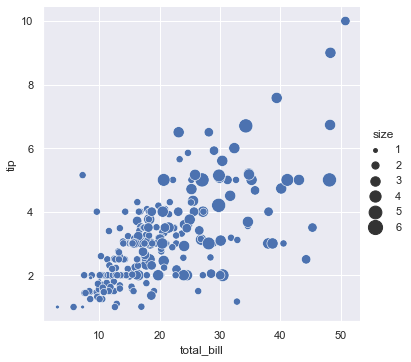

In [56]:
sns.relplot(
    x='total_bill', 
    y='tip', 
    size='size', 
    sizes=(15, 200), 
    data=tips
)

### Emphasizing continuity with line plots

In [57]:
df = pd.DataFrame(
    dict(
        time=np.arange(500), 
        value=np.random.randn(500).cumsum()
    )
)
df

,time,value
0,0,1.660821
1,1,0.606817
2,2,0.881091
3,3,0.090267
4,4,0.669674
...,...,...
495,495,29.153398
496,496,29.216324
497,497,27.598781
498,498,27.581182


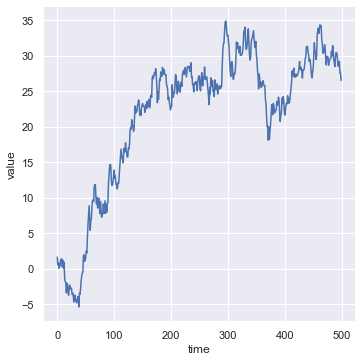

In [58]:
g = sns.relplot(
    x='time', 
    y='value', 
    kind='line', 
    data=df
)

In [59]:
df = pd.DataFrame(
    np.random.randn(500, 2).cumsum(axis=0),
    columns=['x', 'y']
)
df

,x,y
0,1.105921,0.952510
1,1.152134,1.121916
2,1.136195,2.320607
3,0.958142,3.886115
4,-0.563021,3.721485
...,...,...
495,11.332231,-16.867148
496,11.362886,-18.481238
497,11.412189,-19.868306
498,11.861780,-20.280833


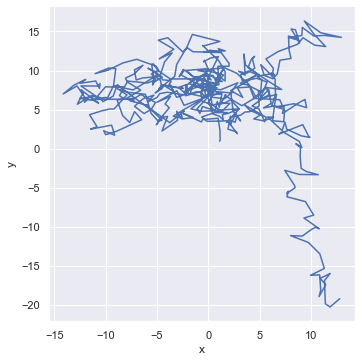

In [60]:
sns.relplot(
    x='x', 
    y='y', 
    sort=False, 
    kind='line', 
    data=df
)

In [61]:
fmri = sns.load_dataset('fmri')
fmri

,subject,timepoint,event,region,signal
0,s13,18,stim,parietal,-0.017552
1,s5,14,stim,parietal,-0.080883
2,s12,18,stim,parietal,-0.081033
3,s11,18,stim,parietal,-0.046134
4,s10,18,stim,parietal,-0.037970
...,...,...,...,...,...
1059,s0,8,cue,frontal,0.018165
1060,s13,7,cue,frontal,-0.029130
1061,s12,7,cue,frontal,-0.004939
1062,s11,7,cue,frontal,-0.025367


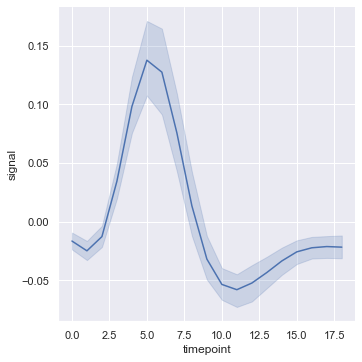

In [62]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    kind='line', 
    data=fmri
)

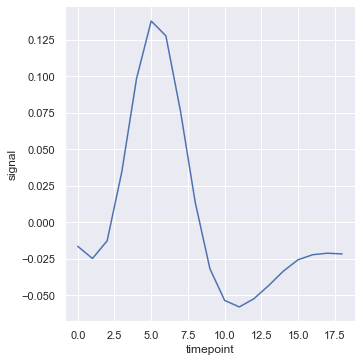

In [63]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    ci=None,
    kind='line', 
    data=fmri
)

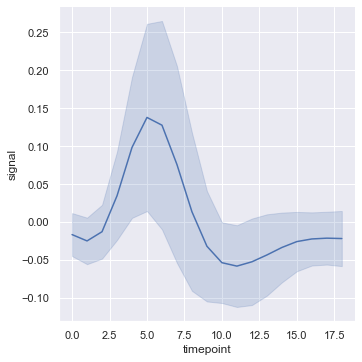

In [64]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    ci='sd',
    kind='line', 
    data=fmri
)

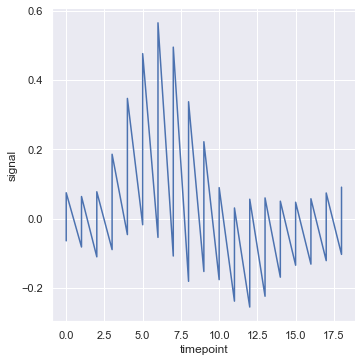

In [65]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    estimator=None,
    kind='line', 
    data=fmri
)

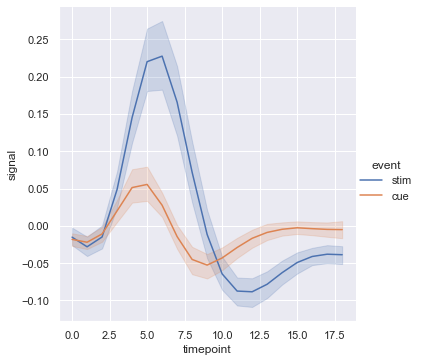

In [66]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    hue='event', 
    kind='line', 
    data=fmri
)

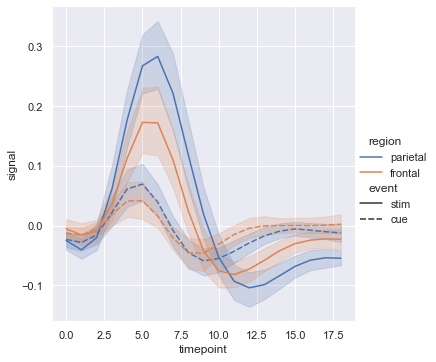

In [67]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    hue='region', 
    style='event', 
    kind='line', 
    data=fmri
)

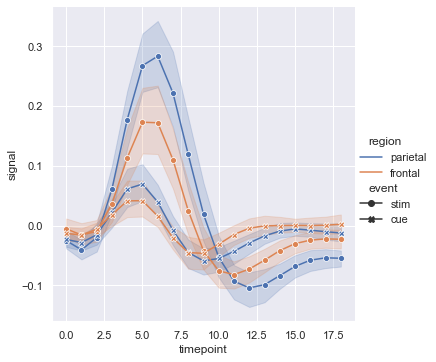

In [68]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    hue='region', 
    style='event', 
    dashes=False, 
    markers=True, 
    kind='line', 
    data=fmri
)

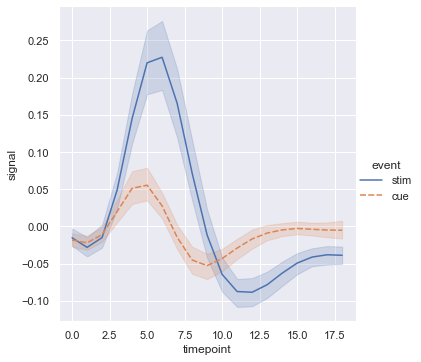

In [69]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    hue='event', 
    style='event', 
    kind='line', 
    data=fmri
)

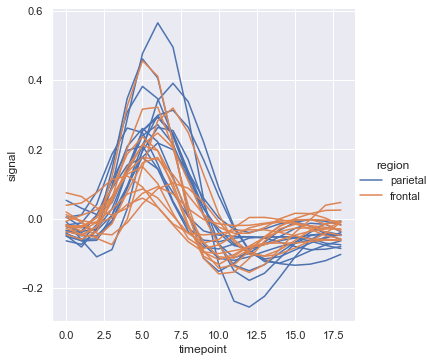

In [70]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    hue='region', 
    units='subject', 
    estimator=None, 
    kind='line', 
    data=fmri.query('event == "stim"')
)

In [71]:
dots = sns.load_dataset("dots").query("align == 'dots'")
dots

,align,choice,time,coherence,firing_rate
0,dots,T1,-80,0.0,33.189967
1,dots,T1,-80,3.2,31.691726
2,dots,T1,-80,6.4,34.279840
3,dots,T1,-80,12.8,32.631874
4,dots,T1,-80,25.6,35.060487
...,...,...,...,...,...
389,dots,T2,680,3.2,37.806267
390,dots,T2,700,0.0,43.464959
391,dots,T2,700,3.2,38.994559
392,dots,T2,720,0.0,41.987121


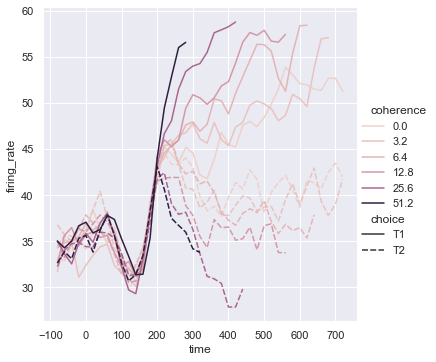

In [72]:
sns.relplot(
    x='time', 
    y='firing_rate', 
    hue='coherence', 
    style='choice', 
    kind='line', 
    data=dots
)

In [73]:
palette = sns.cubehelix_palette(light=.8, n_colors=6)
palette

[[0.9072879094300372, 0.7554704536803714, 0.7462376322879748],
 [0.8285819344135655, 0.5939685136446344, 0.6506580690069503],
 [0.7112429433992273, 0.44706244471928347, 0.582154114273226],
 [0.5475925095088021, 0.3183394743439307, 0.5067755143579389],
 [0.3615667891876727, 0.2135460683528729, 0.39972110388915943],
 [0.1750865648952205, 0.11840023306916837, 0.24215989137836502]]

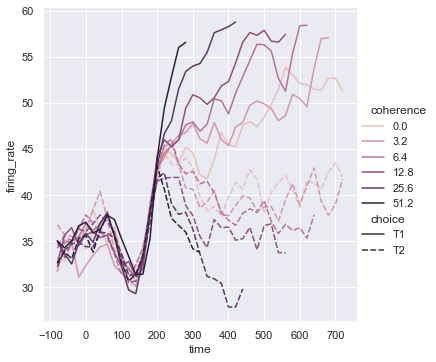

In [74]:
sns.relplot(
    x='time', 
    y='firing_rate', 
    hue='coherence', 
    style='choice', 
    palette=palette, 
    kind='line', 
    data=dots
)

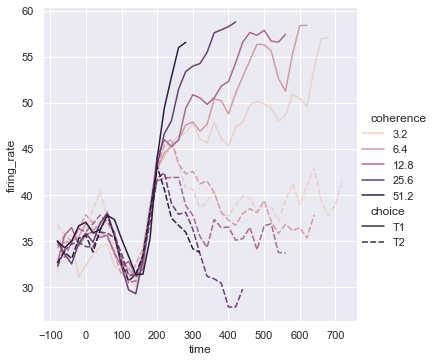

In [75]:
from matplotlib.colors import LogNorm
palette = sns.cubehelix_palette(light=.7, n_colors=6)
sns.relplot(x="time", y="firing_rate",
            hue="coherence", style="choice",
            hue_norm=LogNorm(),
            kind="line",
            data=dots.query("coherence > 0"));

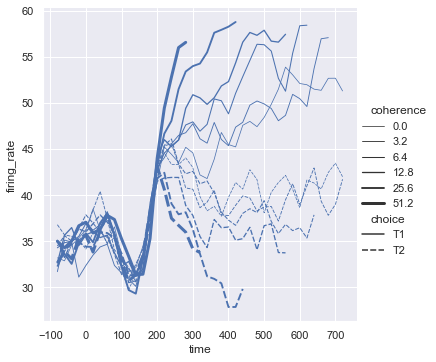

In [76]:
sns.relplot(x="time", y="firing_rate",
            size="coherence", style="choice",
            kind="line", data=dots);

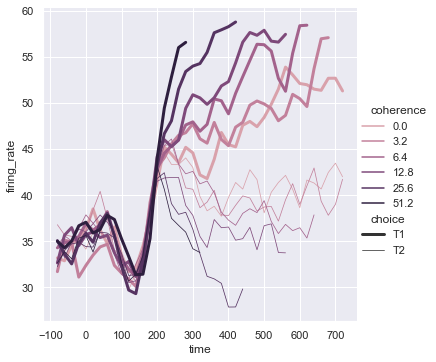

In [77]:
sns.relplot(x="time", y="firing_rate",
           hue="coherence", size="choice",
           palette=palette,
           kind="line", data=dots);

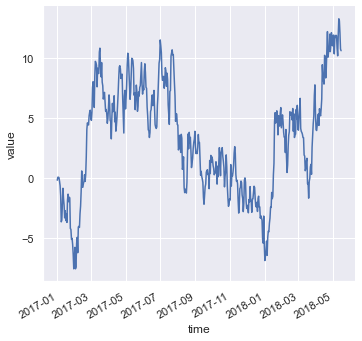

In [78]:
df = pd.DataFrame(dict(time=pd.date_range("2017-1-1", periods=500),
                       value=np.random.randn(500).cumsum()))
g = sns.relplot(x="time", y="value", kind="line", data=df)
g.fig.autofmt_xdate()

### Showing multiple relationships with facets

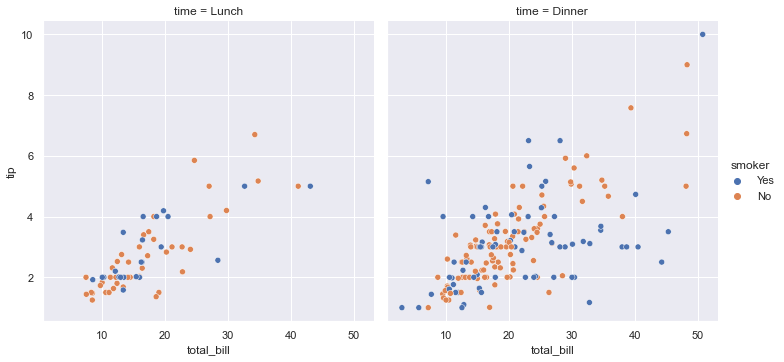

In [79]:
sns.relplot(
    x='total_bill', 
    y='tip', 
    hue='smoker', 
    col='time', 
    data=tips
)

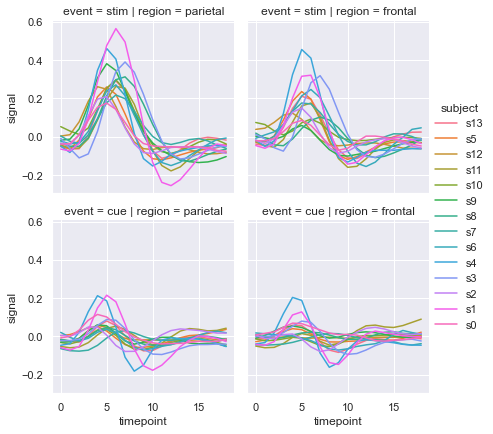

In [80]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    hue='subject', 
    row='event', 
    col='region', 
    height=3, 
    # aspect=4, 
    kind='line', 
    estimator=None, 
    data=fmri
)

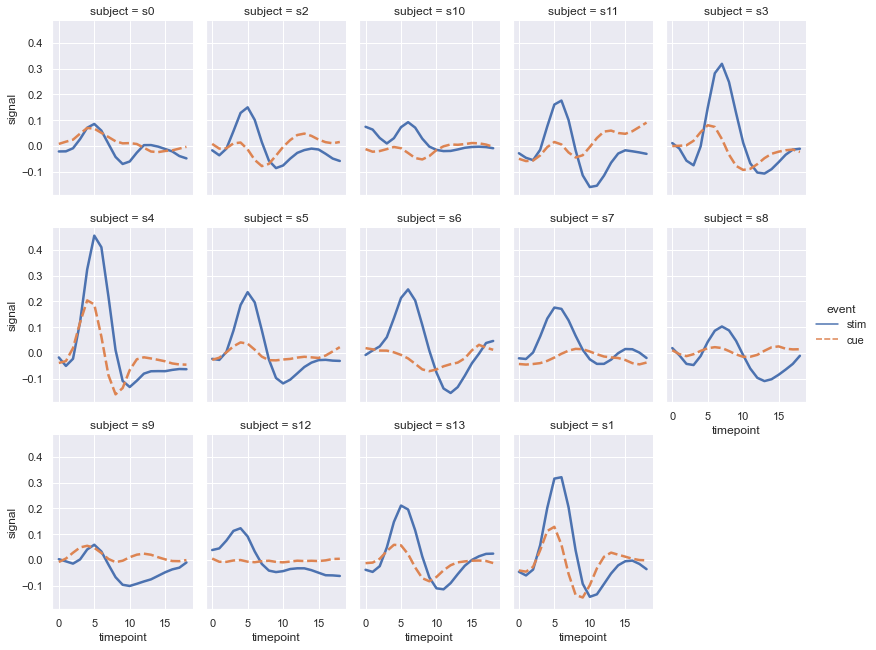

In [81]:
sns.relplot(
    x='timepoint', 
    y='signal', 
    hue='event', 
    style='event', 
    col='subject', 
    col_wrap=5,
    height=3, 
    aspect=.75, 
    linewidth=2.5, 
    kind='line', 
    data=fmri.query("region == 'frontal'")
)

## Visualizing distributions of data

### Plotting univariate histograms

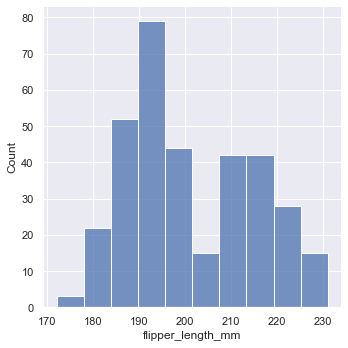

In [82]:
sns.displot(penguins, x='flipper_length_mm')

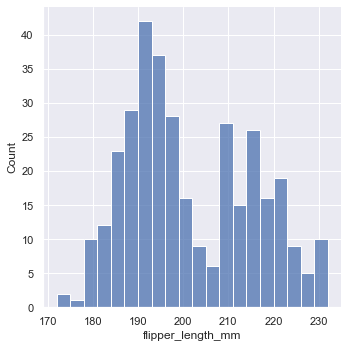

In [83]:
sns.displot(penguins, x='flipper_length_mm', 
            binwidth=3)

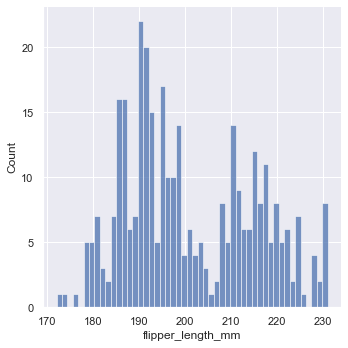

In [84]:
sns.displot(penguins, x='flipper_length_mm',
            bins=50)

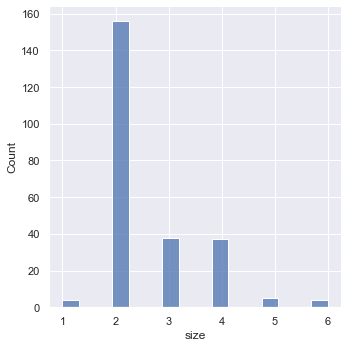

In [85]:
sns.displot(tips, x='size')

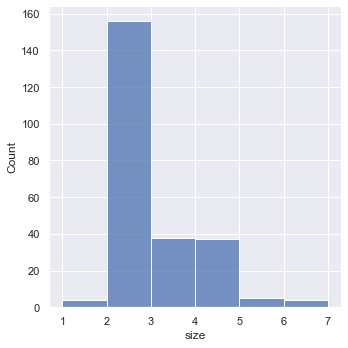

In [86]:
sns.displot(tips, x='size', bins=[1, 2, 3, 4, 5, 6, 7])

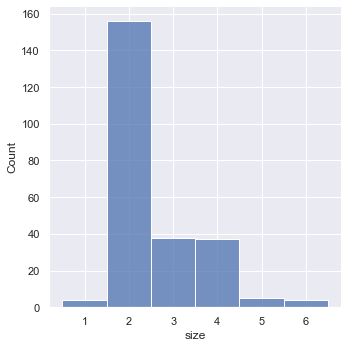

In [87]:
sns.displot(tips, x='size', discrete=True)

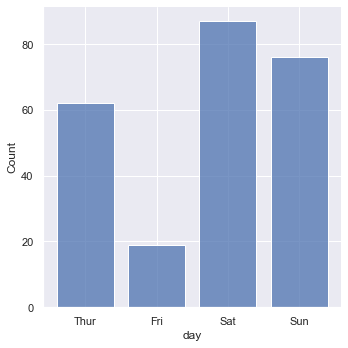

In [88]:
sns.displot(tips, x='day', shrink=.8)

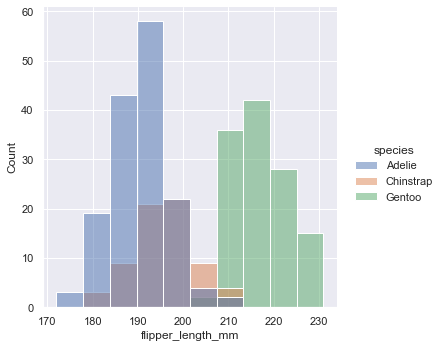

In [89]:
sns.displot(penguins, x='flipper_length_mm', hue='species')

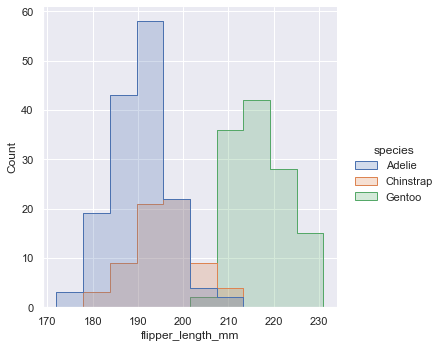

In [90]:
sns.displot(penguins, x='flipper_length_mm', hue='species', element='step')

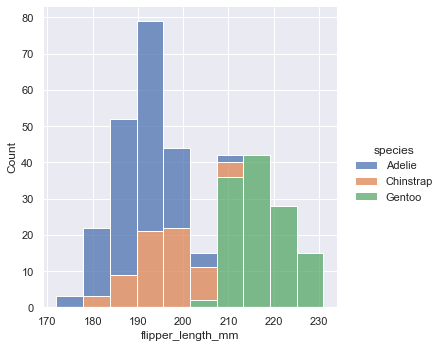

In [91]:
sns.displot(penguins, x='flipper_length_mm', hue='species', multiple='stack')

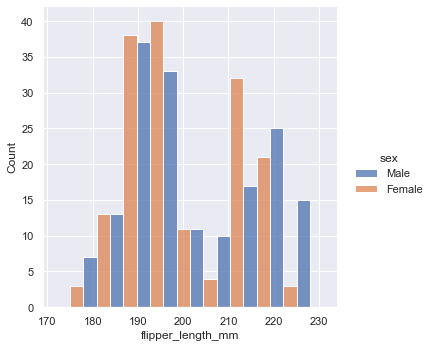

In [92]:
sns.displot(
    penguins, 
    x='flipper_length_mm', 
    hue='sex', 
    multiple='dodge'
)

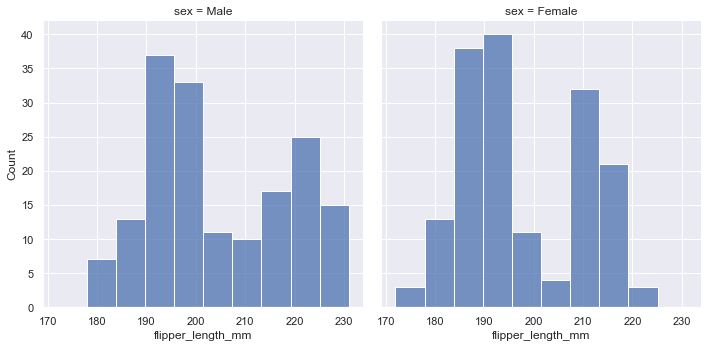

In [93]:
sns.displot(penguins, x='flipper_length_mm', col='sex')

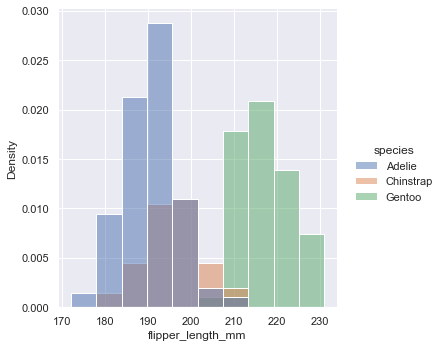

In [94]:
sns.displot(
    penguins, 
    x='flipper_length_mm', 
    stat='density', 
    hue='species', 
)

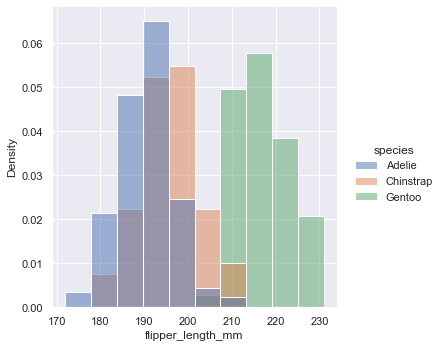

In [95]:
sns.displot(
    penguins, 
    x='flipper_length_mm', 
    stat='density', 
    hue='species', 
    common_norm=False, 
)

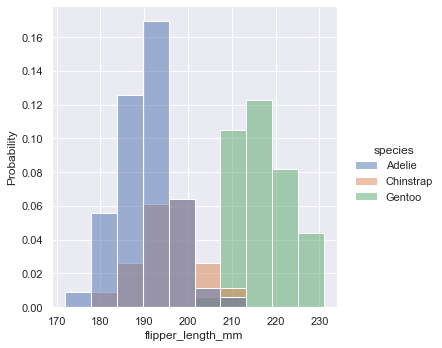

In [96]:
sns.displot(
    penguins, 
    x='flipper_length_mm', 
    stat='probability', 
    hue='species', 
)

### Kernel density estimation

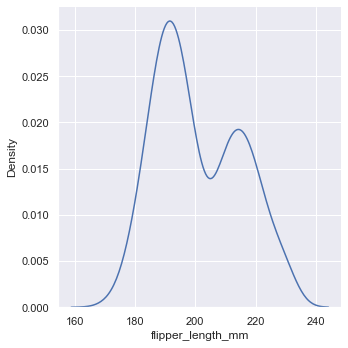

In [97]:
sns.displot(penguins, x='flipper_length_mm', kind='kde')

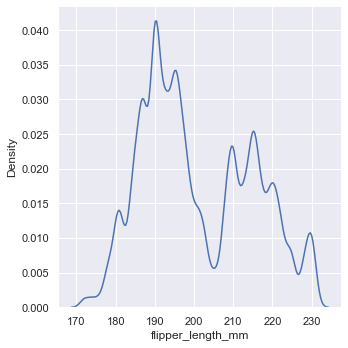

In [98]:
sns.displot(penguins, x='flipper_length_mm', kind='kde', bw_adjust=.25)

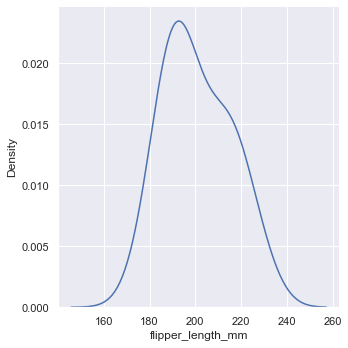

In [99]:
sns.displot(penguins, x='flipper_length_mm', kind='kde', bw_adjust=2)

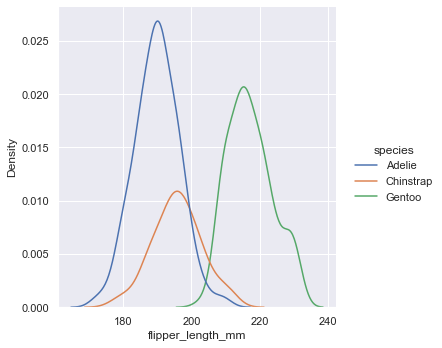

In [100]:
sns.displot(penguins, x='flipper_length_mm', kind='kde', hue='species')

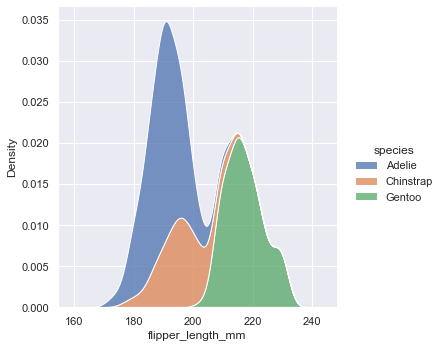

In [101]:
sns.displot(penguins, x='flipper_length_mm', kind='kde', hue='species', multiple='stack')

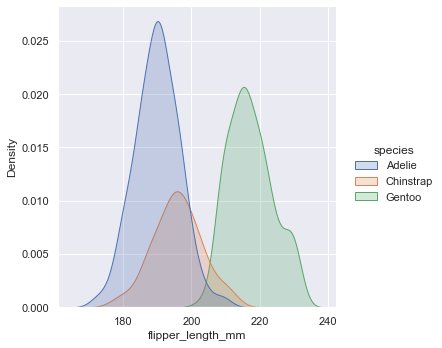

In [102]:
sns.displot(penguins, x='flipper_length_mm', kind='kde', hue='species', fill=True)

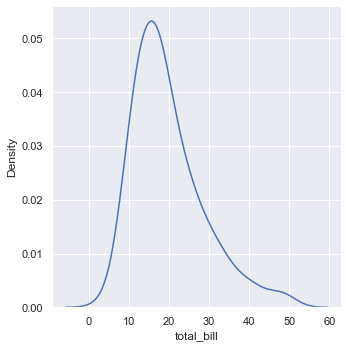

In [103]:
sns.displot(tips, x='total_bill', kind='kde')

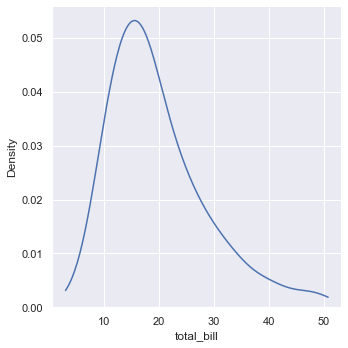

In [104]:
sns.displot(tips, x='total_bill', kind='kde', cut=0)

In [105]:
diamonds = sns.load_dataset('diamonds')
diamonds

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


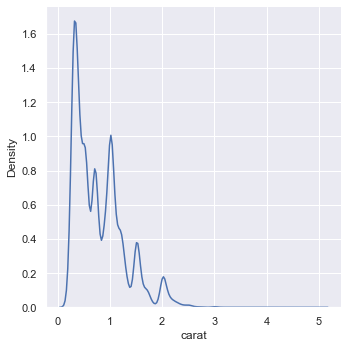

In [106]:
sns.displot(diamonds, x='carat', kind='kde')

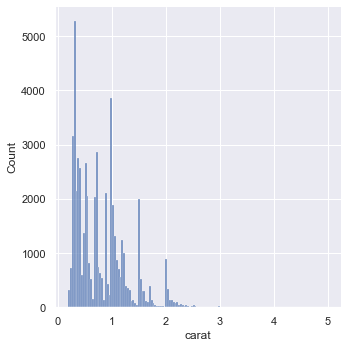

In [107]:
sns.displot(diamonds, x='carat')

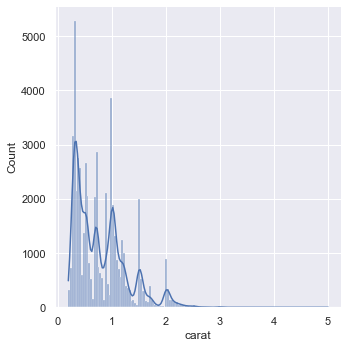

In [108]:
sns.displot(diamonds, x='carat', kde=True)

### Empirical cumulative distributions

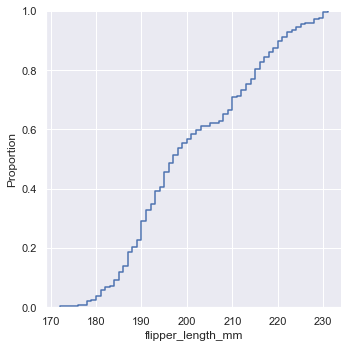

In [109]:
sns.displot(penguins, x='flipper_length_mm', kind='ecdf')

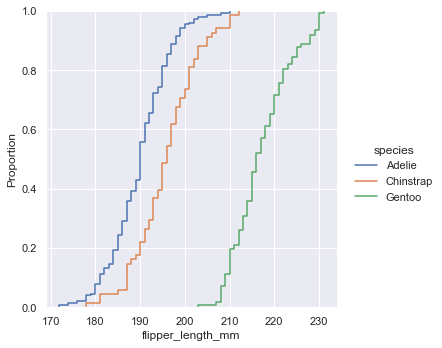

In [110]:
sns.displot(penguins, x='flipper_length_mm', kind='ecdf', hue='species')

### Visualizing bivariate distributions

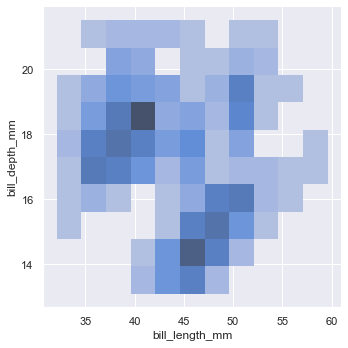

In [111]:
sns.displot(penguins, x='bill_length_mm', y='bill_depth_mm')

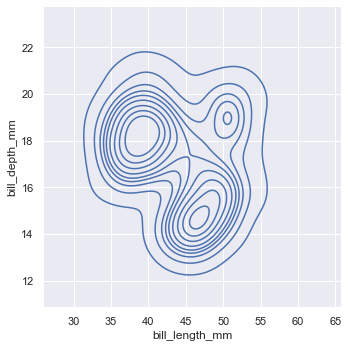

In [112]:
sns.displot(penguins, x='bill_length_mm', y='bill_depth_mm', kind='kde')

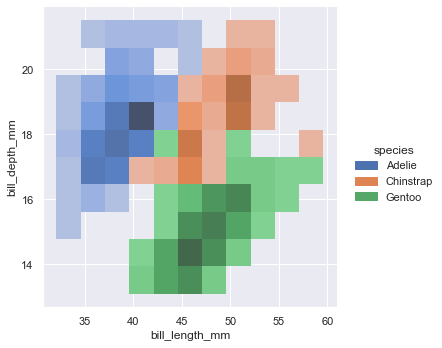

In [113]:
sns.displot(penguins, x='bill_length_mm', y='bill_depth_mm', hue='species')

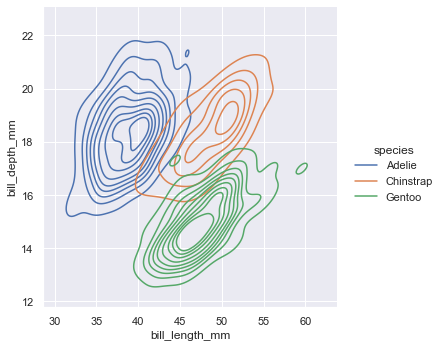

In [114]:
sns.displot(penguins, x='bill_length_mm', y='bill_depth_mm', hue='species', kind='kde')

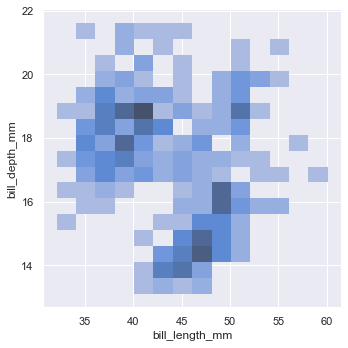

In [115]:
sns.displot(
    penguins, 
    x='bill_length_mm', 
    y='bill_depth_mm', 
    binwidth=(2, .5)
)

### Distribution visualization in other settings

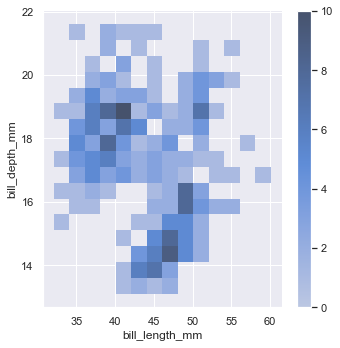

In [116]:
sns.displot(
    penguins, 
    x='bill_length_mm', 
    y='bill_depth_mm', 
    binwidth=(2, .5), 
    cbar=True
)

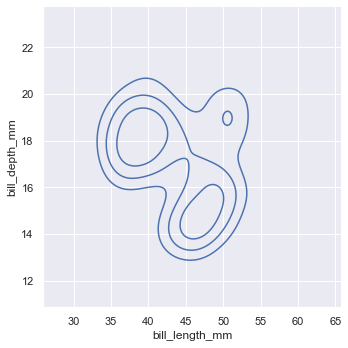

In [117]:
sns.displot(
    penguins, 
    x='bill_length_mm', 
    y='bill_depth_mm', 
    kind='kde', 
    thresh=.2, 
    levels=4, 
)

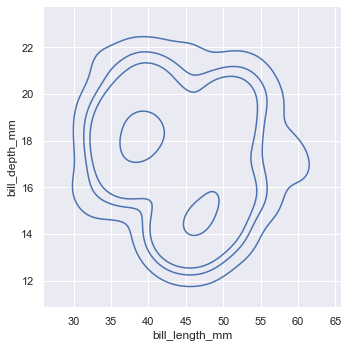

In [118]:
sns.displot(
    penguins, 
    x='bill_length_mm', 
    y='bill_depth_mm', 
    kind='kde', 
    levels=[.01, .05, .1, .8]
)

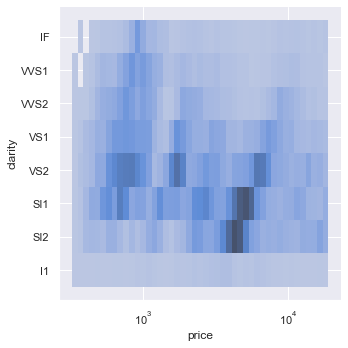

In [119]:
sns.displot(
    diamonds, 
    x='price', 
    y='clarity', 
    log_scale=(True, False)
)

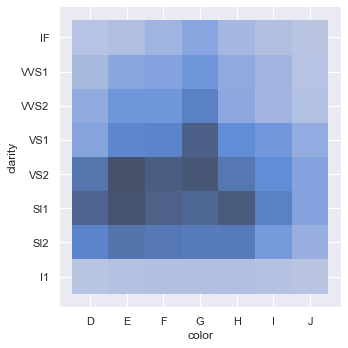

In [120]:
sns.displot(diamonds, x='color', y='clarity')

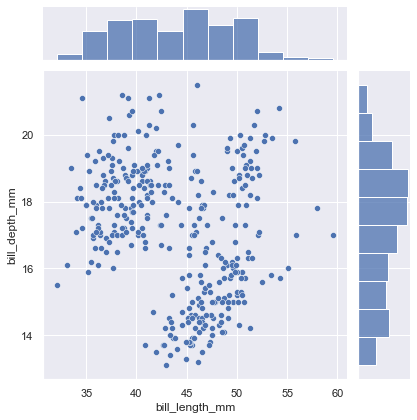

In [121]:
sns.jointplot(data=penguins, x='bill_length_mm', y='bill_depth_mm')

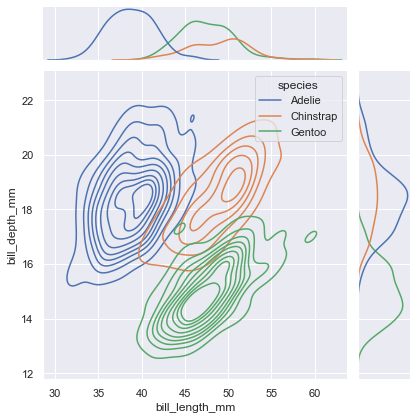

In [122]:
sns.jointplot(
    data=penguins, 
    x='bill_length_mm', 
    y='bill_depth_mm', 
    hue='species', 
    kind='kde'
)

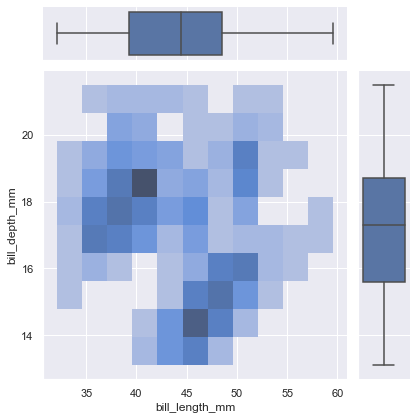

In [123]:
g = sns.JointGrid(data=penguins, x='bill_length_mm', y='bill_depth_mm')
g.plot_joint(sns.histplot)
g.plot_marginals(sns.boxplot)

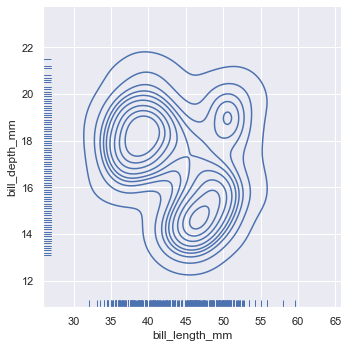

In [124]:
sns.displot(
    penguins, 
    x='bill_length_mm', 
    y='bill_depth_mm', 
    kind='kde', 
    rug=True
)

<AxesSubplot:xlabel='bill_length_mm', ylabel='bill_depth_mm'>

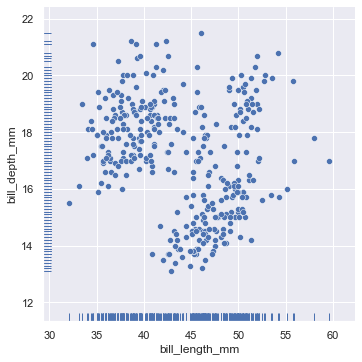

In [125]:
sns.relplot(data=penguins, x='bill_length_mm', y='bill_depth_mm')
sns.rugplot(data=penguins, x='bill_length_mm', y='bill_depth_mm')

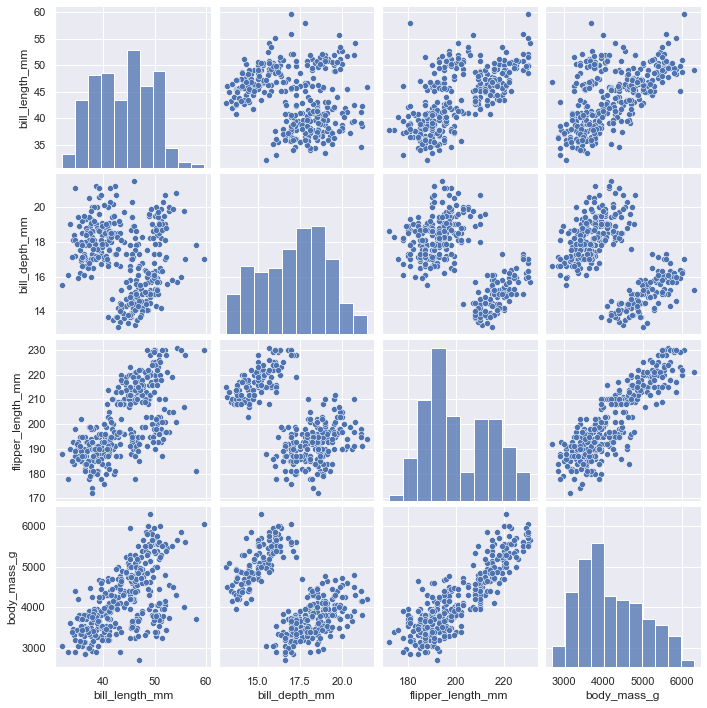

In [126]:
sns.pairplot(penguins)

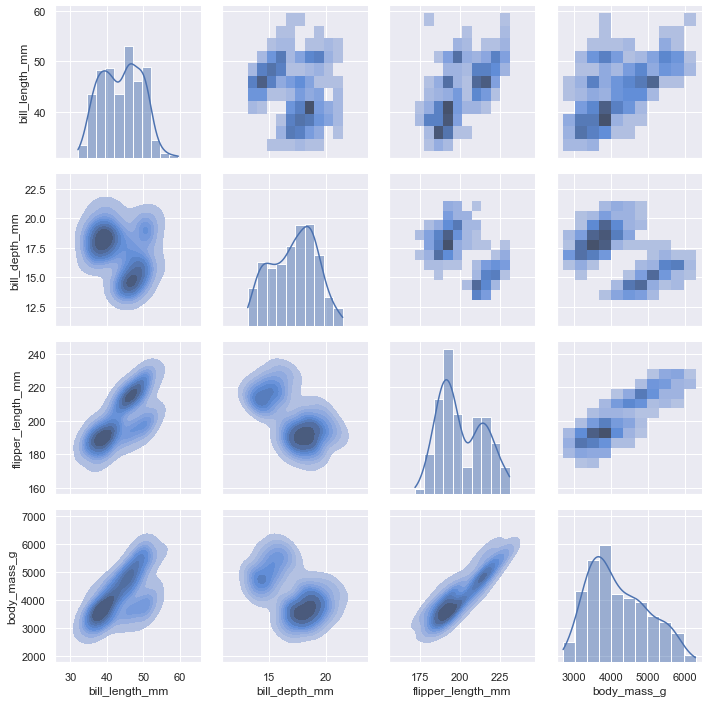

In [127]:
g = sns.PairGrid(penguins)
g.map_upper(sns.histplot)
g.map_lower(sns.kdeplot, fill=True)
g.map_diag(sns.histplot, kde=True)

## Plotting with categorical data

### Categorical scatterplots

In [128]:
tips

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4
...,...,...,...,...,...,...,...
239,29.03,5.92,Male,No,Sat,Dinner,3
240,27.18,2.00,Female,Yes,Sat,Dinner,2
241,22.67,2.00,Male,Yes,Sat,Dinner,2
242,17.82,1.75,Male,No,Sat,Dinner,2


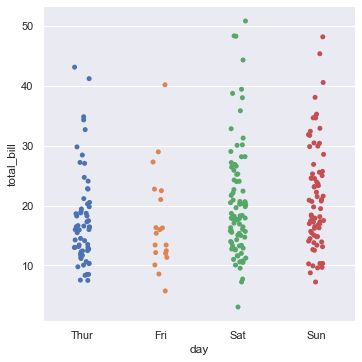

In [129]:
sns.catplot(
    x='day', 
    y='total_bill', 
    data=tips
)

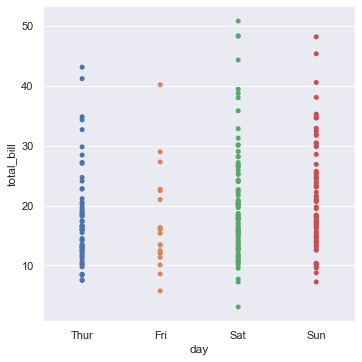

In [130]:
sns.catplot(
    x='day', 
    y='total_bill', 
    jitter=False, 
    data=tips
)

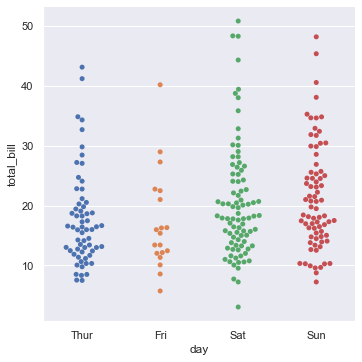

In [131]:
sns.catplot(
    x='day', 
    y='total_bill', 
    kind='swarm', 
    data=tips
)

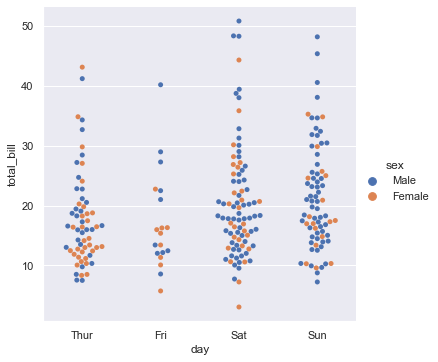

In [132]:
sns.catplot(
    x='day', 
    y='total_bill', 
    hue='sex', 
    kind='swarm', 
    data=tips
)

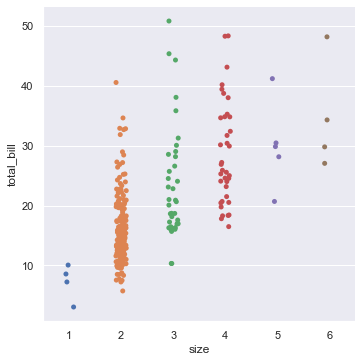

In [133]:
sns.catplot(
    x='size', 
    y='total_bill', 
    data=tips
)

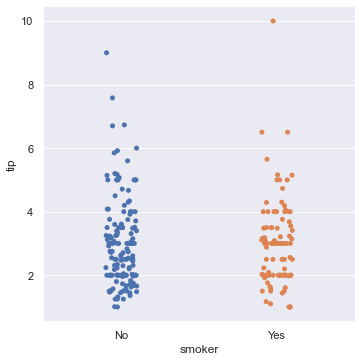

In [134]:
sns.catplot(
    x='smoker', 
    y='tip', 
    order=['No', 'Yes'], 
    data=tips
)

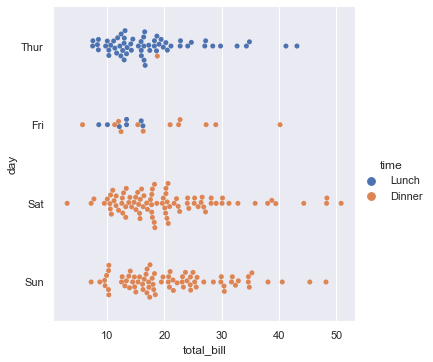

In [135]:
sns.catplot(
    x='total_bill', 
    y='day', 
    hue='time', 
    kind='swarm', 
    data=tips
)

### Distributions of observations within categories

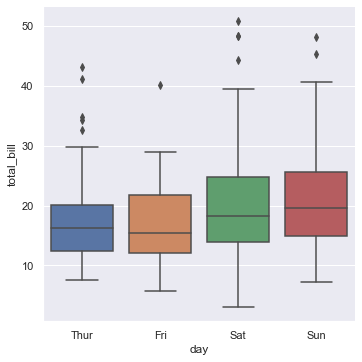

In [136]:
sns.catplot(
    x='day', 
    y='total_bill', 
    kind='box', 
    data=tips
)

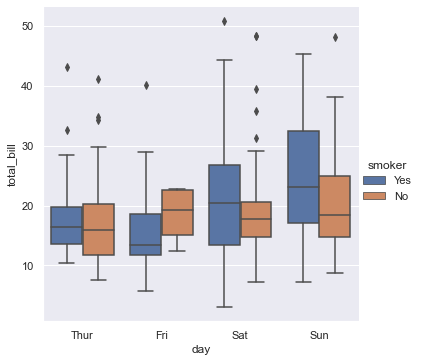

In [137]:
sns.catplot(
    x='day', 
    y='total_bill', 
    hue='smoker', 
    kind='box', 
    data=tips
)

In [138]:
tips['weekend'] = tips['day'].isin(['Sat', 'Sun'])
tips

,total_bill,tip,sex,smoker,day,time,size,weekend
0,16.99,1.01,Female,No,Sun,Dinner,2,True
1,10.34,1.66,Male,No,Sun,Dinner,3,True
2,21.01,3.50,Male,No,Sun,Dinner,3,True
3,23.68,3.31,Male,No,Sun,Dinner,2,True
4,24.59,3.61,Female,No,Sun,Dinner,4,True
...,...,...,...,...,...,...,...,...
239,29.03,5.92,Male,No,Sat,Dinner,3,True
240,27.18,2.00,Female,Yes,Sat,Dinner,2,True
241,22.67,2.00,Male,Yes,Sat,Dinner,2,True
242,17.82,1.75,Male,No,Sat,Dinner,2,True


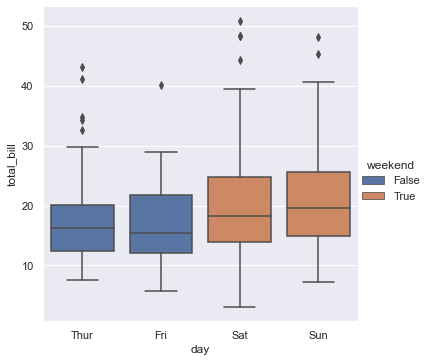

In [139]:
sns.catplot(
    x='day', 
    y='total_bill', 
    hue='weekend', 
    kind='box', 
    dodge=False, 
    data=tips
)

In [140]:
diamonds

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


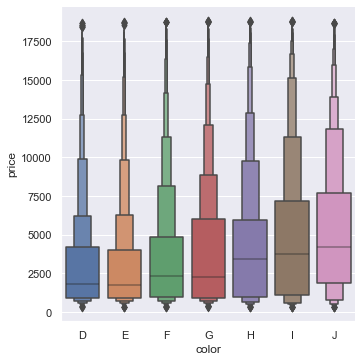

In [141]:
sns.catplot(
    x='color', 
    y='price', 
    kind='boxen', 
    data=diamonds.sort_values('color')
)

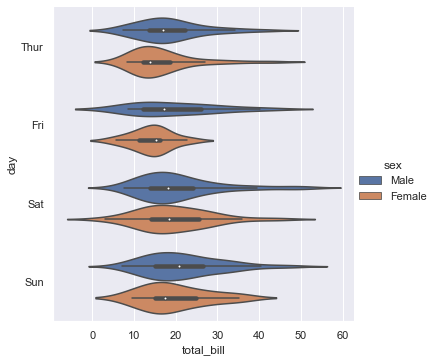

In [142]:
sns.catplot(
    x='total_bill', 
    y='day', 
    hue='sex', 
    kind='violin', 
    data=tips
)

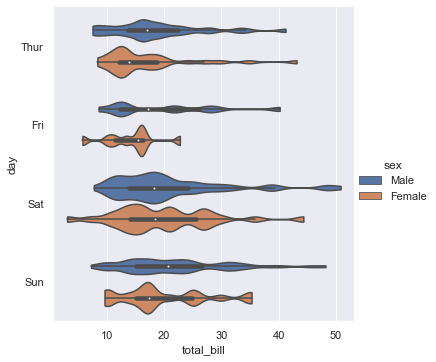

In [143]:
sns.catplot(
    x='total_bill', 
    y='day', 
    hue='sex', 
    kind='violin', 
    bw=.15, 
    cut=0, 
    data=tips
)

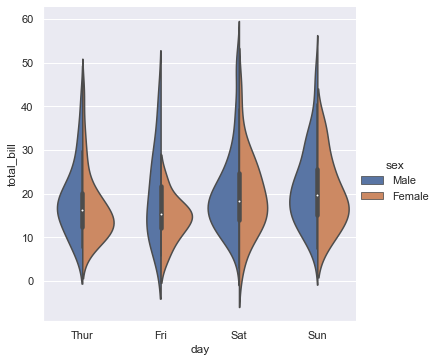

In [144]:
sns.catplot(
    x='day', 
    y='total_bill', 
    hue='sex', 
    kind='violin',
    split=True,  
    data=tips
)

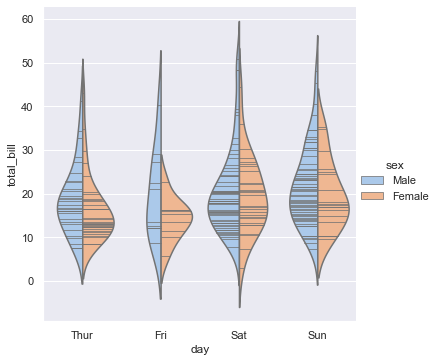

In [145]:
sns.catplot(
    x='day', 
    y='total_bill', 
    hue='sex', 
    kind='violin',
    inner='stick', 
    split=True, 
    palette='pastel', 
    data=tips
)

<AxesSubplot:xlabel='day', ylabel='total_bill'>

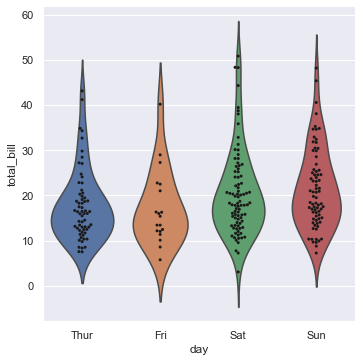

In [146]:
g = sns.catplot(x='day', y='total_bill', kind='violin', inner=None, data=tips)
sns.swarmplot(x='day', y='total_bill', color='k', size=3, data=tips, ax=g.ax)

### Statistical estimation within categories

In [147]:
titanic = sns.load_dataset('titanic')
titanic

,survived,pclass,sex,age,sibsp,parch,fare,embarked,class,who,adult_male,deck,embark_town,alive,alone
0,0,3,male,22.0,1,0,7.2500,S,Third,man,True,NaN,Southampton,no,False
1,1,1,female,38.0,1,0,71.2833,C,First,woman,False,C,Cherbourg,yes,False
2,1,3,female,26.0,0,0,7.9250,S,Third,woman,False,NaN,Southampton,yes,True
3,1,1,female,35.0,1,0,53.1000,S,First,woman,False,C,Southampton,yes,False
4,0,3,male,35.0,0,0,8.0500,S,Third,man,True,NaN,Southampton,no,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
886,0,2,male,27.0,0,0,13.0000,S,Second,man,True,NaN,Southampton,no,True
887,1,1,female,19.0,0,0,30.0000,S,First,woman,False,B,Southampton,yes,True
888,0,3,female,NaN,1,2,23.4500,S,Third,woman,False,NaN,Southampton,no,False
889,1,1,male,26.0,0,0,30.0000,C,First,man,True,C,Cherbourg,yes,True


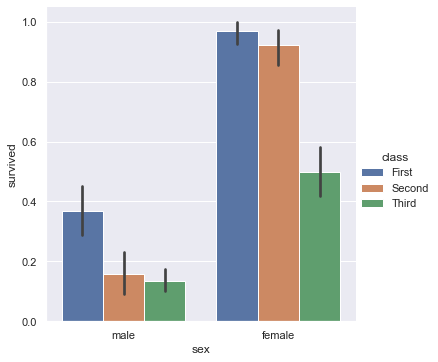

In [148]:
sns.catplot(x='sex', 
            y='survived', 
            kind='bar', 
            hue='class', 
            data=titanic)

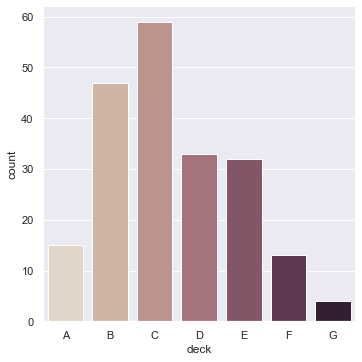

In [149]:
sns.catplot(x='deck', kind='count', palette='ch:.25', data=titanic)

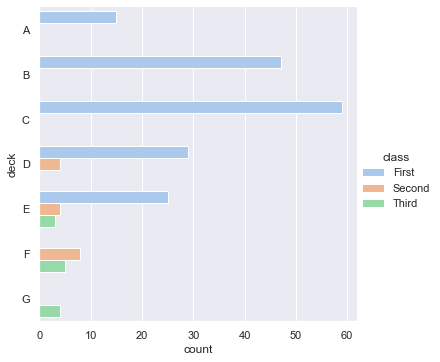

In [150]:
sns.catplot(
    y='deck', 
    hue='class', 
    kind='count',
    palette='pastel', 
    data=titanic
)

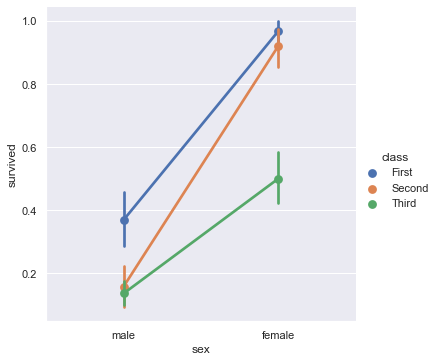

In [151]:
sns.catplot(
    x='sex', 
    y='survived', 
    kind='point', 
    hue='class', 
    data=titanic
)

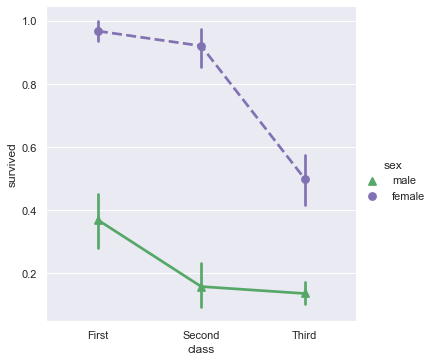

In [152]:
sns.catplot(
    x='class', 
    y='survived', 
    hue='sex', 
    palette={'male': 'g', 'female': 'm'}, 
    markers=['^', 'o'],
    linestyles=['-', '--'], 
    kind='point', 
    data=titanic
)

### Plotting “wide-form” data

In [153]:
iris = sns.load_dataset('iris')
iris

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica
146,6.3,2.5,5.0,1.9,virginica
147,6.5,3.0,5.2,2.0,virginica
148,6.2,3.4,5.4,2.3,virginica


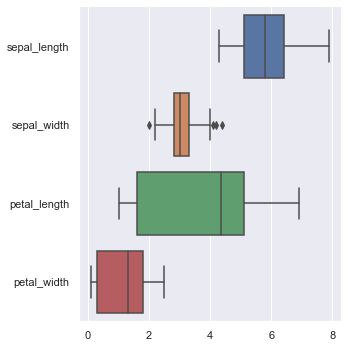

In [154]:
sns.catplot(data=iris, orient='h', kind='box')

<AxesSubplot:xlabel='species', ylabel='sepal_length'>

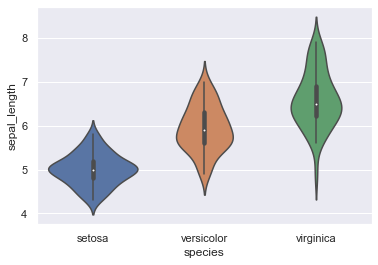

In [155]:
sns.violinplot(x=iris.species, y=iris.sepal_length)

<AxesSubplot:xlabel='count', ylabel='deck'>

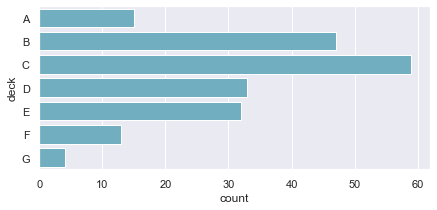

In [156]:
f, ax = plt.subplots(figsize=(7, 3))
sns.countplot(y='deck', data=titanic, color='c')

### Showing multiple relationships with facets

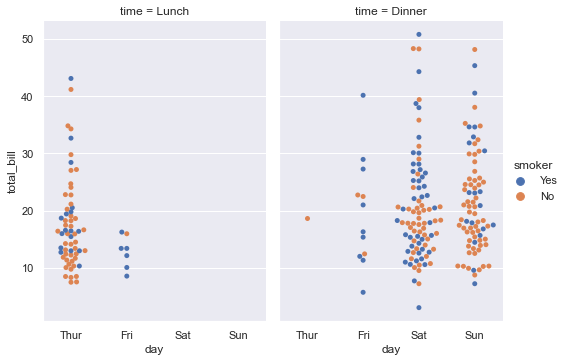

In [157]:
sns.catplot(
    x='day', 
    y='total_bill', 
    hue='smoker', 
    col='time', 
    aspect=.7, 
    kind='swarm', 
    data=tips
)

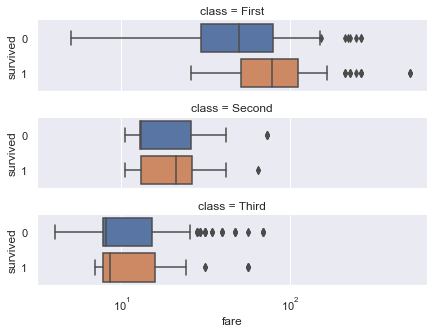

In [158]:
g = sns.catplot(
    x='fare', 
    y='survived', 
    row='class', 
    kind='box', 
    orient='h', 
    height=1.5, 
    aspect=4, 
    data=titanic.query('fare > 0')
)
g.set(xscale='log')

## Visualizing regression models

### Functions to draw linear regression models

In [159]:
sns.set_theme(color_codes=True)

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

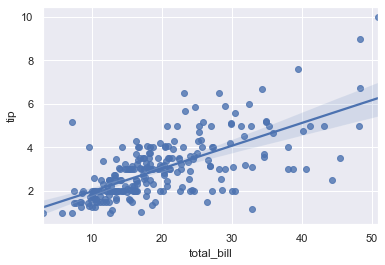

In [160]:
sns.regplot(x='total_bill', y='tip', data=tips)

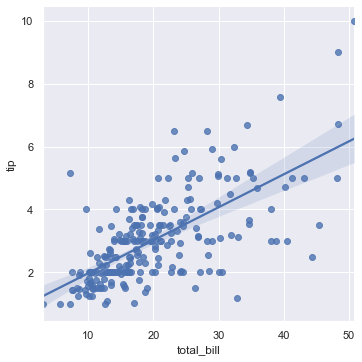

In [161]:
sns.lmplot(x='total_bill', y='tip', data=tips)

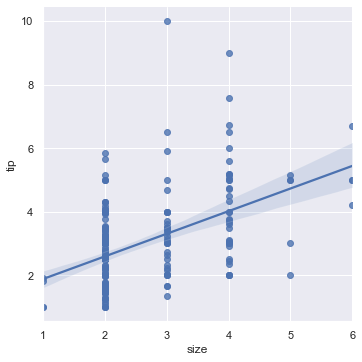

In [162]:
sns.lmplot(x='size', y='tip', data=tips)

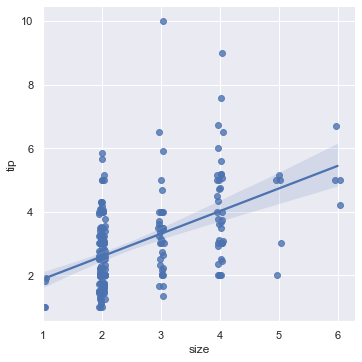

In [163]:
sns.lmplot(x='size', y='tip', data=tips, x_jitter=.05)

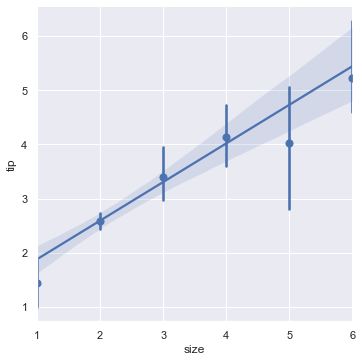

In [164]:
sns.lmplot(x='size', y='tip', data=tips, x_estimator=np.mean)

### Fitting different kinds of models

In [165]:
anscombe = sns.load_dataset('anscombe')
anscombe

,dataset,x,y
0,I,10.0,8.04
1,I,8.0,6.95
2,I,13.0,7.58
3,I,9.0,8.81
4,I,11.0,8.33
5,I,14.0,9.96
6,I,6.0,7.24
7,I,4.0,4.26
8,I,12.0,10.84
9,I,7.0,4.82


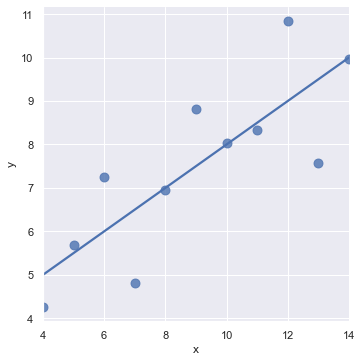

In [166]:
sns.lmplot(x='x', y='y', data=anscombe.query("dataset == 'I'"),
           ci=None, scatter_kws={'s': 80})

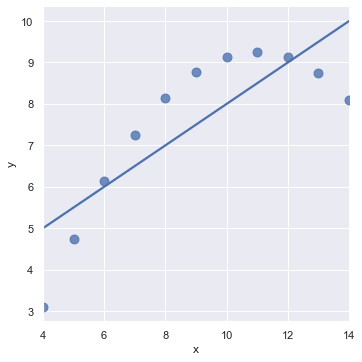

In [167]:
sns.lmplot(
    x='x', 
    y='y', 
    data=anscombe.query("dataset == 'II'"), 
    ci=None, 
    scatter_kws={'s': 80}
)

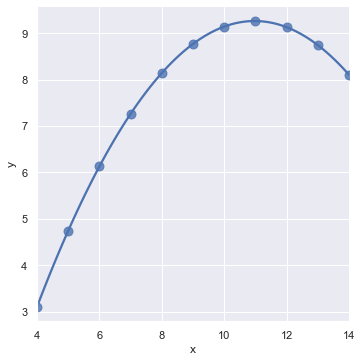

In [168]:
sns.lmplot(
    x='x', 
    y='y', 
    data=anscombe.query("dataset == 'II'"), 
    order=2, 
    ci=None, 
    scatter_kws={'s': 80}
)

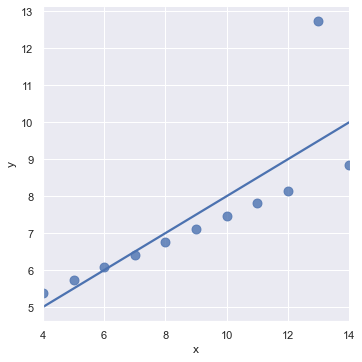

In [169]:
sns.lmplot(
    x='x', 
    y='y', 
    data=anscombe.query("dataset == 'III'"), 
    ci=None, 
    scatter_kws={'s': 80}
)

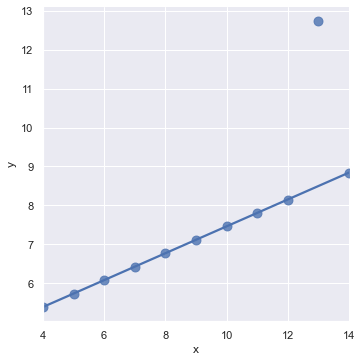

In [170]:
sns.lmplot(
    x='x', 
    y='y', 
    data=anscombe.query("dataset == 'III'"), 
    robust=True, 
    ci=None, 
    scatter_kws={'s': 80}
)

In [171]:
tips['big_tip'] = (tips.tip / tips.total_bill) > .15
tips

,total_bill,tip,sex,smoker,day,time,size,weekend,big_tip
0,16.99,1.01,Female,No,Sun,Dinner,2,True,False
1,10.34,1.66,Male,No,Sun,Dinner,3,True,True
2,21.01,3.50,Male,No,Sun,Dinner,3,True,True
3,23.68,3.31,Male,No,Sun,Dinner,2,True,False
4,24.59,3.61,Female,No,Sun,Dinner,4,True,False
...,...,...,...,...,...,...,...,...,...
239,29.03,5.92,Male,No,Sat,Dinner,3,True,True
240,27.18,2.00,Female,Yes,Sat,Dinner,2,True,False
241,22.67,2.00,Male,Yes,Sat,Dinner,2,True,False
242,17.82,1.75,Male,No,Sat,Dinner,2,True,False


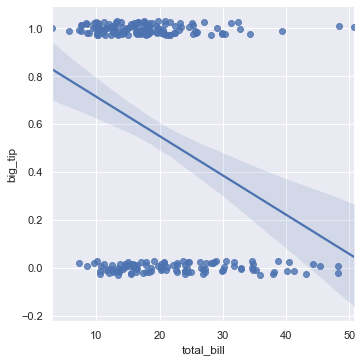

In [172]:
sns.lmplot(
    x='total_bill', 
    y='big_tip', 
    data=tips,
    y_jitter=.03
)

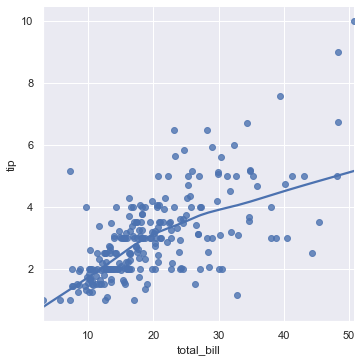

In [173]:
sns.lmplot(x='total_bill', y='tip', data=tips, 
           lowess=True, 
           )

<AxesSubplot:xlabel='x', ylabel='y'>

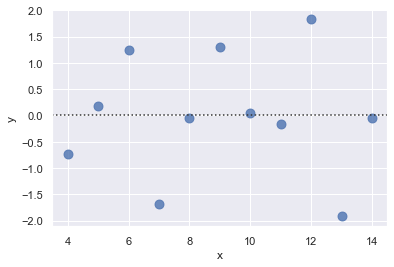

In [174]:
sns.residplot(
    x='x', 
    y='y', 
    data=anscombe.query("dataset == 'I'"), 
    scatter_kws={'s': 80}
)

<AxesSubplot:xlabel='x', ylabel='y'>

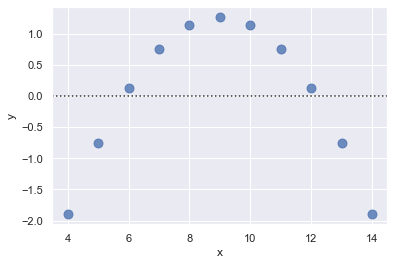

In [175]:
sns.residplot(
    x='x', 
    y='y', 
    data=anscombe.query("dataset == 'II'"), 
    scatter_kws={'s': 80}
)

### Conditioning on other variables

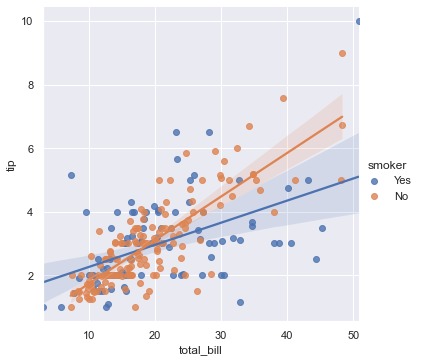

In [176]:
sns.lmplot(
    x='total_bill', 
    y='tip', 
    data=tips, 
    hue='smoker', 
)

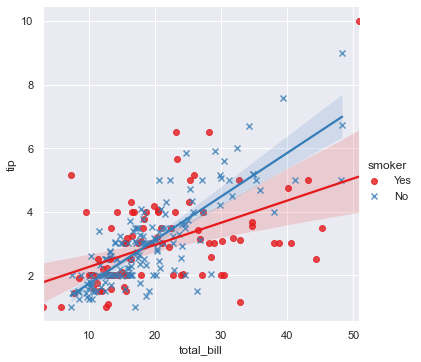

In [177]:
sns.lmplot(
    x='total_bill', 
    y='tip', 
    data=tips, 
    hue='smoker', 
    markers=['o', 'x'], 
    palette='Set1'
)

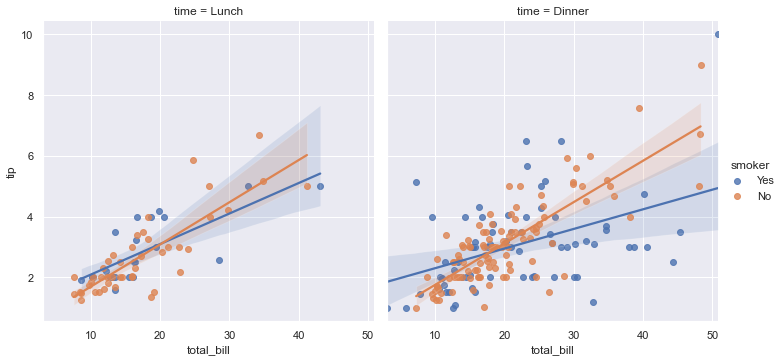

In [178]:
sns.lmplot(
    x='total_bill', 
    y='tip', 
    data=tips, 
    hue='smoker', 
    col='time'
)

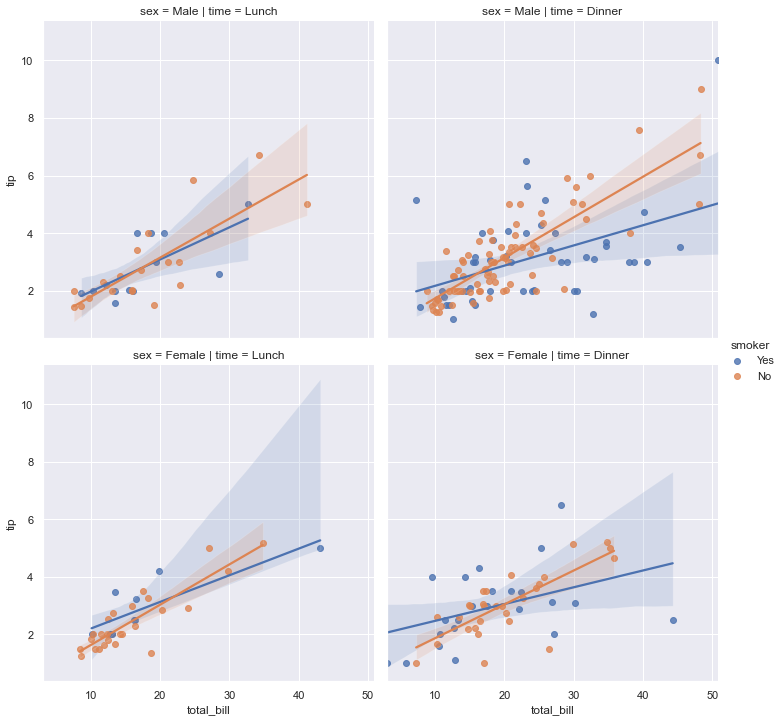

In [179]:
sns.lmplot(
    x='total_bill', 
    y='tip', 
    data=tips, 
    hue='smoker', 
    col='time', 
    row='sex', 
)

### Controlling the size and shape of the plot

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

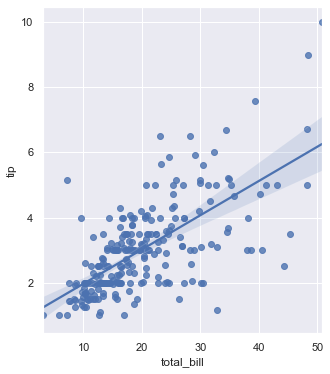

In [180]:
f, ax = plt.subplots(figsize=(5, 6))
sns.regplot(x='total_bill', y='tip', data=tips, ax=ax)

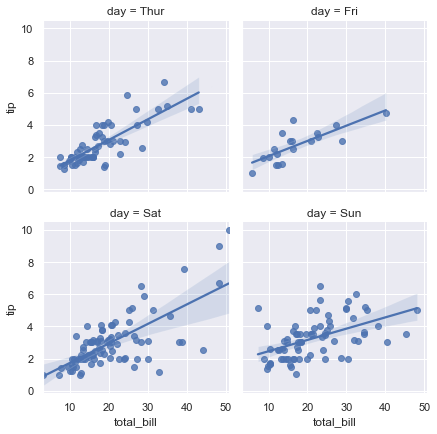

In [181]:
sns.lmplot(
    x='total_bill', 
    y='tip', 
    col='day', 
    data=tips, 
    col_wrap=2, 
    height=3
)

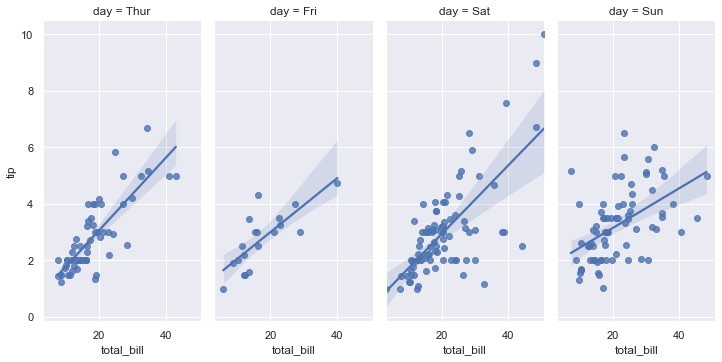

In [182]:
sns.lmplot(
    x='total_bill', 
    y='tip', 
    col='day', 
    data=tips, 
    aspect=.5
)

### Plotting a regression in other contexts

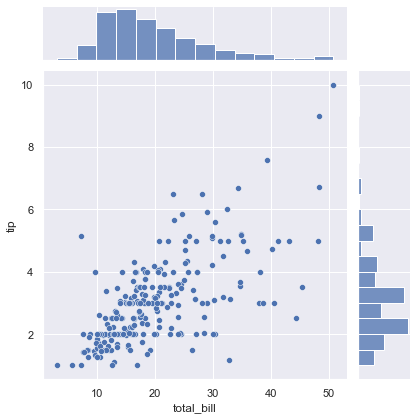

In [183]:
sns.jointplot(
    x='total_bill', 
    y='tip', 
    data=tips, 
)

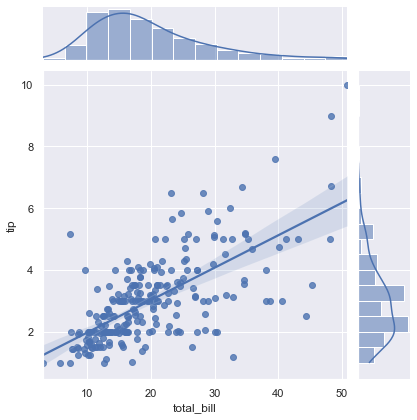

In [184]:
sns.jointplot(
    x='total_bill', 
    y='tip', 
    data=tips, 
    kind='reg'
)

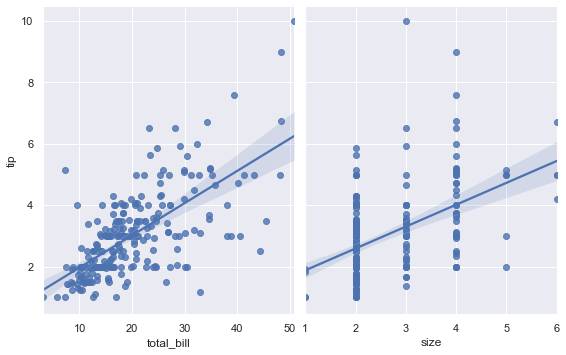

In [185]:
sns.pairplot(
    tips, 
    x_vars=['total_bill', 'size'], 
    y_vars=['tip'], 
    height=5, 
    aspect=.8,
    kind='reg'
)

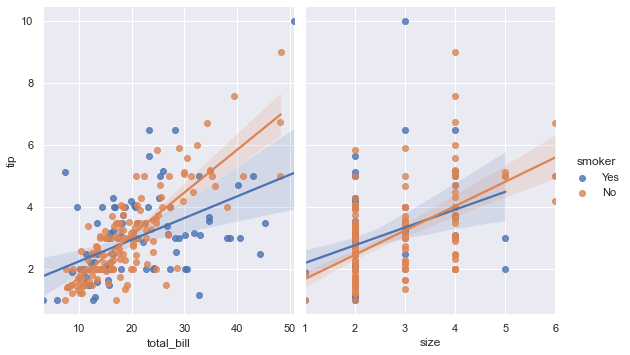

In [186]:
sns.pairplot(
    tips, 
    x_vars=['total_bill', 'size'], 
    y_vars=['tip'], 
    hue='smoker', 
    height=5, 
    aspect=.8,
    kind='reg'
)

# multi-plot grids

## Building structured multi-plot grids

### Conditional small multiples

In [187]:
tips

,total_bill,tip,sex,smoker,day,time,size,weekend,big_tip
0,16.99,1.01,Female,No,Sun,Dinner,2,True,False
1,10.34,1.66,Male,No,Sun,Dinner,3,True,True
2,21.01,3.50,Male,No,Sun,Dinner,3,True,True
3,23.68,3.31,Male,No,Sun,Dinner,2,True,False
4,24.59,3.61,Female,No,Sun,Dinner,4,True,False
...,...,...,...,...,...,...,...,...,...
239,29.03,5.92,Male,No,Sat,Dinner,3,True,True
240,27.18,2.00,Female,Yes,Sat,Dinner,2,True,False
241,22.67,2.00,Male,Yes,Sat,Dinner,2,True,False
242,17.82,1.75,Male,No,Sat,Dinner,2,True,False


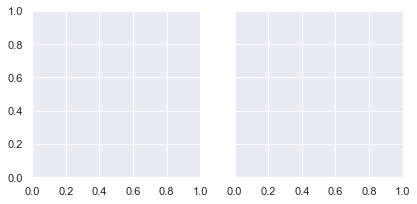

In [188]:
g = sns.FacetGrid(tips, col='time')

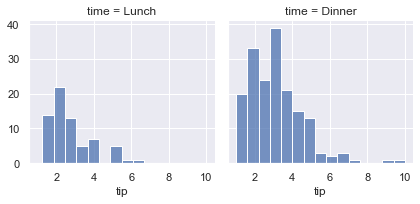

In [189]:
g = sns.FacetGrid(tips, col='time')
g.map(sns.histplot, 'tip')

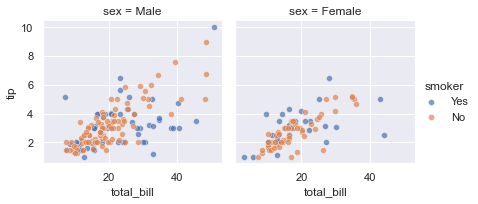

In [190]:
g = sns.FacetGrid(tips, col='sex', hue='smoker')
g.map(sns.scatterplot, 'total_bill', 'tip', alpha=.7)
g.add_legend()

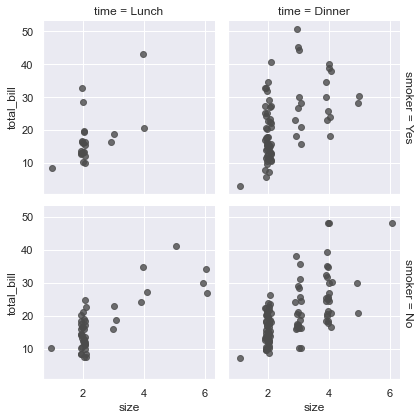

In [191]:
g = sns.FacetGrid(tips, row='smoker', col='time', margin_titles=True)
g.map(sns.regplot, 'size', 'total_bill', color='.3', fit_reg=False, x_jitter=.1)

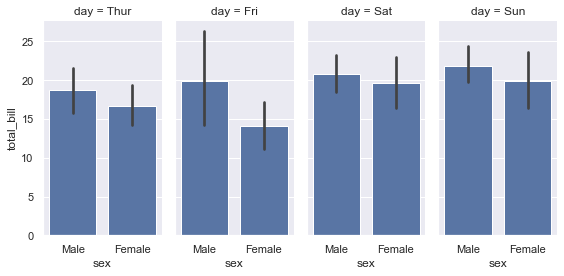

In [192]:
g = sns.FacetGrid(tips, col='day', height=4, aspect=.5)
g.map(sns.barplot, 'sex', 'total_bill', order=['Male', 'Female'])

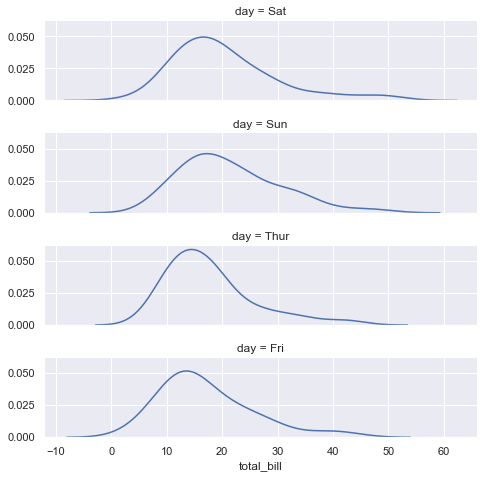

In [193]:
ordered_days = tips.day.value_counts().index
g =sns.FacetGrid(
    tips,
    row='day', 
    row_order=ordered_days,
    height=1.7, aspect=4,
)
g.map(sns.kdeplot, 'total_bill')

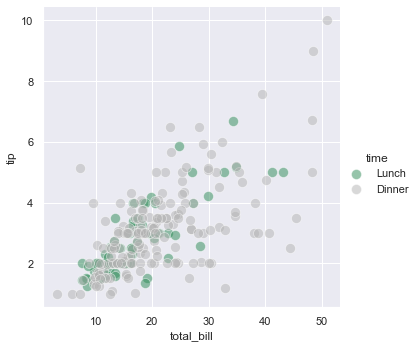

In [194]:
pal = dict(Lunch='seagreen', Dinner='.7')
g = sns.FacetGrid(
    tips, hue='time', palette=pal, height=5
)
g.map(
    sns.scatterplot, 'total_bill', 'tip', s=100, alpha=.5
)
g.add_legend()

In [195]:
attend = sns.load_dataset('attention').query('subject <= 12')
attend

,Unnamed: 0,subject,attention,solutions,score
0,0,1,divided,1,2.0
1,1,2,divided,1,3.0
2,2,3,divided,1,3.0
3,3,4,divided,1,5.0
4,4,5,divided,1,4.0
5,5,6,divided,1,5.0
6,6,7,divided,1,5.0
7,7,8,divided,1,5.0
8,8,9,divided,1,2.0
9,9,10,divided,1,6.0


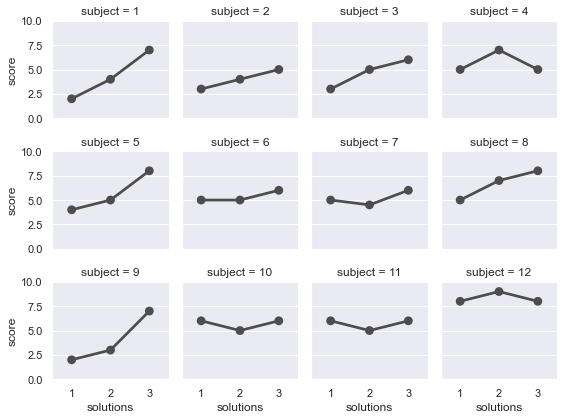

In [196]:
g = sns.FacetGrid(
    attend, 
    col='subject', col_wrap=4, 
    height=2, ylim=(0, 10)
)
g.map(
    sns.pointplot, 'solutions', 'score', 
    order=[1, 2, 3], color='.3', ci=None
)

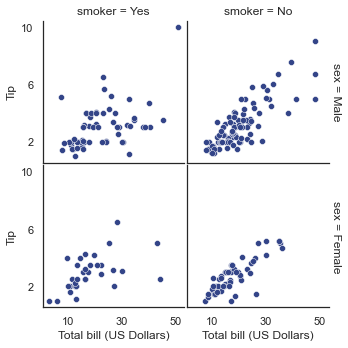

In [197]:
with sns.axes_style('white'):
    g = sns.FacetGrid(
        tips, row='sex', col='smoker', 
        margin_titles=True, height=2.5
    )
g.map(
    sns.scatterplot, 'total_bill', 'tip', color='#334488'
)
g.set_axis_labels('Total bill (US Dollars)', 'Tip')
g.set(xticks=[10, 30, 50], yticks=[2, 6, 10])
g.fig.subplots_adjust(wspace=.02, hspace=.02)

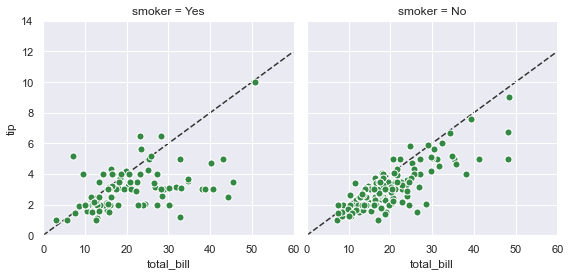

In [198]:
g = sns.FacetGrid(
    tips, col='smoker', margin_titles=True, height=4
)
g.map(
    plt.scatter, 'total_bill', 'tip', 
    color='#338844', edgecolor='white', s=50, lw=1
)

for ax in g.axes_dict.values():
    ax.axline((0, 0), slope=.2, c='.2', ls='--', zorder=0)
g.set(xlim=(0, 60), ylim=(0, 14))

### Using custom functions

In [199]:
from scipy import stats
def quantile_plot(x, **kwargs):
    quantiles, xr = stats.probplot(x, fit=False)
    plt.scatter(xr, quantiles, **kwargs)

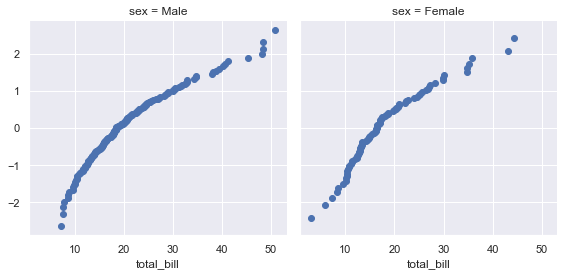

In [200]:
g = sns.FacetGrid(
    tips, col='sex', height=4
)
g.map(quantile_plot, 'total_bill')

In [201]:
def qqplot(x, y, **kwargs):
    _, xr = stats.probplot(x, fit=False)
    _, yr = stats.probplot(y, fit=False)
    plt.scatter(xr, yr, **kwargs)

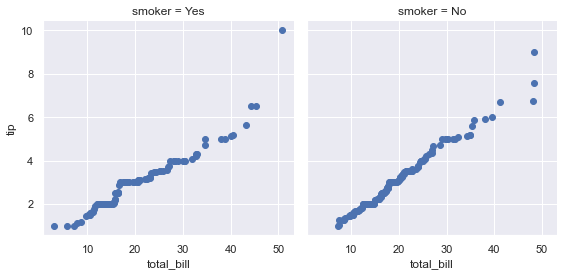

In [202]:
g = sns.FacetGrid(
    tips, col='smoker', height=4
)
g.map(qqplot, 'total_bill', 'tip')

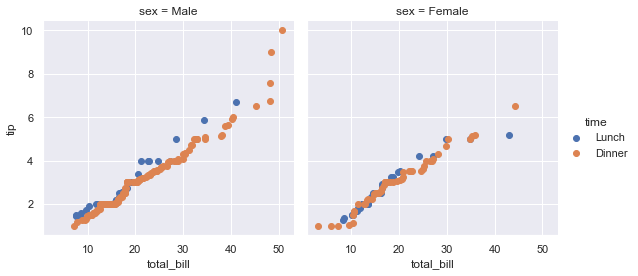

In [203]:
g = sns.FacetGrid(
    tips, hue='time', col='sex', height=4
)
g.map(qqplot, 'total_bill', 'tip')
g.add_legend()

In [204]:
def hexbin(x, y, color, **kwargs):
    cmap = sns.light_palette(color, as_cmap=True)
    plt.hexbin(x, y, gridsize=15, cmap=cmap, **kwargs)

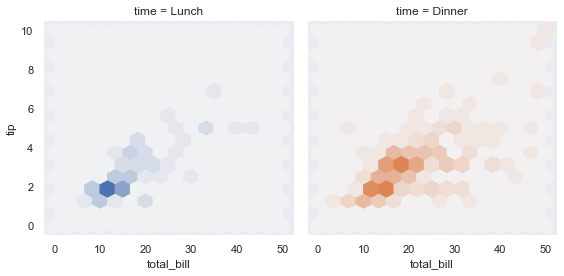

In [205]:
with sns.axes_style('dark'):
    g = sns.FacetGrid(tips, hue='time', col='time', height=4)
g.map(hexbin, 'total_bill', 'tip', extent=[0, 50, 0, 10])

### Plotting pairwise data relationships

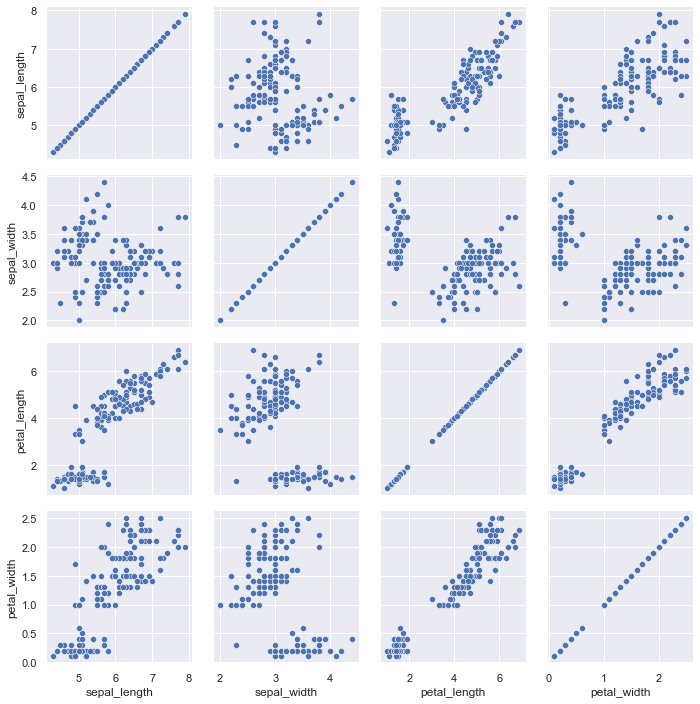

In [206]:
g = sns.PairGrid(iris)
g.map(sns.scatterplot)

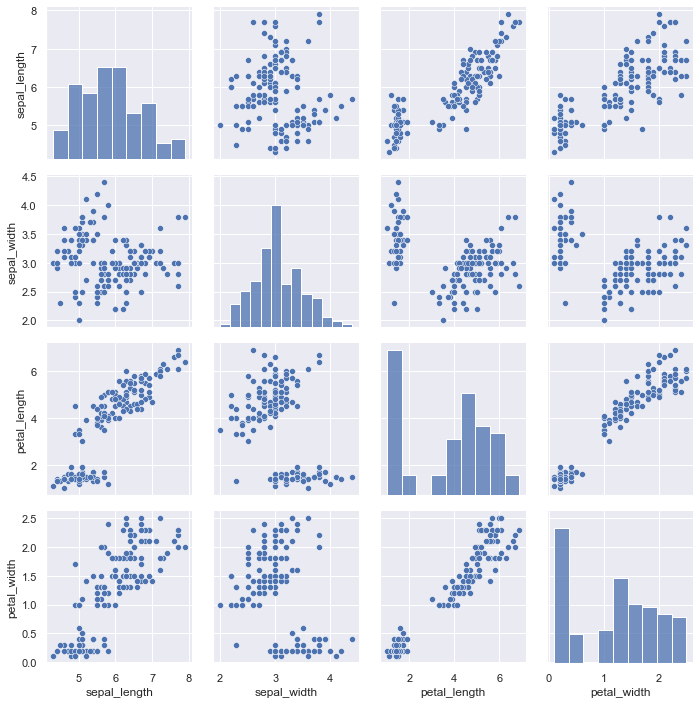

In [207]:
g = sns.PairGrid(iris)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

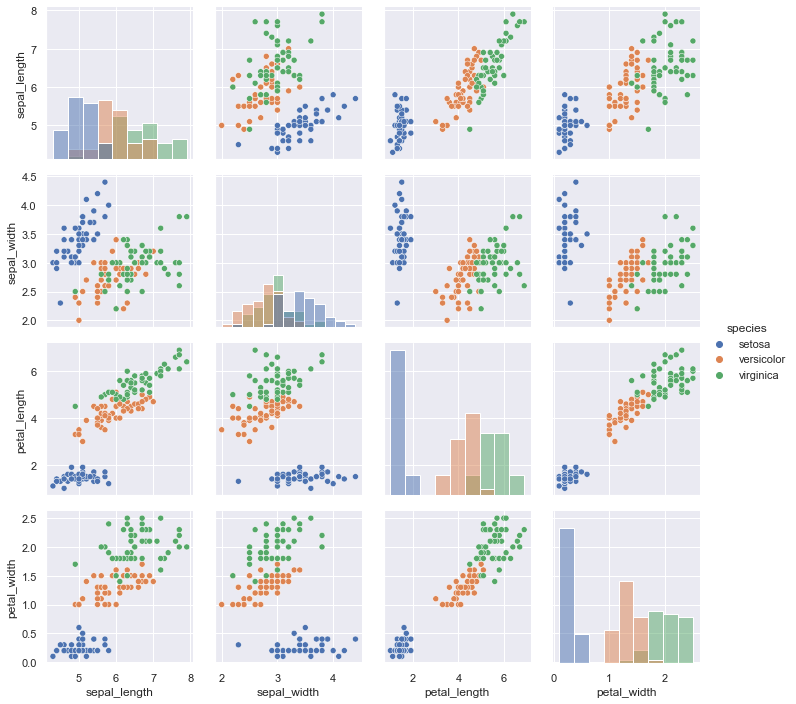

In [208]:
g = sns.PairGrid(iris, hue='species')
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)
g.add_legend()

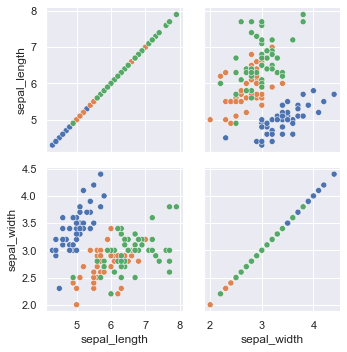

In [209]:
g = sns.PairGrid(
    iris, vars=['sepal_length', 'sepal_width'], hue='species'
)
g.map(sns.scatterplot)

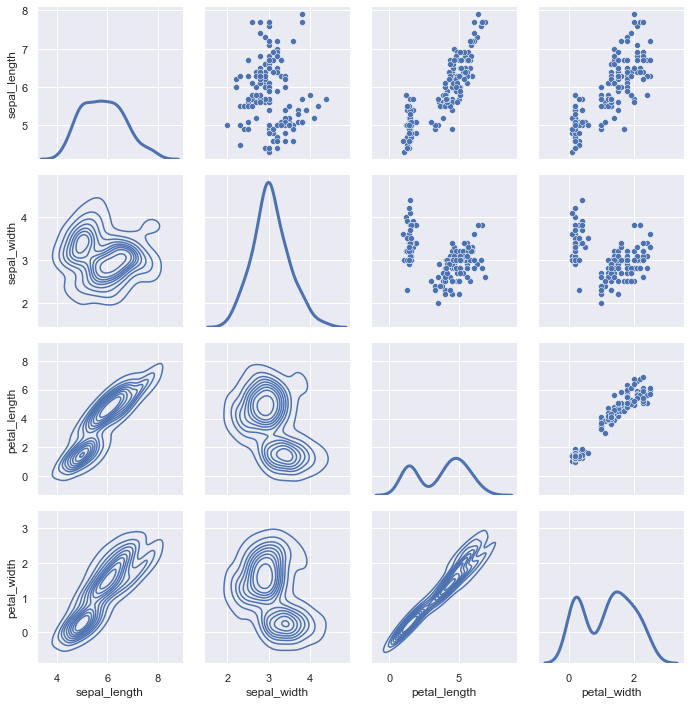

In [210]:
g = sns.PairGrid(iris)
g.map_upper(sns.scatterplot)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot, lw=3, legend=False)

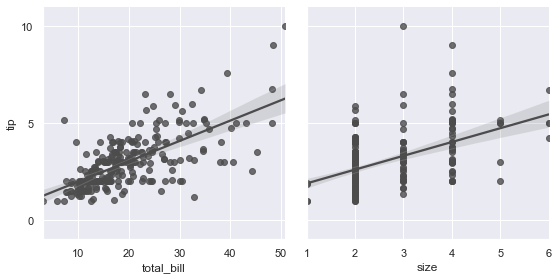

In [211]:
g = sns.PairGrid(
    tips, y_vars=['tip'], x_vars=['total_bill', 'size'], height=4
)
g.map(sns.regplot, color='.3')
g.set(ylim=(-1, 11), yticks=[0, 5, 10])

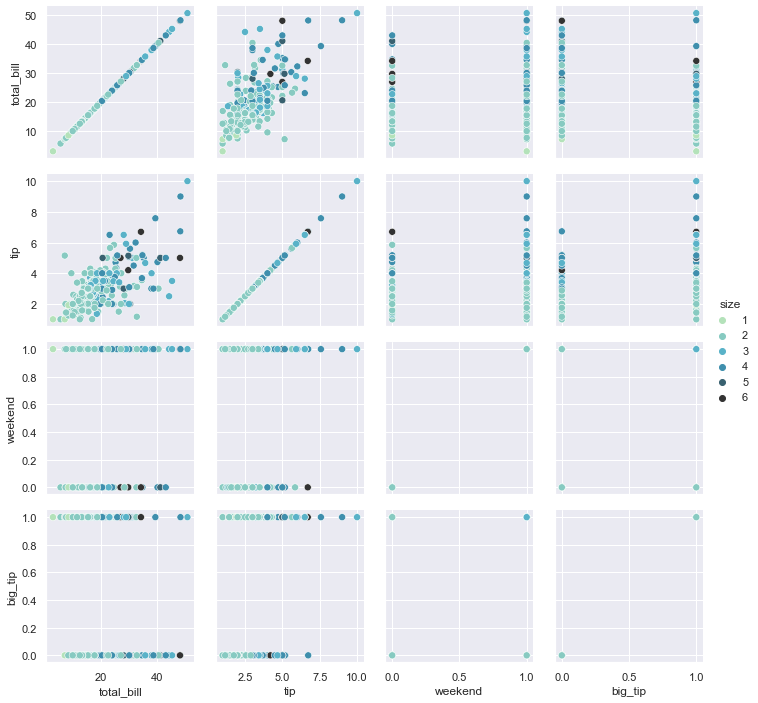

In [212]:
g = sns.PairGrid(tips, hue='size', palette='GnBu_d')
g.map(sns.scatterplot, s=50, edgecolor='white')
g.add_legend()

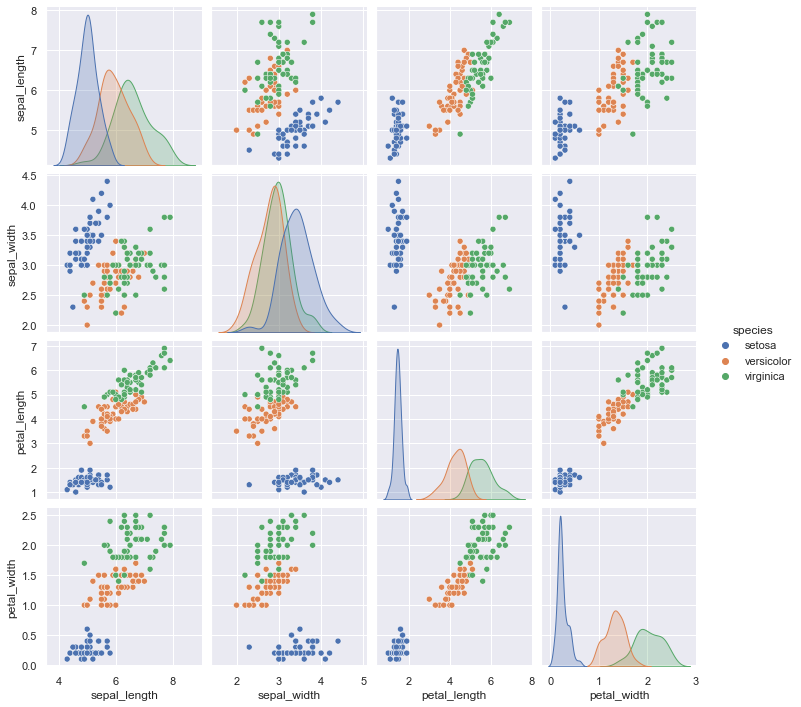

In [213]:
sns.pairplot(iris, hue='species', height=2.5)

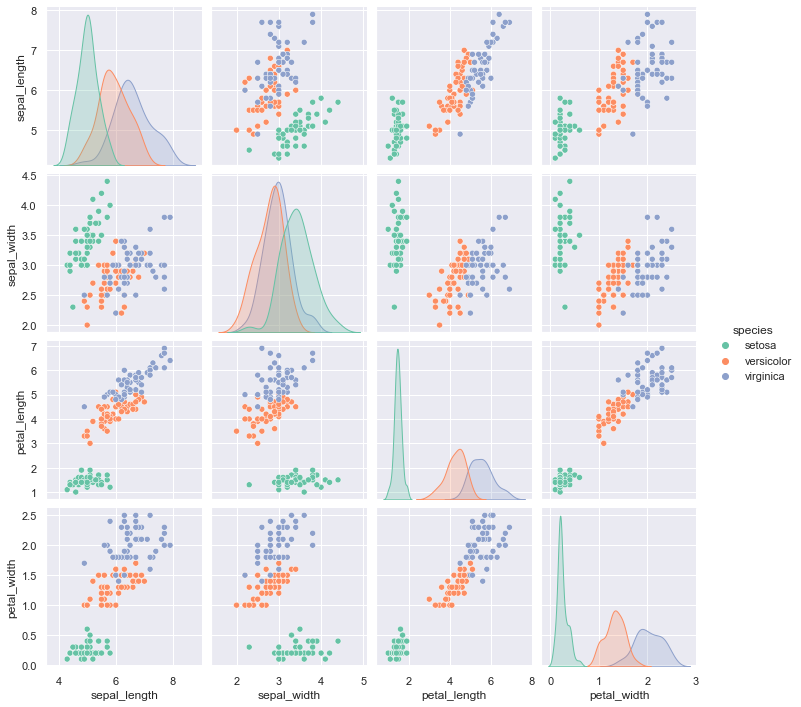

In [214]:
sns.pairplot(iris, hue='species', height=2.5, palette='Set2', diag_kind='kde')

# plot aesthetics

## Controlling figure aesthetics

In [215]:
def sinplot(flip=1):
    x = np.linspace(0, 14, 100)
    for i in range(1, 7):
        plt.plot(x, np.sin(x + i * .5) * (7 - i) * flip)

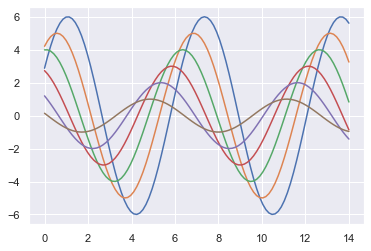

In [216]:
sinplot()

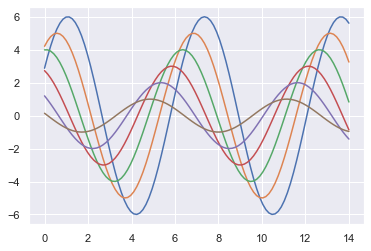

In [217]:
sns.set_theme()
sinplot()

### Seaborn figure styles

<AxesSubplot:>

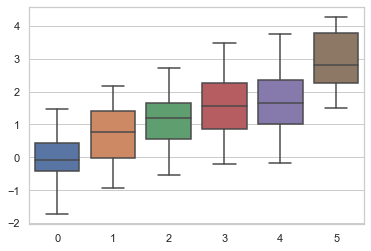

In [218]:
sns.set_style('whitegrid')
data = np.random.normal(size=(20, 6)) + np.arange(6) / 2
sns.boxplot(data=data)

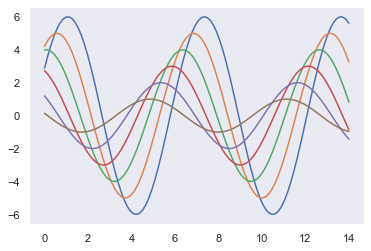

In [219]:
sns.set_style('dark')
sinplot()

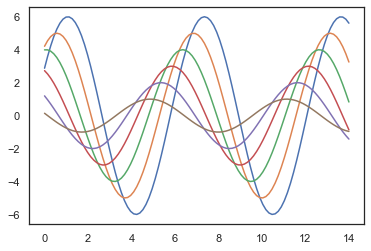

In [220]:
sns.set_style('white')
sinplot()

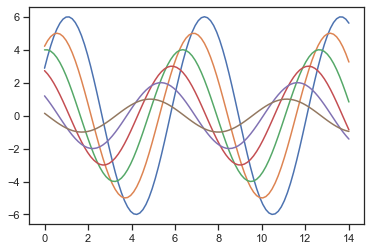

In [221]:
sns.set_style('ticks')
sinplot()

### Removing axes spines

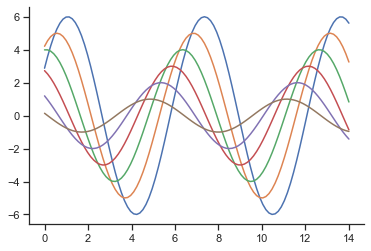

In [222]:
sinplot()
sns.despine()

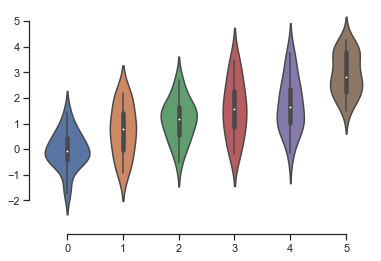

In [223]:
f, ax = plt.subplots()
sns.violinplot(data=data)
sns.despine(offset=10, trim=True)

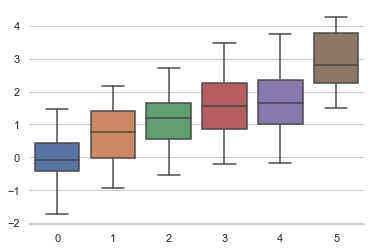

In [224]:
sns.set_style('whitegrid')
sns.boxplot(data=data, palette='deep')
sns.despine(left=True)

### Temporarily setting figure style

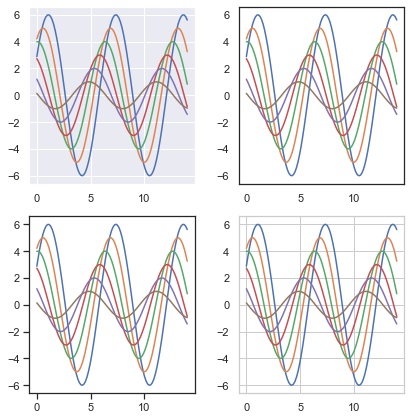

In [225]:
f = plt.figure(figsize=(6, 6))
gs = f.add_gridspec(2, 2)

with sns.axes_style('darkgrid'):
    ax = f.add_subplot(gs[0, 0])
    sinplot()

with sns.axes_style('white'):
    ax = f.add_subplot(gs[0, 1])
    sinplot()

with sns.axes_style('ticks'):
    ax = f.add_subplot(gs[1, 0])
    sinplot()

with sns.axes_style('whitegrid'):
    ax = f.add_subplot(gs[1, 1])
    sinplot()

f.tight_layout()

### Overriding elements of the seaborn styles

In [226]:
sns.axes_style()

{'axes.facecolor': 'white',
 'axes.edgecolor': '.8',
 'axes.grid': True,
 'axes.axisbelow': True,
 'axes.labelcolor': '.15',
 'figure.facecolor': 'white',
 'grid.color': '.8',
 'grid.linestyle': '-',
 'text.color': '.15',
 'xtick.color': '.15',
 'ytick.color': '.15',
 'xtick.direction': 'out',
 'ytick.direction': 'out',
 'lines.solid_capstyle': <CapStyle.round: 'round'>,
 'patch.edgecolor': 'w',
 'patch.force_edgecolor': True,
 'image.cmap': 'rocket',
 'font.family': ['sans-serif'],
 'font.sans-serif': ['Arial',
  'DejaVu Sans',
  'Liberation Sans',
  'Bitstream Vera Sans',
  'sans-serif'],
 'xtick.bottom': False,
 'xtick.top': False,
 'ytick.left': False,
 'ytick.right': False,
 'axes.spines.left': True,
 'axes.spines.bottom': True,
 'axes.spines.right': True,
 'axes.spines.top': True}

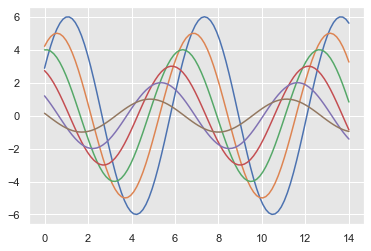

In [227]:
sns.set_style('darkgrid', {'axes.facecolor': '.9'})
sinplot()

### Scaling plot elements

In [228]:
sns.set_theme()

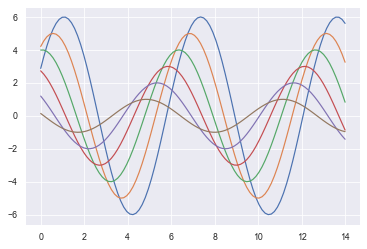

In [229]:
sns.set_context('paper')
sinplot()

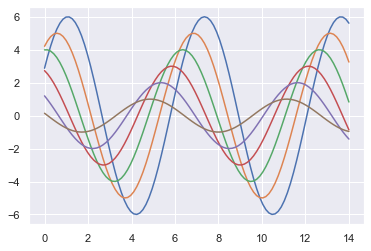

In [230]:
sns.set_context('notebook')
sinplot()

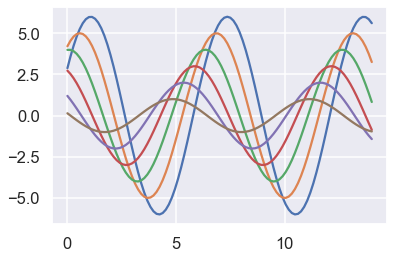

In [231]:
sns.set_context('talk')
sinplot()

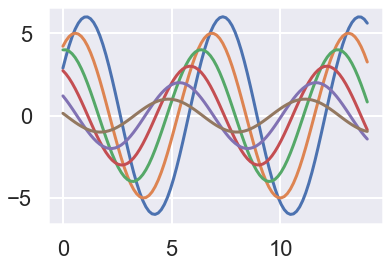

In [232]:
sns.set_context('poster')
sinplot()

## Choosing color palettes

### General principles for using color in plots

### Tools for choosing color palettes

### Qualitative color palettes

In [233]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

In [234]:
sns.color_palette('tab10')

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

In [235]:
sns.color_palette('hls', 8)

[(0.86, 0.3712, 0.33999999999999997),
 (0.86, 0.7612000000000001, 0.33999999999999997),
 (0.5688000000000001, 0.86, 0.33999999999999997),
 (0.33999999999999997, 0.86, 0.5012000000000001),
 (0.33999999999999997, 0.8287999999999999, 0.86),
 (0.33999999999999997, 0.43879999999999986, 0.86),
 (0.6311999999999998, 0.33999999999999997, 0.86),
 (0.86, 0.33999999999999997, 0.6987999999999996)]

In [236]:
sns.color_palette('husl', 8)

[(0.9677975592919913, 0.44127456009157356, 0.5358103155058701),
 (0.8087954113106306, 0.5634700050056693, 0.19502642696727285),
 (0.5920891529639701, 0.6418467016378244, 0.1935069134991043),
 (0.19783576093349015, 0.6955516966063037, 0.3995301037444499),
 (0.21044753832183283, 0.6773105080456748, 0.6433941168468681),
 (0.22335772267769388, 0.6565792317435265, 0.8171355503265633),
 (0.6423044349219739, 0.5497680051256467, 0.9582651433656727),
 (0.9603888539940703, 0.3814317878772117, 0.8683117650835491)]

In [237]:
sns.color_palette('Set2')

[(0.4, 0.7607843137254902, 0.6470588235294118),
 (0.9882352941176471, 0.5529411764705883, 0.3843137254901961),
 (0.5529411764705883, 0.6274509803921569, 0.796078431372549),
 (0.9058823529411765, 0.5411764705882353, 0.7647058823529411),
 (0.6509803921568628, 0.8470588235294118, 0.32941176470588235),
 (1.0, 0.8509803921568627, 0.1843137254901961),
 (0.8980392156862745, 0.7686274509803922, 0.5803921568627451),
 (0.7019607843137254, 0.7019607843137254, 0.7019607843137254)]

In [238]:
sns.color_palette('Paired')

[(0.6509803921568628, 0.807843137254902, 0.8901960784313725),
 (0.12156862745098039, 0.47058823529411764, 0.7058823529411765),
 (0.6980392156862745, 0.8745098039215686, 0.5411764705882353),
 (0.2, 0.6274509803921569, 0.17254901960784313),
 (0.984313725490196, 0.6039215686274509, 0.6),
 (0.8901960784313725, 0.10196078431372549, 0.10980392156862745),
 (0.9921568627450981, 0.7490196078431373, 0.43529411764705883),
 (1.0, 0.4980392156862745, 0.0),
 (0.792156862745098, 0.6980392156862745, 0.8392156862745098),
 (0.41568627450980394, 0.23921568627450981, 0.6039215686274509),
 (1.0, 1.0, 0.6),
 (0.6941176470588235, 0.34901960784313724, 0.1568627450980392)]

### Sequential color palettes

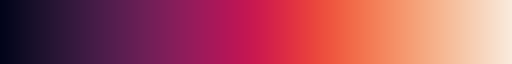

In [239]:
sns.color_palette('rocket', as_cmap=True)

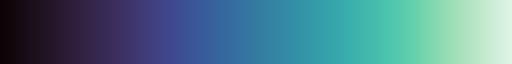

In [240]:
sns.color_palette('mako', as_cmap=True)

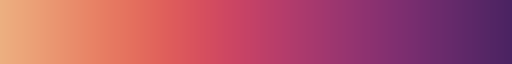

In [241]:
sns.color_palette('flare', as_cmap=True)

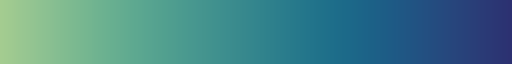

In [242]:
sns.color_palette('crest', as_cmap=True)

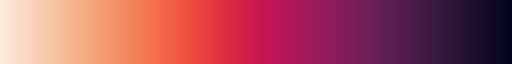

In [243]:
sns.color_palette('rocket_r', as_cmap=True)

In [244]:
sns.color_palette('rocket')

[(0.20973515, 0.09747934, 0.24238489),
 (0.43860848, 0.12177004, 0.34119475),
 (0.67824099, 0.09192342, 0.3504148),
 (0.8833417, 0.19830556, 0.26014181),
 (0.95381595, 0.46373781, 0.31769923),
 (0.96516917, 0.70776351, 0.5606593)]

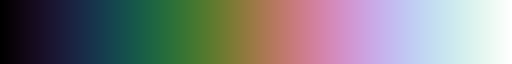

In [245]:
sns.color_palette('cubehelix', as_cmap=True)

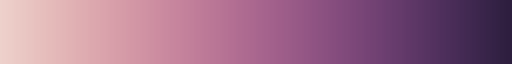

In [246]:
sns.cubehelix_palette(as_cmap=True)

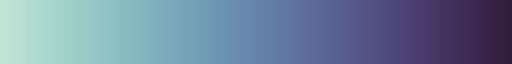

In [247]:
sns.cubehelix_palette(start=.5, rot=-.5, as_cmap=True)

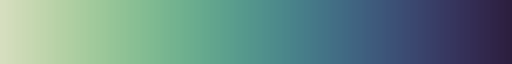

In [248]:
sns.cubehelix_palette(start=.5, rot=-.75, as_cmap=True)

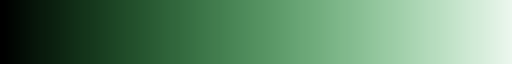

In [249]:
sns.cubehelix_palette(start=2, rot=0, dark=0, light=.95, reverse=True, as_cmap=True)

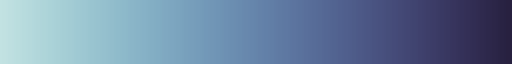

In [250]:
sns.color_palette('ch:start=.2, rot=-.3', as_cmap=True)

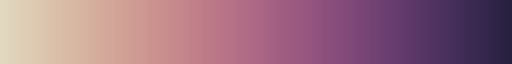

In [251]:
sns.color_palette('ch:s=-.2, r=.6', as_cmap=True)

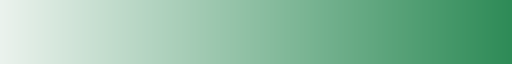

In [252]:
sns.light_palette('seagreen', as_cmap=True)

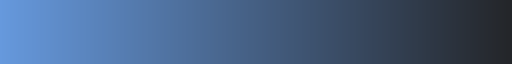

In [253]:
sns.dark_palette('#69d', reverse=True, as_cmap=True)

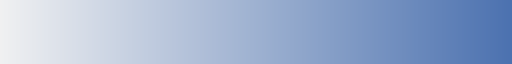

In [254]:
sns.color_palette('light:b', as_cmap=True)

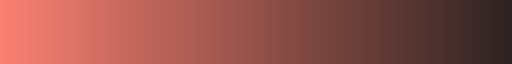

In [255]:
sns.color_palette('dark:salmon_r', as_cmap=True)

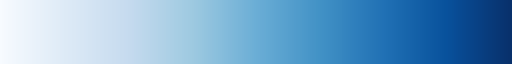

In [256]:
sns.color_palette('Blues', as_cmap=True)

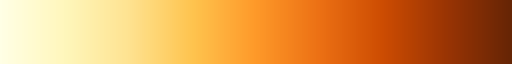

In [257]:
sns.color_palette('YlOrBr', as_cmap=True)

### Diverging color palettes

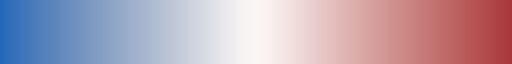

In [258]:
sns.color_palette('vlag', as_cmap=True)

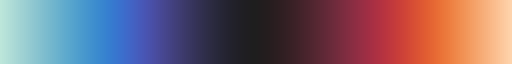

In [259]:
sns.color_palette('icefire', as_cmap=True)

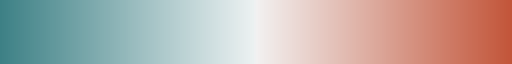

In [260]:
sns.diverging_palette(200, 20, as_cmap=True)

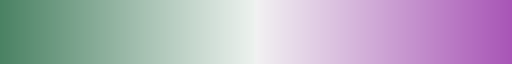

In [261]:
sns.diverging_palette(145, 300, s=60, as_cmap=True)

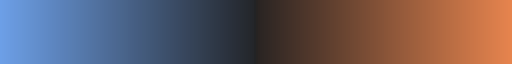

In [262]:
sns.diverging_palette(250, 30, l=65, center='dark', as_cmap=True)

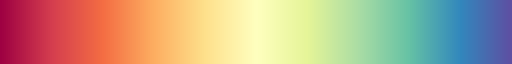

In [263]:
sns.color_palette('Spectral', as_cmap=True)

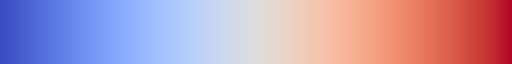

In [264]:
sns.color_palette('coolwarm', as_cmap=True)

# API reference

## Relational plots

### sns.relplot

In [265]:
sns.reset_defaults()
tips = sns.load_dataset('tips')
tips.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


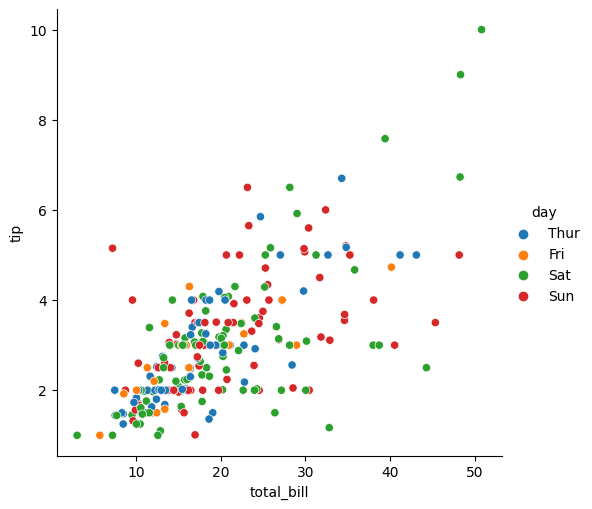

In [266]:
sns.relplot(data=tips, x='total_bill', y='tip', hue='day')

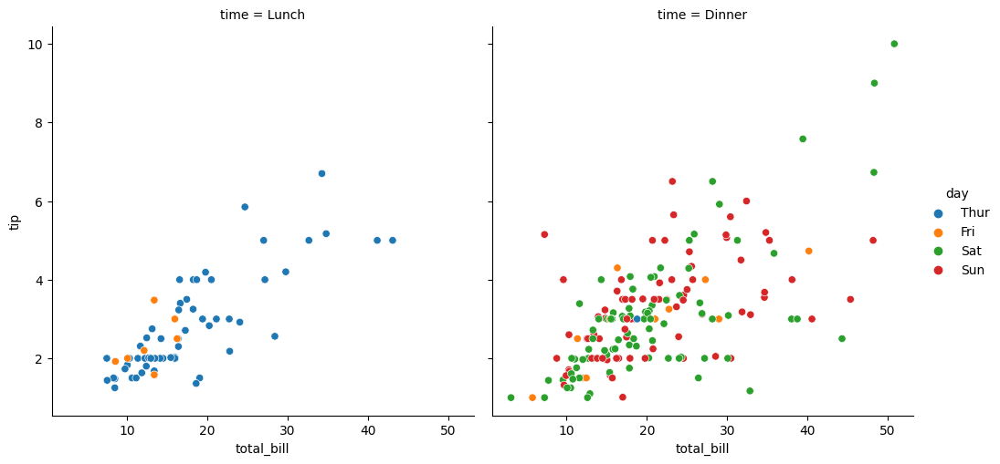

In [267]:
sns.relplot(data=tips, x='total_bill', y='tip', hue='day', col='time')

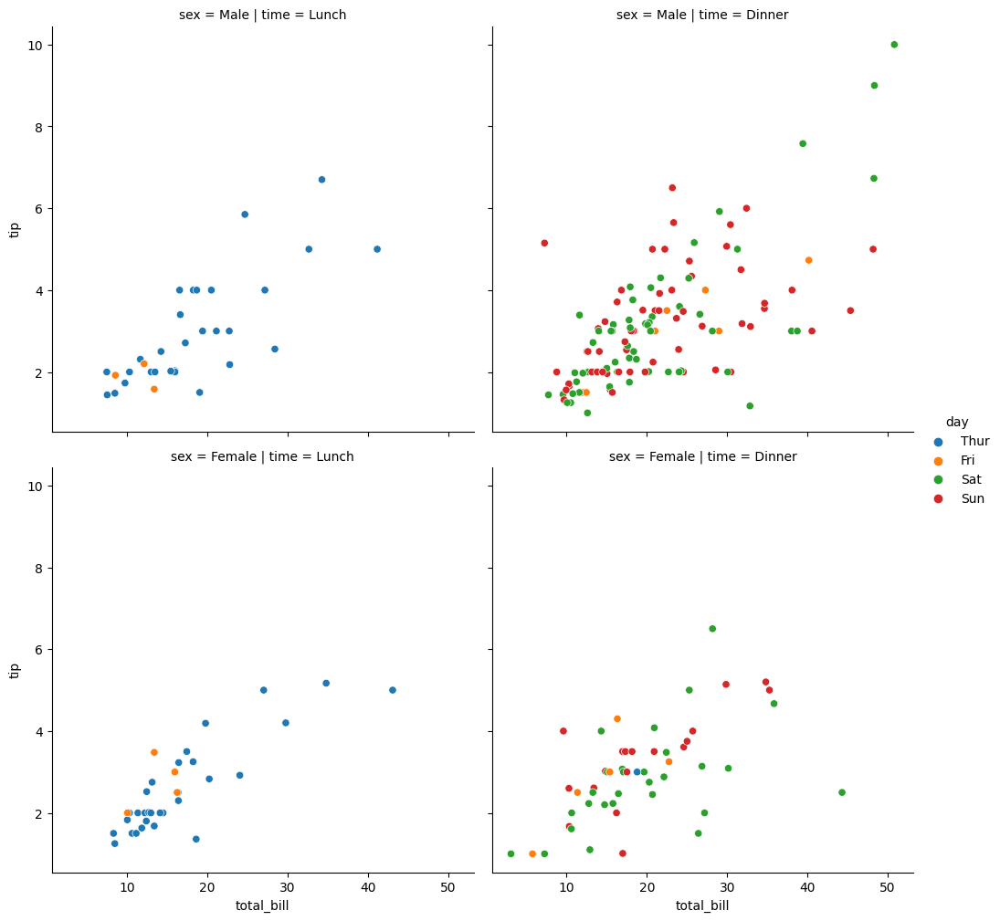

In [268]:
sns.relplot(data=tips, x='total_bill', y='tip', hue='day', col='time', row='sex')

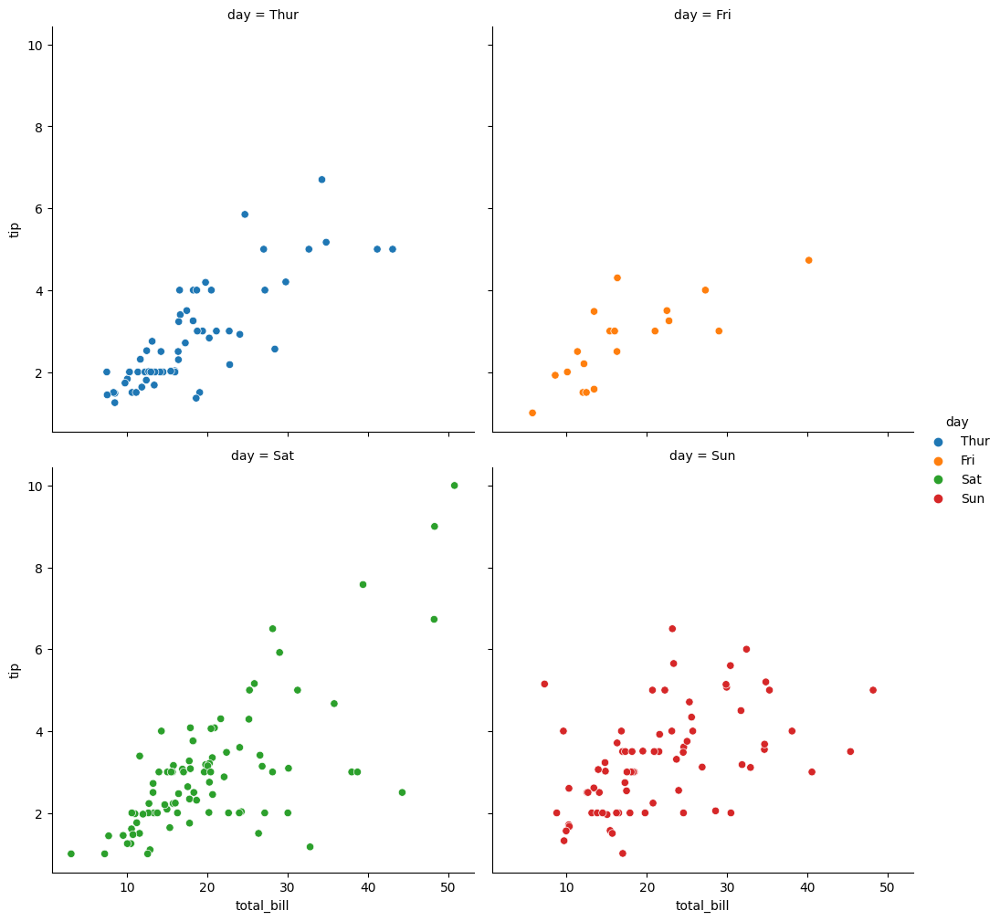

In [269]:
sns.relplot(data=tips, x='total_bill', y='tip', hue='day', col='day', col_wrap=2)

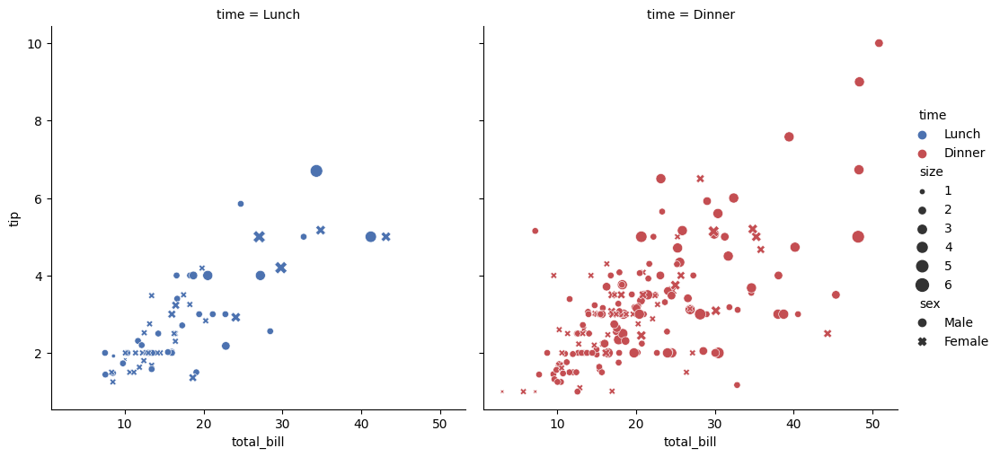

In [270]:
sns.relplot(
    data=tips, x='total_bill', y='tip', col='time', 
    hue='time', size='size', style='sex', 
    palette=['b', 'r'], sizes=(10, 100)
)

In [271]:
fmri.head()

,subject,timepoint,event,region,signal
0,s13,18,stim,parietal,-0.017552
1,s5,14,stim,parietal,-0.080883
2,s12,18,stim,parietal,-0.081033
3,s11,18,stim,parietal,-0.046134
4,s10,18,stim,parietal,-0.037970


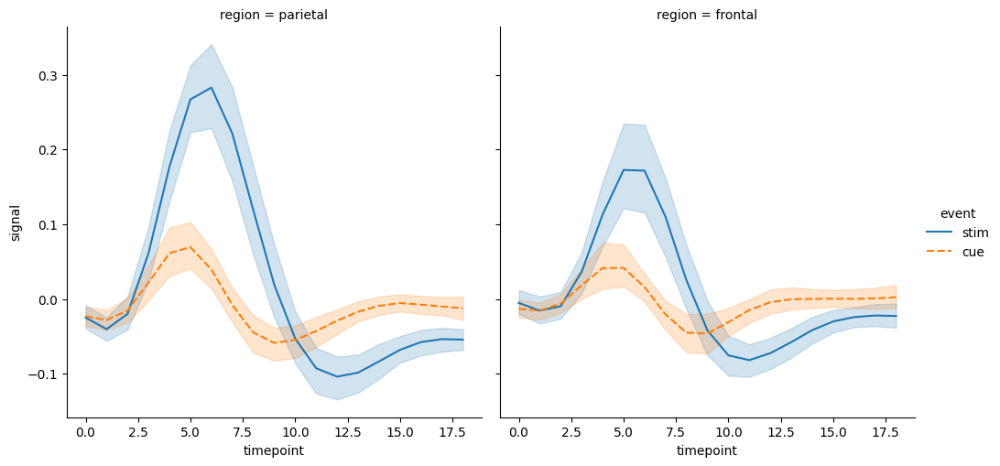

In [272]:
sns.relplot(
    data=fmri, x='timepoint', y='signal', col='region', 
    hue='event', style='event', kind='line'
)

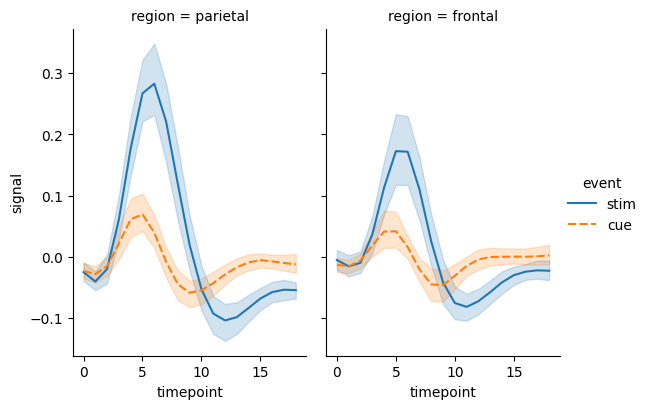

In [273]:
sns.relplot(
    data=fmri, x='timepoint', y='signal', 
    hue='event', style='event', col='region', 
    height=4, aspect=.7, kind='line'
)

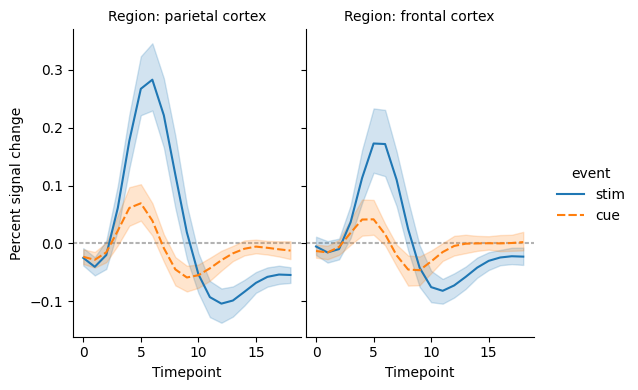

In [274]:
g = sns.relplot(
    data=fmri, x='timepoint', y='signal', 
    hue='event', style='event', col='region', 
    height=4, aspect=.7, kind='line'
)
(g.map(plt.axhline, y=0, color='.7', dashes=(2, 1), zorder=0)).set_axis_labels(
    'Timepoint', 'Percent signal change').set_titles(
        'Region: {col_name} cortex'
    ).tight_layout(w_pad=0)

In [275]:
flights_wide

month,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec
year,,,,,,,,,,,,
1949,112,118,132,129,121,135,148,148,136,119,104,118
1950,115,126,141,135,125,149,170,170,158,133,114,140
1951,145,150,178,163,172,178,199,199,184,162,146,166
1952,171,180,193,181,183,218,230,242,209,191,172,194
1953,196,196,236,235,229,243,264,272,237,211,180,201
1954,204,188,235,227,234,264,302,293,259,229,203,229
1955,242,233,267,269,270,315,364,347,312,274,237,278
1956,284,277,317,313,318,374,413,405,355,306,271,306
1957,315,301,356,348,355,422,465,467,404,347,305,336


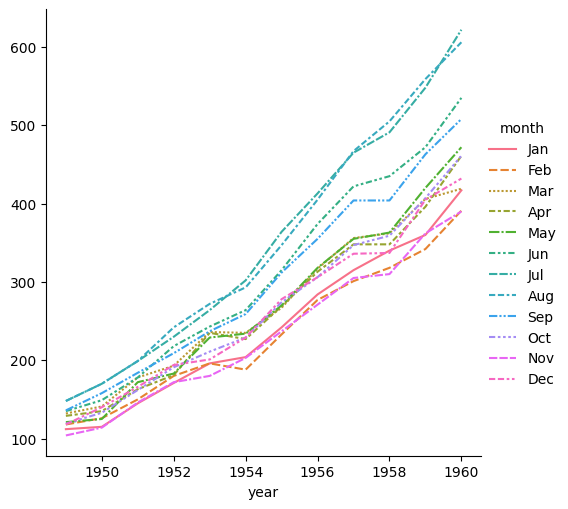

In [276]:
sns.relplot(data=flights_wide, kind='line')

### sns.scatterplot

In [277]:
tips.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


<AxesSubplot:xlabel='total_bill', ylabel='tip'>

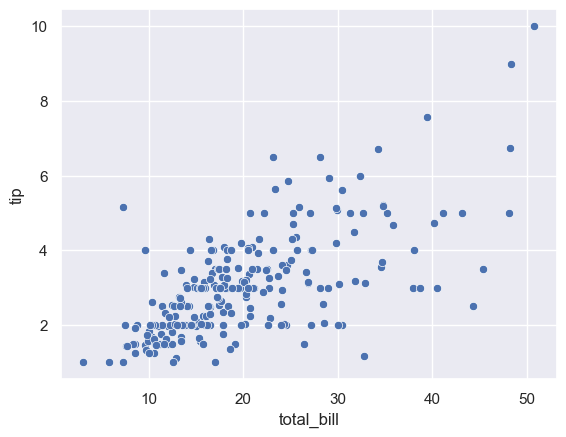

In [278]:
sns.set_theme()
sns.scatterplot(data=tips, x='total_bill', y='tip')

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

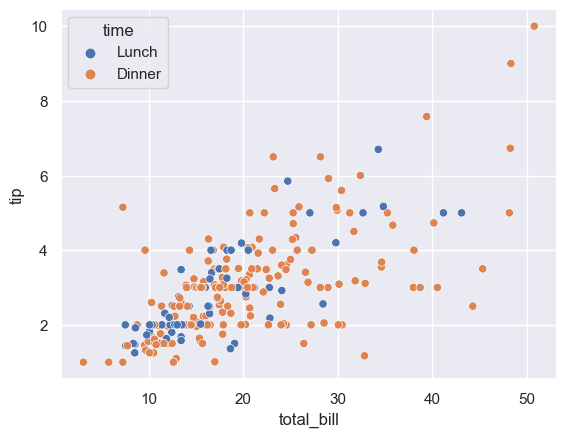

In [279]:
sns.scatterplot(data=tips, x='total_bill', y='tip', hue='time')

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

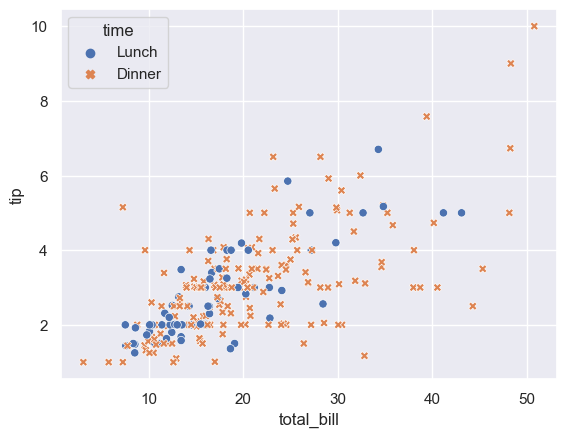

In [280]:
sns.scatterplot(data=tips, x='total_bill', y='tip', hue='time', style='time')

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

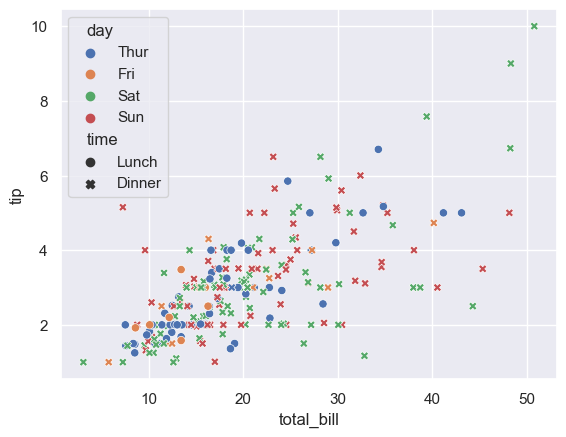

In [281]:
sns.scatterplot(data=tips, x='total_bill', y='tip', hue='day', style='time')

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

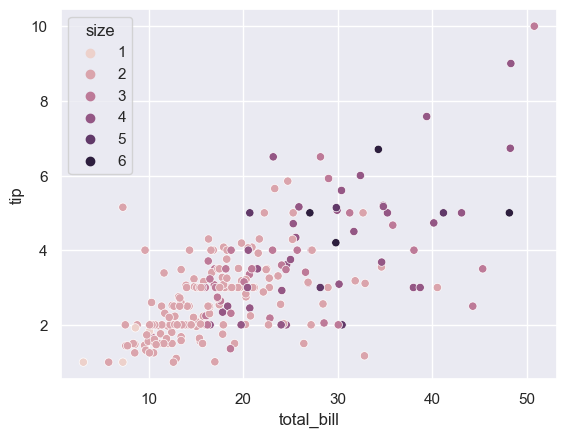

In [282]:
sns.scatterplot(data=tips, x='total_bill', y='tip', hue='size')

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

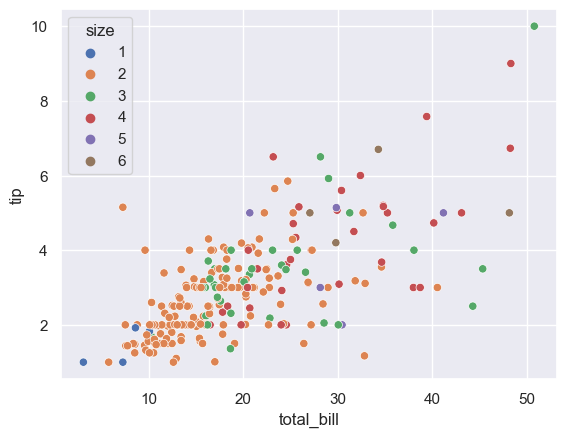

In [283]:
sns.scatterplot(data=tips, x='total_bill', y='tip', hue='size', palette='deep')

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

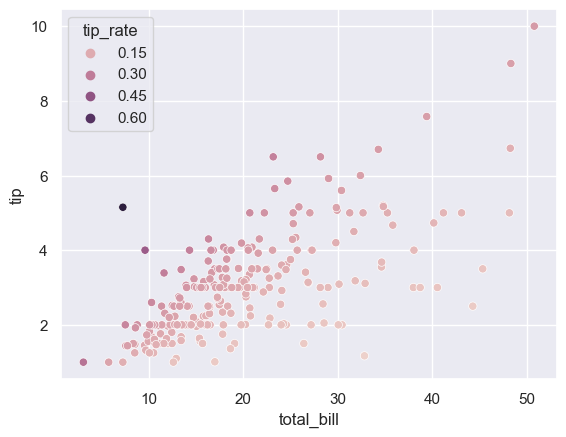

In [284]:
tip_rate = tips.eval('tip / total_bill').rename('tip_rate')
sns.scatterplot(data=tips, x='total_bill', y='tip', hue=tip_rate)

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

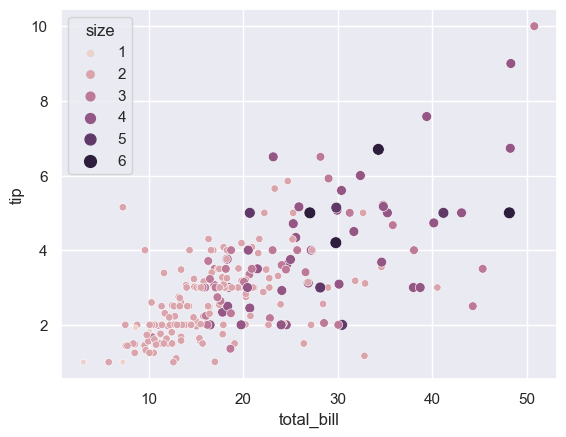

In [285]:
sns.scatterplot(data=tips, x='total_bill', y='tip', hue='size', size='size')

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

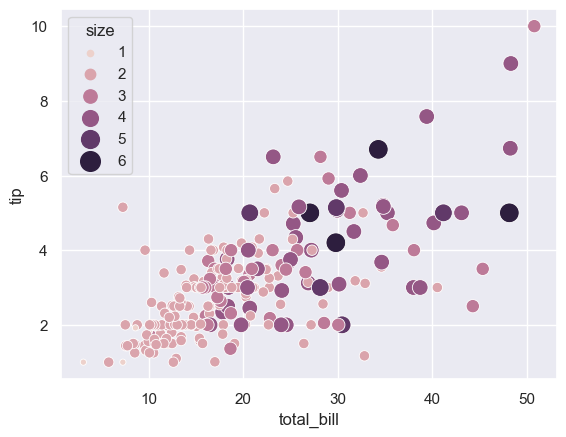

In [286]:
sns.scatterplot(
    data=tips, x='total_bill', y='tip', 
    hue='size', size='size', 
    sizes=(20, 200), legend='full'
)

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

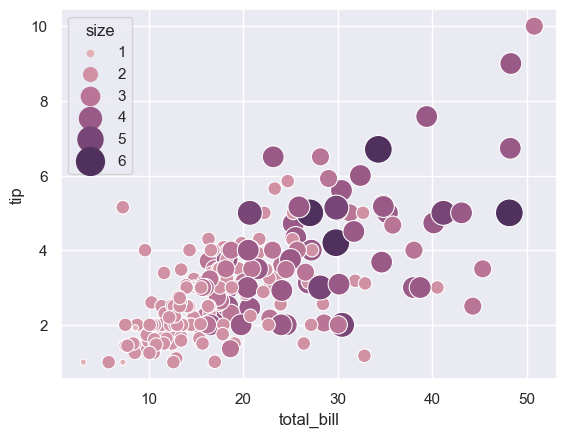

In [287]:
sns.scatterplot(
    data=tips, x='total_bill', y='tip', 
    hue='size', size='size', 
    sizes=(20, 400), legend='full', hue_norm=(0, 7)
)

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

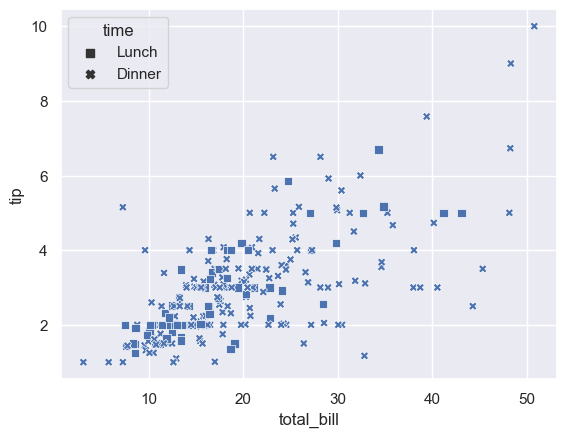

In [288]:
markers = {'Lunch': 's', 'Dinner': 'X'}
sns.scatterplot(data=tips, x='total_bill', y='tip', style='time', markers=markers)

f:\workspace\venv\lib\site-packages\seaborn\relational.py:651: UserWarning: You passed a edgecolor/edgecolors ('w') for an unfilled marker ('+').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  points = ax.scatter(*args, **kws)


<AxesSubplot:xlabel='total_bill', ylabel='tip'>

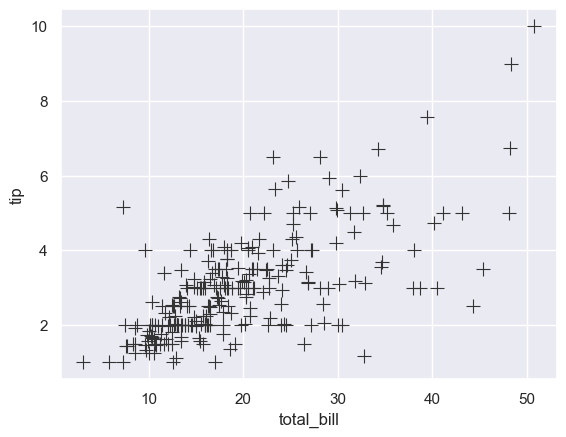

In [289]:
sns.scatterplot(data=tips, x='total_bill', y='tip', s=100, color='.2', marker='+')

<AxesSubplot:xlabel='date'>

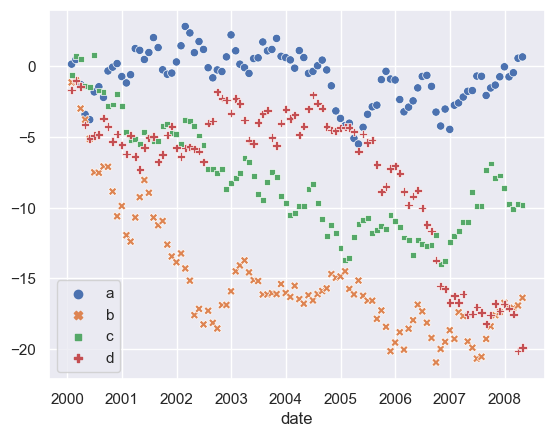

In [290]:
index = pd.date_range('1 1 2000', periods=100, freq='m', name='date')
data  = np.random.randn(100, 4).cumsum(axis=0)
wide_df = pd.DataFrame(data, index, ['a', 'b', 'c', 'd'])
sns.scatterplot(data=wide_df)

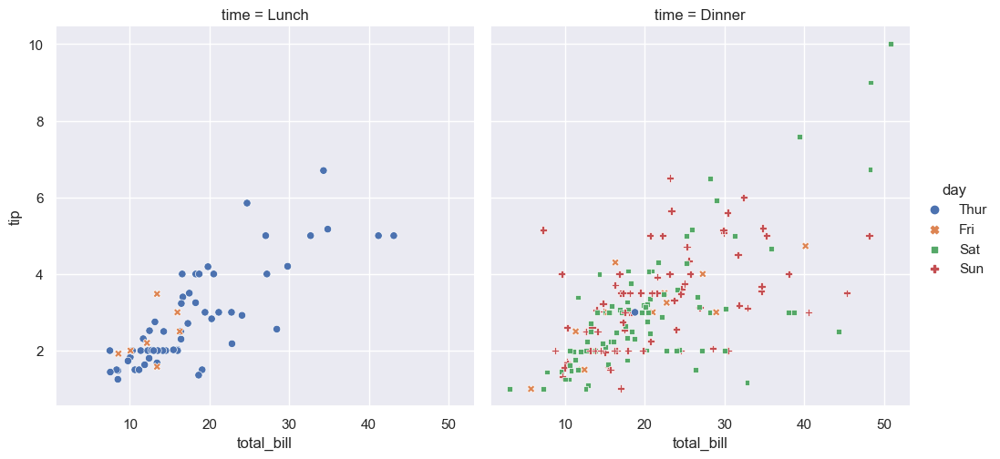

In [291]:
sns.relplot(
    data=tips, x='total_bill', y='tip', 
    col='time', hue='day', style='day', 
    kind='scatter'
)

### sns.lineplot

In [292]:
flights.head()

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121


<AxesSubplot:xlabel='year', ylabel='passengers'>

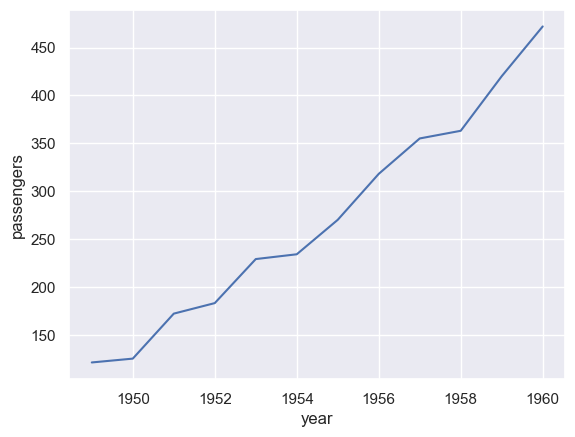

In [293]:
may_flights = flights.query('month == "May"')
sns.lineplot(data=may_flights, x='year', y='passengers')

In [294]:
flights_wide = flights.pivot('year', 'month', 'passengers')
flights_wide.head()

month,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec
year,,,,,,,,,,,,
1949,112,118,132,129,121,135,148,148,136,119,104,118
1950,115,126,141,135,125,149,170,170,158,133,114,140
1951,145,150,178,163,172,178,199,199,184,162,146,166
1952,171,180,193,181,183,218,230,242,209,191,172,194
1953,196,196,236,235,229,243,264,272,237,211,180,201


<AxesSubplot:xlabel='year', ylabel='May'>

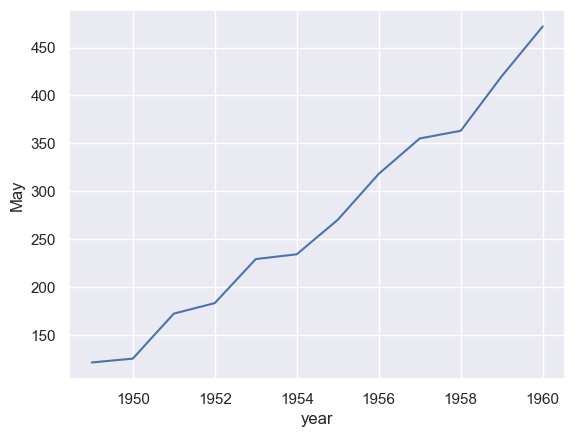

In [295]:
sns.lineplot(data=flights_wide['May'])

<AxesSubplot:xlabel='year'>

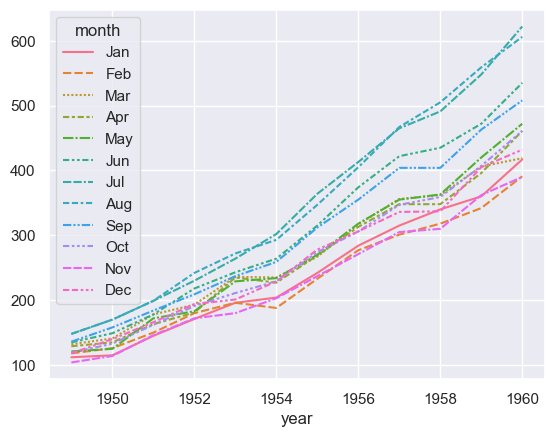

In [296]:
sns.lineplot(data=flights_wide)

<AxesSubplot:xlabel='year', ylabel='passengers'>

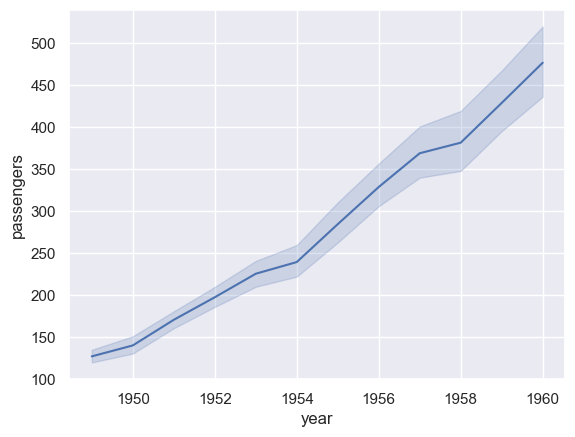

In [297]:
sns.lineplot(data=flights, x='year', y='passengers')

<AxesSubplot:xlabel='year', ylabel='passengers'>

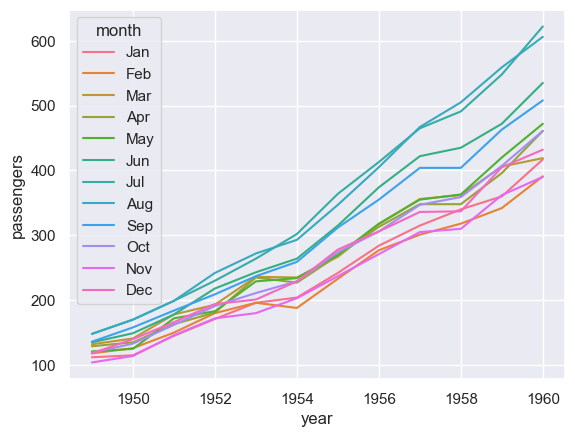

In [298]:
sns.lineplot(data=flights, x='year', y='passengers', hue='month')

<AxesSubplot:xlabel='year', ylabel='passengers'>

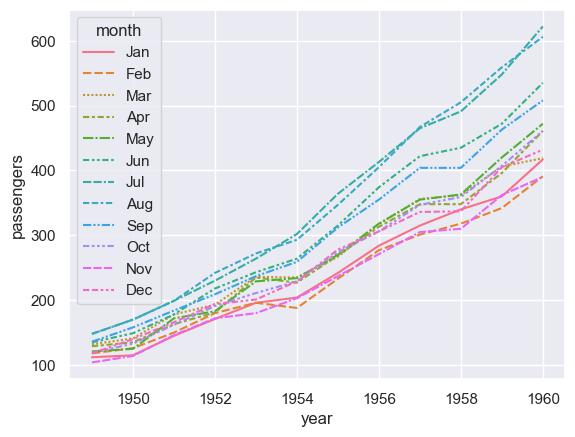

In [299]:
sns.lineplot(data=flights, x='year', y='passengers', hue='month', style='month')

In [300]:
fmri.head()

,subject,timepoint,event,region,signal
0,s13,18,stim,parietal,-0.017552
1,s5,14,stim,parietal,-0.080883
2,s12,18,stim,parietal,-0.081033
3,s11,18,stim,parietal,-0.046134
4,s10,18,stim,parietal,-0.037970


<AxesSubplot:xlabel='timepoint', ylabel='signal'>

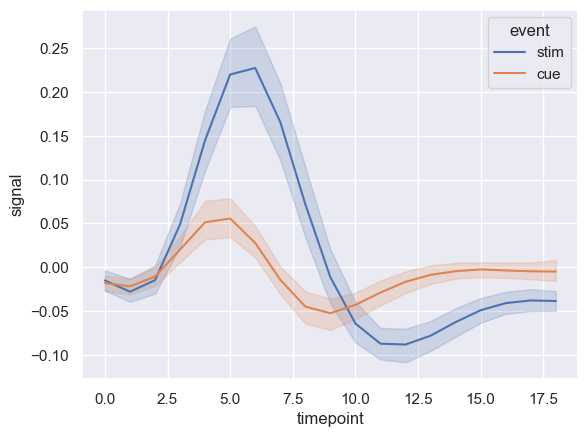

In [301]:
sns.lineplot(data=fmri, x='timepoint', y='signal', hue='event')

<AxesSubplot:xlabel='timepoint', ylabel='signal'>

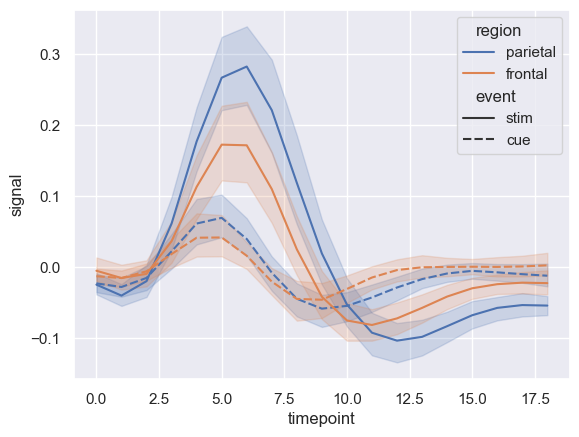

In [302]:
sns.lineplot(data=fmri, x='timepoint', y='signal', hue='region', style='event')

<AxesSubplot:xlabel='timepoint', ylabel='signal'>

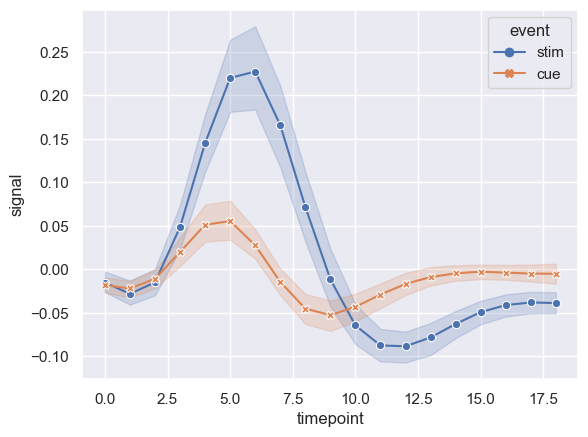

In [303]:
sns.lineplot(
    data=fmri, x='timepoint', y='signal', 
    hue='event', style='event', markers=True, dashes=False
)

<AxesSubplot:xlabel='timepoint', ylabel='signal'>

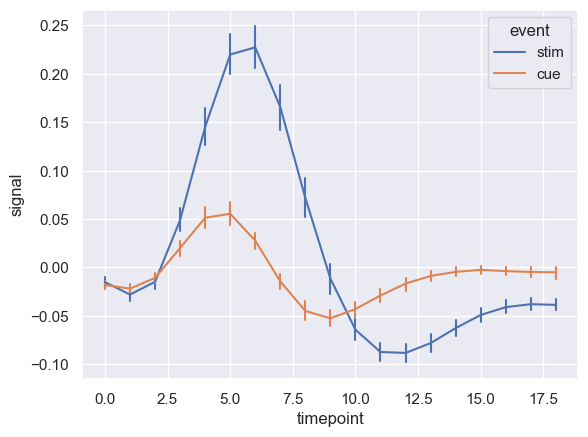

In [304]:
sns.lineplot(
    data=fmri, x='timepoint', y='signal', 
    hue='event', err_style='bars', ci=68
)

<AxesSubplot:xlabel='timepoint', ylabel='signal'>

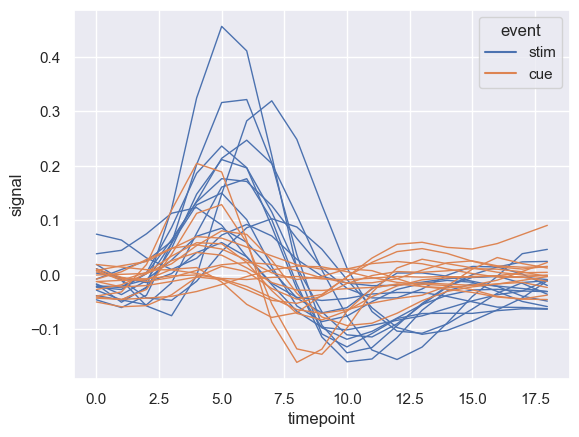

In [305]:
sns.lineplot(
    data=fmri.query('region == "frontal"'), 
    x='timepoint', y='signal', hue='event', 
    units='subject', estimator=None, lw=1, 
)

In [306]:
dots = sns.load_dataset('dots').query("align == 'dots'")
dots.head()

,align,choice,time,coherence,firing_rate
0,dots,T1,-80,0.0,33.189967
1,dots,T1,-80,3.2,31.691726
2,dots,T1,-80,6.4,34.279840
3,dots,T1,-80,12.8,32.631874
4,dots,T1,-80,25.6,35.060487


<AxesSubplot:xlabel='time', ylabel='firing_rate'>

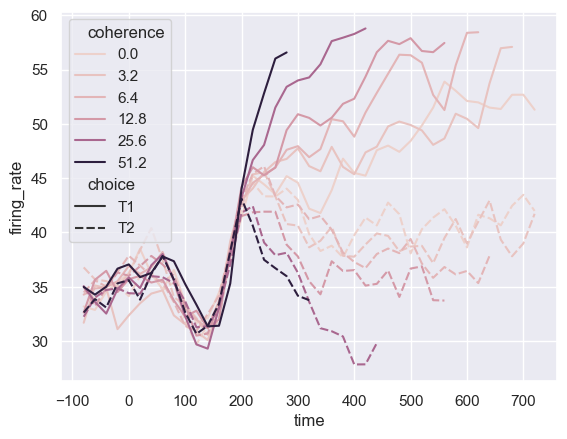

In [307]:
sns.lineplot(
    data=dots, x='time', y='firing_rate', 
    hue='coherence', style='choice', 
)

<AxesSubplot:xlabel='time', ylabel='firing_rate'>

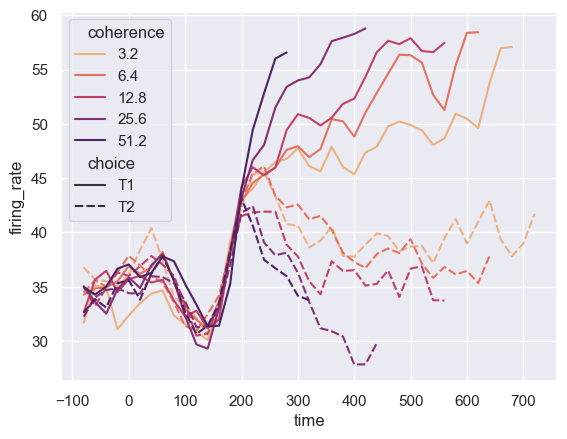

In [308]:
import matplotlib as mpl

sns.lineplot(
    data=dots.query('coherence > 0'), x='time', y='firing_rate', 
    hue='coherence', style='choice', 
    palette='flare', hue_norm=mpl.colors.LogNorm(), 
)

<AxesSubplot:xlabel='time', ylabel='firing_rate'>

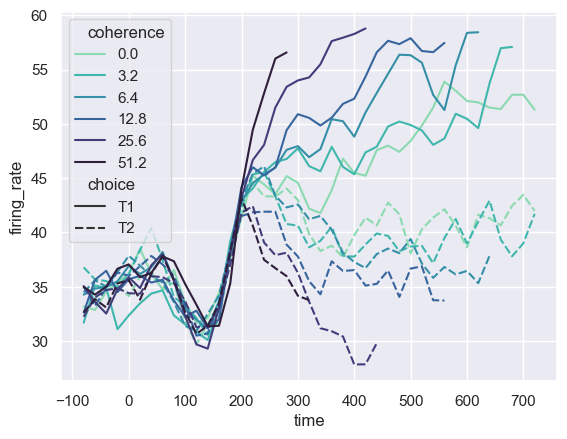

In [309]:
palette = sns.color_palette('mako_r', 6)
sns.lineplot(
    data=dots, x='time', y='firing_rate', 
    hue='coherence', style='choice', 
    palette=palette
)

<AxesSubplot:xlabel='time', ylabel='firing_rate'>

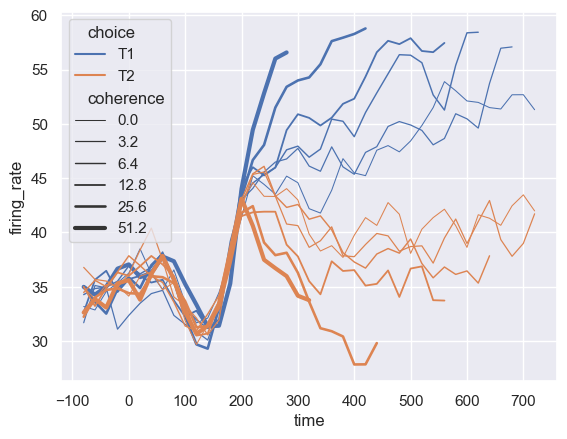

In [310]:
sns.lineplot(
    data=dots, x='time', y='firing_rate', 
    hue='choice', size='coherence', legend='full'
)

<AxesSubplot:xlabel='time', ylabel='firing_rate'>

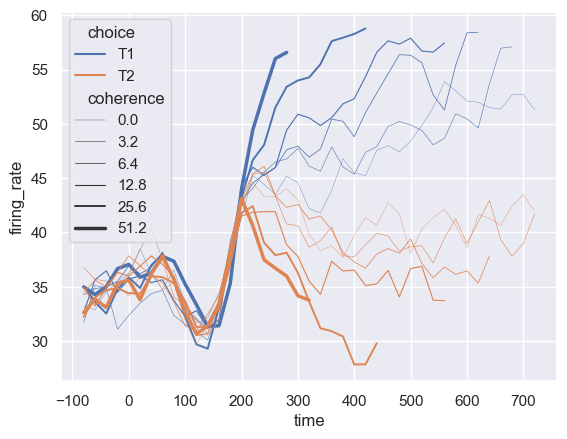

In [311]:
sns.lineplot(
    data=dots, x='time', y='firing_rate', 
    hue='choice', size='coherence', sizes=(.25, 2.5)
)

<AxesSubplot:>

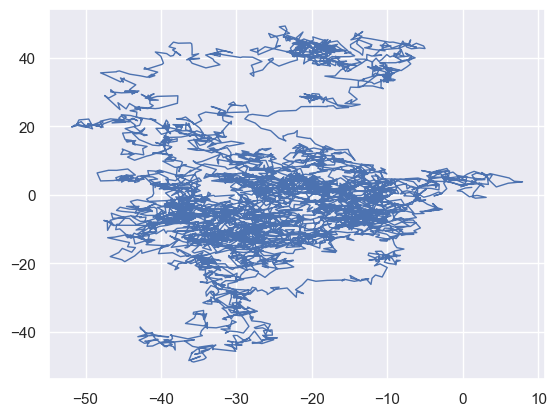

In [312]:
x, y = np.random.normal(size=(2, 5000)).cumsum(axis=1)
sns.lineplot(x=x, y=y, sort=False, lw=1)

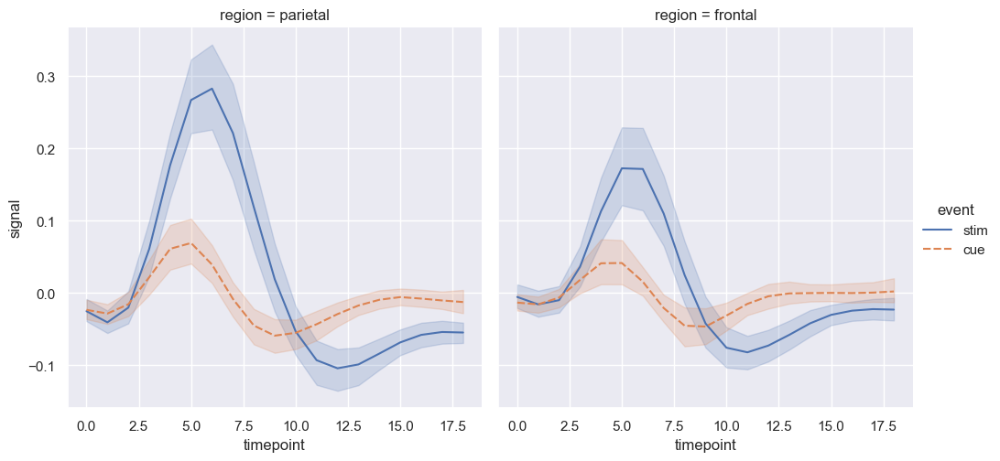

In [313]:
sns.relplot(
    data=fmri, x='timepoint', y='signal', 
    col='region', hue='event', style='event', kind='line'
)

## Distribution plots

### sns.displot

In [314]:
penguins.head()

,species,island,bill_length_mm,bill_depth_mm,flipper_length_mm,body_mass_g,sex
0,Adelie,Torgersen,39.1,18.7,181.0,3750.0,Male
1,Adelie,Torgersen,39.5,17.4,186.0,3800.0,Female
2,Adelie,Torgersen,40.3,18.0,195.0,3250.0,Female
3,Adelie,Torgersen,NaN,NaN,NaN,NaN,NaN
4,Adelie,Torgersen,36.7,19.3,193.0,3450.0,Female


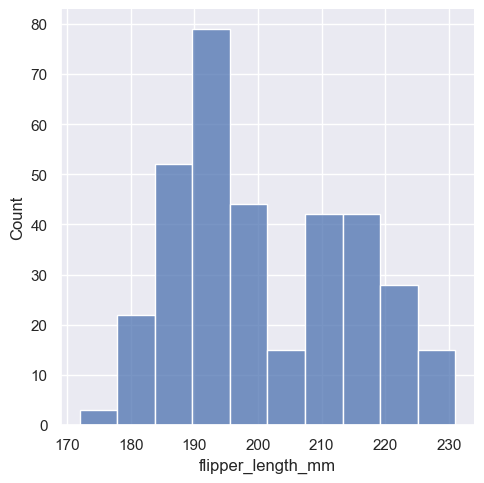

In [315]:
sns.displot(data=penguins, x='flipper_length_mm')

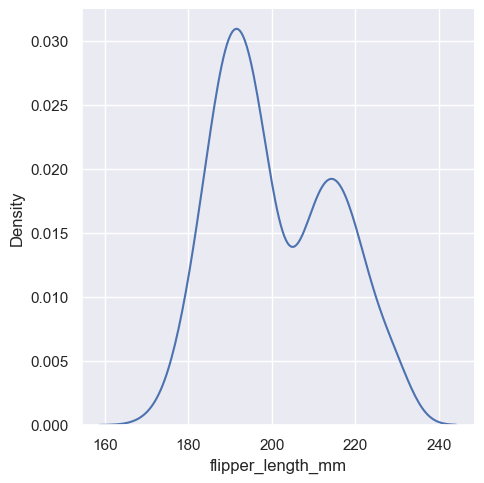

In [316]:
sns.displot(data=penguins, x='flipper_length_mm', kind='kde')

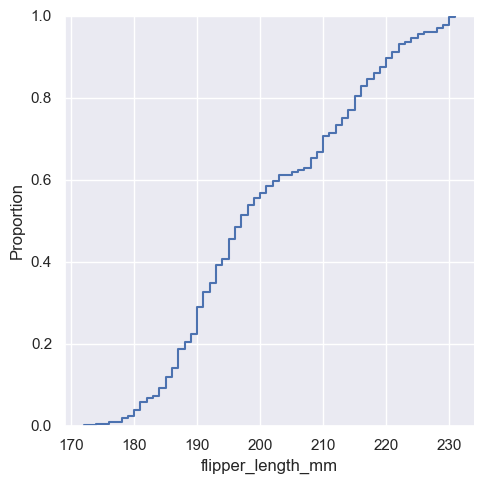

In [317]:
sns.displot(data=penguins, x='flipper_length_mm', kind='ecdf')

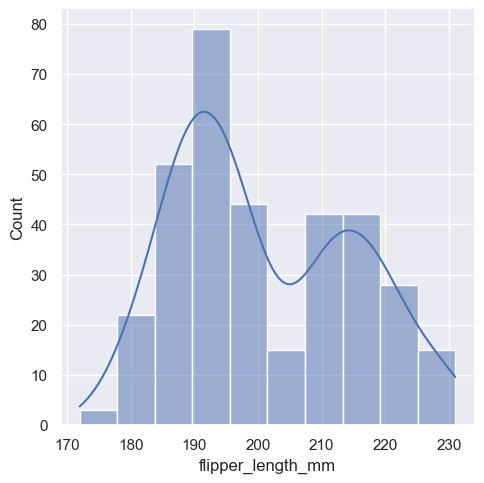

In [318]:
sns.displot(data=penguins, x='flipper_length_mm', kde=True)

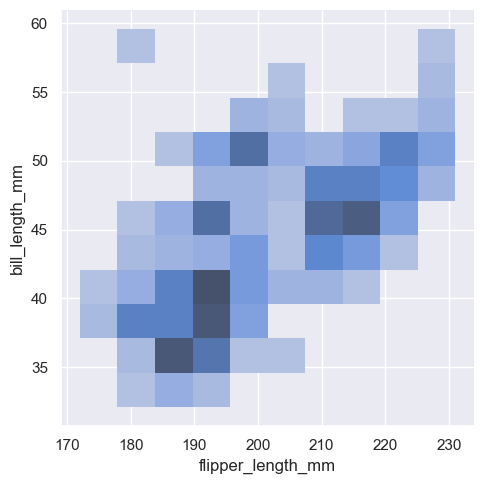

In [319]:
sns.displot(data=penguins, x='flipper_length_mm', y='bill_length_mm')

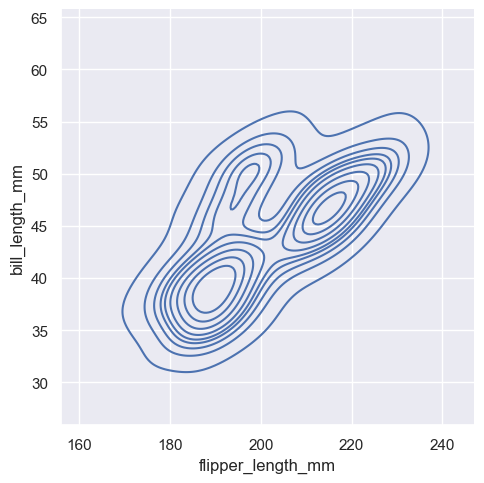

In [320]:
sns.displot(data=penguins, x='flipper_length_mm', y='bill_length_mm', kind='kde')

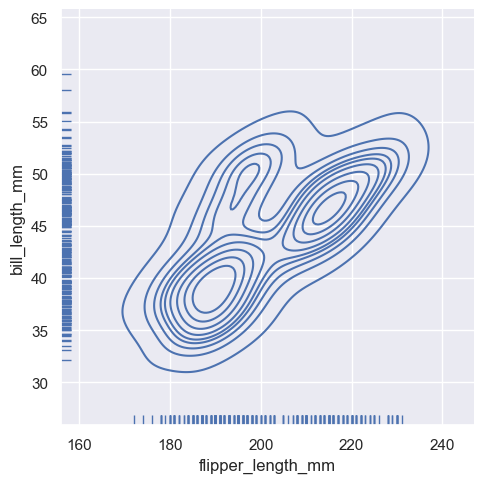

In [321]:
g = sns.displot(data=penguins, x='flipper_length_mm', y='bill_length_mm', kind='kde', rug=True)

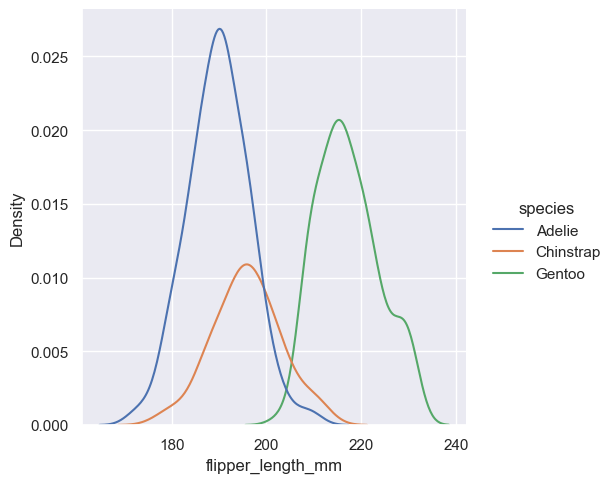

In [322]:
sns.displot(data=penguins, x='flipper_length_mm', hue='species', kind='kde')

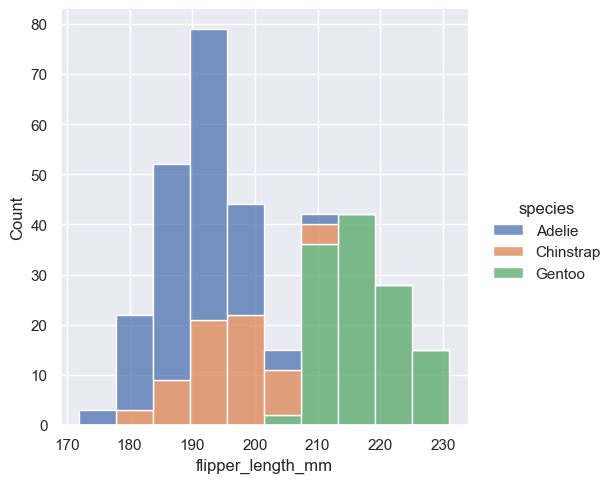

In [323]:
sns.displot(data=penguins, x='flipper_length_mm', hue='species', multiple='stack')

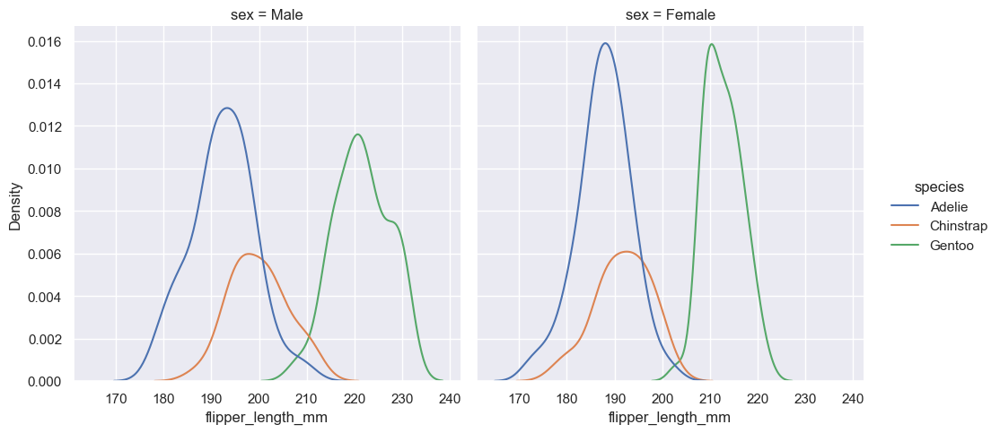

In [324]:
sns.displot(data=penguins, x='flipper_length_mm', hue='species', col='sex', kind='kde')

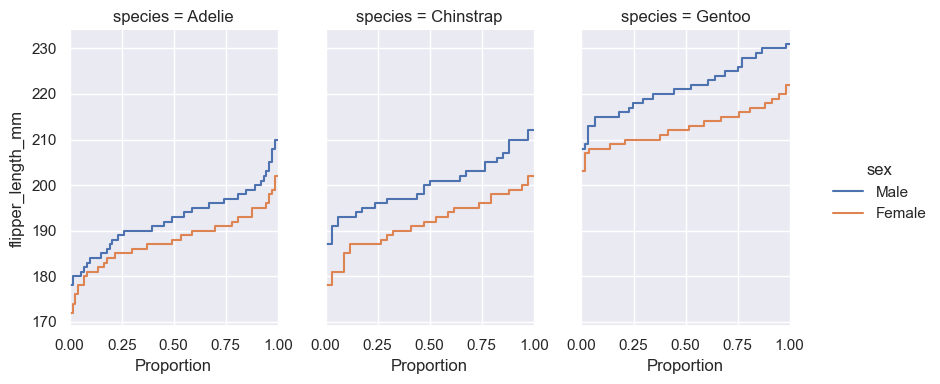

In [325]:
sns.displot(
    data=penguins, y='flipper_length_mm', 
    hue='sex', col='species', 
    kind='ecdf', height=4, aspect=.7
)

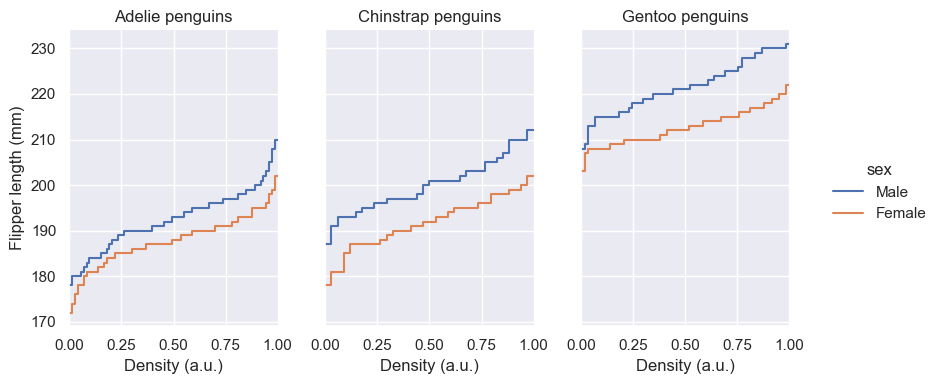

In [326]:
g = sns.displot(
    data=penguins, y='flipper_length_mm', 
    hue='sex', col='species', 
    kind='ecdf', height=4, aspect=.7
)
g.set_axis_labels('Density (a.u.)', 'Flipper length (mm)')
g.set_titles('{col_name} penguins')

### sns.histplot

<AxesSubplot:xlabel='Count', ylabel='flipper_length_mm'>

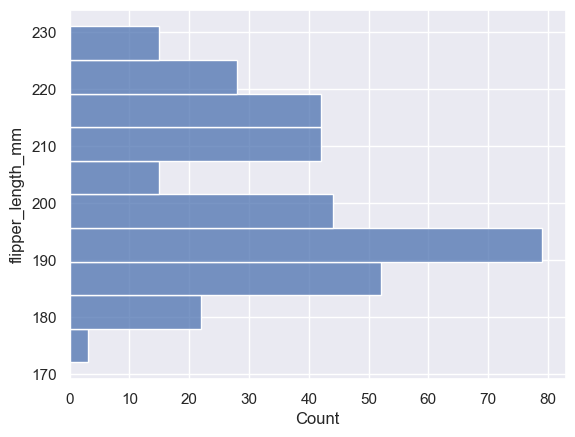

In [327]:
sns.histplot(data=penguins, y='flipper_length_mm')

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Count'>

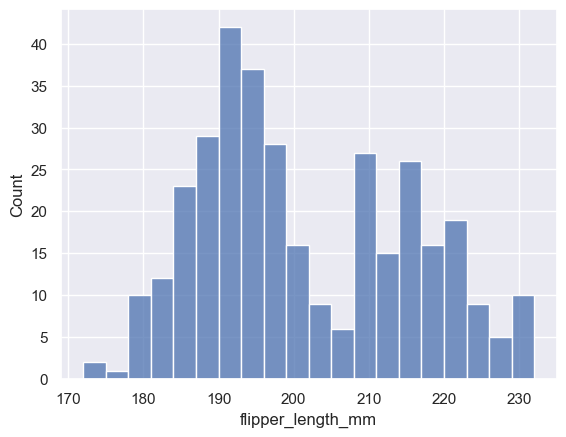

In [328]:
sns.histplot(data=penguins, x='flipper_length_mm', binwidth=3)

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Count'>

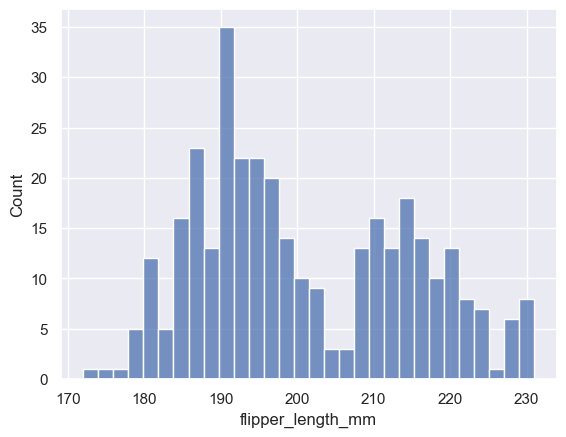

In [329]:
sns.histplot(data=penguins, x='flipper_length_mm', bins=30)

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Count'>

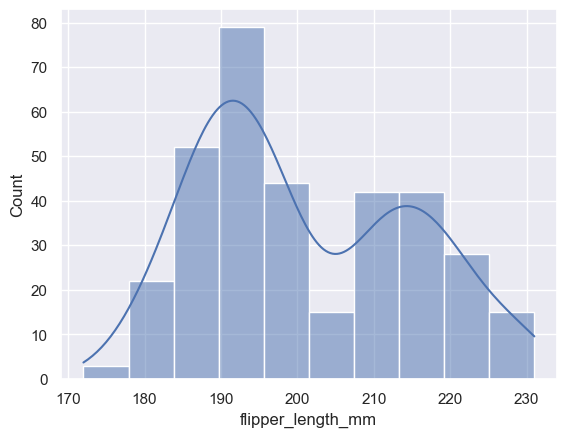

In [330]:
sns.histplot(data=penguins, x='flipper_length_mm', kde=True)

<AxesSubplot:ylabel='Count'>

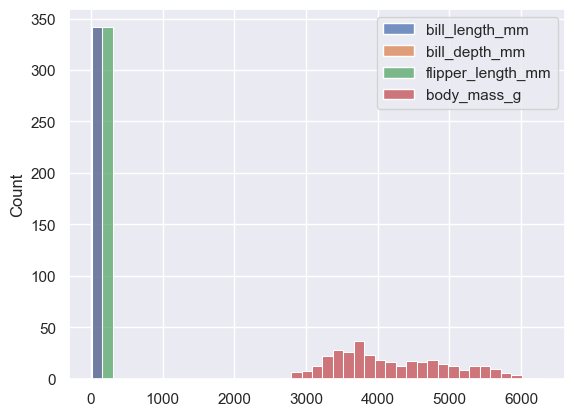

In [331]:
sns.histplot(data=penguins)

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Count'>

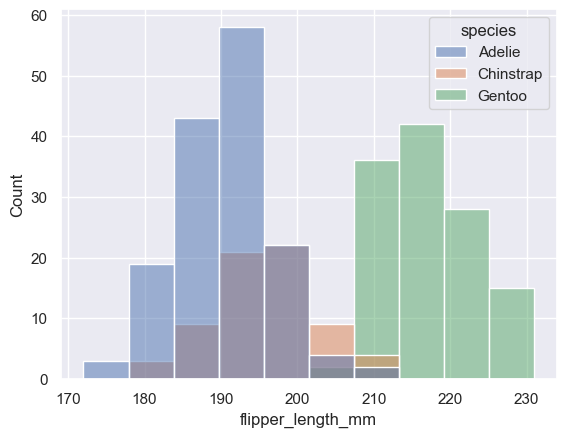

In [332]:
sns.histplot(data=penguins, x='flipper_length_mm', hue='species')

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Count'>

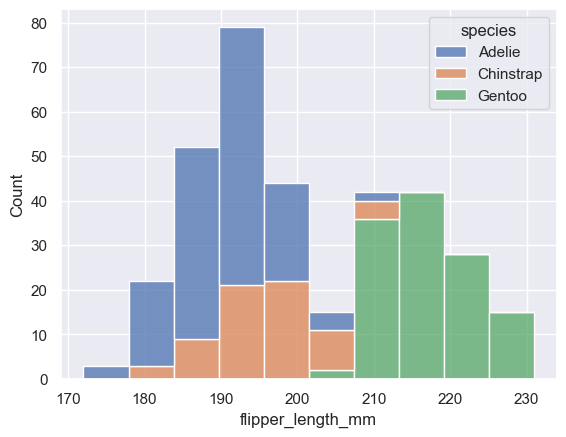

In [333]:
sns.histplot(data=penguins, x='flipper_length_mm', hue='species', multiple='stack')

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Count'>

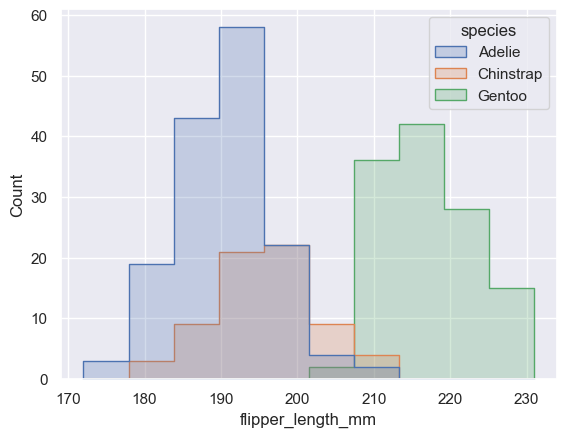

In [334]:
sns.histplot(data=penguins, x='flipper_length_mm', hue='species', element='step')

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Count'>

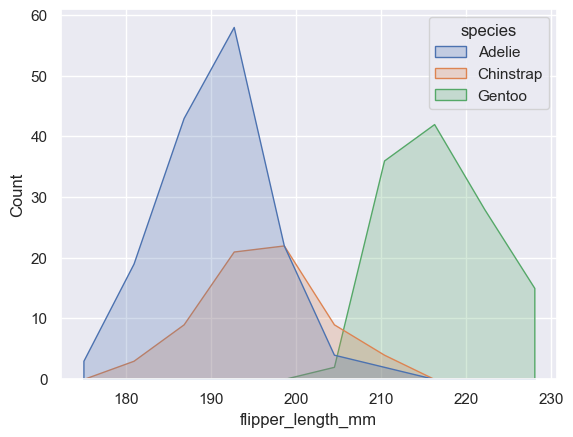

In [335]:
sns.histplot(data=penguins, x='flipper_length_mm', hue='species', element='poly')

<AxesSubplot:xlabel='flipper_length_mm', ylabel='Density'>

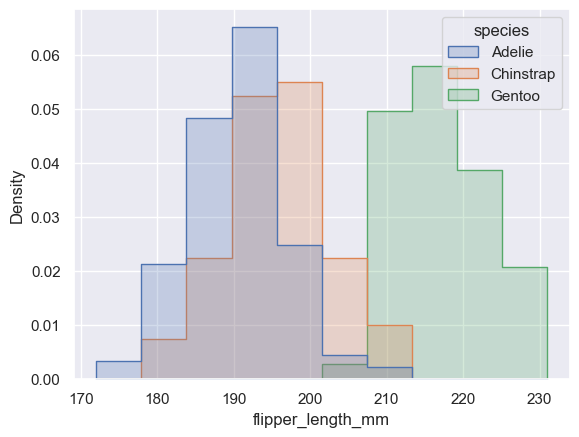

In [336]:
sns.histplot(data=penguins, x='flipper_length_mm', hue='species', element='step', 
             stat='density', common_norm=False)

In [337]:
tips.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


<AxesSubplot:xlabel='size', ylabel='Probability'>

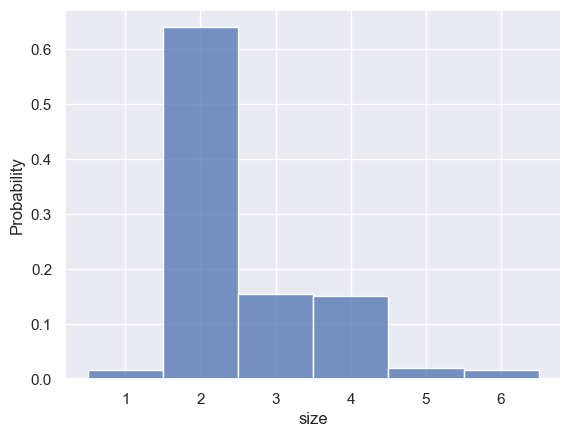

In [338]:
sns.histplot(data=tips, x='size', stat='probability', discrete=True)

<AxesSubplot:xlabel='day', ylabel='Count'>

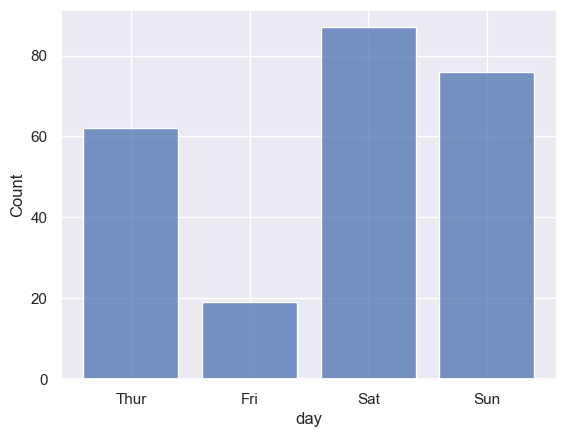

In [339]:
sns.histplot(data=tips, x='day', shrink=.8)

<AxesSubplot:xlabel='day', ylabel='Count'>

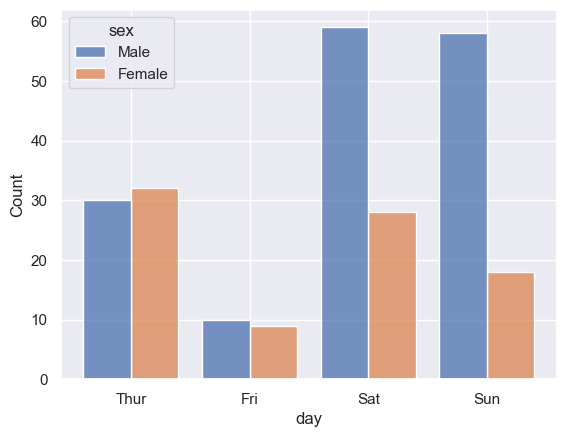

In [340]:
sns.histplot(data=tips, x='day', shrink=.8, multiple='dodge', hue='sex')

In [341]:
planets = sns.load_dataset('planets')
planets

,method,number,orbital_period,mass,distance,year
0,Radial Velocity,1,269.300000,7.10,77.40,2006
1,Radial Velocity,1,874.774000,2.21,56.95,2008
2,Radial Velocity,1,763.000000,2.60,19.84,2011
3,Radial Velocity,1,326.030000,19.40,110.62,2007
4,Radial Velocity,1,516.220000,10.50,119.47,2009
...,...,...,...,...,...,...
1030,Transit,1,3.941507,NaN,172.00,2006
1031,Transit,1,2.615864,NaN,148.00,2007
1032,Transit,1,3.191524,NaN,174.00,2007
1033,Transit,1,4.125083,NaN,293.00,2008


<AxesSubplot:xlabel='distance', ylabel='Count'>

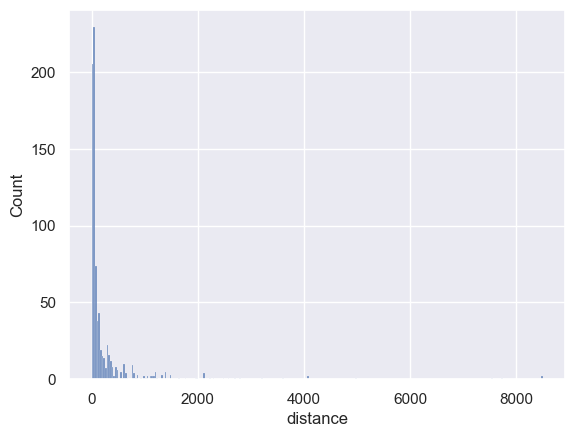

In [342]:
sns.histplot(data=planets, x='distance')

<AxesSubplot:xlabel='distance', ylabel='Count'>

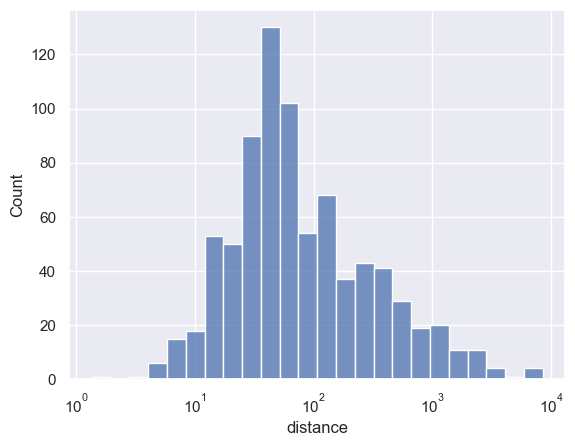

In [343]:
sns.histplot(data=planets, x='distance', log_scale=True)

<AxesSubplot:xlabel='distance', ylabel='Count'>

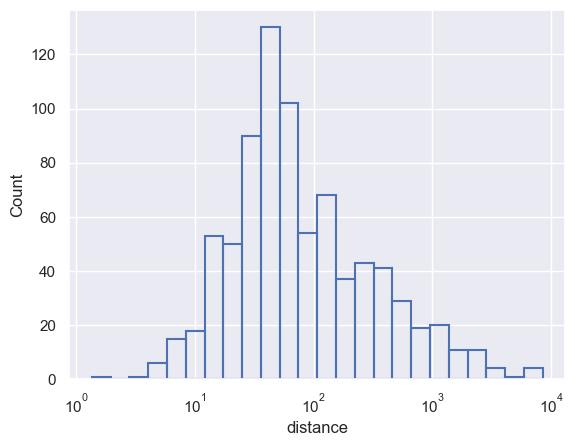

In [344]:
sns.histplot(data=planets, x='distance', log_scale=True, fill=False)

<AxesSubplot:xlabel='distance', ylabel='Count'>

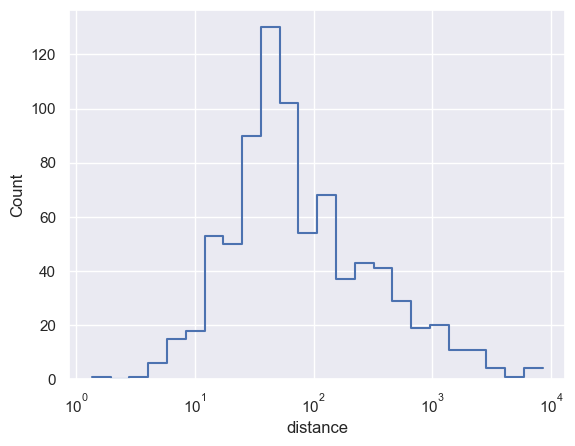

In [345]:
sns.histplot(data=planets, x='distance', log_scale=True, fill=False, element='step')

<AxesSubplot:xlabel='distance', ylabel='Density'>

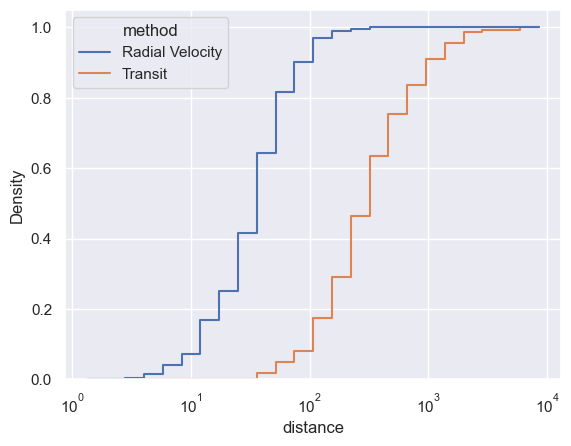

In [346]:
sns.histplot(
    data=planets, x='distance', hue='method', 
    hue_order=['Radial Velocity', 'Transit'], 
    log_scale=True, element='step', fill=False, 
    cumulative=True, stat='density', common_norm=False, 
)

<AxesSubplot:xlabel='bill_depth_mm', ylabel='body_mass_g'>

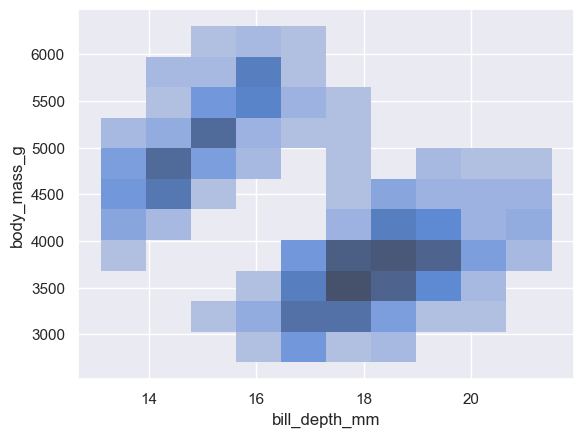

In [347]:
sns.histplot(penguins, x='bill_depth_mm', y='body_mass_g')

<AxesSubplot:xlabel='bill_depth_mm', ylabel='body_mass_g'>

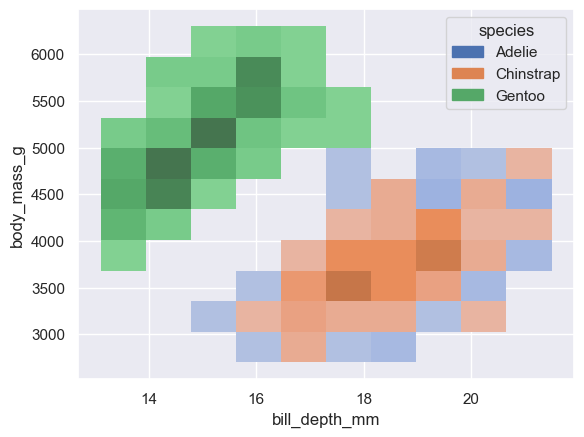

In [348]:
sns.histplot(penguins, x='bill_depth_mm', y='body_mass_g', hue='species')

<AxesSubplot:xlabel='bill_depth_mm', ylabel='species'>

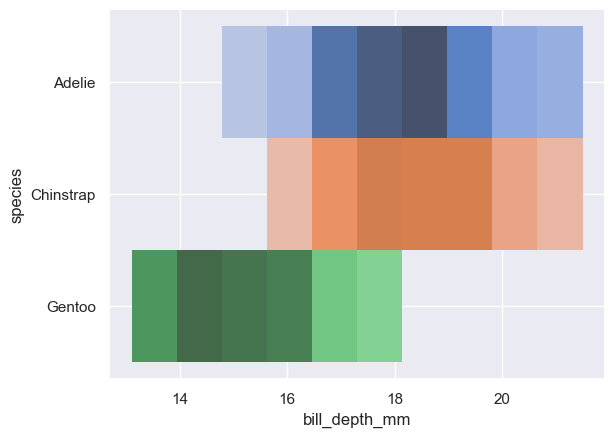

In [349]:
sns.histplot(penguins, x='bill_depth_mm', y='species', hue='species', legend=False)

<AxesSubplot:xlabel='year', ylabel='distance'>

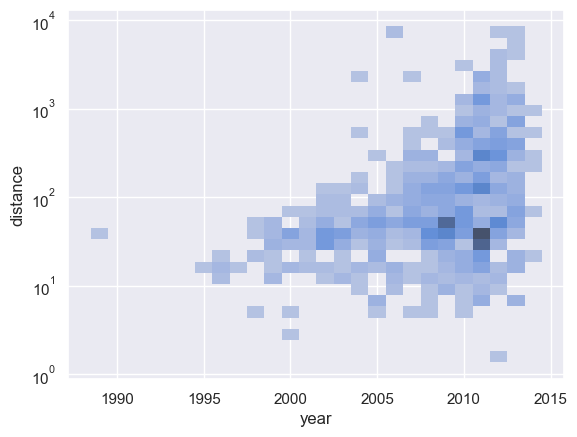

In [350]:
sns.histplot(
    planets, x='year', y='distance', 
    bins=30, discrete=(True, False), log_scale=(False, True)
)

<AxesSubplot:xlabel='year', ylabel='distance'>

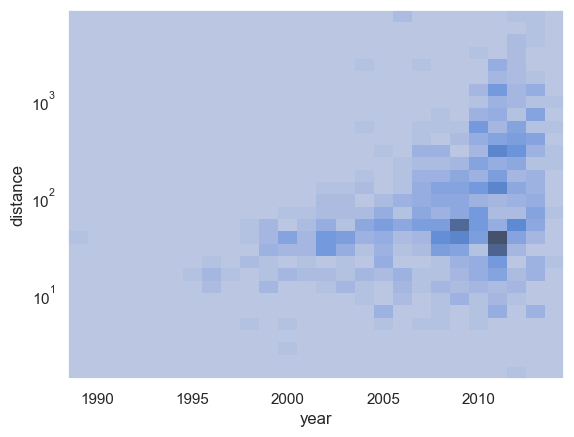

In [351]:
sns.histplot(
    planets, x='year', y='distance', 
    bins=30, discrete=(True, False), log_scale=(False, True), 
    thresh=None, 
)

<AxesSubplot:xlabel='year', ylabel='distance'>

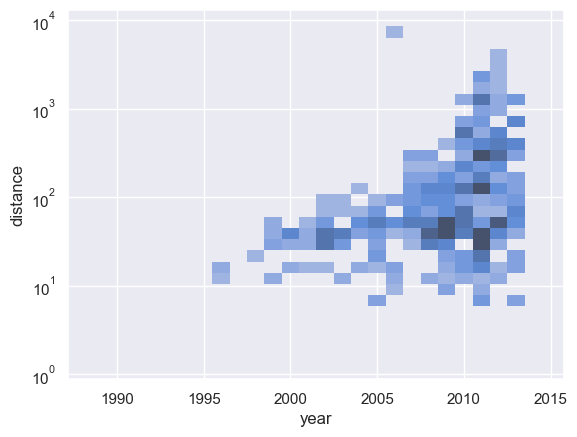

In [352]:
sns.histplot(
    planets, x='year', y='distance', 
    bins=30, discrete=(True, False), log_scale=(False, True), 
    pthresh=.05, pmax=.9, 
)

<AxesSubplot:xlabel='year', ylabel='distance'>

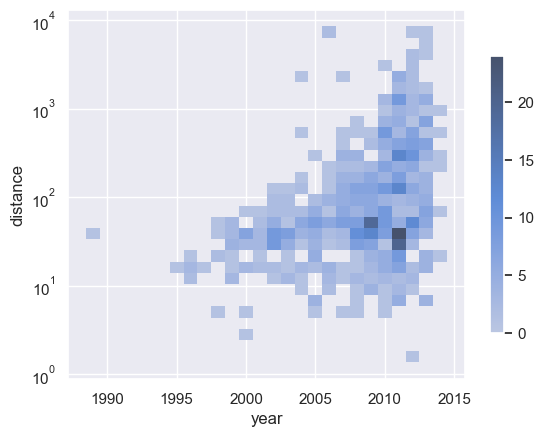

In [353]:
sns.histplot(
    planets, x='year', y='distance', 
    bins=30, discrete=(True, False), log_scale=(False, True), 
    cbar=True, cbar_kws=dict(shrink=.75)
)

### sns.kdeplot

<AxesSubplot:xlabel='total_bill', ylabel='Density'>

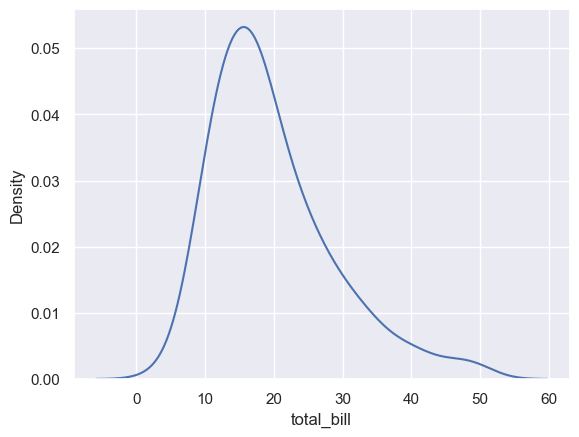

In [354]:
sns.kdeplot(data=tips, x='total_bill')

<AxesSubplot:xlabel='Density', ylabel='total_bill'>

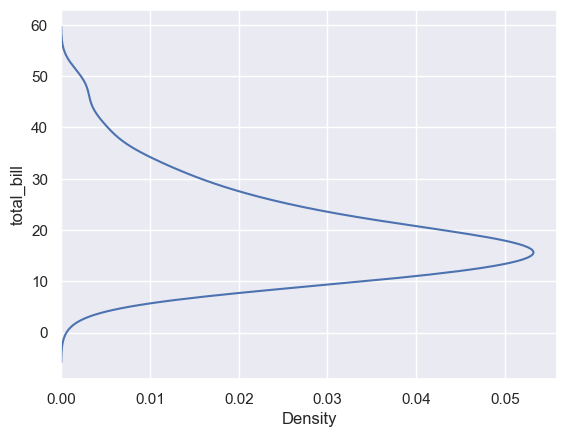

In [355]:
sns.kdeplot(data=tips, y='total_bill')

<AxesSubplot:ylabel='Density'>

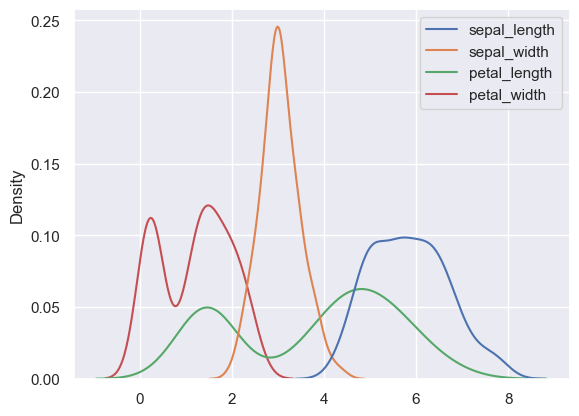

In [356]:
sns.kdeplot(data=iris)

<AxesSubplot:xlabel='total_bill', ylabel='Density'>

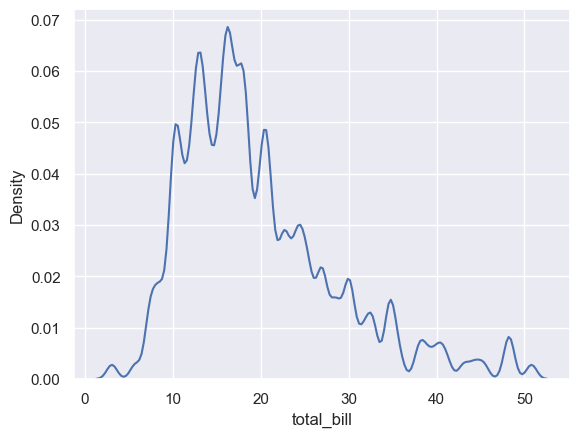

In [357]:
sns.kdeplot(data=tips, x='total_bill', bw_adjust=.2)

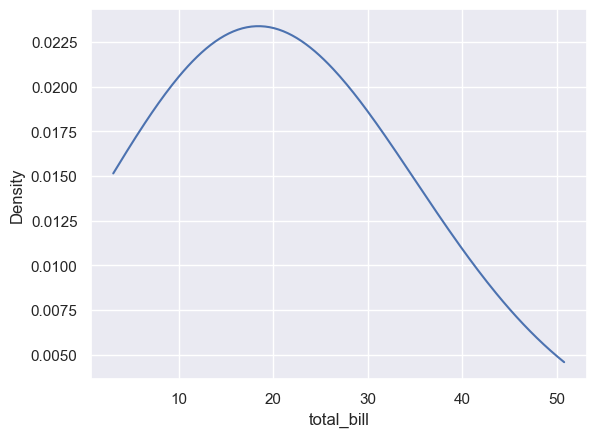

In [358]:
ax = sns.kdeplot(data=tips, x='total_bill', bw_adjust=5, cut=0)

<AxesSubplot:xlabel='total_bill', ylabel='Density'>

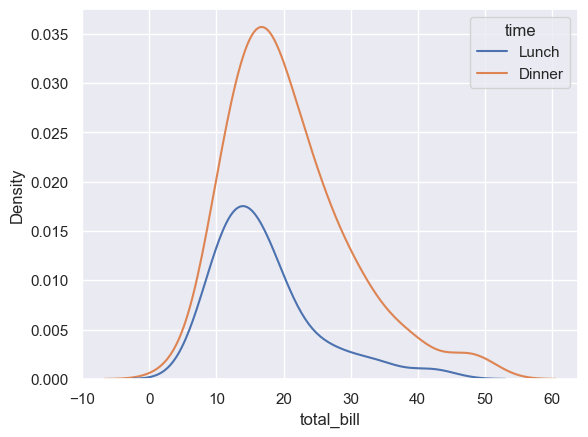

In [359]:
sns.kdeplot(data=tips, x='total_bill', hue='time')

<AxesSubplot:xlabel='total_bill', ylabel='Density'>

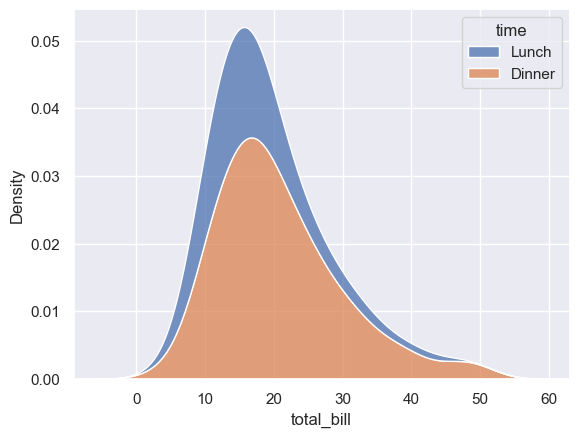

In [360]:
sns.kdeplot(data=tips, x='total_bill', hue='time', multiple='stack')

<AxesSubplot:xlabel='total_bill', ylabel='Density'>

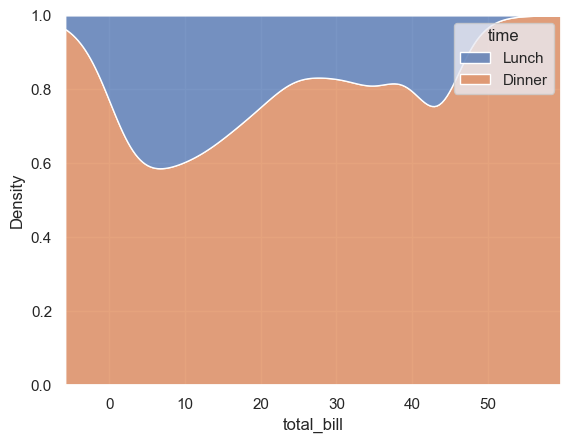

In [361]:
sns.kdeplot(data=tips, x='total_bill', hue='time', multiple='fill')

<AxesSubplot:xlabel='total_bill', ylabel='Density'>

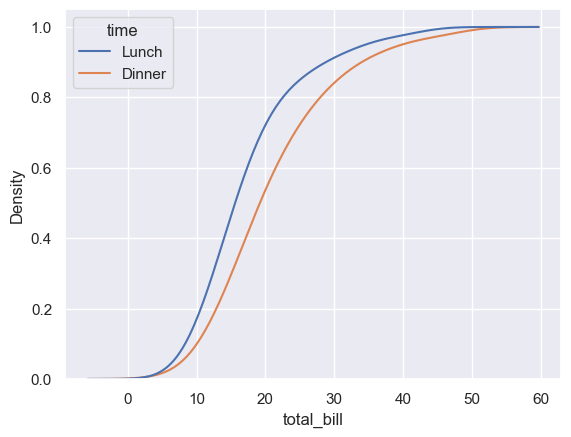

In [362]:
sns.kdeplot(
    data=tips, x='total_bill', hue='time', 
    cumulative=True, common_norm=False, common_grid=True, 
)

<AxesSubplot:xlabel='total_bill', ylabel='Density'>

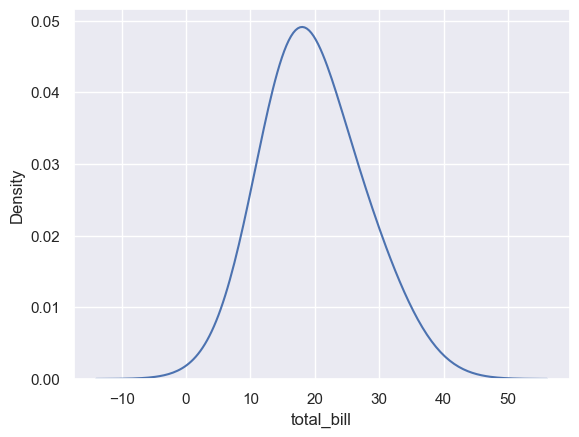

In [363]:
tips_agg = (tips.groupby('size').agg(
    total_bill=('total_bill', 'mean'), n=('total_bill', 'count')
))
sns.kdeplot(data=tips_agg, x='total_bill', weights='n')

In [364]:
diamonds

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


<AxesSubplot:xlabel='price', ylabel='Density'>

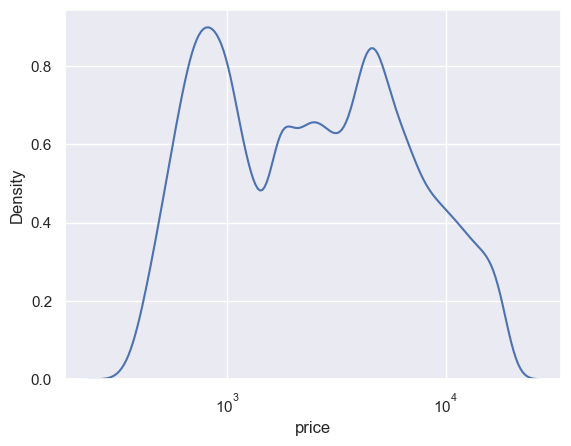

In [365]:
sns.kdeplot(data=diamonds, x='price', log_scale=True)

<AxesSubplot:xlabel='total_bill', ylabel='Density'>

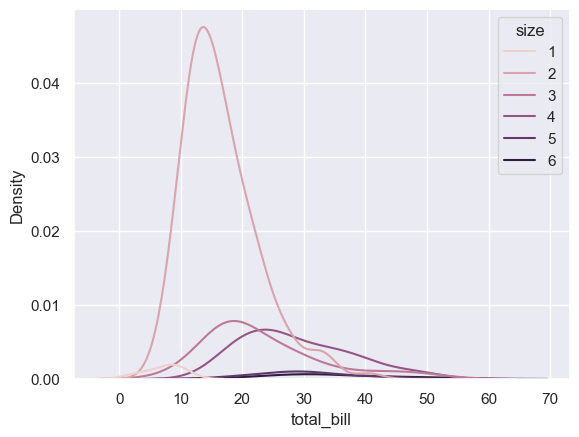

In [366]:
sns.kdeplot(data=tips, x='total_bill', hue='size')

<AxesSubplot:xlabel='total_bill', ylabel='Density'>

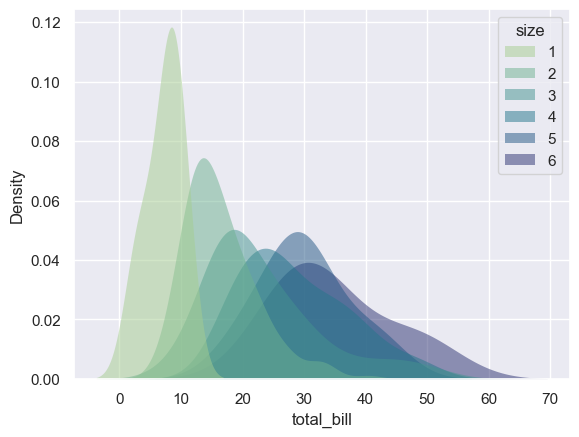

In [367]:
sns.kdeplot(
    data=tips, x='total_bill', hue='size', 
    fill=True, common_norm=False, palette='crest', 
    alpha=.5, linewidth=0, 
)

In [368]:
geyser = sns.load_dataset('geyser')
geyser

,duration,waiting,kind
0,3.600,79,long
1,1.800,54,short
2,3.333,74,long
3,2.283,62,short
4,4.533,85,long
...,...,...,...
267,4.117,81,long
268,2.150,46,short
269,4.417,90,long
270,1.817,46,short


<AxesSubplot:xlabel='waiting', ylabel='duration'>

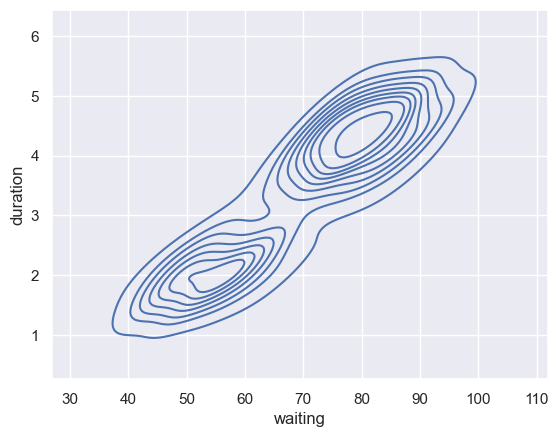

In [369]:
sns.kdeplot(data=geyser, x='waiting', y='duration')

<AxesSubplot:xlabel='waiting', ylabel='duration'>

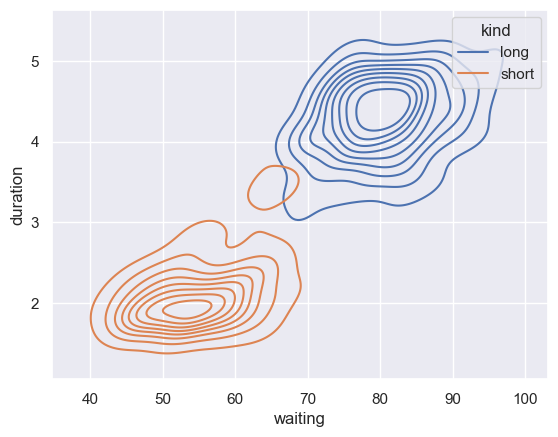

In [370]:
sns.kdeplot(data=geyser, x='waiting', y='duration', hue='kind')

<AxesSubplot:xlabel='waiting', ylabel='duration'>

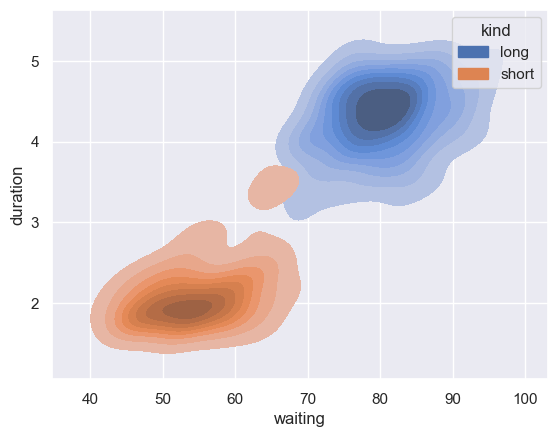

In [371]:
sns.kdeplot(data=geyser, x='waiting', y='duration', hue='kind', fill=True)

<AxesSubplot:xlabel='waiting', ylabel='duration'>

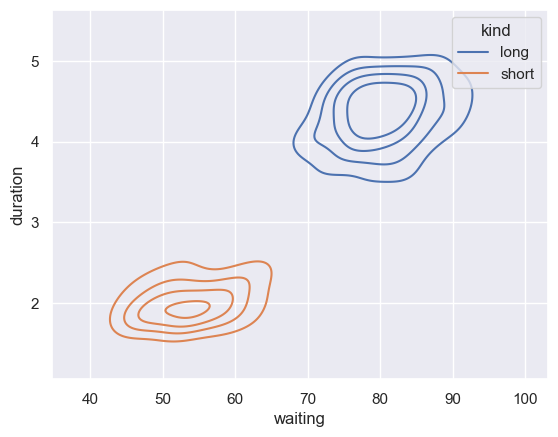

In [372]:
sns.kdeplot(
    data=geyser, x='waiting', y='duration', hue='kind', 
    levels=5, thresh=.2, 
)

<AxesSubplot:xlabel='waiting', ylabel='duration'>

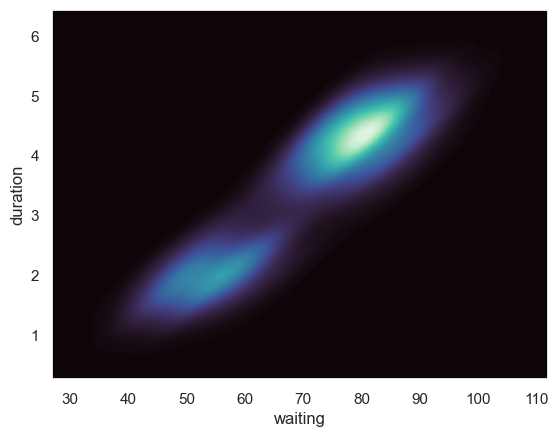

In [373]:
sns.kdeplot(
    data=geyser, x='waiting', y='duration', 
    thresh=0, levels=100, cmap='mako', fill=True
)

### sns.ecdfplot

In [374]:
penguins

,species,island,bill_length_mm,bill_depth_mm,flipper_length_mm,body_mass_g,sex
0,Adelie,Torgersen,39.1,18.7,181.0,3750.0,Male
1,Adelie,Torgersen,39.5,17.4,186.0,3800.0,Female
2,Adelie,Torgersen,40.3,18.0,195.0,3250.0,Female
3,Adelie,Torgersen,NaN,NaN,NaN,NaN,NaN
4,Adelie,Torgersen,36.7,19.3,193.0,3450.0,Female
...,...,...,...,...,...,...,...
339,Gentoo,Biscoe,NaN,NaN,NaN,NaN,NaN
340,Gentoo,Biscoe,46.8,14.3,215.0,4850.0,Female
341,Gentoo,Biscoe,50.4,15.7,222.0,5750.0,Male
342,Gentoo,Biscoe,45.2,14.8,212.0,5200.0,Female


<AxesSubplot:xlabel='flipper_length_mm', ylabel='Proportion'>

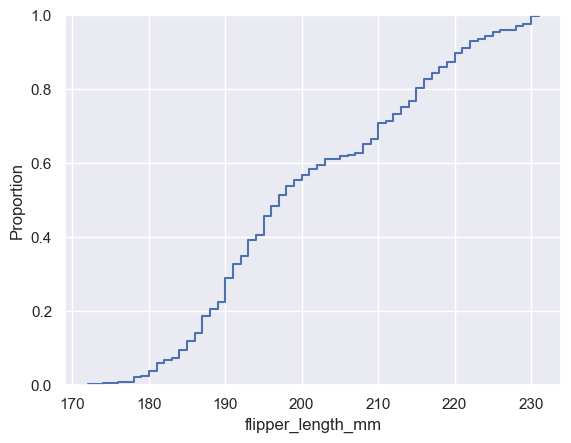

In [375]:
sns.ecdfplot(data=penguins, x='flipper_length_mm')

<AxesSubplot:xlabel='Proportion', ylabel='flipper_length_mm'>

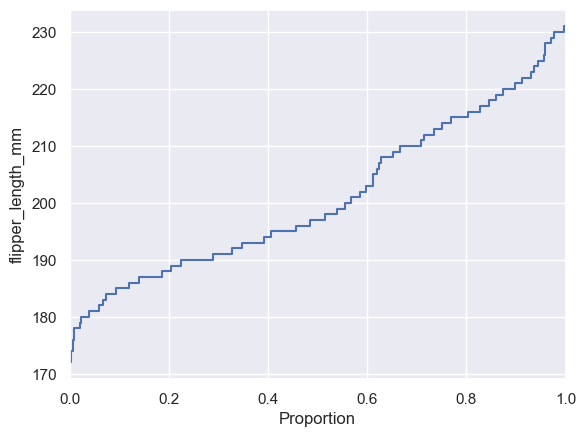

In [376]:
sns.ecdfplot(data=penguins, y='flipper_length_mm')

In [377]:
penguins.filter(like='bill_', axis='columns')

,bill_length_mm,bill_depth_mm
0,39.1,18.7
1,39.5,17.4
2,40.3,18.0
3,NaN,NaN
4,36.7,19.3
...,...,...
339,NaN,NaN
340,46.8,14.3
341,50.4,15.7
342,45.2,14.8


<AxesSubplot:ylabel='Proportion'>

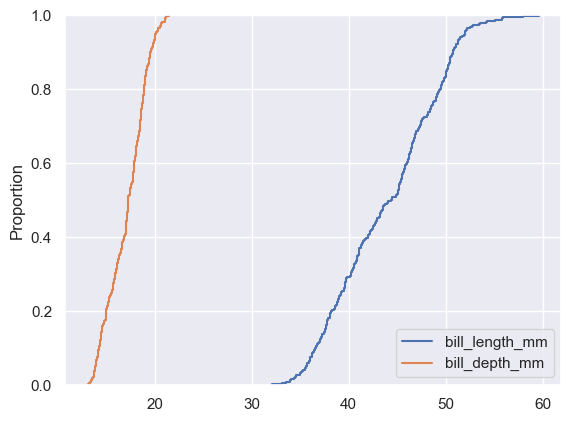

In [378]:
sns.ecdfplot(data=penguins.filter(like='bill_', axis='columns'))

<AxesSubplot:xlabel='bill_length_mm', ylabel='Proportion'>

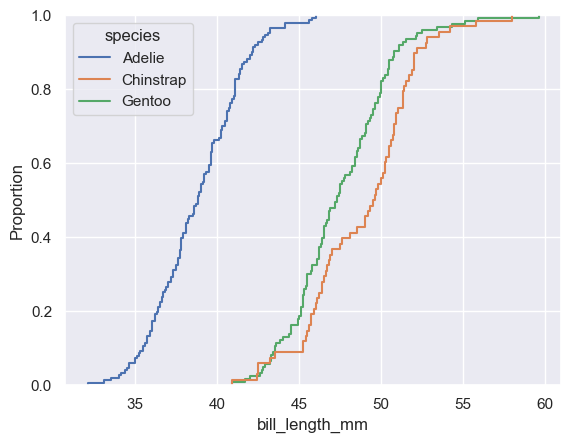

In [379]:
sns.ecdfplot(data=penguins, x='bill_length_mm', hue='species')

<AxesSubplot:xlabel='bill_length_mm', ylabel='Count'>

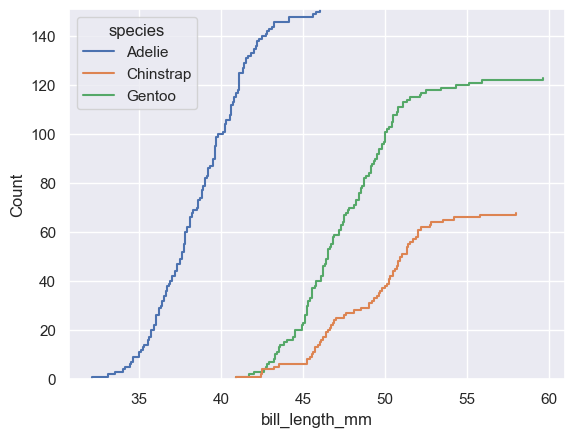

In [380]:
sns.ecdfplot(data=penguins, x='bill_length_mm', hue='species', stat='count')

<AxesSubplot:xlabel='bill_length_mm', ylabel='Proportion'>

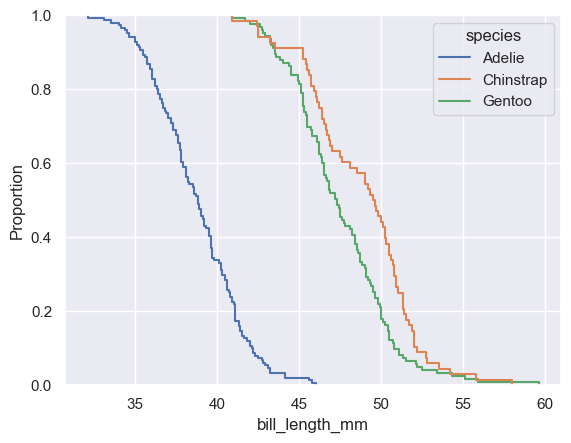

In [381]:
sns.ecdfplot(data=penguins, x='bill_length_mm', hue='species', complementary=True)

### sns.rugplot

In [382]:
sns.set_theme()
tips

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4
...,...,...,...,...,...,...,...
239,29.03,5.92,Male,No,Sat,Dinner,3
240,27.18,2.00,Female,Yes,Sat,Dinner,2
241,22.67,2.00,Male,Yes,Sat,Dinner,2
242,17.82,1.75,Male,No,Sat,Dinner,2


<AxesSubplot:xlabel='total_bill', ylabel='Density'>

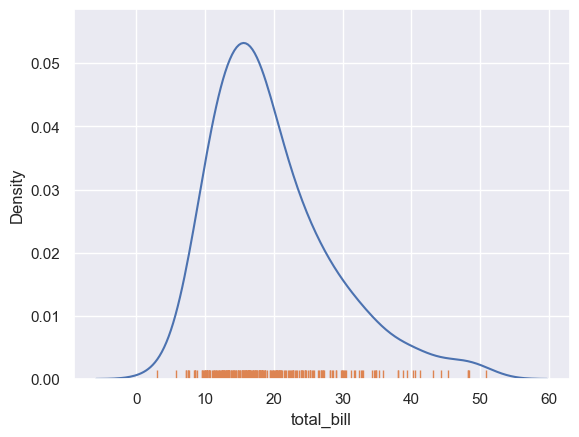

In [383]:
sns.kdeplot(data=tips, x='total_bill')
sns.rugplot(data=tips, x='total_bill')

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

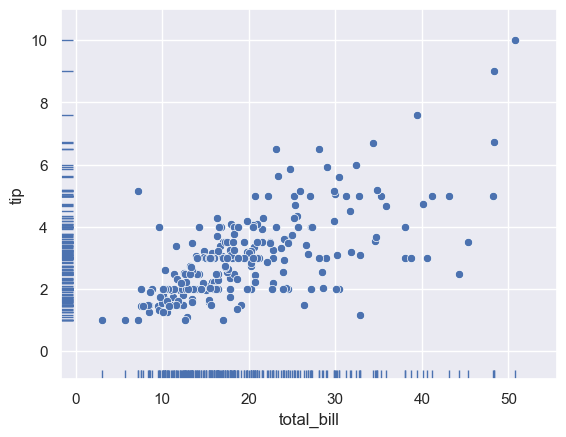

In [384]:
sns.scatterplot(data=tips, x='total_bill', y='tip')
sns.rugplot(data=tips, x='total_bill', y='tip')

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

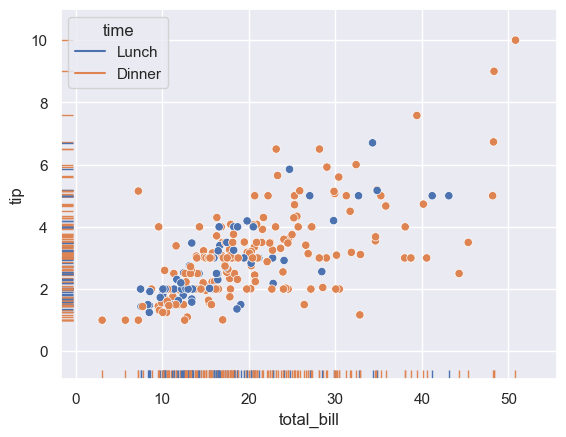

In [385]:
sns.scatterplot(data=tips, x='total_bill', y='tip', hue='time')
sns.rugplot(data=tips, x='total_bill', y='tip', hue='time')

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

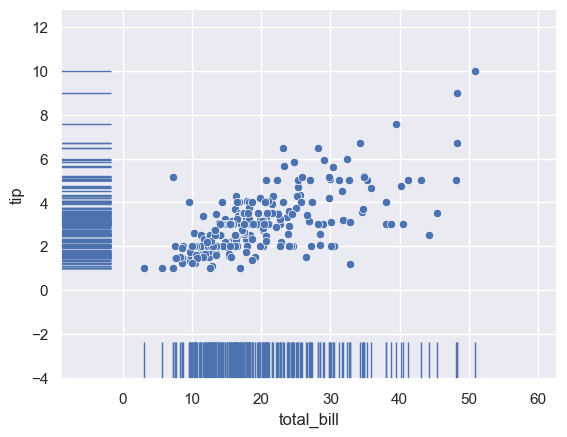

In [386]:
sns.scatterplot(data=tips, x='total_bill', y='tip')
sns.rugplot(data=tips, x='total_bill', y='tip', height=.1)

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

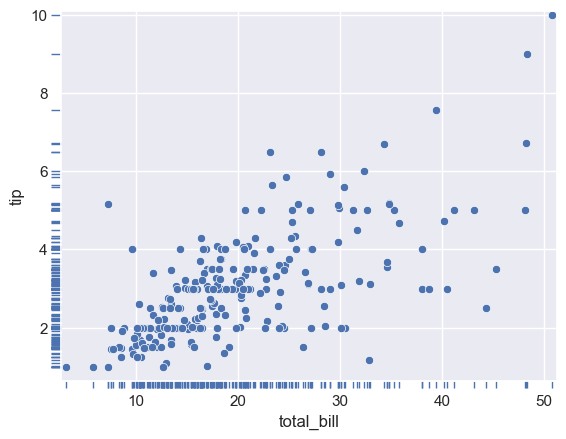

In [387]:
sns.scatterplot(data=tips, x='total_bill', y='tip')
sns.rugplot(data=tips, x='total_bill', y='tip', height=-.02, clip_on=False)

<AxesSubplot:xlabel='carat', ylabel='price'>

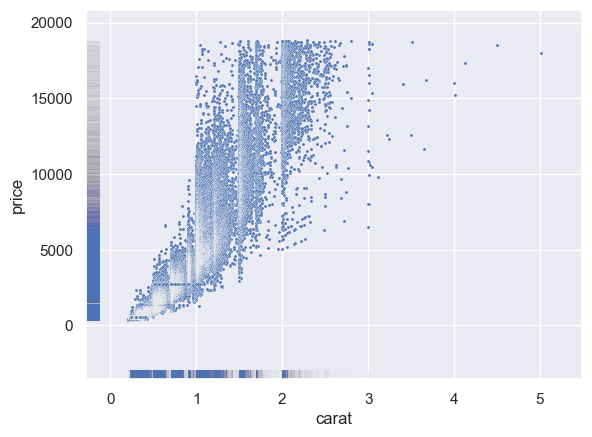

In [388]:
sns.scatterplot(data=diamonds, x='carat', y='price', s=5)
sns.rugplot(data=diamonds, x='carat', y='price', lw=1, alpha=.005)

## Categorical plots

### sns.catplot

In [389]:
sns.set_theme(style='ticks')
exercise = sns.load_dataset('exercise')
exercise

,Unnamed: 0,id,diet,pulse,time,kind
0,0,1,low fat,85,1 min,rest
1,1,1,low fat,85,15 min,rest
2,2,1,low fat,88,30 min,rest
3,3,2,low fat,90,1 min,rest
4,4,2,low fat,92,15 min,rest
...,...,...,...,...,...,...
85,85,29,no fat,135,15 min,running
86,86,29,no fat,130,30 min,running
87,87,30,no fat,99,1 min,running
88,88,30,no fat,111,15 min,running


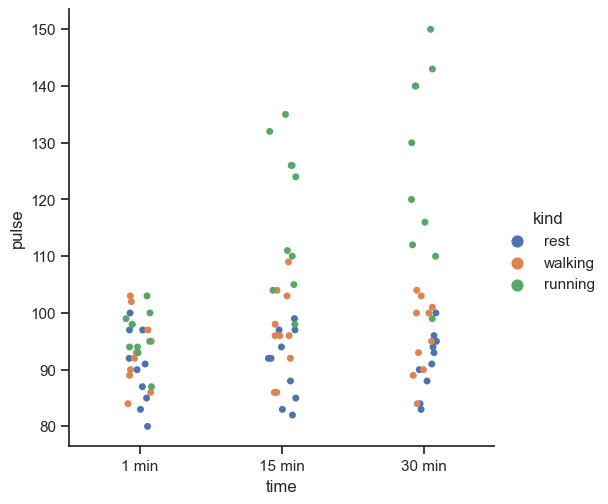

In [390]:
g = sns.catplot(x='time', y='pulse', hue='kind', data=exercise)

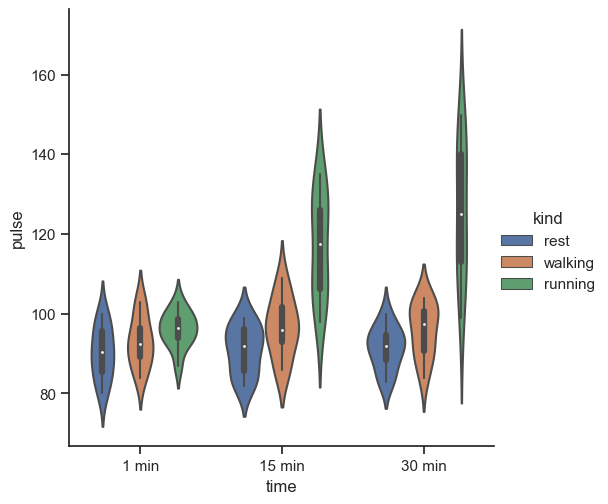

In [391]:
g = sns.catplot(x='time', y='pulse', hue='kind', data=exercise, kind='violin')

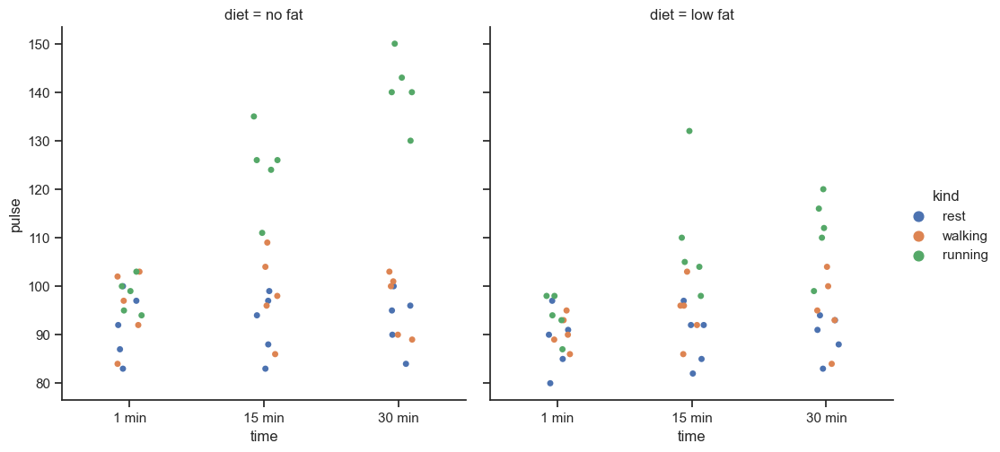

In [392]:
g = sns.catplot(x='time', y='pulse', hue='kind', data=exercise, col='diet')

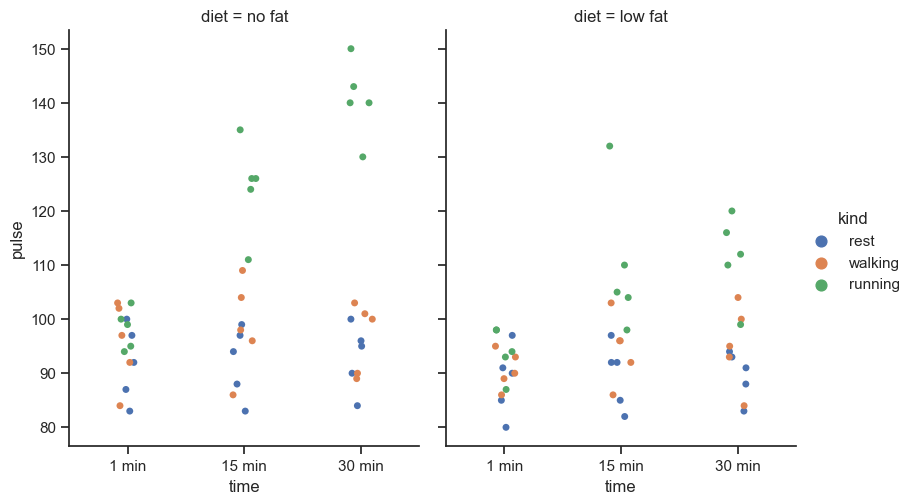

In [393]:
g = sns.catplot(x='time', y='pulse', hue='kind', data=exercise, col='diet', height=5, aspect=.8)

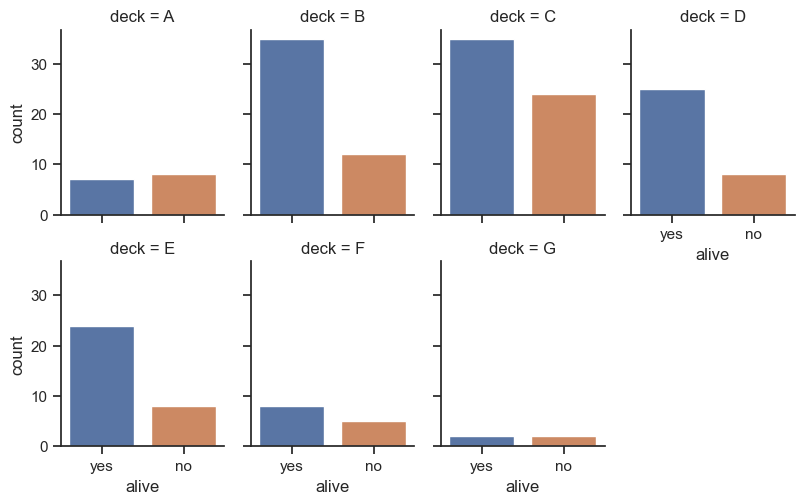

In [394]:
g = sns.catplot(
    x='alive', col='deck', col_wrap=4, data=titanic[titanic.deck.notnull()], 
    kind='count', height=2.5, aspect=.8
)

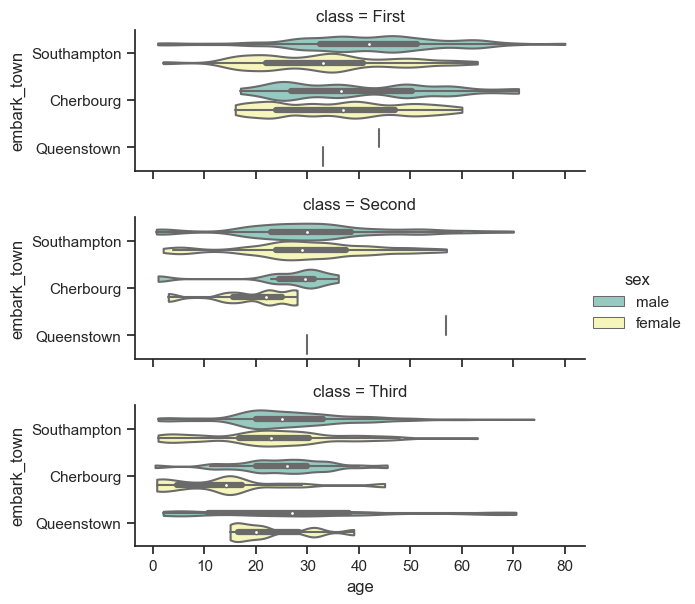

In [395]:
g = sns.catplot(
    x='age', y='embark_town', hue='sex', row='class', 
    data=titanic[titanic.embark_town.notnull()], 
    height=2, aspect=3, palette='Set3', 
    orient='h', kind='violin', dodge=True, cut=0, bw=.2
)

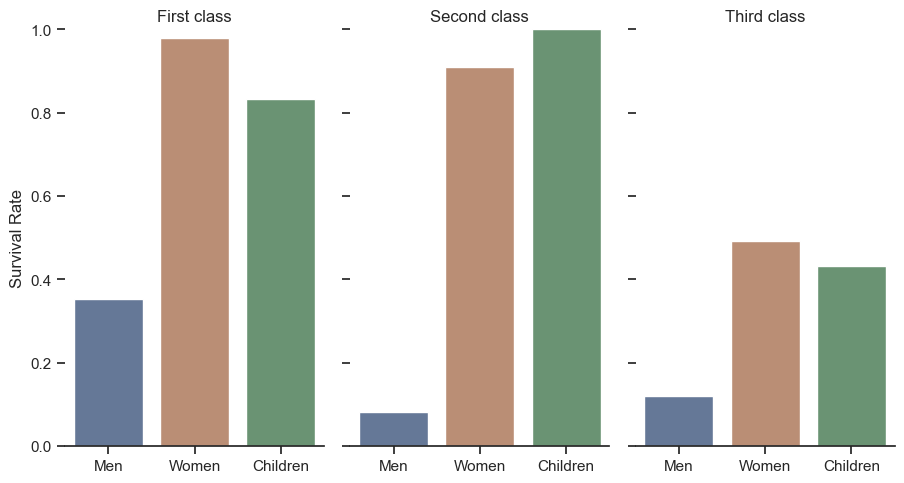

In [396]:
g = sns.catplot(
    x='who', y='survived', col='class', data=titanic, 
    saturation=.5, 
    kind='bar', ci=None, aspect=.6
)
g.set_axis_labels('', 'Survival Rate')
g.set_xticklabels(['Men', 'Women', 'Children'])
g.set_titles('{col_name} {col_var}')
g.set(ylim=(0, 1))
g.despine(left=True)

### sns.stripplot

In [397]:
sns.set_theme(style='whitegrid')
tips

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4
...,...,...,...,...,...,...,...
239,29.03,5.92,Male,No,Sat,Dinner,3
240,27.18,2.00,Female,Yes,Sat,Dinner,2
241,22.67,2.00,Male,Yes,Sat,Dinner,2
242,17.82,1.75,Male,No,Sat,Dinner,2


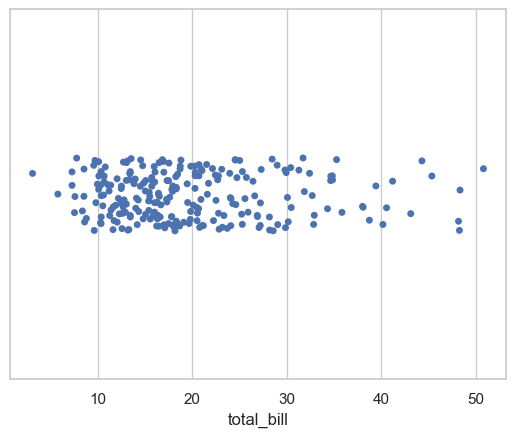

In [398]:
ax = sns.stripplot(x=tips['total_bill'])

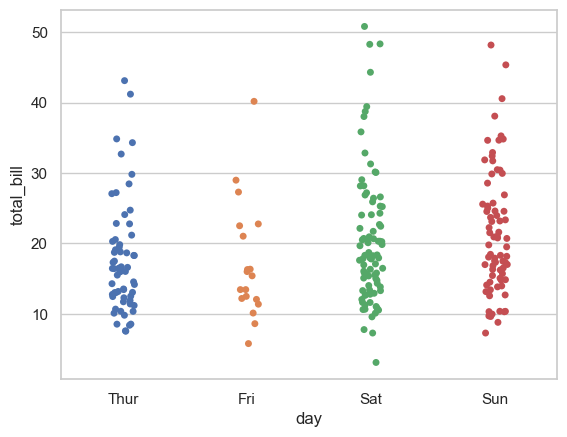

In [399]:
ax = sns.stripplot(x='day', y='total_bill', data=tips)

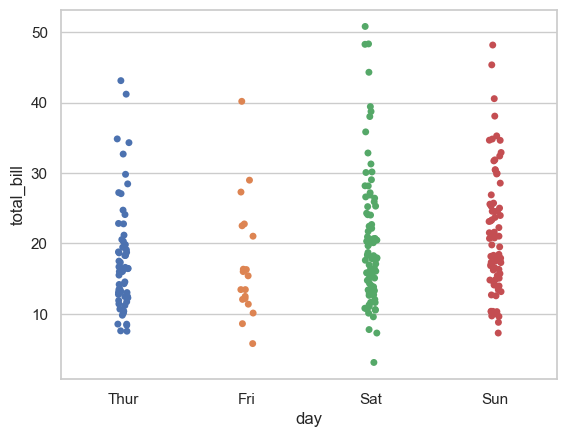

In [400]:
ax = sns.stripplot(x='day', y='total_bill', data=tips, jitter=.05)

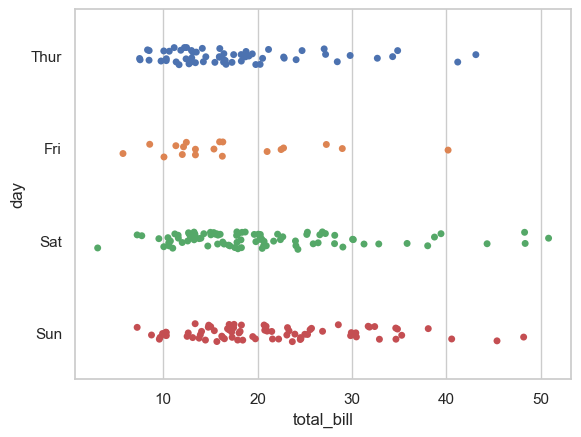

In [401]:
ax = sns.stripplot(y='day', x='total_bill', data=tips)

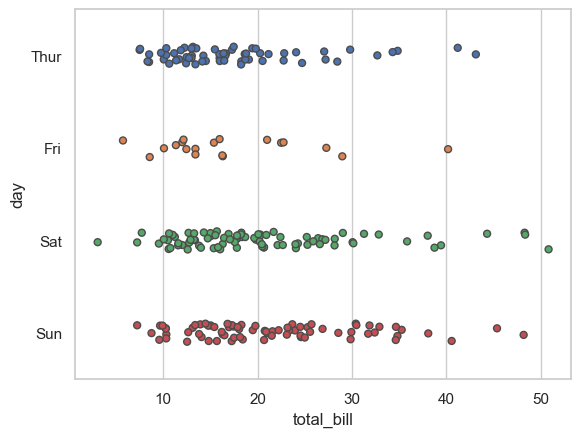

In [402]:
ax = sns.stripplot(y='day', x='total_bill', data=tips, linewidth=1)

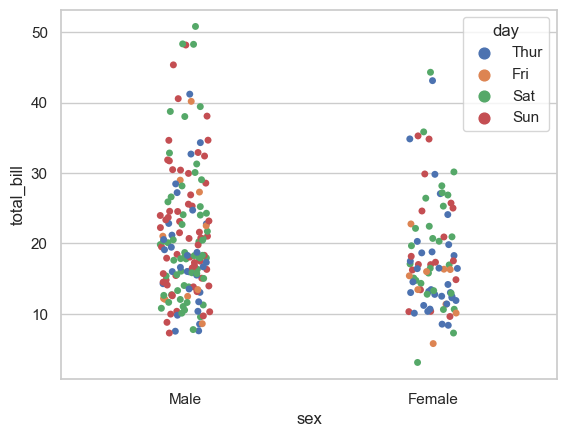

In [403]:
ax = sns.stripplot(x='sex', y='total_bill', hue='day', data=tips)

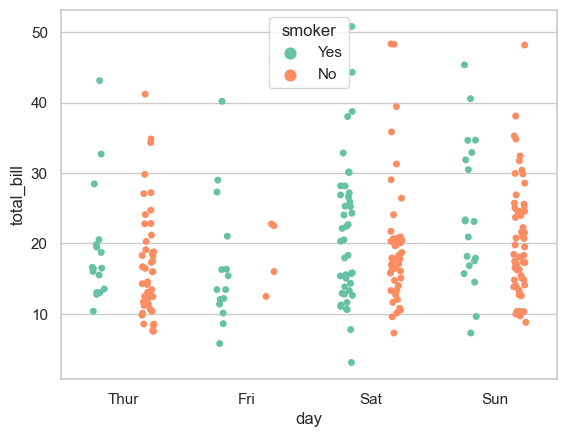

In [404]:
ax = sns.stripplot(x='day', y='total_bill', hue='smoker', data=tips, 
                   palette='Set2', dodge=True)

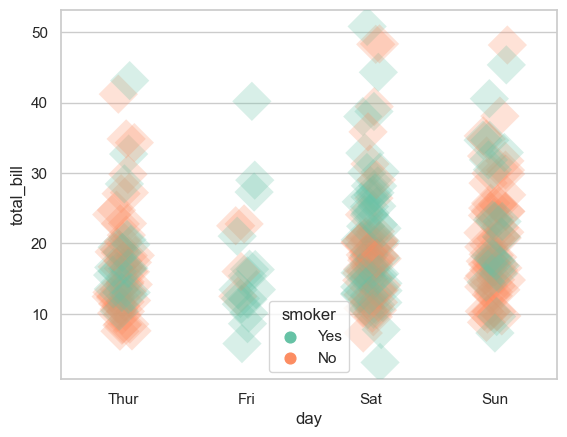

In [405]:
ax = sns.stripplot(
    x='day', y='total_bill', hue='smoker', data=tips, 
    palette='Set2', size=20, marker='D', edgecolor='gray', alpha=.25
)

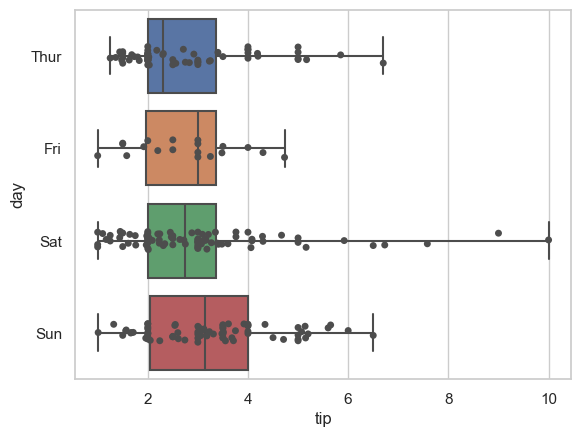

In [406]:
ax = sns.boxplot(x='tip', y='day', data=tips, whis=np.inf)
ax = sns.stripplot(x='tip', y='day', data=tips, color='.3')

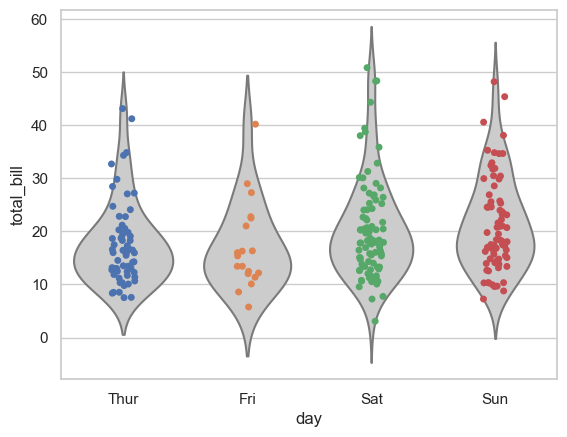

In [407]:
ax = sns.violinplot(
    data=tips, x='day', y='total_bill', 
    inner=None, color='.8'
)
ax = sns.stripplot(data=tips, x='day', y='total_bill')

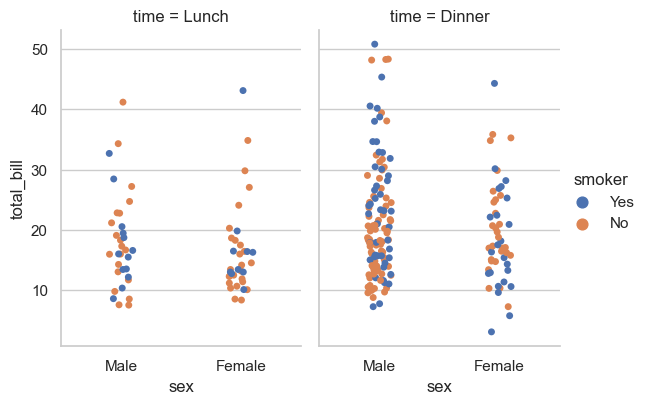

In [408]:
g = sns.catplot(
    data=tips, x='sex', y='total_bill', 
    hue='smoker', col='time', kind='strip', 
    height=4, aspect=.7
)

### sns.swarmplot

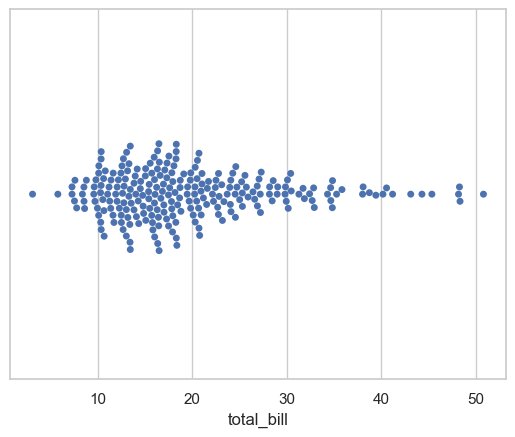

In [409]:
ax = sns.swarmplot(x=tips['total_bill'])

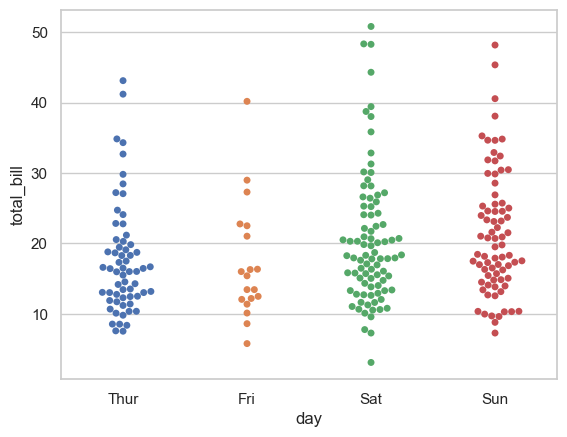

In [410]:
ax = sns.swarmplot(data=tips, x='day', y='total_bill')

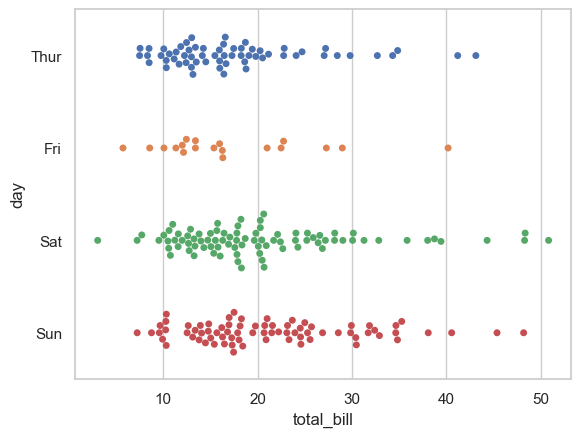

In [411]:
ax = sns.swarmplot(data=tips, x='total_bill', y='day')

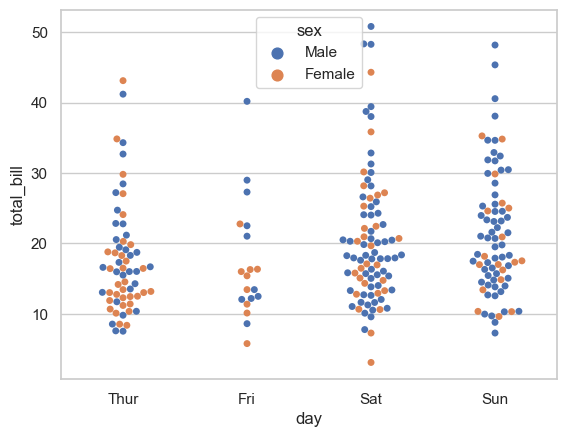

In [412]:
ax = sns.swarmplot(data=tips, x='day', y='total_bill', hue='sex')

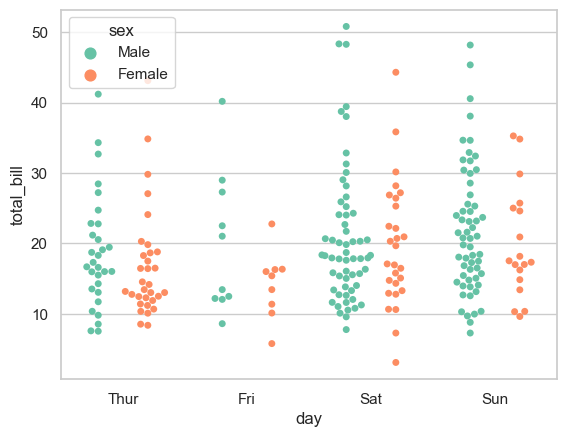

In [413]:
ax = sns.swarmplot(
    data=tips, x='day', y='total_bill', hue='sex', 
    palette='Set2', dodge=True
)

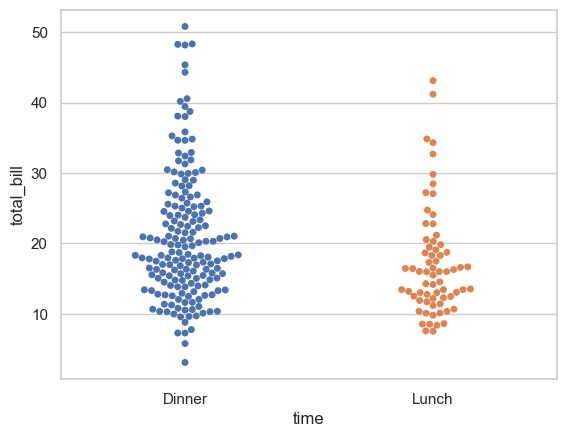

In [414]:
ax = sns.swarmplot(
    data=tips, x='time', y='total_bill', 
    order=['Dinner', 'Lunch']
)

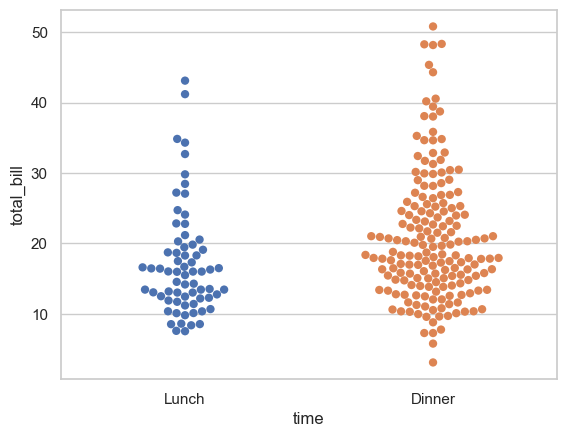

In [415]:
ax = sns.swarmplot(data=tips, x='time', y='total_bill', size=6)

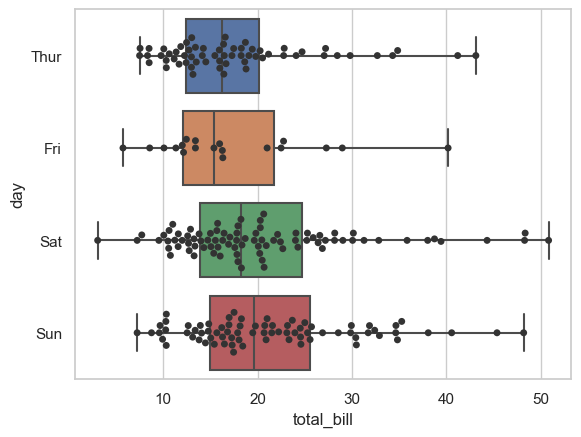

In [416]:
ax = sns.boxplot(data=tips, x='total_bill', y='day', whis=np.inf)
ax = sns.swarmplot(data=tips, x='total_bill', y='day', color='.2')

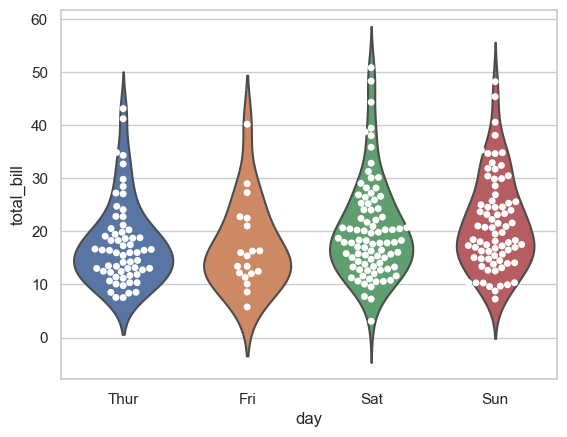

In [417]:
ax = sns.violinplot(data=tips, x='day', y='total_bill', inner=None)
ax = sns.swarmplot(data=tips, x='day', y='total_bill', color='white', edgecolor='gray')

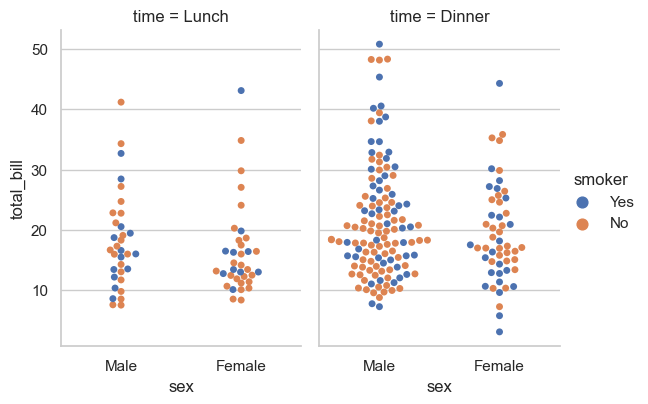

In [418]:
g = sns.catplot(
    data=tips, x='sex', y='total_bill', hue='smoker', col='time', 
    kind='swarm', height=4, aspect=.7    
)

### sns.boxplot

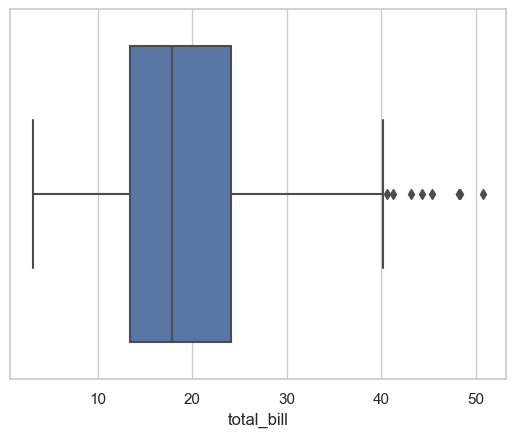

In [419]:
ax = sns.boxplot(x=tips['total_bill'])

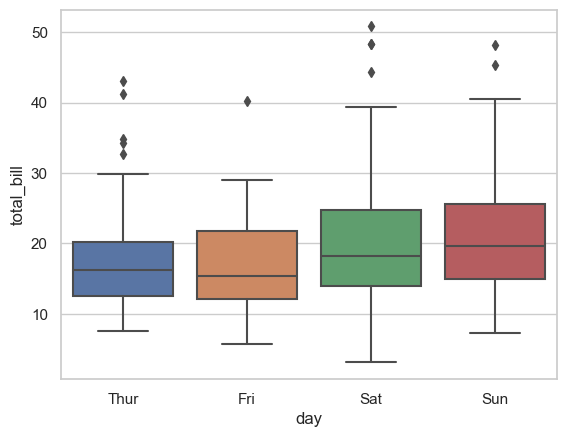

In [420]:
ax = sns.boxplot(data=tips, x='day', y='total_bill')

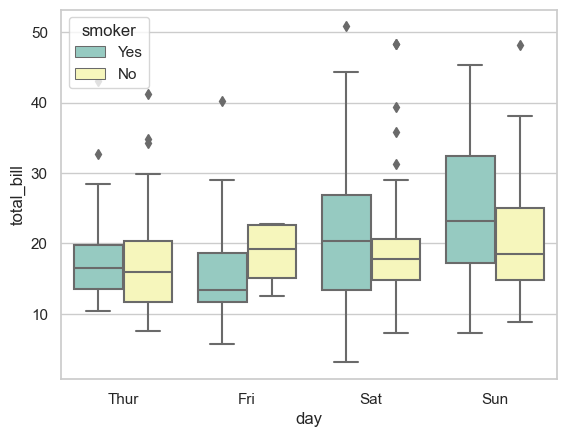

In [421]:
ax = sns.boxplot(data=tips, x='day', y='total_bill', hue='smoker', palette='Set3')

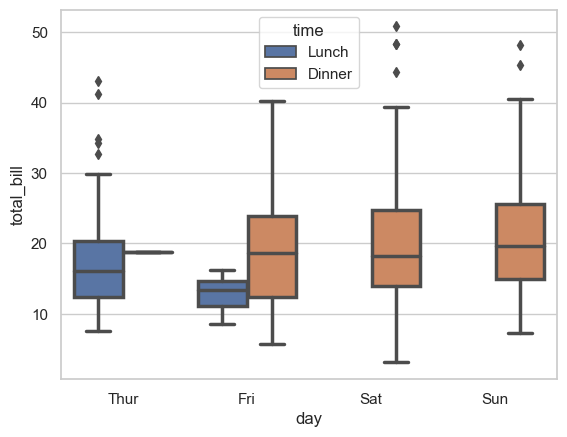

In [422]:
ax = sns.boxplot(
    data=tips, x='day', y='total_bill', hue='time', 
    linewidth=2.5
)

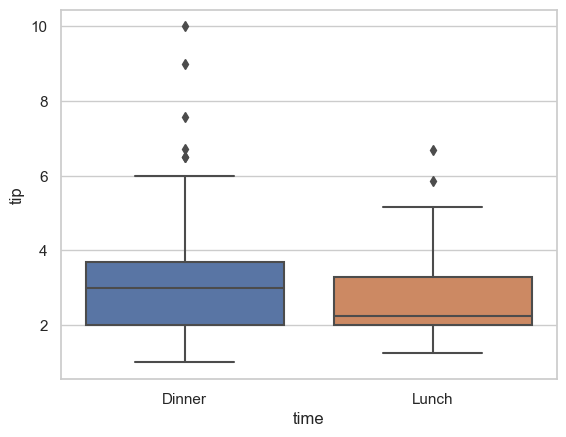

In [423]:
ax = sns.boxplot(
    data=tips, x='time', y='tip', 
    order=['Dinner', 'Lunch']
)

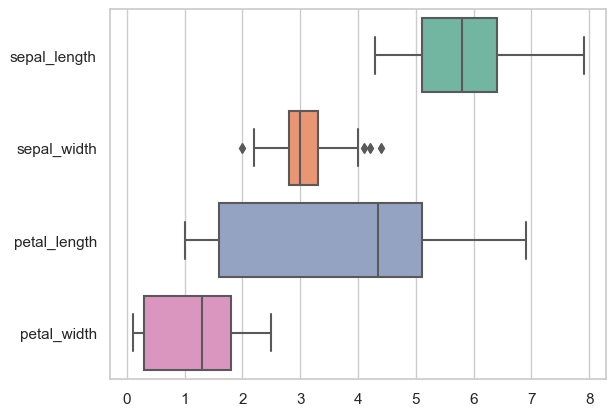

In [424]:
ax = sns.boxplot(data=iris, palette='Set2', orient='h')

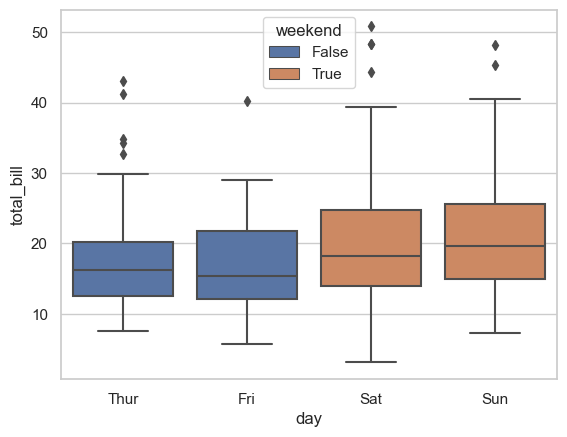

In [425]:
tips['weekend'] = tips['day'].isin(['Sat', 'Sun'])
ax = sns.boxplot(
    data=tips, x='day', y='total_bill', hue='weekend', dodge=False
)

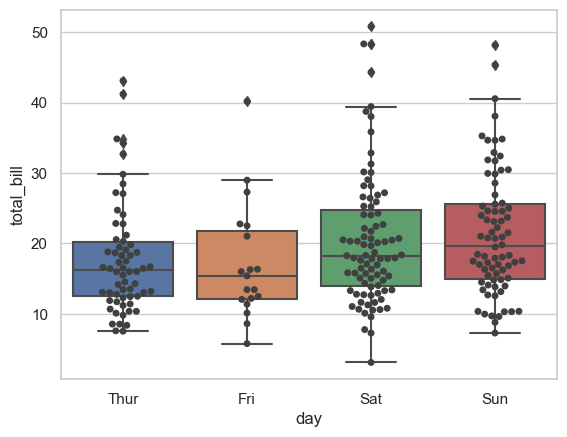

In [426]:
ax = sns.boxplot(x="day", y="total_bill", data=tips)
ax = sns.swarmplot(x="day", y="total_bill", data=tips, color=".25")

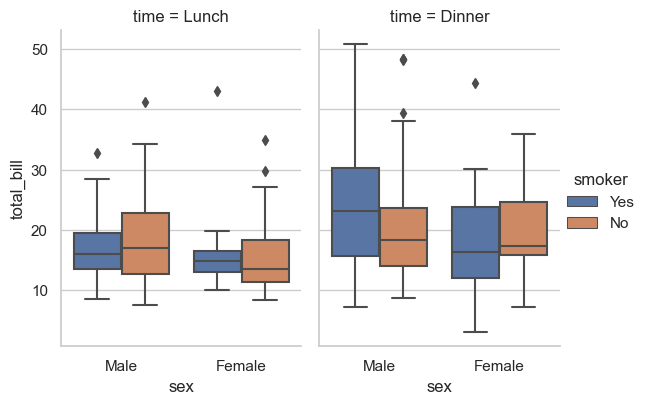

In [427]:
g = sns.catplot(x="sex", y="total_bill",
                hue="smoker", col="time",
                data=tips, kind="box",
                height=4, aspect=.7);

### sns.violinplot

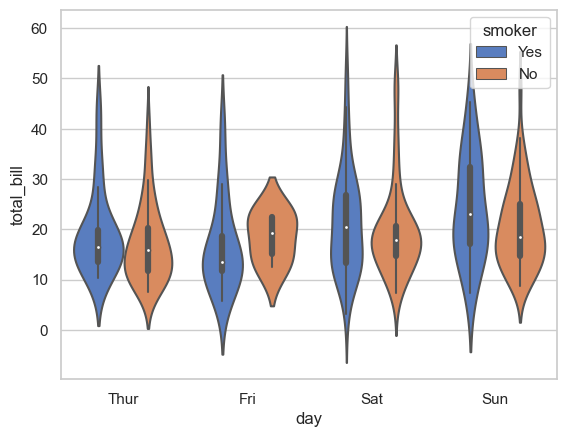

In [428]:
ax = sns.violinplot(x="day", y="total_bill", hue="smoker",
                    data=tips, palette="muted")

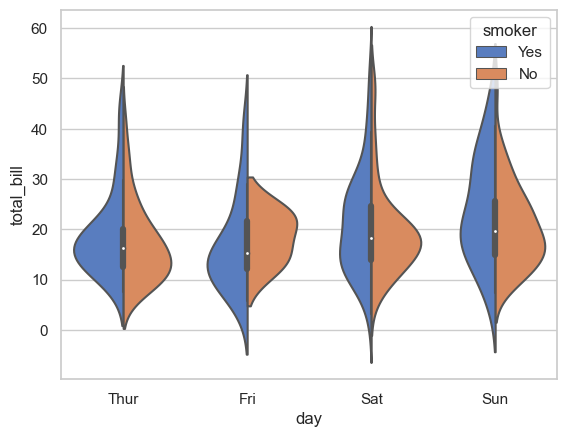

In [429]:
ax = sns.violinplot(x="day", y="total_bill", hue="smoker",
                    data=tips, palette="muted", split=True)

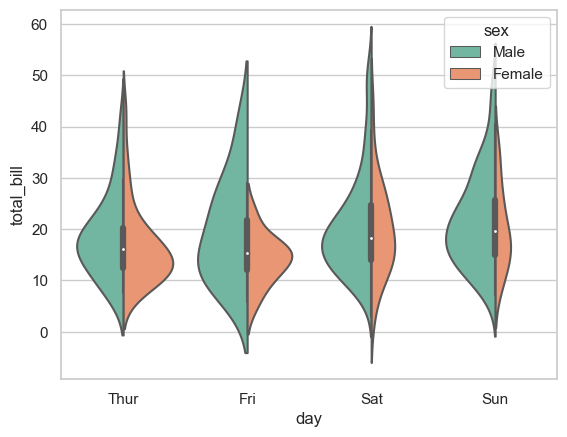

In [430]:
ax = sns.violinplot(x="day", y="total_bill", hue="sex",
                    data=tips, palette="Set2", split=True,
                    scale="count")

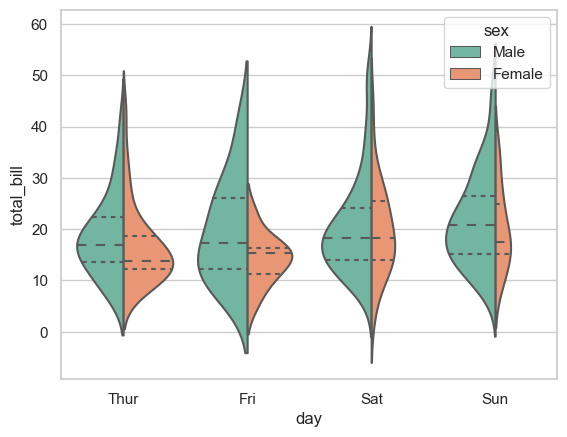

In [431]:
ax = sns.violinplot(x="day", y="total_bill", hue="sex",
                    data=tips, palette="Set2", split=True,
                    scale="count", inner="quartile")

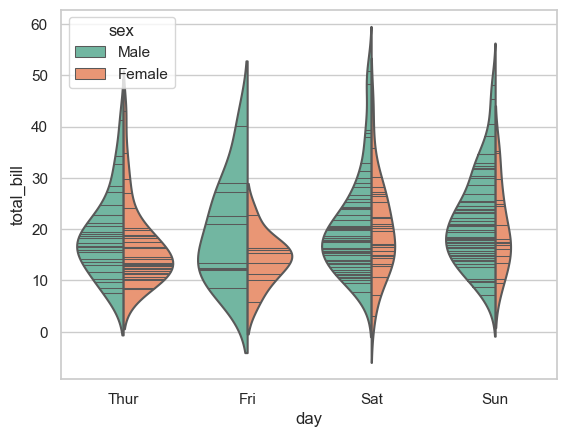

In [432]:
ax = sns.violinplot(x="day", y="total_bill", hue="sex",
                    data=tips, palette="Set2", split=True,
                    scale="count", inner="stick")

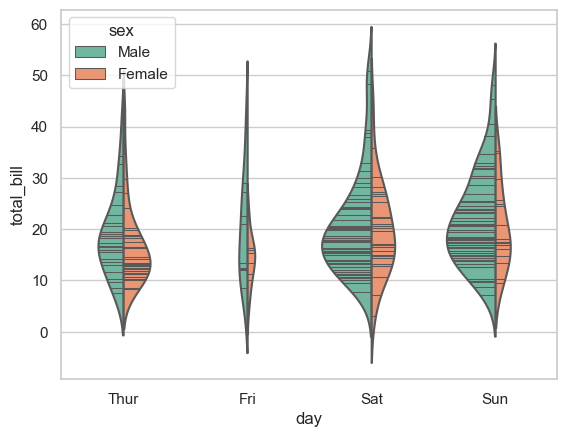

In [433]:
ax = sns.violinplot(x="day", y="total_bill", hue="sex",
                    data=tips, palette="Set2", split=True,
                    scale="count", inner="stick", scale_hue=False)

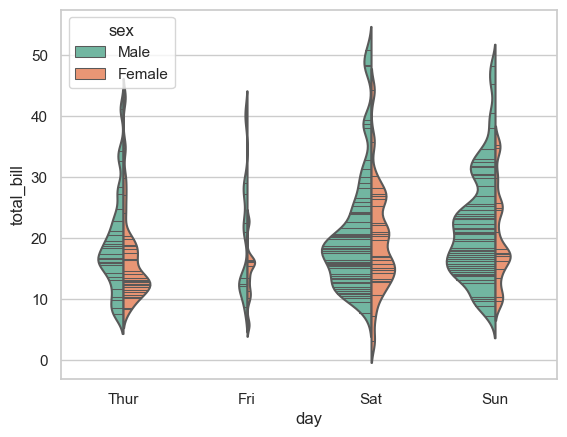

In [434]:
ax = sns.violinplot(x="day", y="total_bill", hue="sex",
                    data=tips, palette="Set2", split=True,
                    scale="count", inner="stick",
                    scale_hue=False, bw=.2)

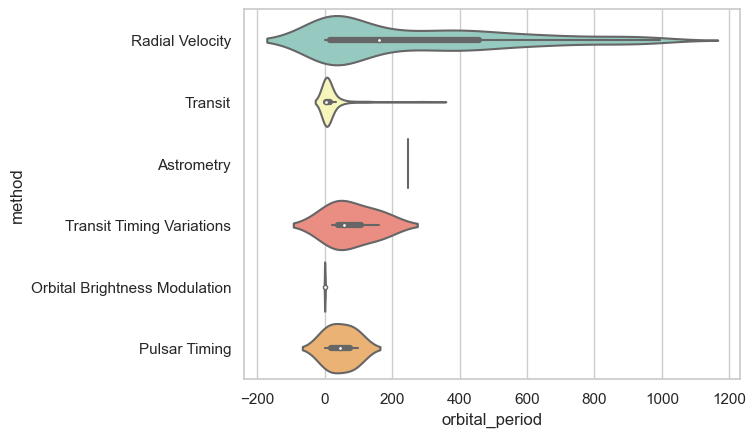

In [435]:
ax = sns.violinplot(x="orbital_period", y="method",
                    data=planets[planets.orbital_period < 1000],
                    scale="width", palette="Set3")

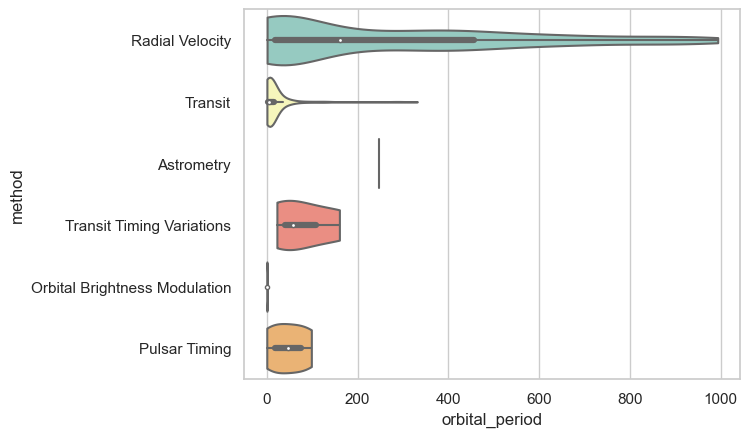

In [436]:
ax = sns.violinplot(x="orbital_period", y="method",
                    data=planets[planets.orbital_period < 1000],
                    cut=0, scale="width", palette="Set3")

### sns.boxenplot

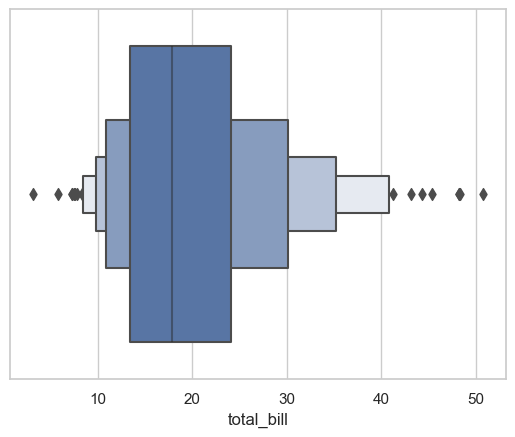

In [437]:
ax = sns.boxenplot(x=tips["total_bill"])

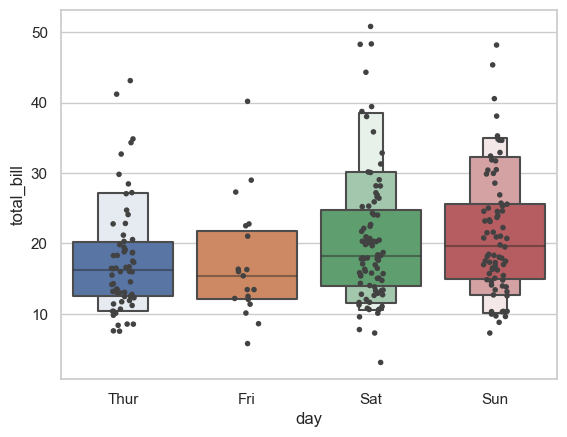

In [438]:
ax = sns.boxenplot(x="day", y="total_bill", data=tips,
                   showfliers=False)
ax = sns.stripplot(x="day", y="total_bill", data=tips,
                   size=4, color=".26")

### sns.pointplot

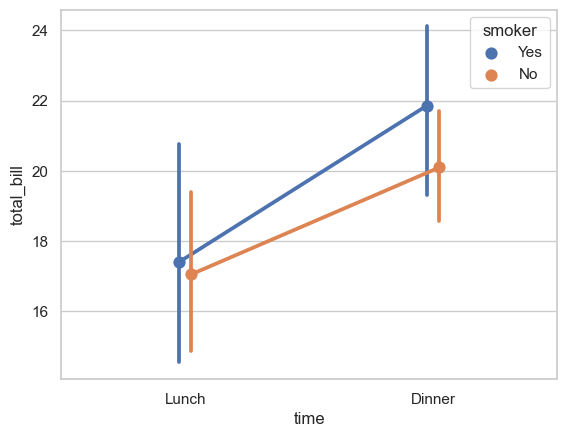

In [439]:
ax = sns.pointplot(x="time", y="total_bill", hue="smoker",
                   data=tips, dodge=True)

f:\workspace\venv\lib\site-packages\seaborn\categorical.py:1781: UserWarning: You passed a edgecolor/edgecolors ((0.8666666666666667, 0.5176470588235295, 0.3215686274509804)) for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  ax.scatter(x, y, label=hue_level,


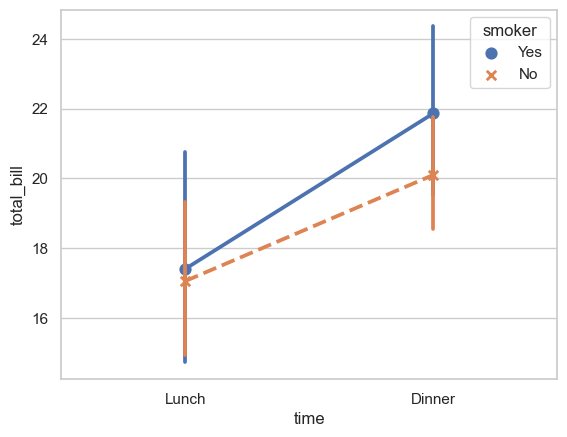

In [440]:
ax = sns.pointplot(x="time", y="total_bill", hue="smoker",
                   data=tips,
                   markers=["o", "x"],
                   linestyles=["-", "--"])

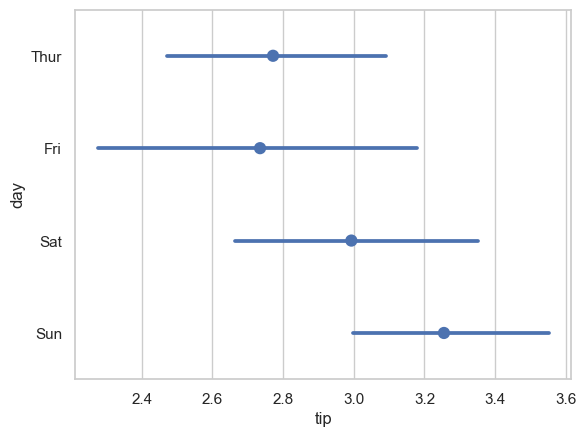

In [441]:
ax = sns.pointplot(x="tip", y="day", data=tips, join=False)

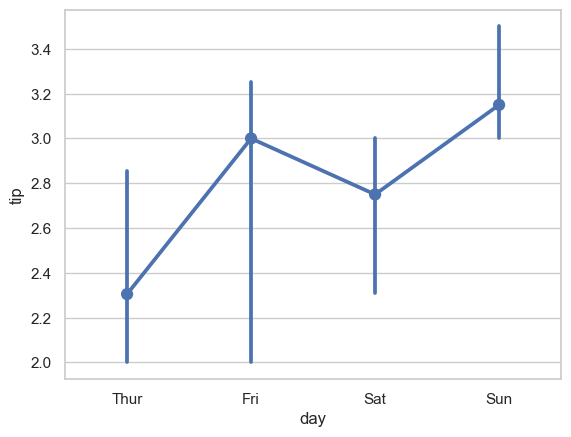

In [442]:
ax = sns.pointplot(x="day", y="tip", data=tips, estimator=np.median)

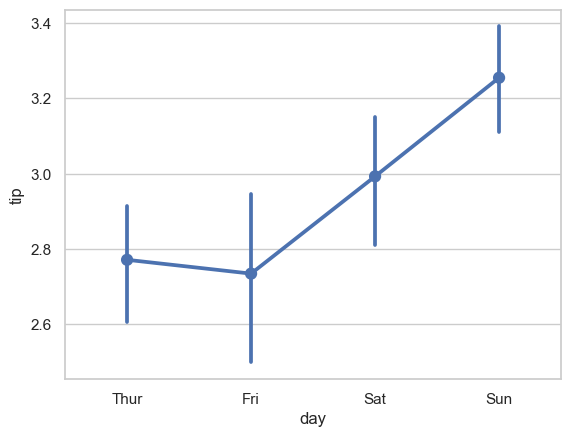

In [443]:
ax = sns.pointplot(x="day", y="tip", data=tips, ci=68)

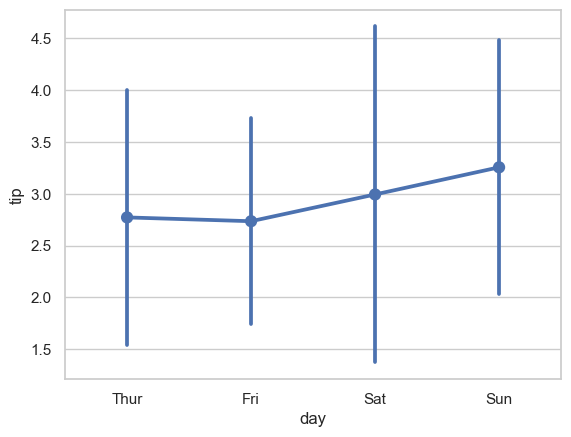

In [444]:
ax = sns.pointplot(x="day", y="tip", data=tips, ci="sd")

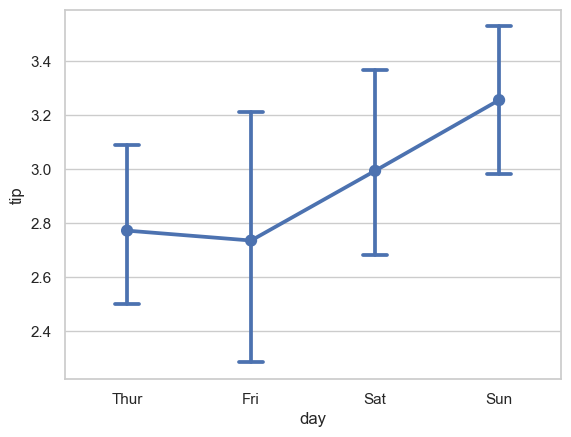

In [445]:
ax = sns.pointplot(x="day", y="tip", data=tips, capsize=.2)

### sns.barplot

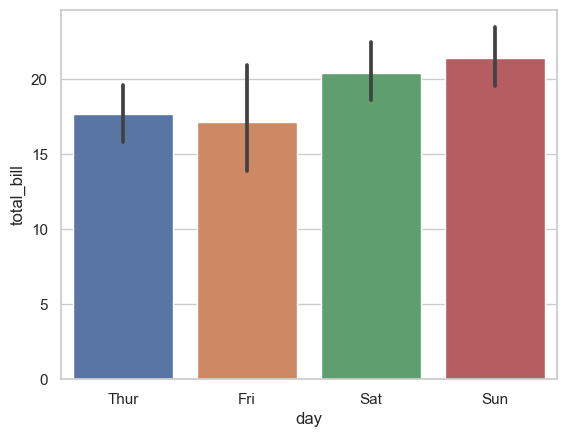

In [446]:
ax = sns.barplot(data=tips, x='day', y='total_bill')

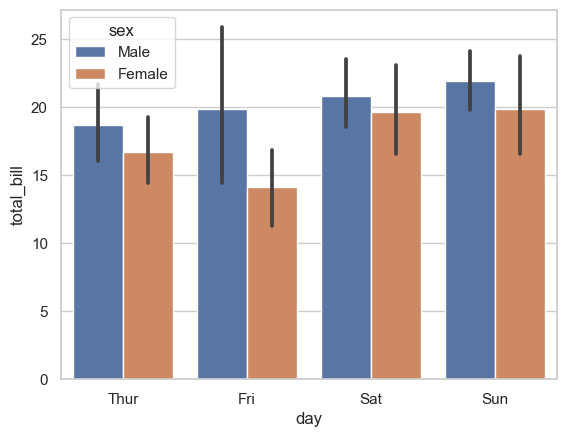

In [447]:
ax = sns.barplot(data=tips, x='day', y='total_bill', hue='sex')

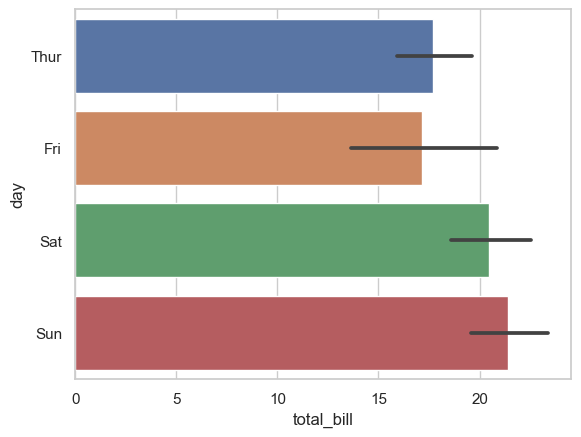

In [448]:
ax = sns.barplot(data=tips, x='total_bill', y='day')

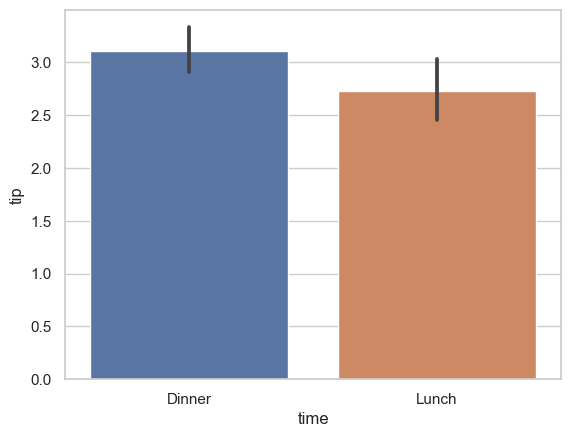

In [449]:
ax = sns.barplot(data=tips, x='time', y='tip', order=['Dinner', 'Lunch'])

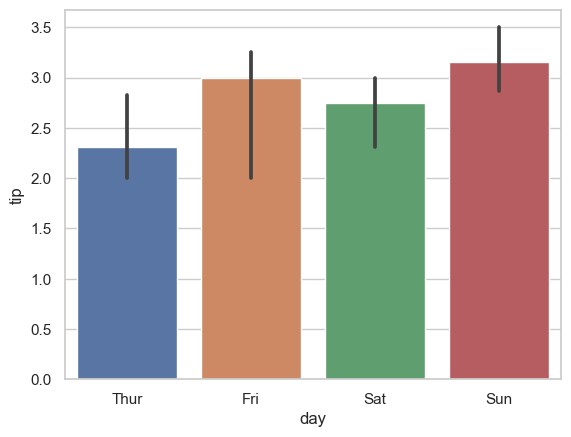

In [450]:
ax = sns.barplot(data=tips, x='day', y='tip', estimator=np.median)

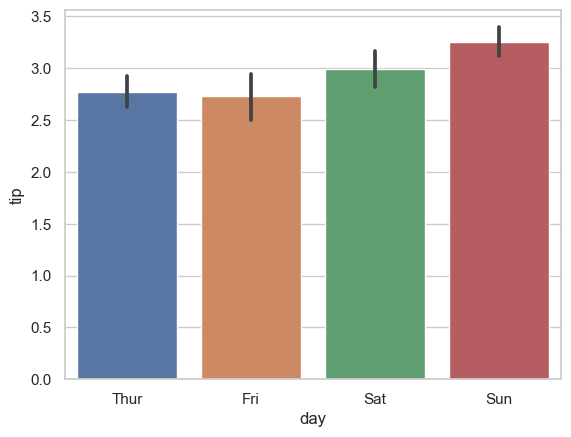

In [451]:
ax = sns.barplot(data=tips, x='day', y='tip', ci=68)

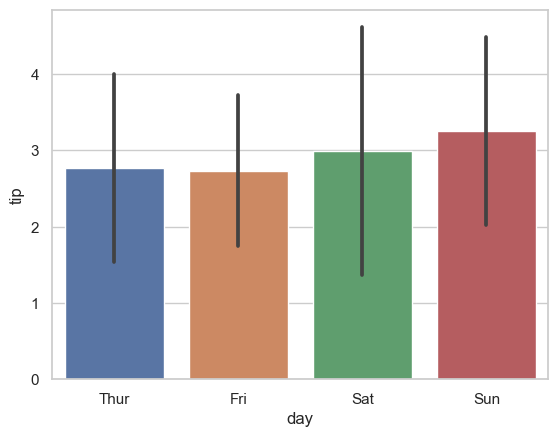

In [452]:
ax = sns.barplot(data=tips, x='day', y='tip', ci='sd')

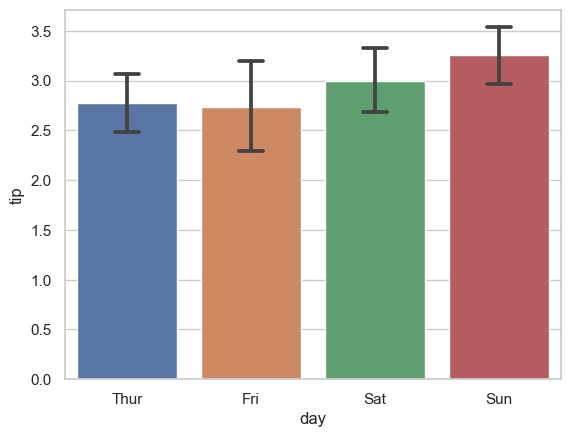

In [453]:
ax = sns.barplot(data=tips, x='day', y='tip', capsize=.2)

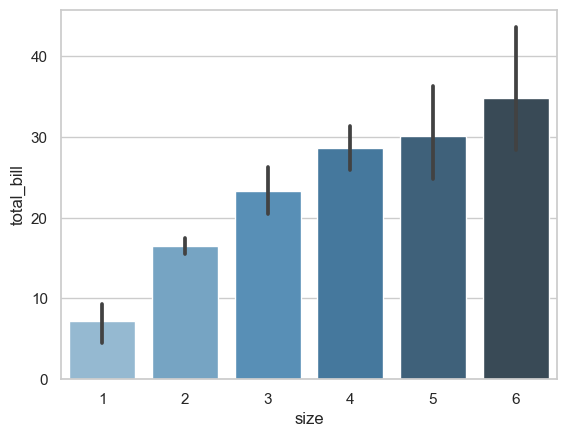

In [454]:
ax = sns.barplot(data=tips, x='size', y='total_bill', palette='Blues_d')

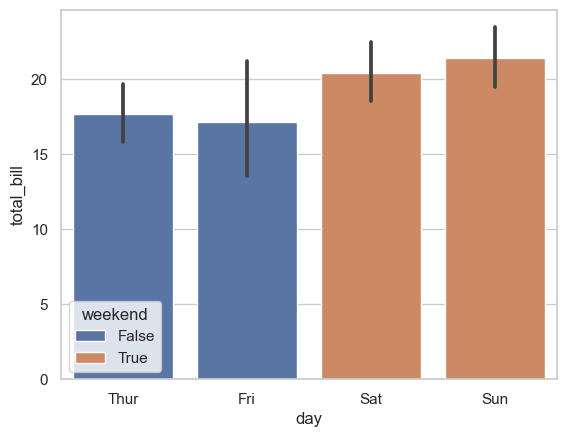

In [455]:
ax = sns.barplot(
    data=tips, x='day', y='total_bill', 
    hue='weekend', dodge=False
)

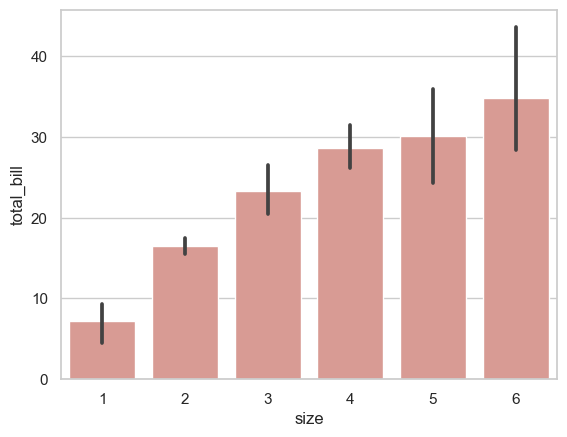

In [456]:
ax = sns.barplot(
    data=tips, x='size', y='total_bill', 
    color='salmon', saturation=.5
)

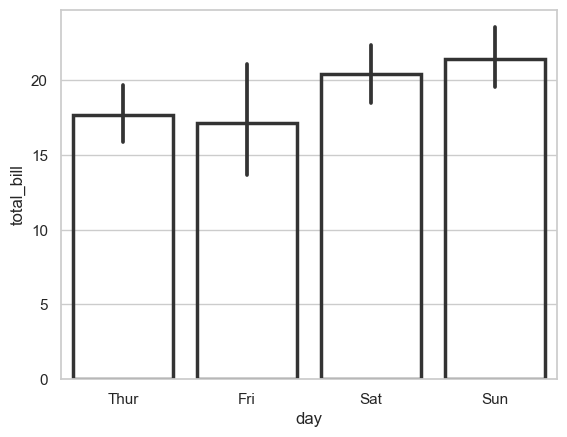

In [457]:
ax = sns.barplot(
    data=tips, x='day', y='total_bill', 
    linewidth=2.5, facecolor=(1, 1, 1, 0), 
    errcolor='.2', edgecolor='.2'
)

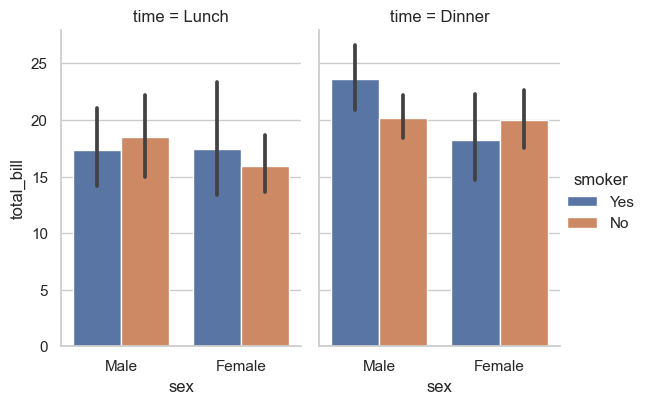

In [458]:
g = sns.catplot(
    data=tips, x='sex', y='total_bill', hue='smoker', 
    col='time', kind='bar', height=4, aspect=.7
)

### sns.countplot

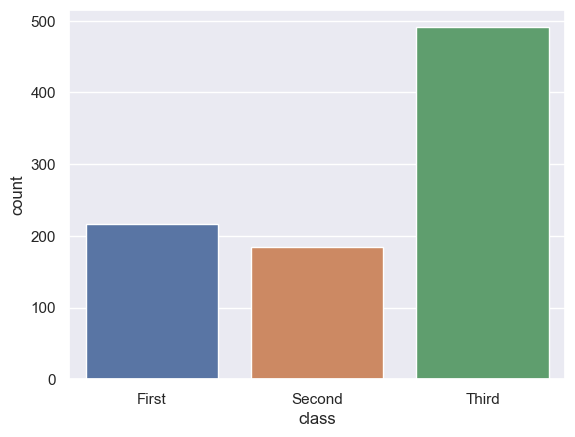

In [459]:
sns.set_theme(style='darkgrid')
ax = sns.countplot(x='class', data=titanic)

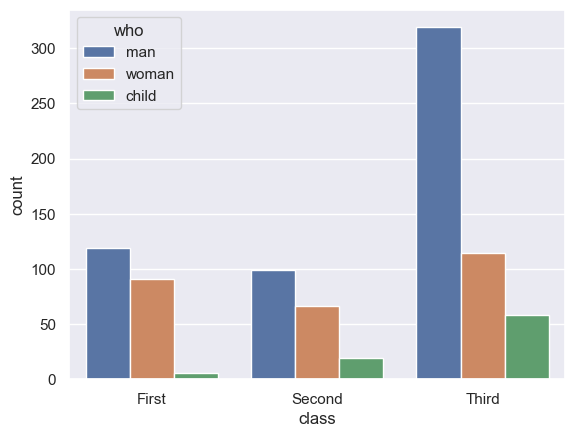

In [460]:
ax = sns.countplot(data=titanic, x='class', hue='who')

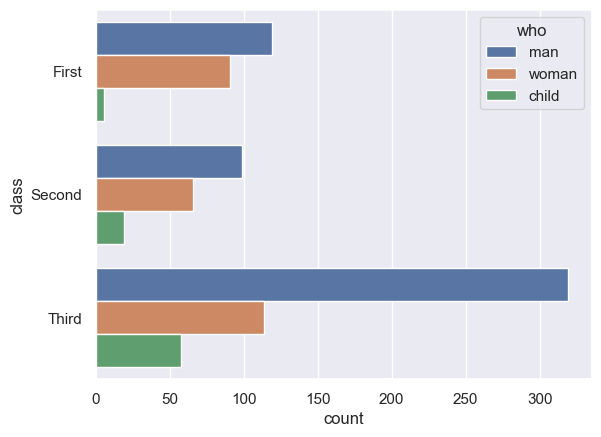

In [461]:
ax = sns.countplot(data=titanic, y='class', hue='who')

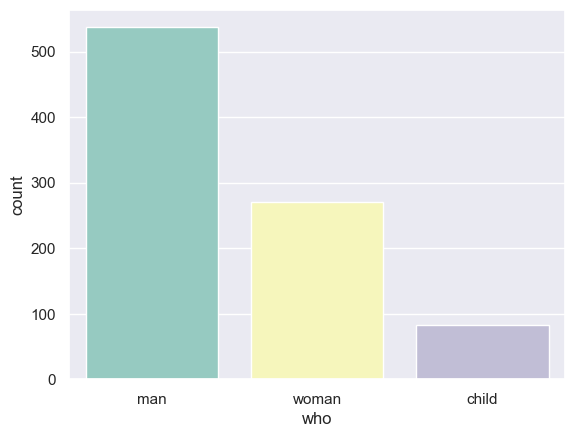

In [462]:
ax = sns.countplot(data=titanic, x='who', palette='Set3')

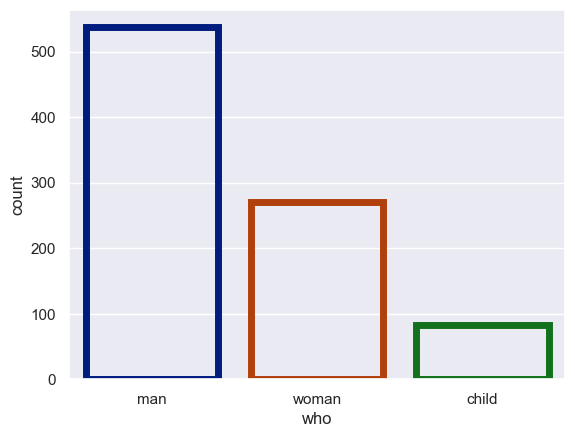

In [463]:
ax = sns.countplot(
    data=titanic, x='who', 
    facecolor=(0, 0, 0, 0), linewidth=5, 
    edgecolor=sns.color_palette('dark', 3)
)

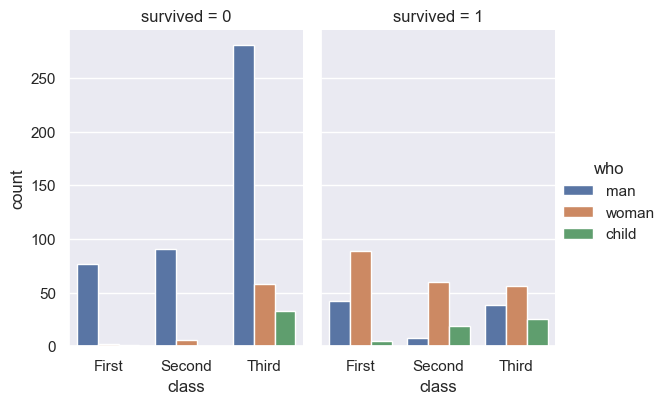

In [464]:
g = sns.catplot(
    data=titanic, x='class', hue='who', 
    col='survived', kind='count', height=4, aspect=.7
)

## Regression plots

### sns.lmplot

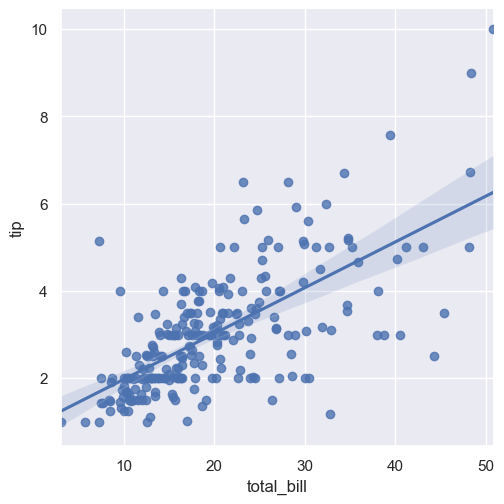

In [465]:
g = sns.lmplot(data=tips, x='total_bill', y='tip')

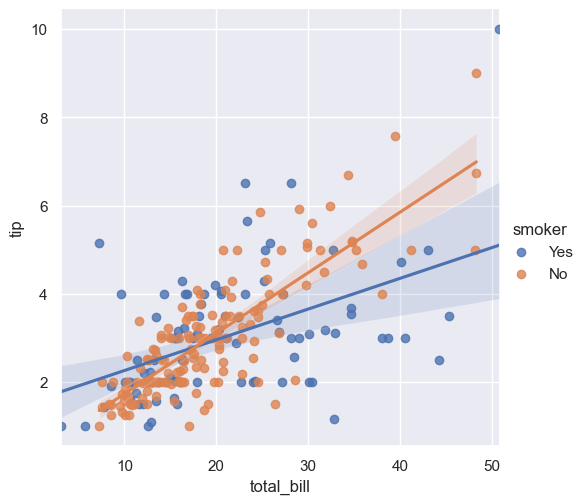

In [466]:
g = sns.lmplot(data=tips, x='total_bill', y='tip', hue='smoker')

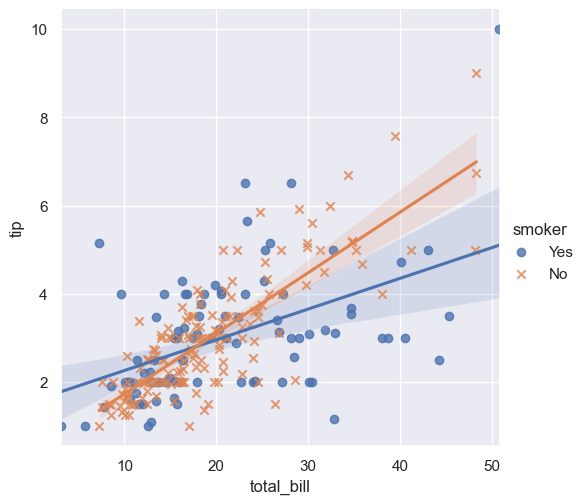

In [467]:
g = sns.lmplot(data=tips, x='total_bill', y='tip', hue='smoker', markers=['o', 'x'])

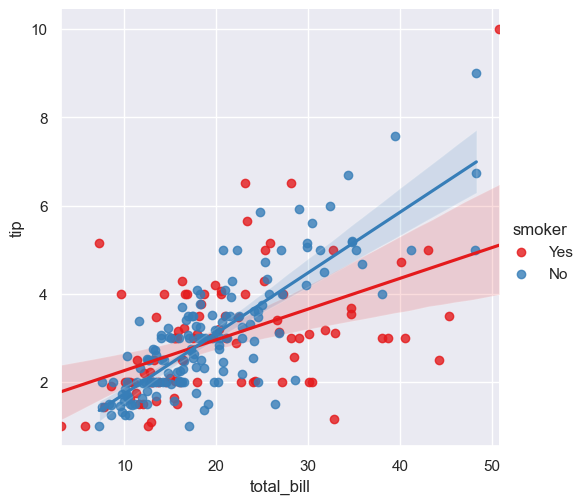

In [468]:
g = sns.lmplot(data=tips, x='total_bill', y='tip', hue='smoker', palette='Set1')

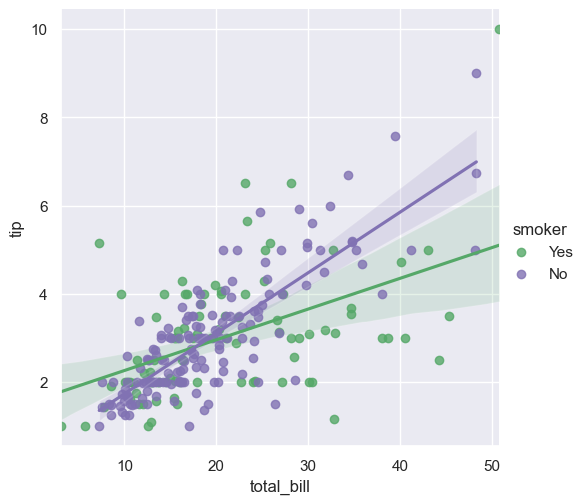

In [469]:
g = sns.lmplot(data=tips, x='total_bill', y='tip', hue='smoker', palette=dict(Yes='g', No='m'))

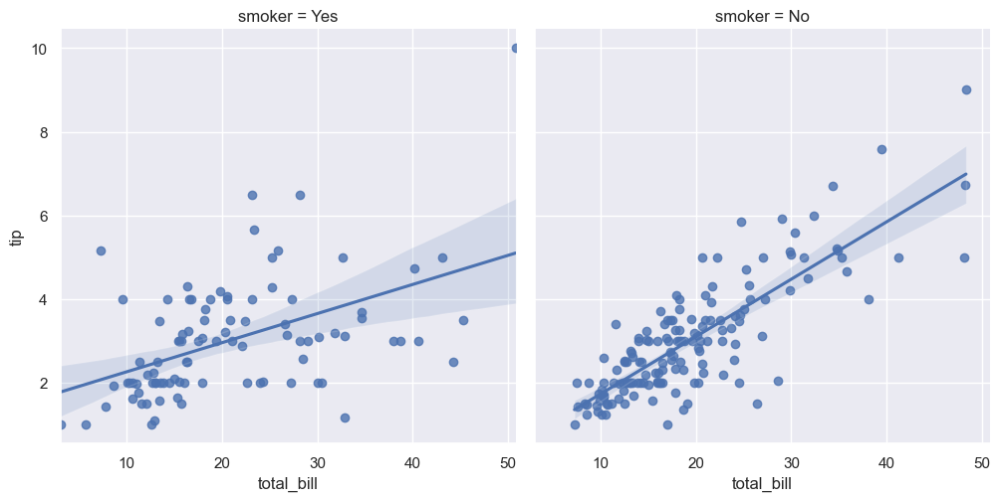

In [470]:
g = sns.lmplot(data=tips, x='total_bill', y='tip', col='smoker')

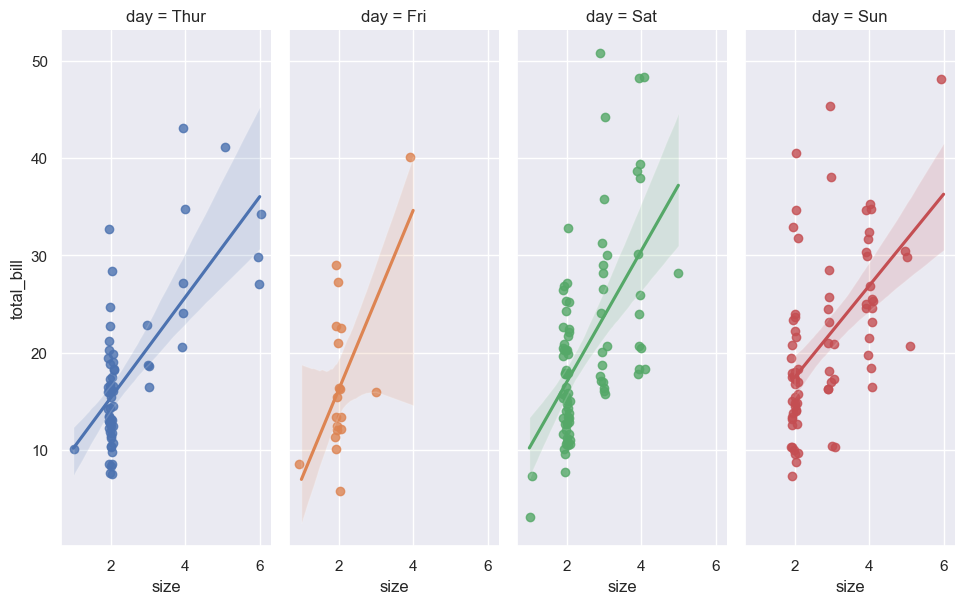

In [471]:
g = sns.lmplot(
    data=tips, x='size', y='total_bill', hue='day', 
    col='day', height=6, aspect=.4, x_jitter=.1
)

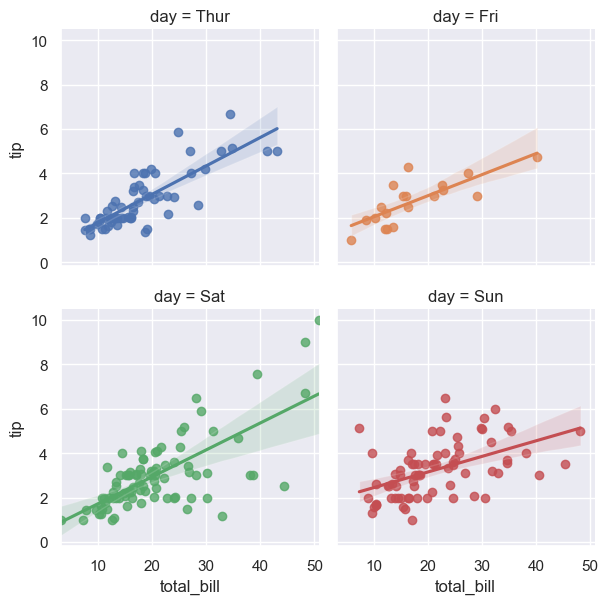

In [472]:
g = sns.lmplot(
    data=tips, x='total_bill', y='tip', hue='day', 
    col='day', col_wrap=2, height=3
)

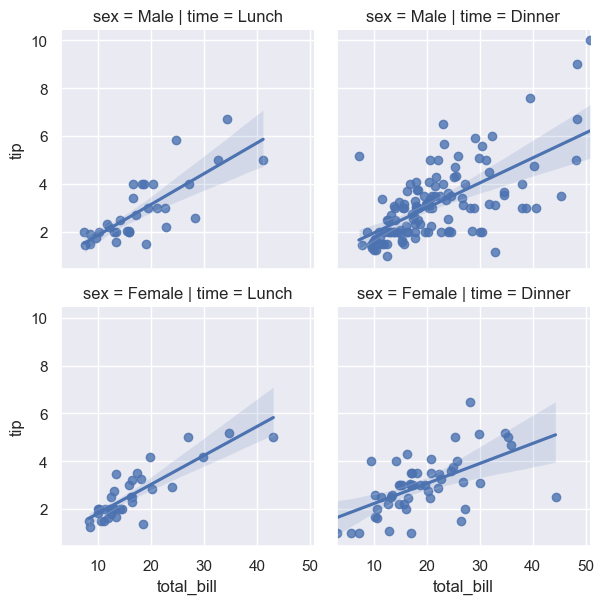

In [473]:
g = sns.lmplot(
    data=tips, x='total_bill', y='tip', 
    row='sex', col='time', height=3
)

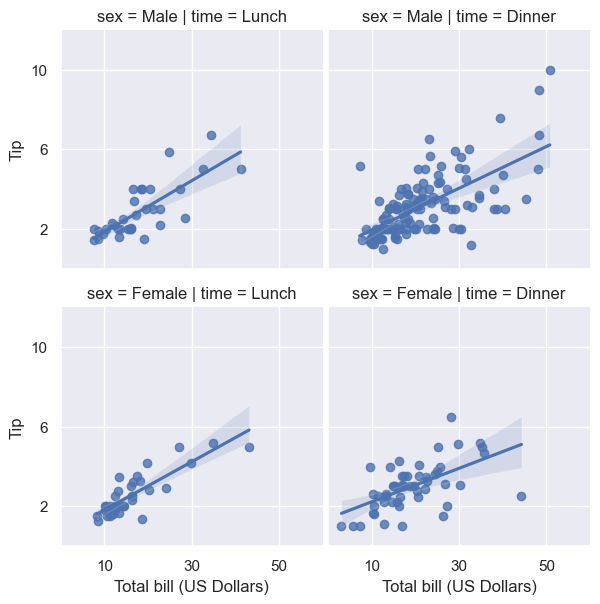

In [474]:
g = sns.lmplot(
    data=tips, x='total_bill', y='tip', 
    row='sex', col='time', height=3
)
g.set_axis_labels('Total bill (US Dollars)', 'Tip')
g.set(xlim=(0, 60), ylim=(0, 12), xticks=[10, 30, 50], yticks=[2, 6, 10])
g.fig.subplots_adjust(wspace=.02)

### sns.regplot

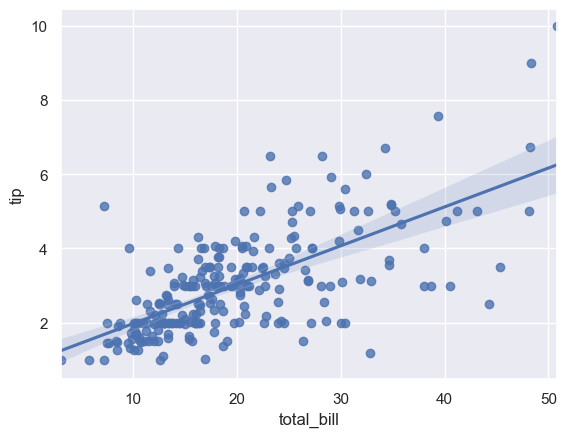

In [475]:
ax = sns.regplot(data=tips, x='total_bill', y='tip')

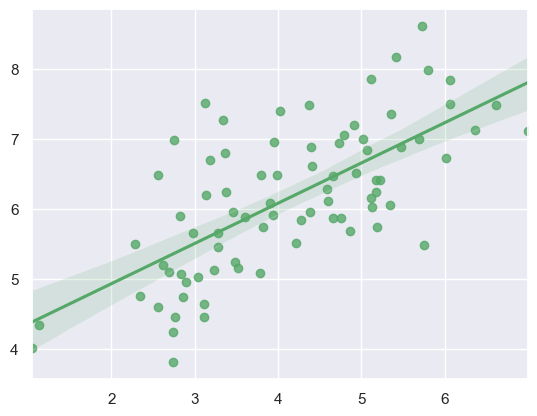

In [476]:
mean, cov = [4, 6], [(1.5, .7), (.7, 1)]
x, y = np.random.multivariate_normal(mean, cov, 80).T
ax = sns.regplot(x=x, y=y, color='g')

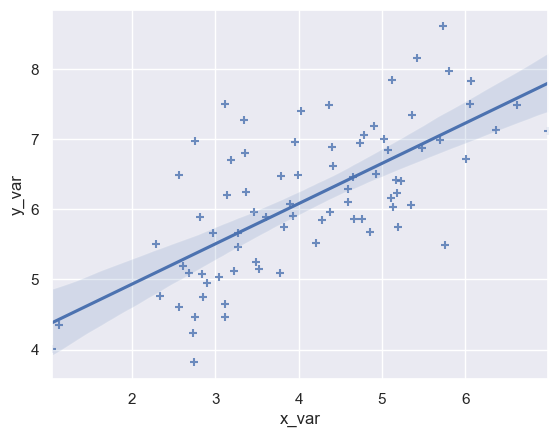

In [477]:
x, y = pd.Series(x, name='x_var'), pd.Series(y, name='y_var')
ax = sns.regplot(x=x, y=y, marker='+')

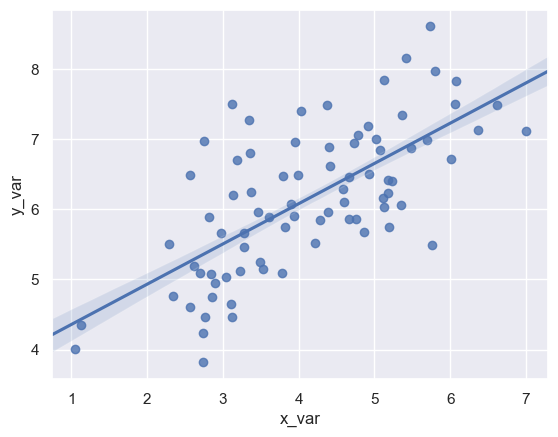

In [478]:
ax = sns.regplot(x=x, y=y, ci=68, truncate=False)

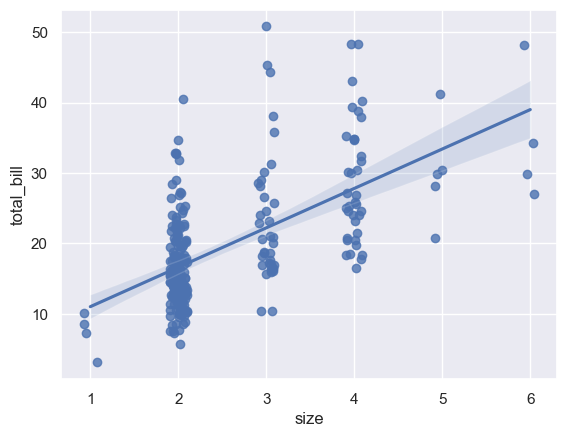

In [479]:
ax = sns.regplot(data=tips, x='size', y='total_bill', x_jitter=.1)

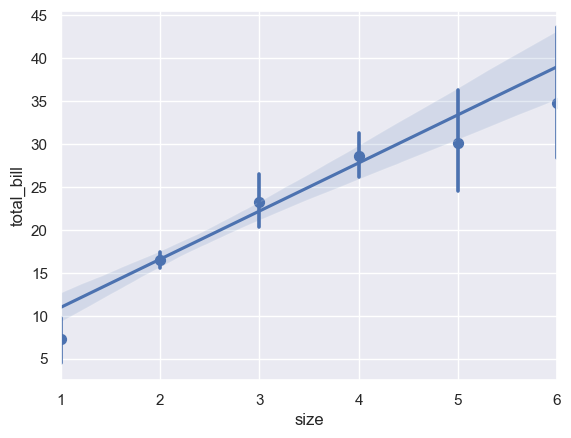

In [480]:
ax = sns.regplot(data=tips, x='size', y='total_bill', x_estimator=np.mean)

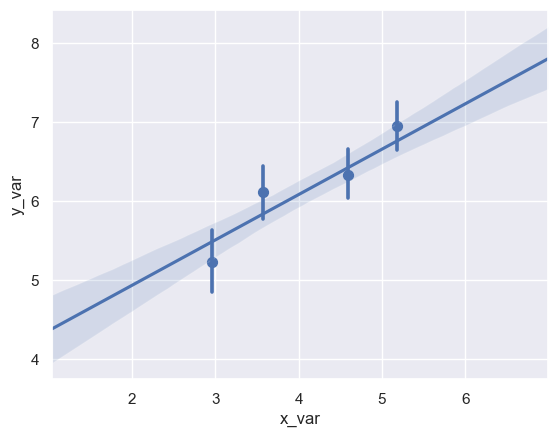

In [481]:
ax = sns.regplot(x=x, y=y, x_bins=4)

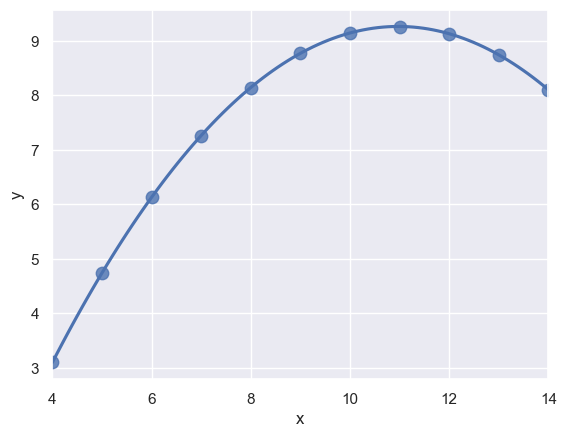

In [482]:
ax = sns.regplot(
    data=anscombe.loc[anscombe['dataset'] == 'II'], 
    x='x', y='y', 
    scatter_kws={'s': 80}, order=2, ci=None
)

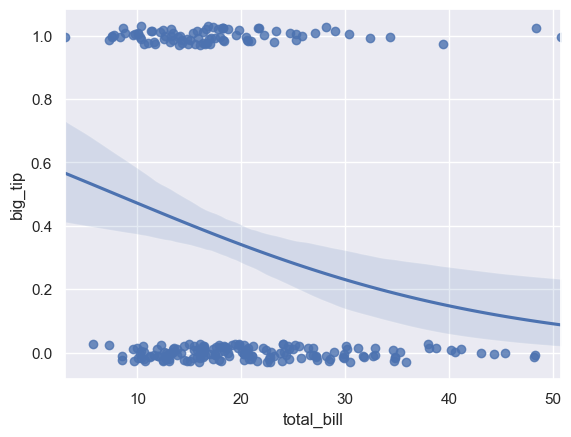

In [483]:
tips['big_tip'] = (tips['tip'] / tips['total_bill']) > .175
ax = sns.regplot(
    data=tips, x='total_bill', y='big_tip', 
    logistic=True, n_boot=500, y_jitter=.03
)

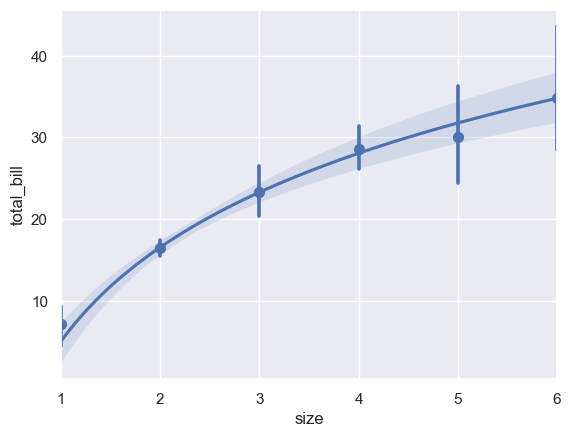

In [484]:
ax = sns.regplot(
    data=tips, x='size', y='total_bill', 
    x_estimator=np.mean, logx=True
)

### sns.residplot

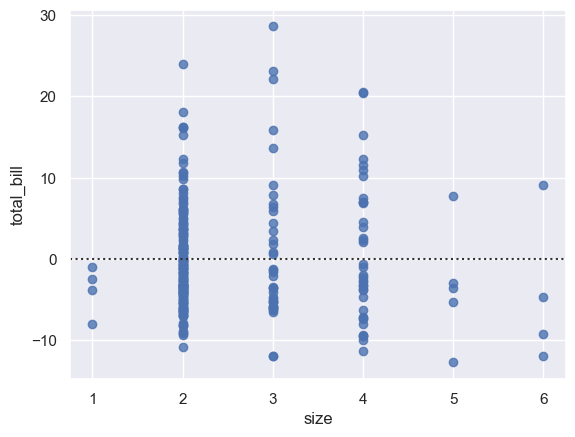

In [485]:
ax = sns.residplot(
    data=tips, x='size', y='total_bill', 
)

## Matrix plots

### sns.heatmap

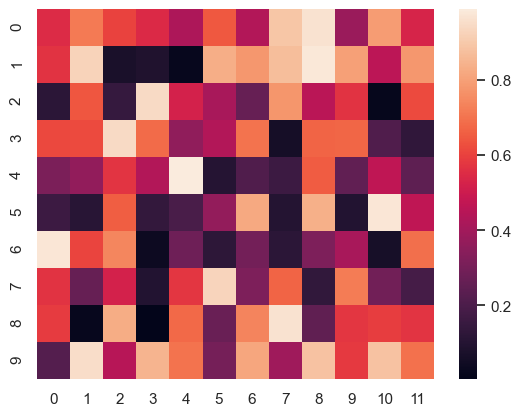

In [486]:
np.random.seed(0)
sns.set_theme()
uniform_data = np.random.rand(10, 12)
ax = sns.heatmap(uniform_data)

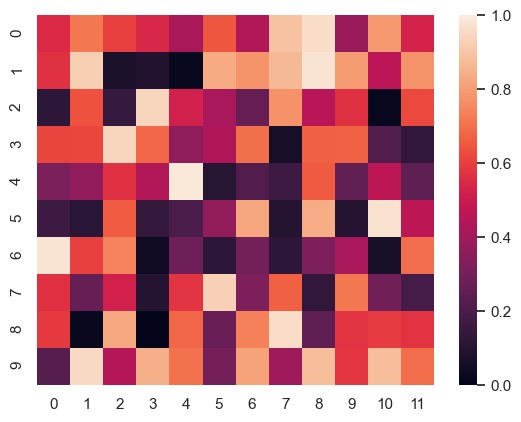

In [487]:
ax = sns.heatmap(uniform_data, vmin=0, vmax=1)

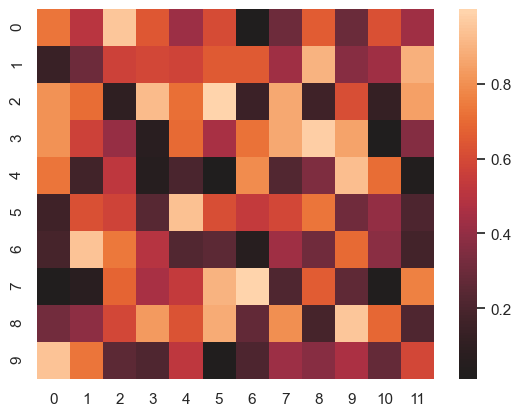

In [488]:
normal_data = np.random.rand(10, 12)
ax = sns.heatmap(normal_data, center=0)

In [489]:
flights

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121
...,...,...,...
139,1960,Aug,606
140,1960,Sep,508
141,1960,Oct,461
142,1960,Nov,390


In [490]:
flights = flights.pivot('month', 'year', 'passengers')
flights

year,1949,1950,1951,1952,1953,1954,1955,1956,1957,1958,1959,1960
month,,,,,,,,,,,,
Jan,112,115,145,171,196,204,242,284,315,340,360,417
Feb,118,126,150,180,196,188,233,277,301,318,342,391
Mar,132,141,178,193,236,235,267,317,356,362,406,419
Apr,129,135,163,181,235,227,269,313,348,348,396,461
May,121,125,172,183,229,234,270,318,355,363,420,472
Jun,135,149,178,218,243,264,315,374,422,435,472,535
Jul,148,170,199,230,264,302,364,413,465,491,548,622
Aug,148,170,199,242,272,293,347,405,467,505,559,606
Sep,136,158,184,209,237,259,312,355,404,404,463,508


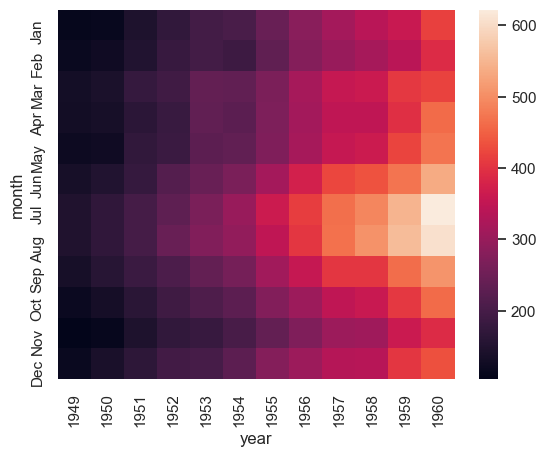

In [491]:
ax = sns.heatmap(flights)

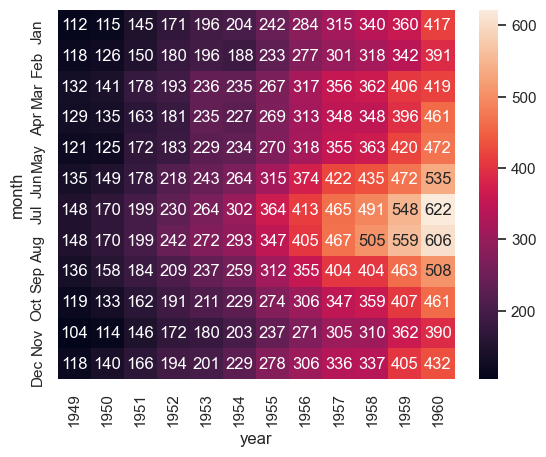

In [492]:
ax = sns.heatmap(flights, annot=True, fmt='d')

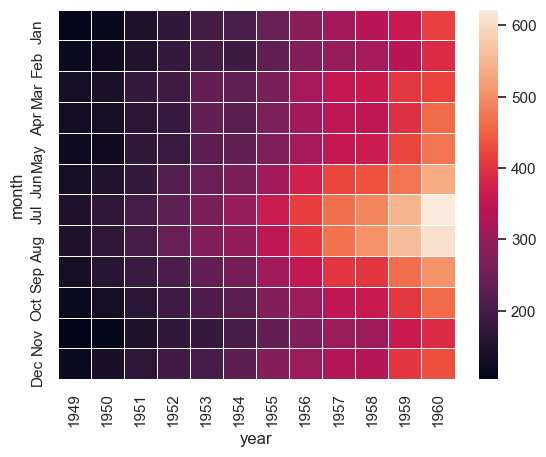

In [493]:
ax = sns.heatmap(flights, linewidths=.5)

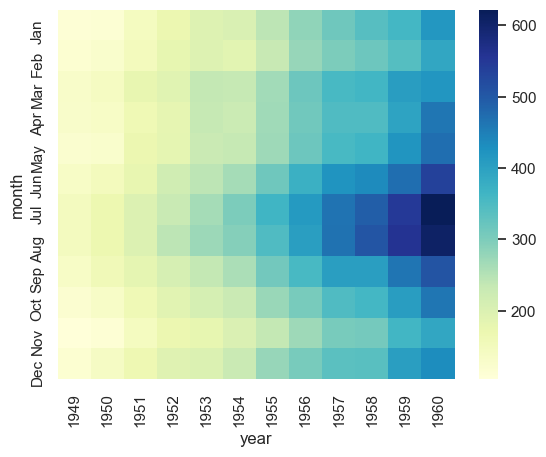

In [494]:
ax = sns.heatmap(flights, cmap='YlGnBu')

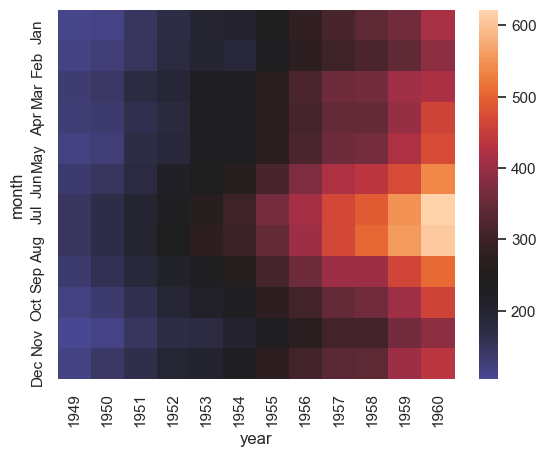

In [495]:
ax = sns.heatmap(flights, center=flights.loc['Jan', 1955])

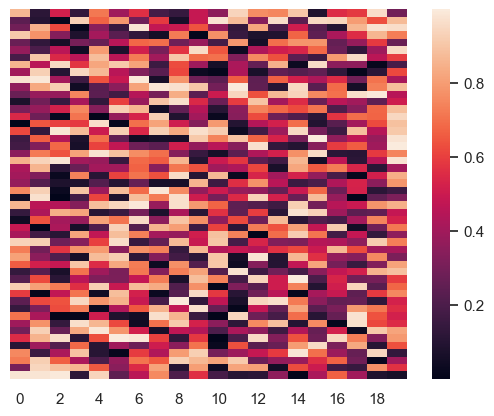

In [496]:
data = np.random.rand(50, 20)
ax = sns.heatmap(data, xticklabels=2, yticklabels=False)

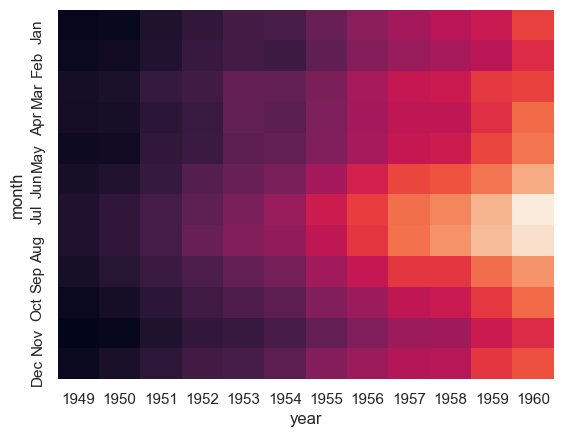

In [497]:
ax = sns.heatmap(flights, cbar=False)

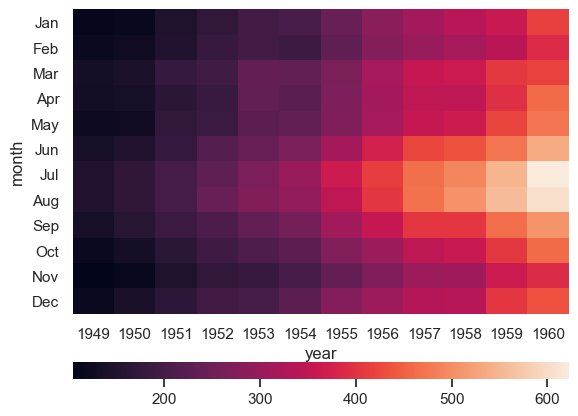

In [498]:
grid_kws = {'height_ratios': (.9, .05), 'hspace': .3}
f, (ax, cbar_ax) = plt.subplots(2, gridspec_kw=grid_kws)
ax = sns.heatmap(
    flights, ax=ax, cbar_ax=cbar_ax, cbar_kws={'orientation': 'horizontal'}
)

In [499]:
corr = np.corrcoef(np.random.rand(10, 200))
corr

array([[ 1.        ,  0.06850946,  0.06037316, -0.0102938 ,  0.04149645,
        -0.01479522, -0.05642474,  0.12405632, -0.04843613,  0.03610724],
       [ 0.06850946,  1.        , -0.02702706,  0.06673593,  0.098184  ,
        -0.17799741,  0.0905795 ,  0.03721903,  0.16242562,  0.0598358 ],
       [ 0.06037316, -0.02702706,  1.        ,  0.13522429,  0.02243316,
        -0.12064777,  0.01731259, -0.02915477,  0.12790029,  0.05240904],
       [-0.0102938 ,  0.06673593,  0.13522429,  1.        ,  0.04950626,
        -0.08878608, -0.04723046, -0.06004671,  0.07827056,  0.04165301],
       [ 0.04149645,  0.098184  ,  0.02243316,  0.04950626,  1.        ,
        -0.02105939, -0.00454308, -0.03022189,  0.03181684, -0.0528267 ],
       [-0.01479522, -0.17799741, -0.12064777, -0.08878608, -0.02105939,
         1.        , -0.02290344,  0.12396156,  0.00496901, -0.10345019],
       [-0.05642474,  0.0905795 ,  0.01731259, -0.04723046, -0.00454308,
        -0.02290344,  1.        , -0.01210596

In [500]:
mask = np.zeros_like(corr)
mask

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]])

In [501]:
corr.shape, mask.shape

((10, 10), (10, 10))

In [502]:
np.triu_indices_from(mask)

(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2,
        2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5,
        5, 6, 6, 6, 6, 7, 7, 7, 8, 8, 9], dtype=int64),
 array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 1, 2, 3, 4, 5, 6, 7, 8, 9, 2, 3, 4,
        5, 6, 7, 8, 9, 3, 4, 5, 6, 7, 8, 9, 4, 5, 6, 7, 8, 9, 5, 6, 7, 8,
        9, 6, 7, 8, 9, 7, 8, 9, 8, 9, 9], dtype=int64))

In [503]:
mask[np.triu_indices_from(mask)] = True

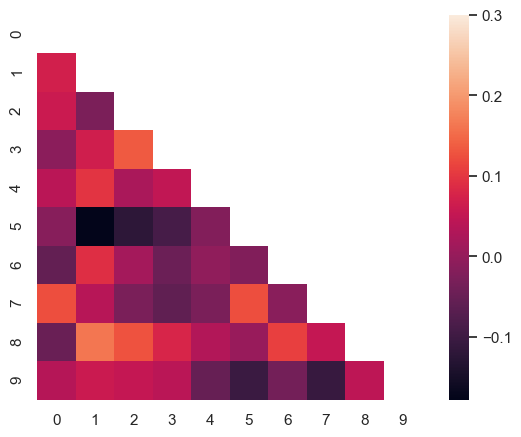

In [504]:
with sns.axes_style('white'):
    f, ax = plt.subplots(figsize=(7, 5))
    ax = sns.heatmap(corr, mask=mask, vmax=.3, square=True)

### sns.clustermap

In [505]:
sns.set_theme(color_codes=True)
species = iris.pop('species')
species

0         setosa
1         setosa
2         setosa
3         setosa
4         setosa
         ...    
145    virginica
146    virginica
147    virginica
148    virginica
149    virginica
Name: species, Length: 150, dtype: object

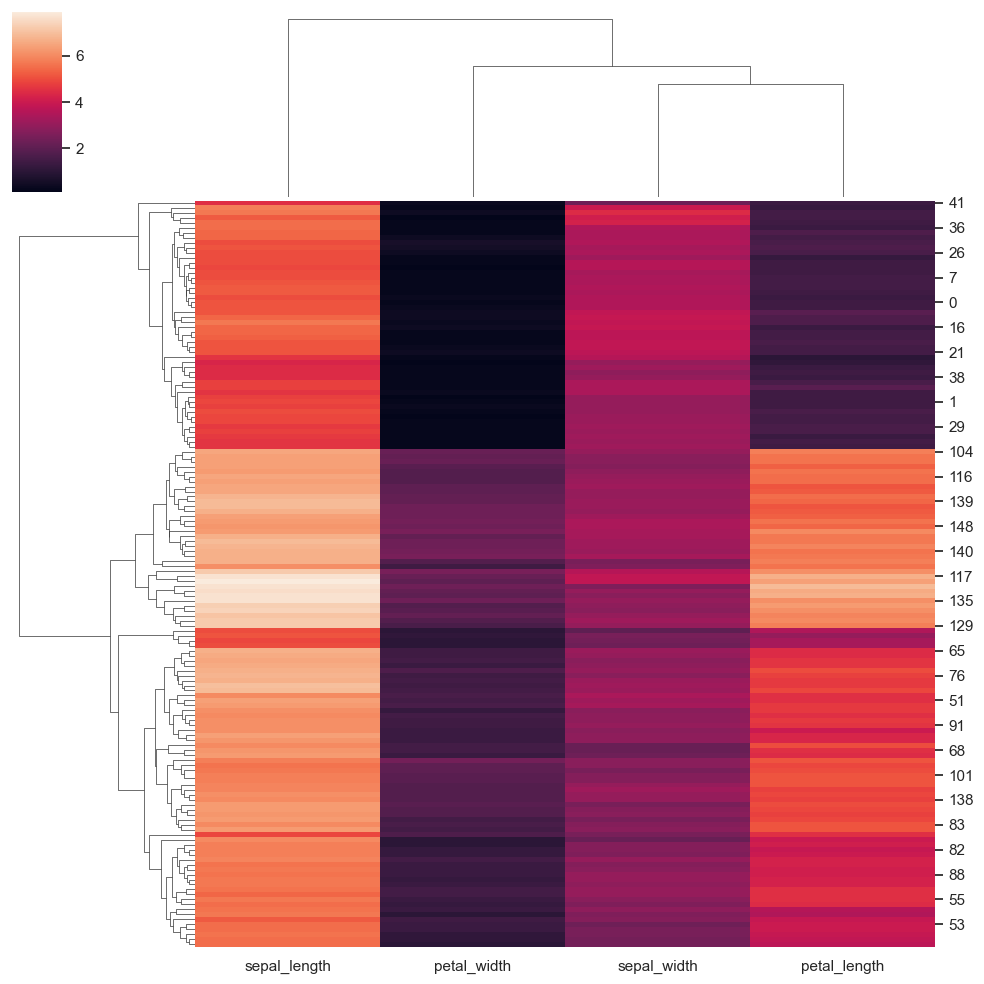

In [506]:
g = sns.clustermap(iris)

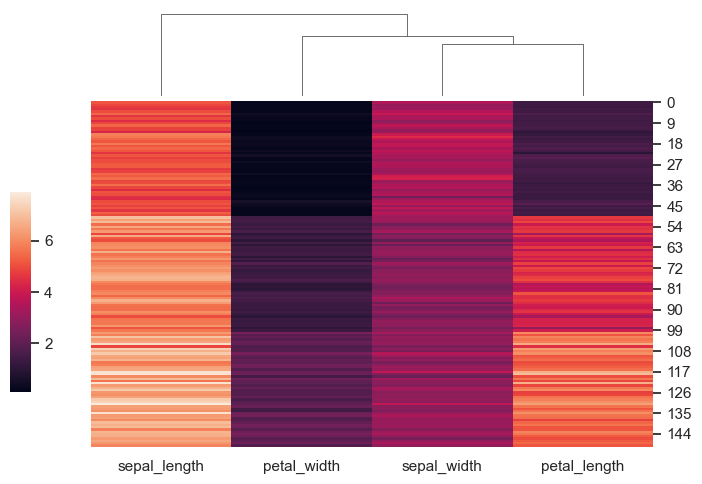

In [507]:
g = sns.clustermap(
    iris, figsize=(7, 5), 
    row_cluster=False, dendrogram_ratio=(.1, .2), cbar_pos=(0, .2, .03, .4)
)

In [508]:
lut = dict(zip(species.unique(), 'rbg'))
lut

{'setosa': 'r', 'versicolor': 'b', 'virginica': 'g'}

In [509]:
row_colors = species.map(lut)
row_colors

0      r
1      r
2      r
3      r
4      r
      ..
145    g
146    g
147    g
148    g
149    g
Name: species, Length: 150, dtype: object

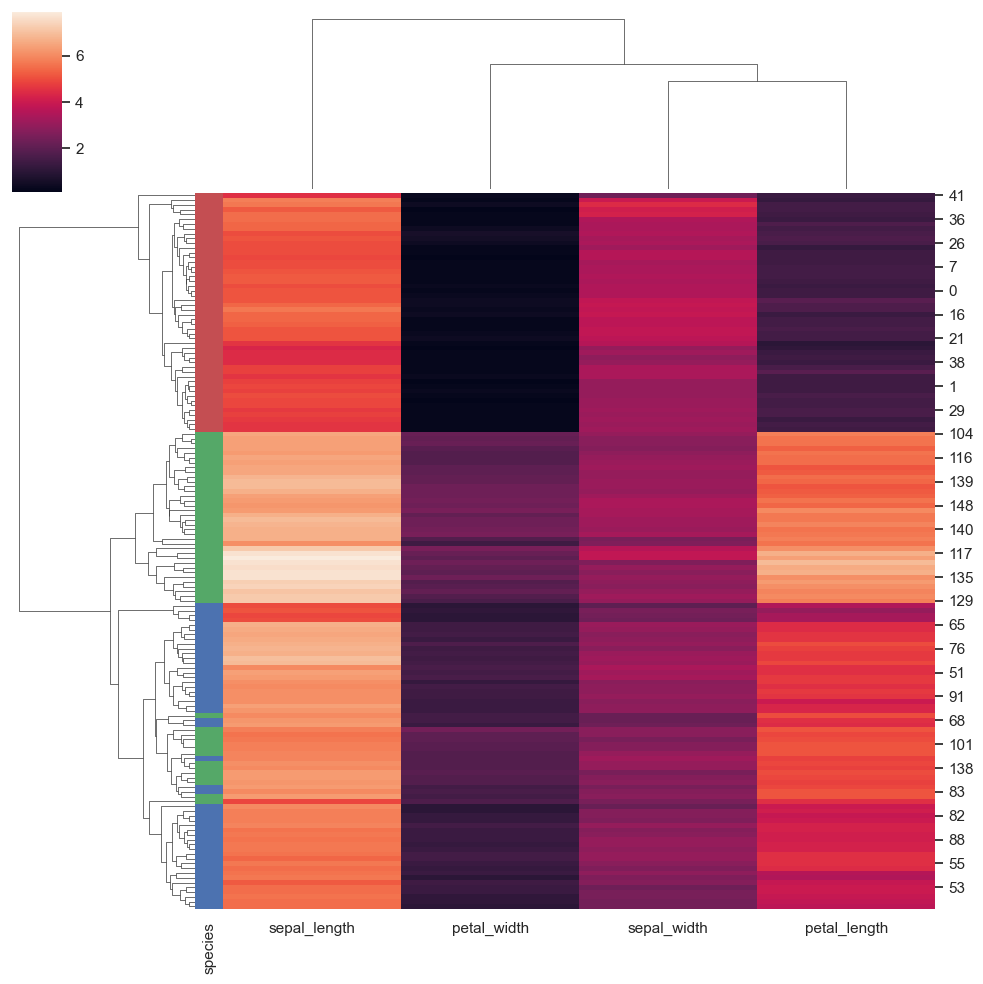

In [510]:
g = sns.clustermap(iris, row_colors=row_colors)

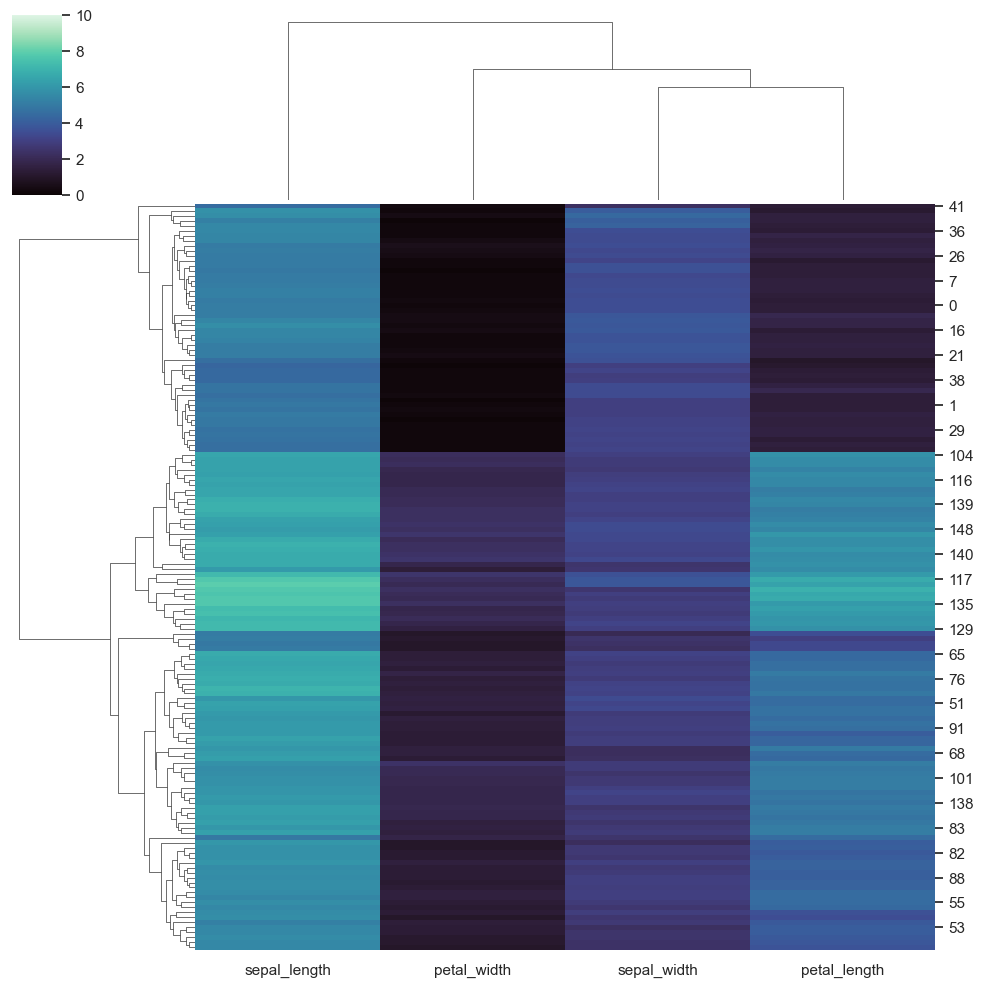

In [511]:
g = sns.clustermap(iris, cmap='mako', vmin=0, vmax=10)

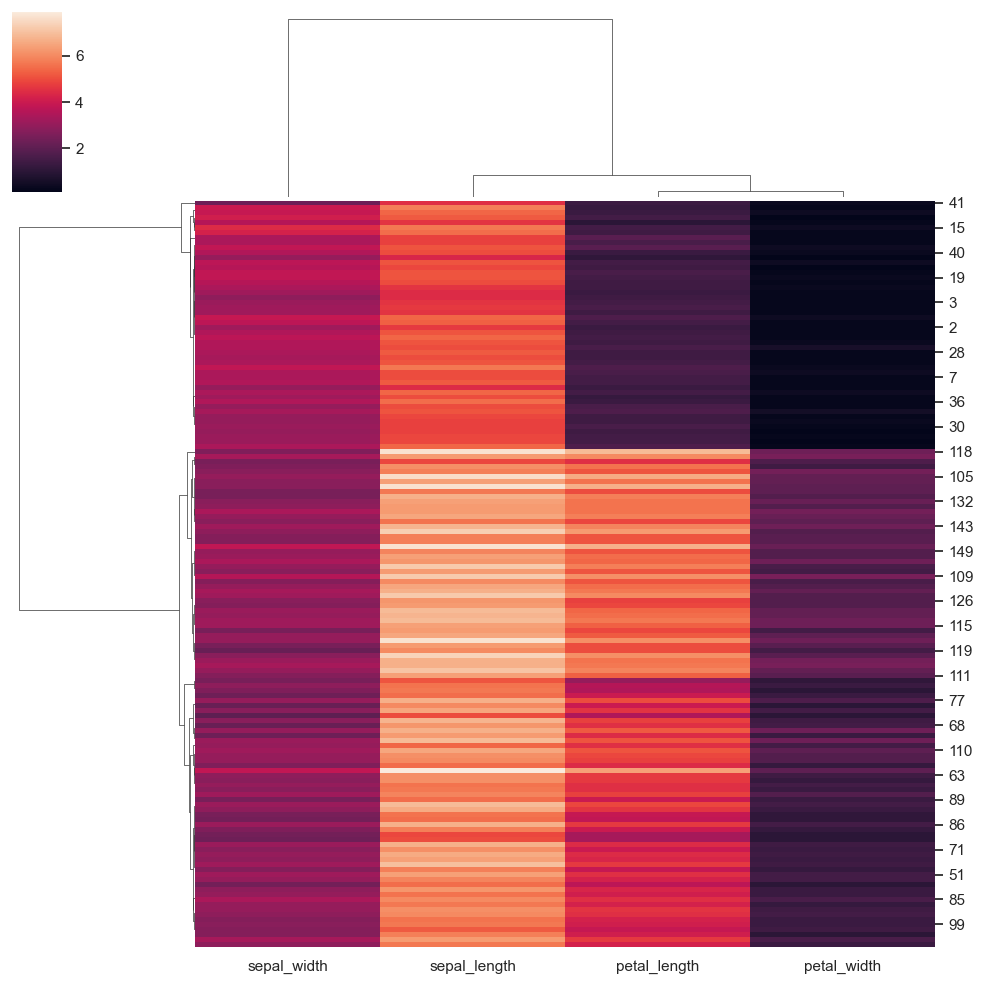

In [512]:
g = sns.clustermap(iris, metric='correlation')

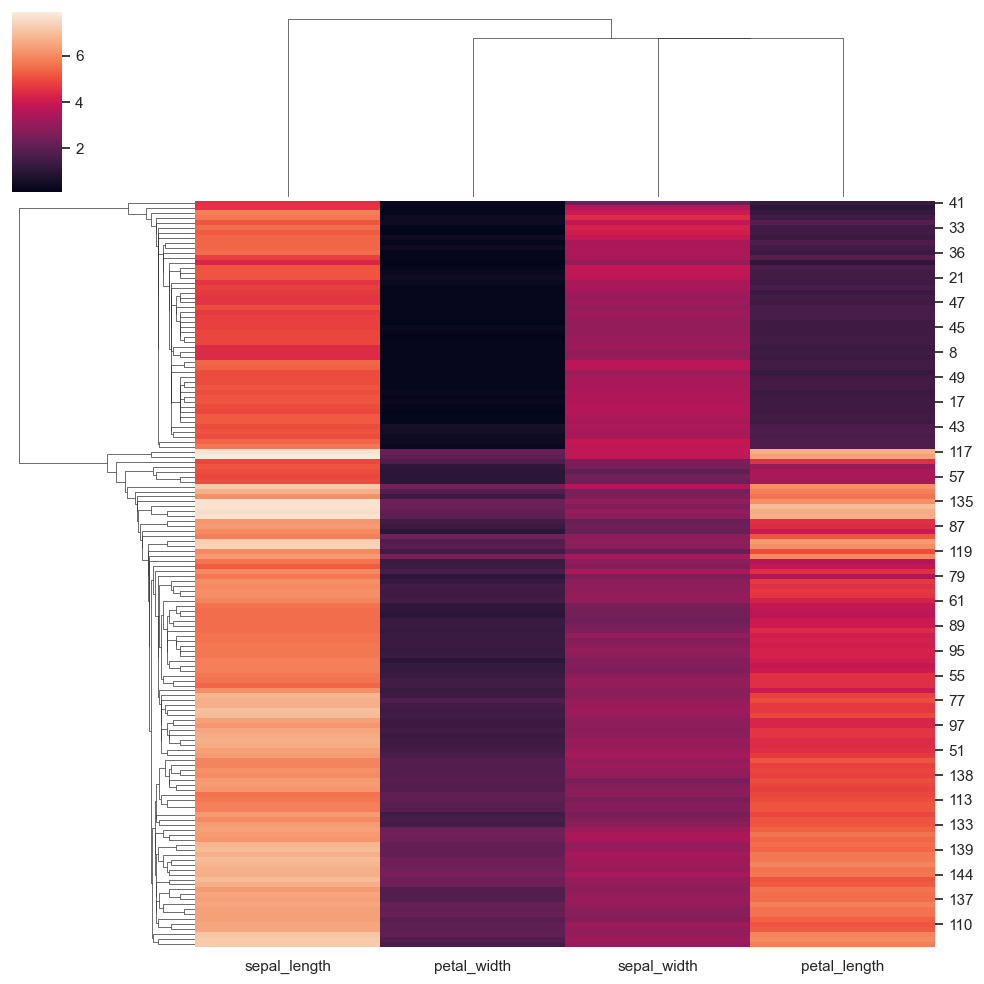

In [513]:
g = sns.clustermap(iris, method='single')

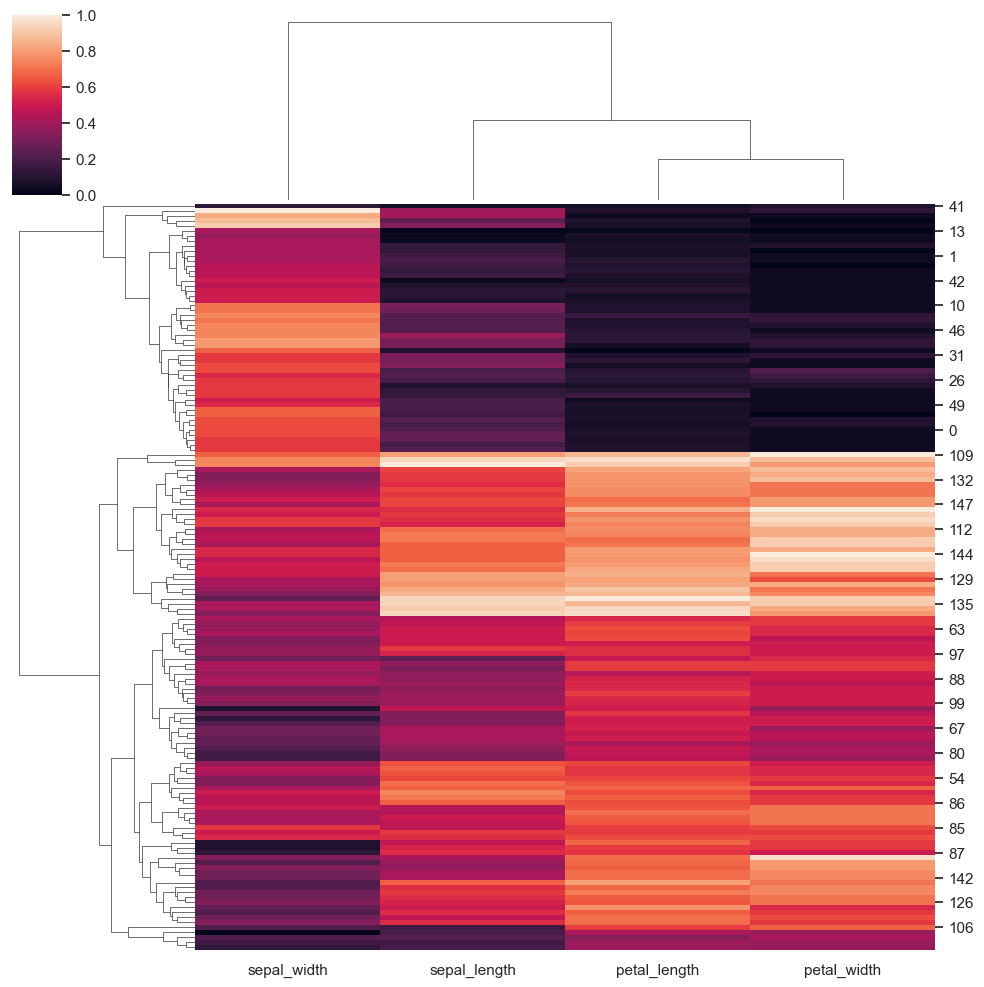

In [514]:
g = sns.clustermap(iris, standard_scale=1)

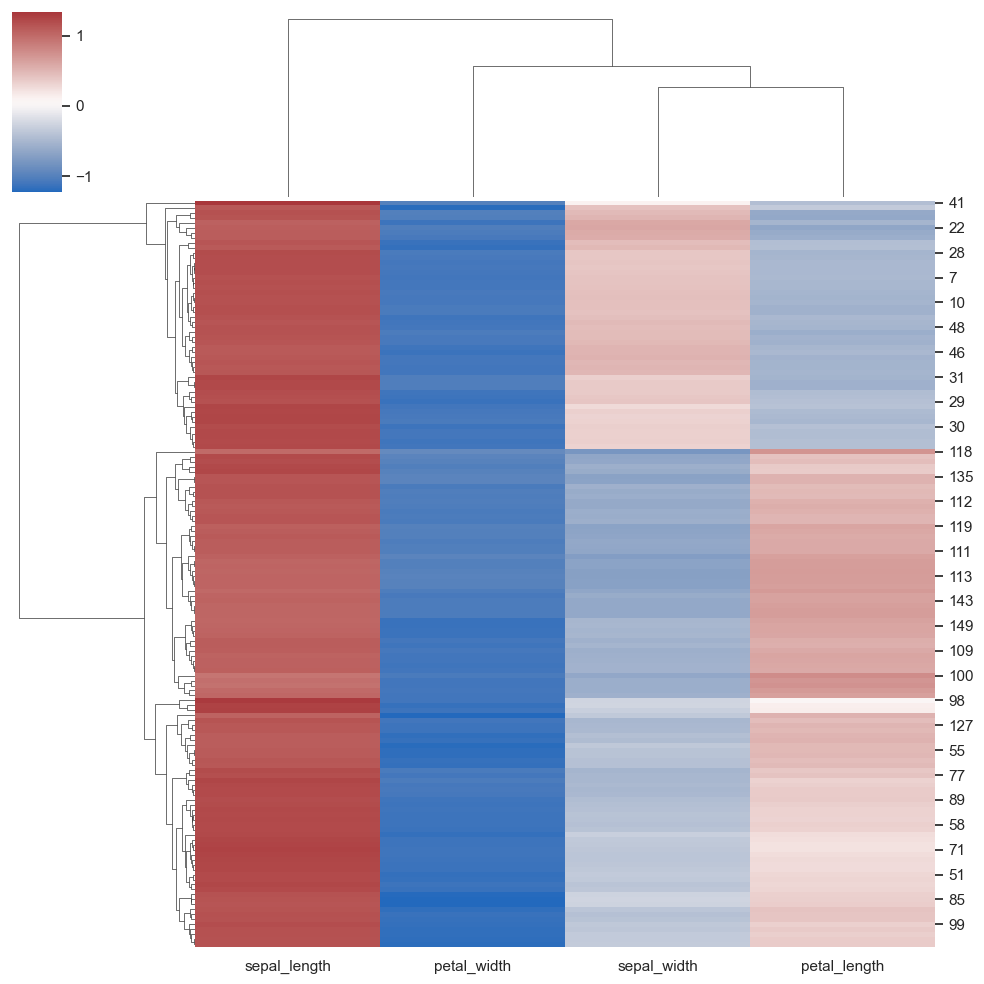

In [515]:
g = sns.clustermap(iris, z_score=0, cmap='vlag')

## Multi-plot grids

### Facet grids

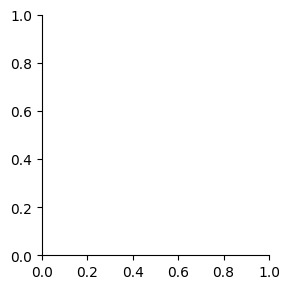

In [523]:
tips = sns.load_dataset('tips')
sns.reset_defaults()
sns.FacetGrid(tips)

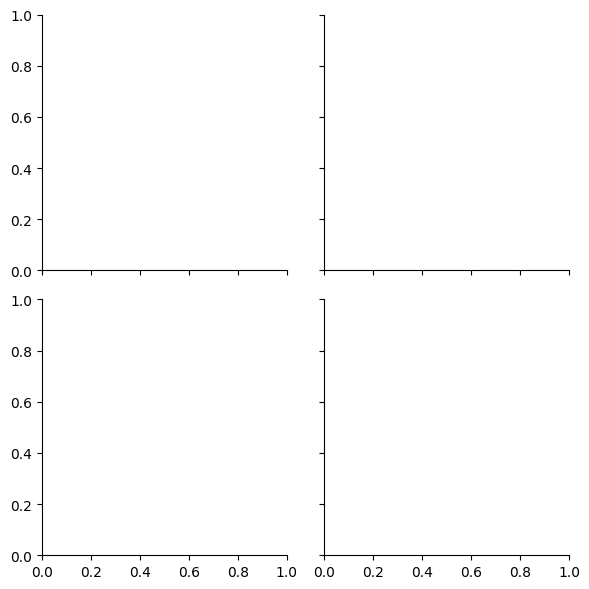

In [524]:
sns.FacetGrid(tips, col='time', row='sex')

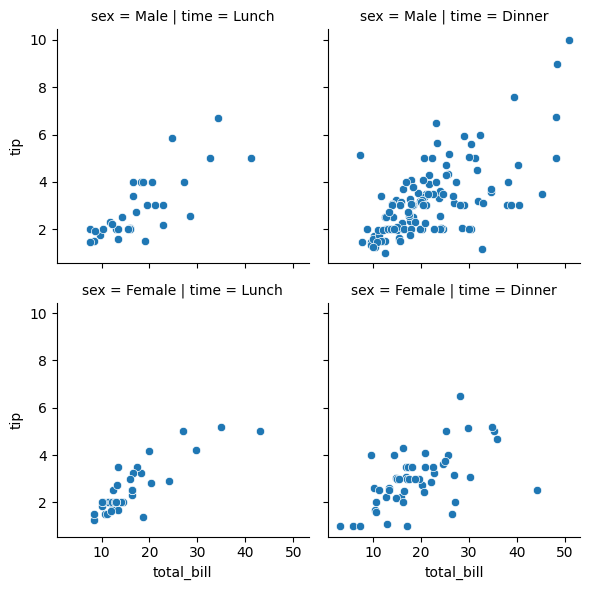

In [525]:
g = sns.FacetGrid(tips, col='time', row='sex')
g.map(sns.scatterplot, 'total_bill', 'tip')

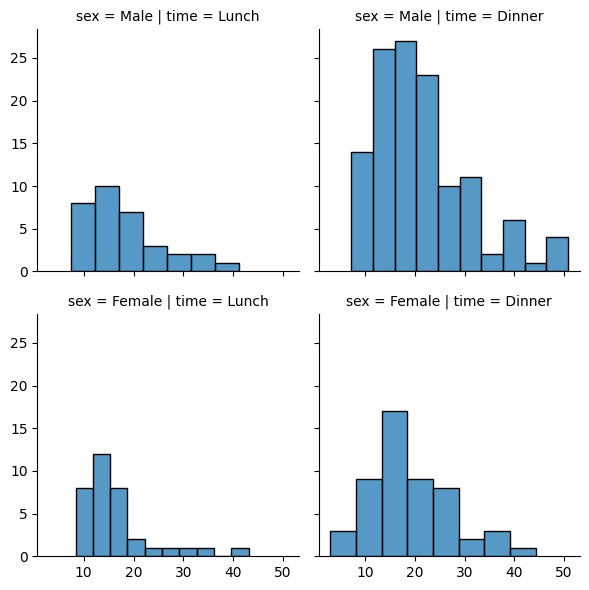

In [526]:
g = sns.FacetGrid(tips, col='time', row='sex')
g.map_dataframe(sns.histplot, x='total_bill')

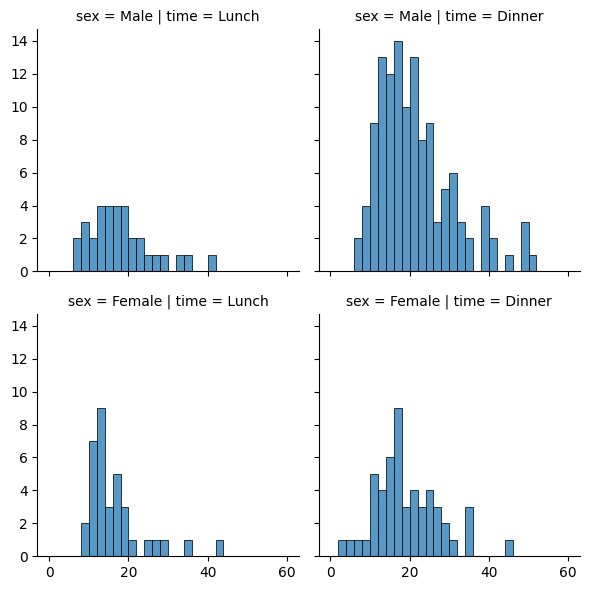

In [527]:
g = sns.FacetGrid(tips, col='time', row='sex')
g.map_dataframe(sns.histplot, x='total_bill', binwidth=2, binrange=(0, 60))

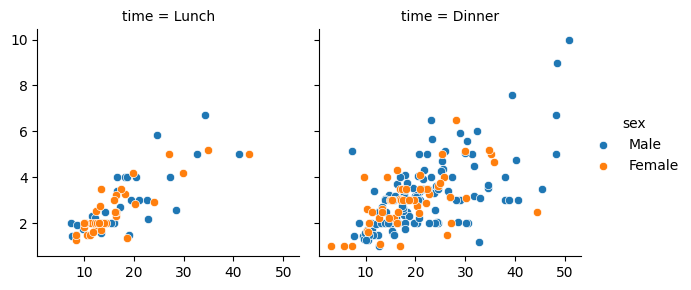

In [528]:
g = sns.FacetGrid(tips, col='time', hue='sex')
g.map_dataframe(sns.scatterplot, x='total_bill', y='tip')
g.add_legend()

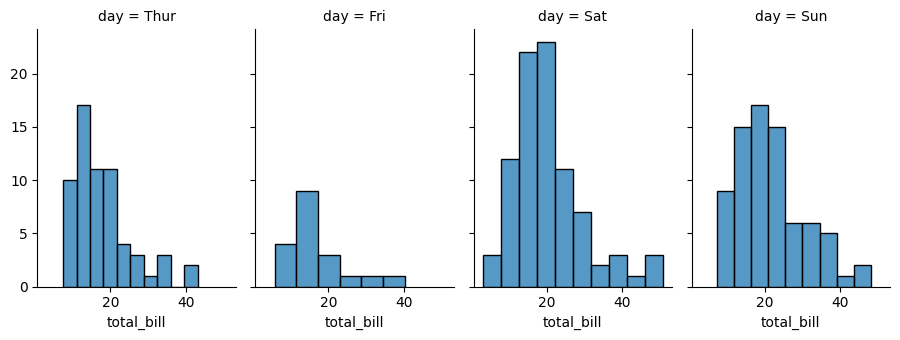

In [529]:
g = sns.FacetGrid(tips, col='day', height=3.5, aspect=.65)
g.map(sns.histplot, 'total_bill')

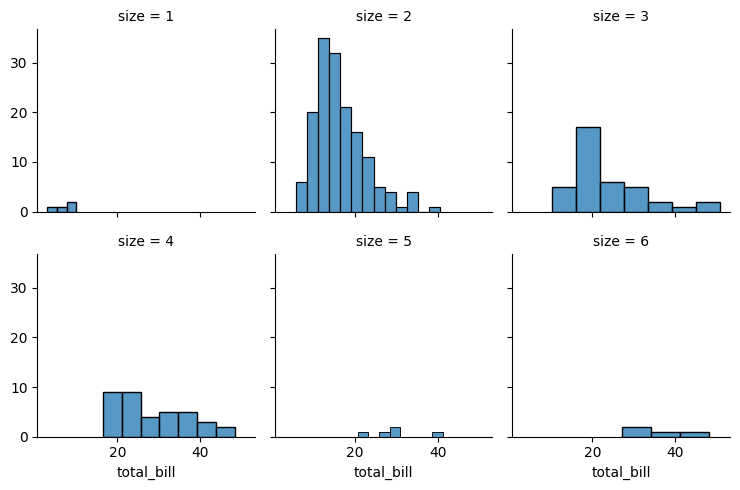

In [532]:
g = sns.FacetGrid(tips, col='size', height=2.5, col_wrap=3)
g.map(sns.histplot, 'total_bill')

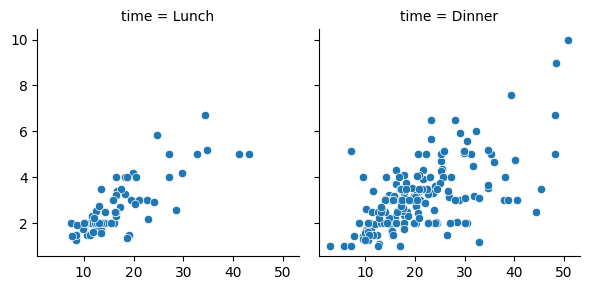

In [543]:
g = sns.FacetGrid(tips, col='time', margin_titles=True)
g.map_dataframe(sns.scatterplot, x='total_bill', y='tip')

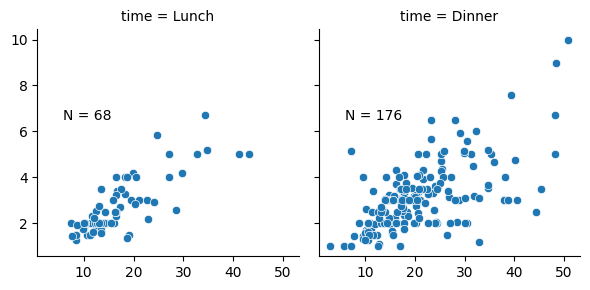

In [546]:
def annotate(data, **kws):
    n  = len(data)
    ax = plt.gca()
    ax.text(.1, .6, f'N = {n}', transform=ax.transAxes)

g = sns.FacetGrid(tips, col='time')
g.map_dataframe(sns.scatterplot, x='total_bill', y='tip')
g.map_dataframe(annotate)

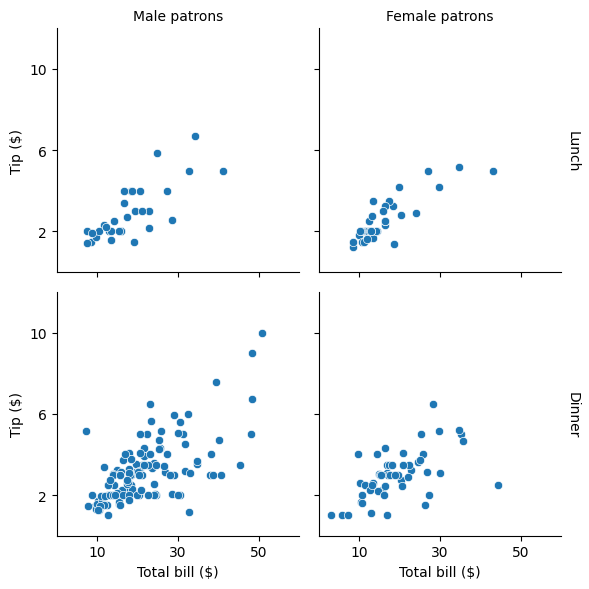

In [557]:
g = sns.FacetGrid(tips, col='sex', row='time', margin_titles=True)
g.map_dataframe(sns.scatterplot, x='total_bill', y='tip')
g.set_axis_labels('Total bill ($)', 'Tip ($)')
g.set_titles(col_template='{col_name} patrons', row_template='{row_name}')
g.set(xlim=(0, 60), ylim=(0, 12), xticks=[10, 30, 50], yticks=[2, 6, 10])
g.tight_layout()

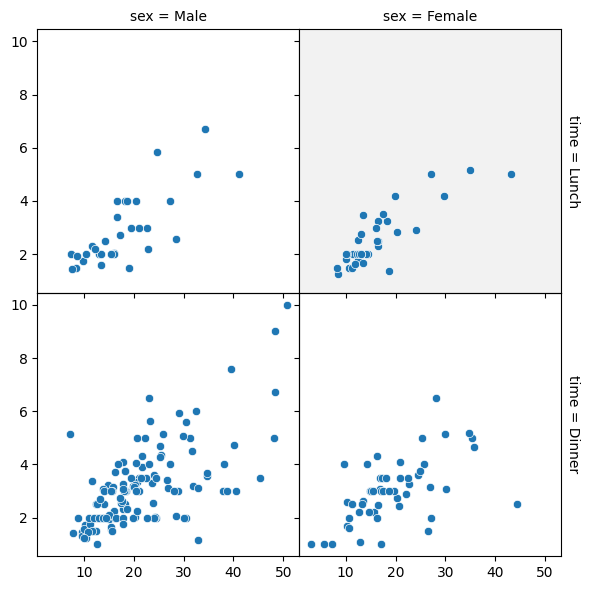

In [562]:
g = sns.FacetGrid(tips, col='sex', row='time', margin_titles=True, despine=False)
g.map_dataframe(sns.scatterplot, x='total_bill', y='tip')
g.fig.subplots_adjust(wspace=0, hspace=0)
for (row_val, col_val), ax in g.axes_dict.items():
    if row_val == 'Lunch' and col_val == 'Female':
        ax.set_facecolor('.95')
    else:
        ax.set_facecolor((0, 0, 0, 0))

### Pair grids

#### sns.pairplot

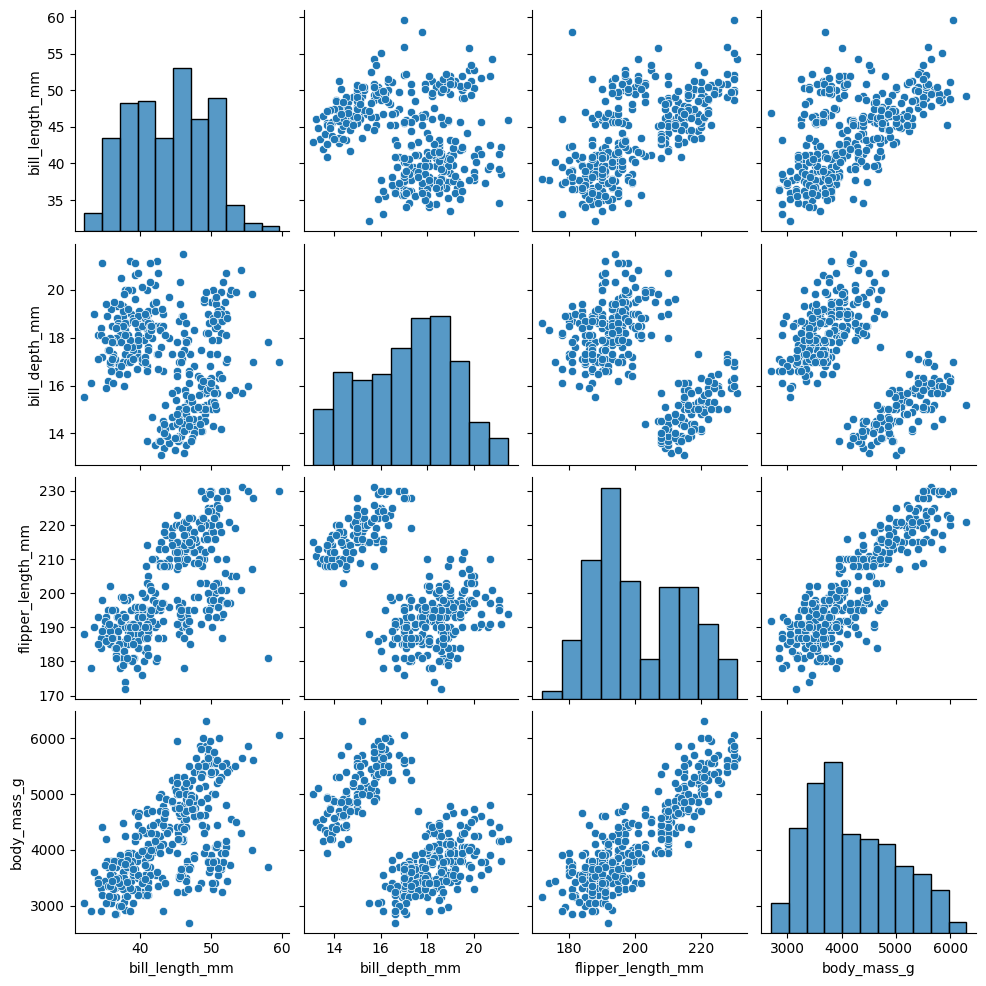

In [568]:
penguins = sns.load_dataset('penguins')
sns.pairplot(penguins)

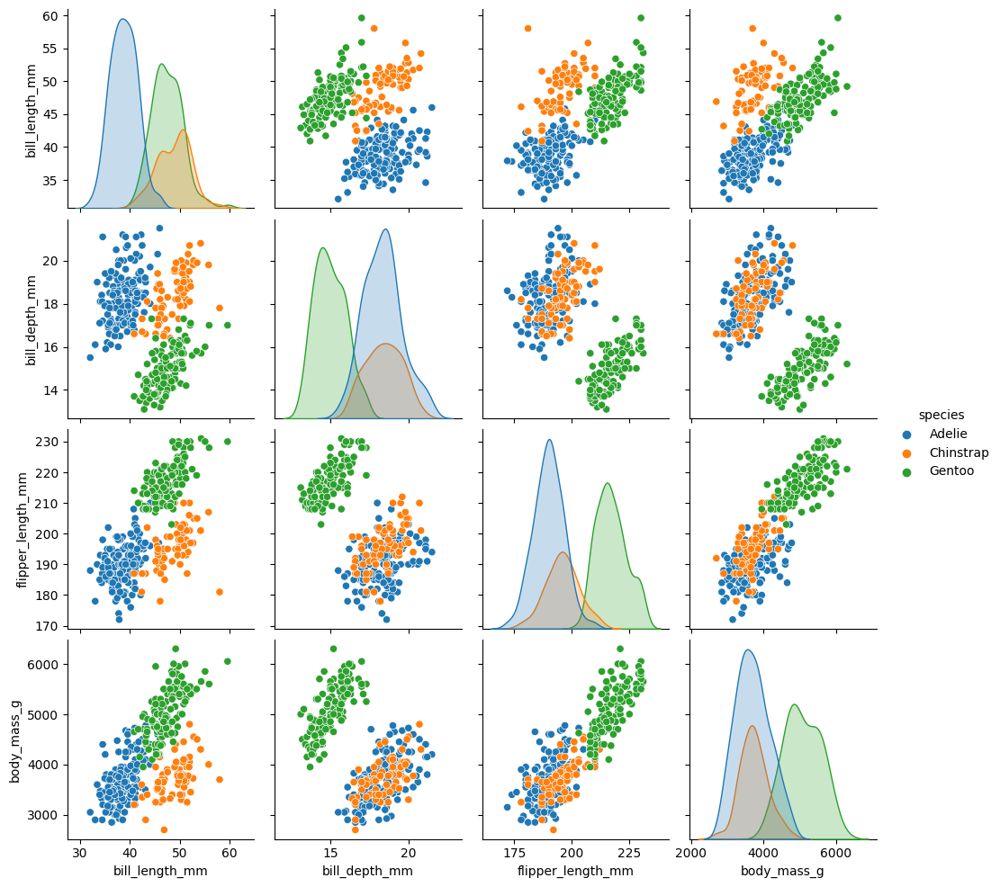

In [569]:
sns.pairplot(penguins, hue='species')

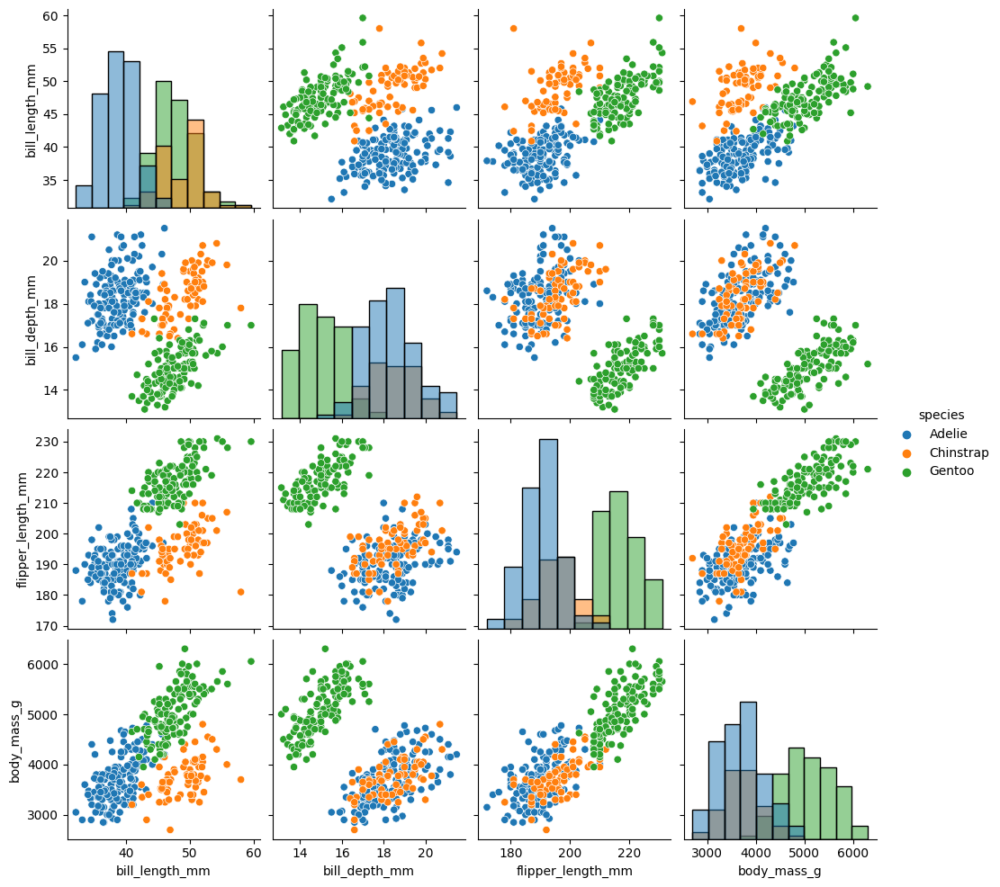

In [570]:
sns.pairplot(penguins, hue='species', diag_kind='hist')

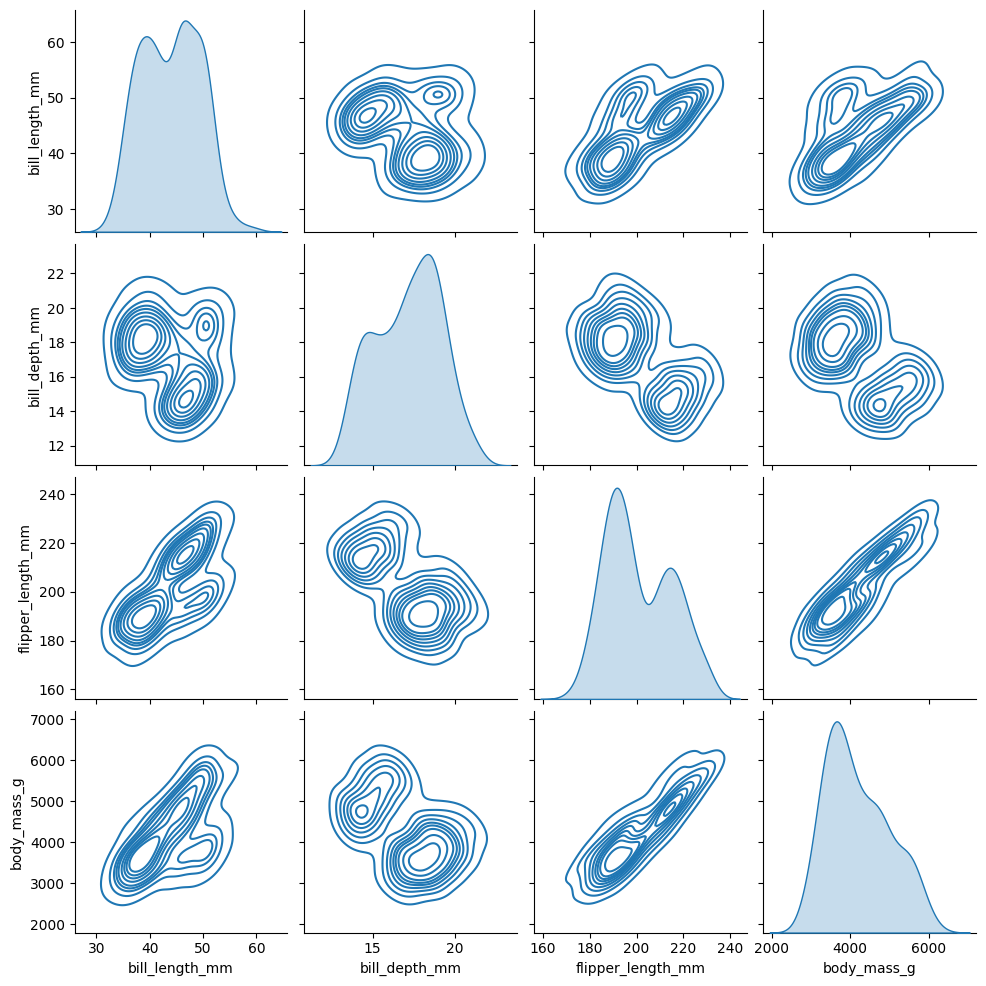

In [571]:
sns.pairplot(penguins, kind='kde')

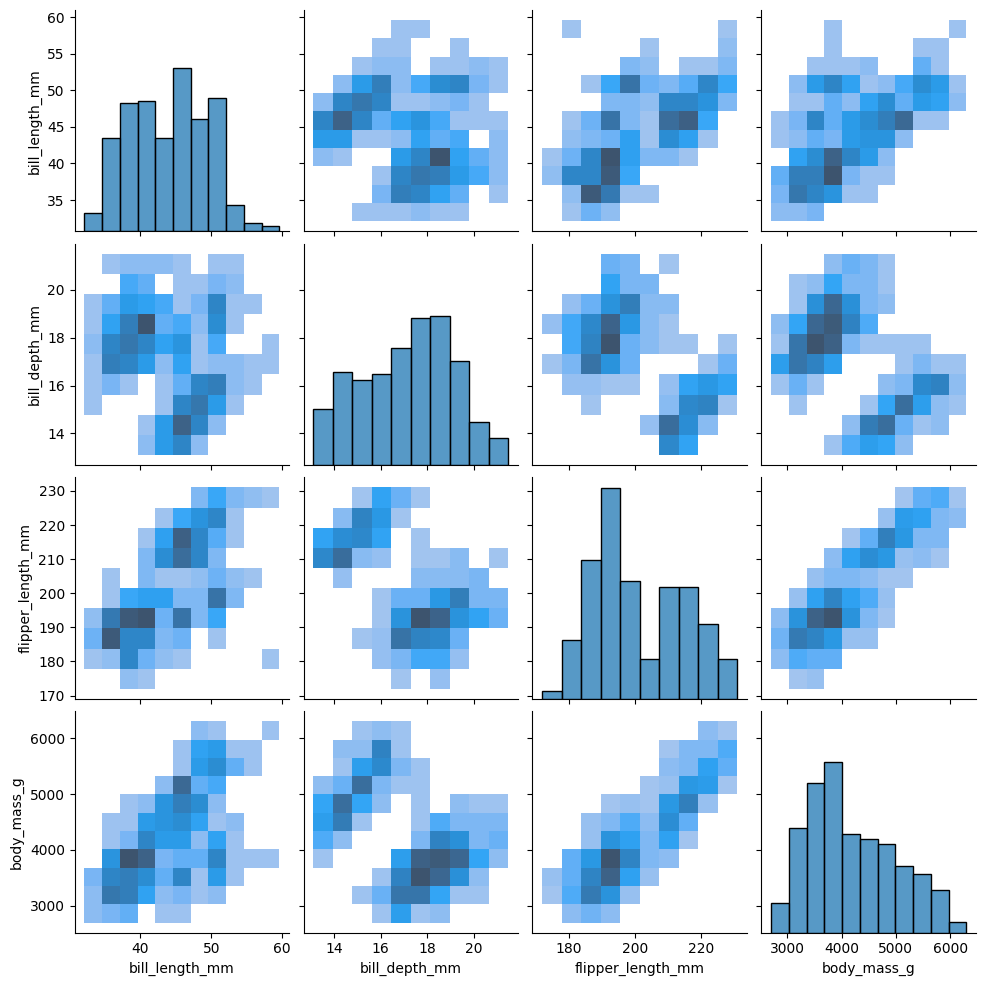

In [572]:
sns.pairplot(penguins, kind='hist')

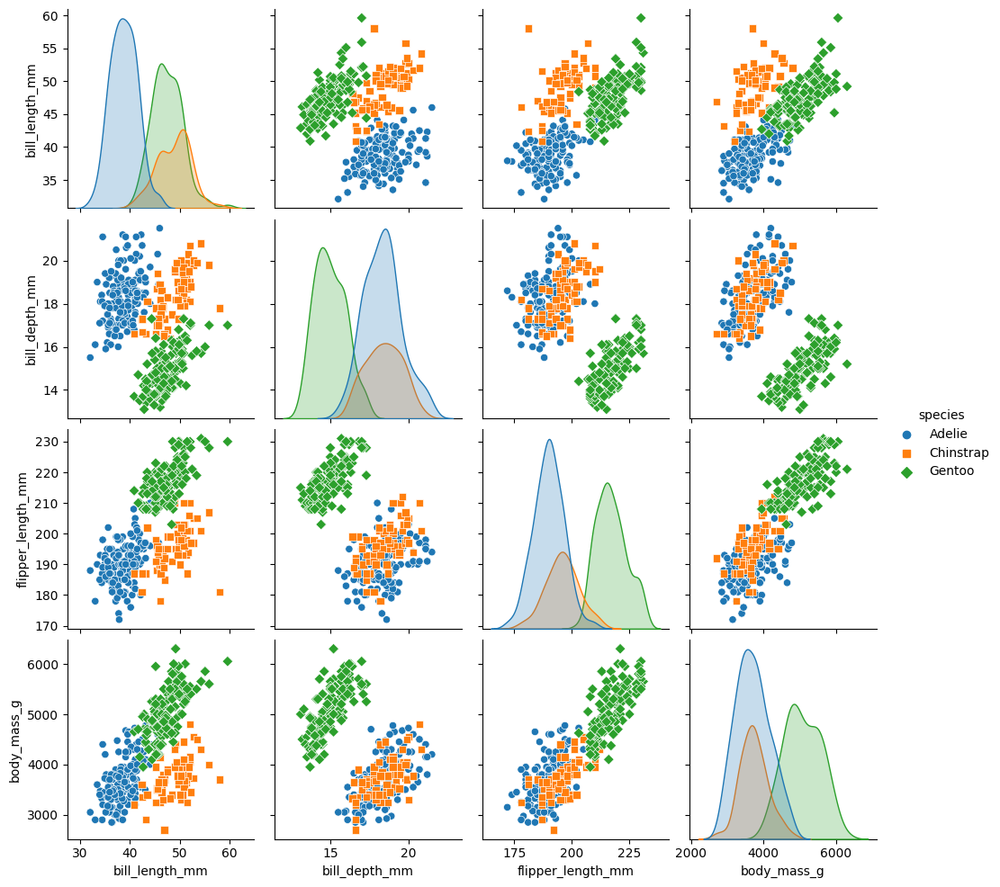

In [574]:
sns.pairplot(penguins, hue='species', markers=['o', 's', 'D'])

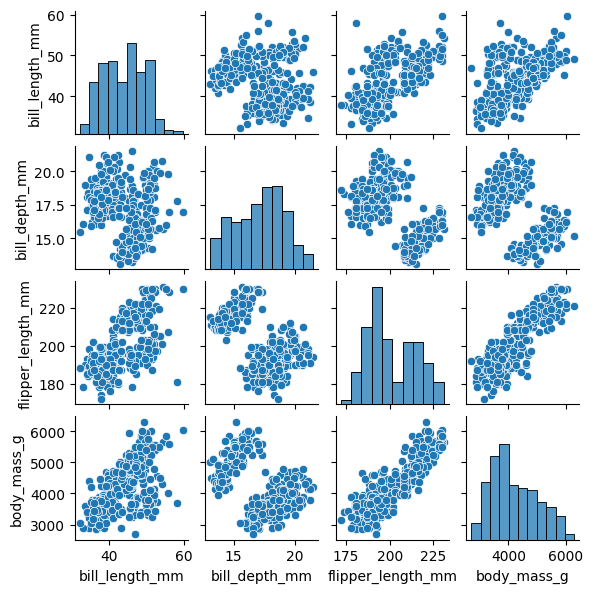

In [575]:
sns.pairplot(penguins, height=1.5)

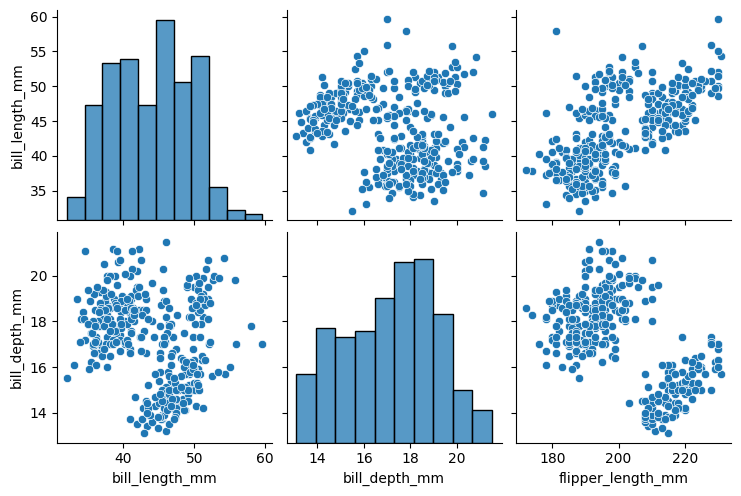

In [577]:
sns.pairplot(
    penguins, 
    x_vars=['bill_length_mm', 'bill_depth_mm', 'flipper_length_mm'], 
    y_vars=['bill_length_mm', 'bill_depth_mm'], 
)

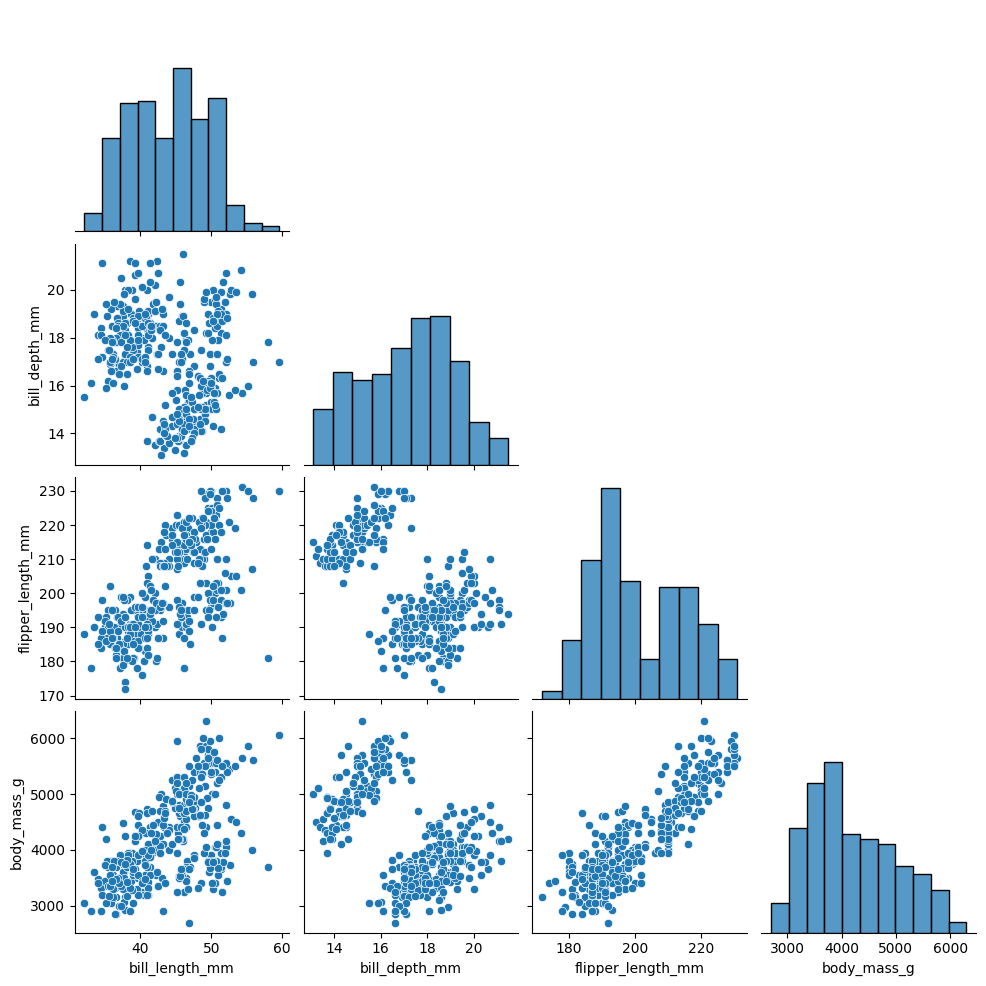

In [581]:
sns.pairplot(penguins, corner=True)

f:\workspace\venv\lib\site-packages\seaborn\relational.py:651: UserWarning: You passed a edgecolor/edgecolors ('w') for an unfilled marker ('+').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  points = ax.scatter(*args, **kws)
f:\workspace\venv\lib\site-packages\seaborn\relational.py:651: UserWarning: You passed a edgecolor/edgecolors ('w') for an unfilled marker ('+').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  points = ax.scatter(*args, **kws)
f:\workspace\venv\lib\site-packages\seaborn\relational.py:651: UserWarning: You passed a edgecolor/edgecolors ('w') for an unfilled marker ('+').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  points = ax.scatter(*args, **kws)
f:\workspace\venv\lib\site-packages\seaborn\relational.py:651: UserWarning: You passed a edgecolor/edgecolors ('w') for an unfilled mark

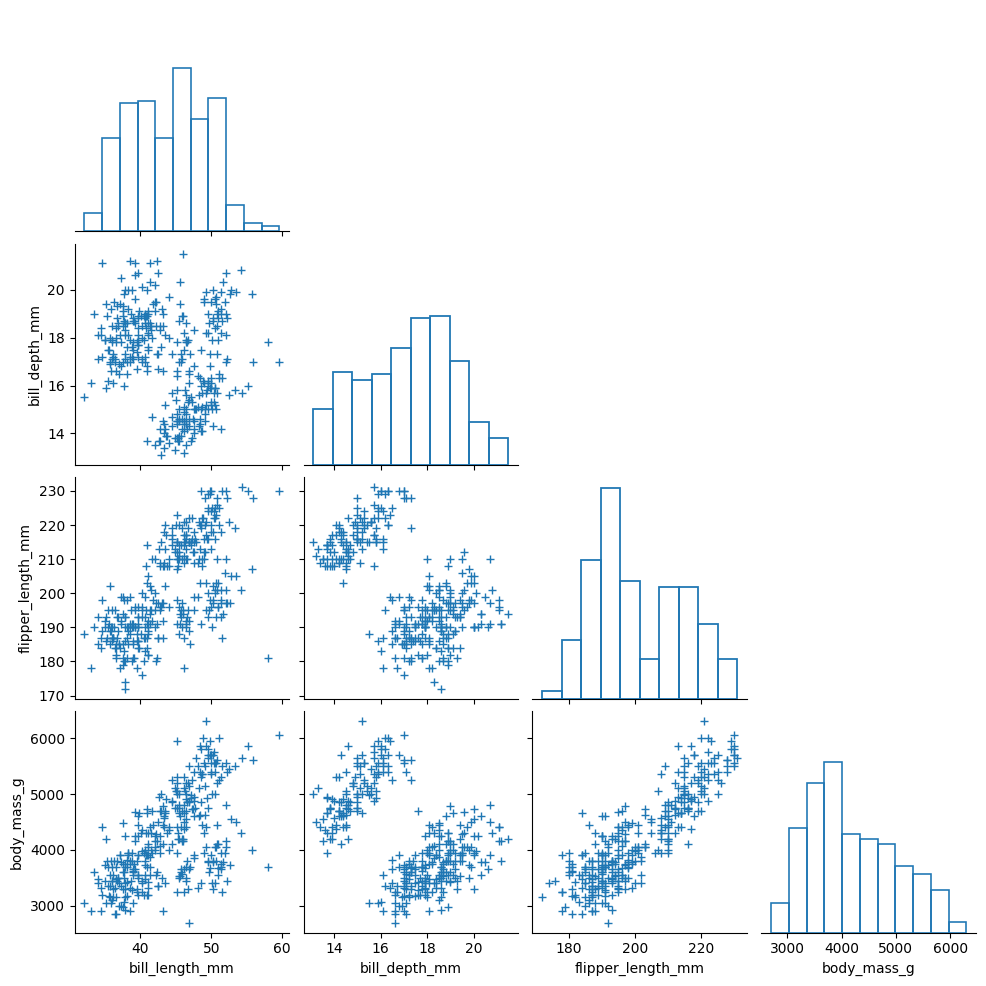

In [582]:
sns.pairplot(
    penguins, 
    plot_kws=dict(marker='+', linewidth=1), 
    diag_kws=dict(fill=False), 
    corner=True
)

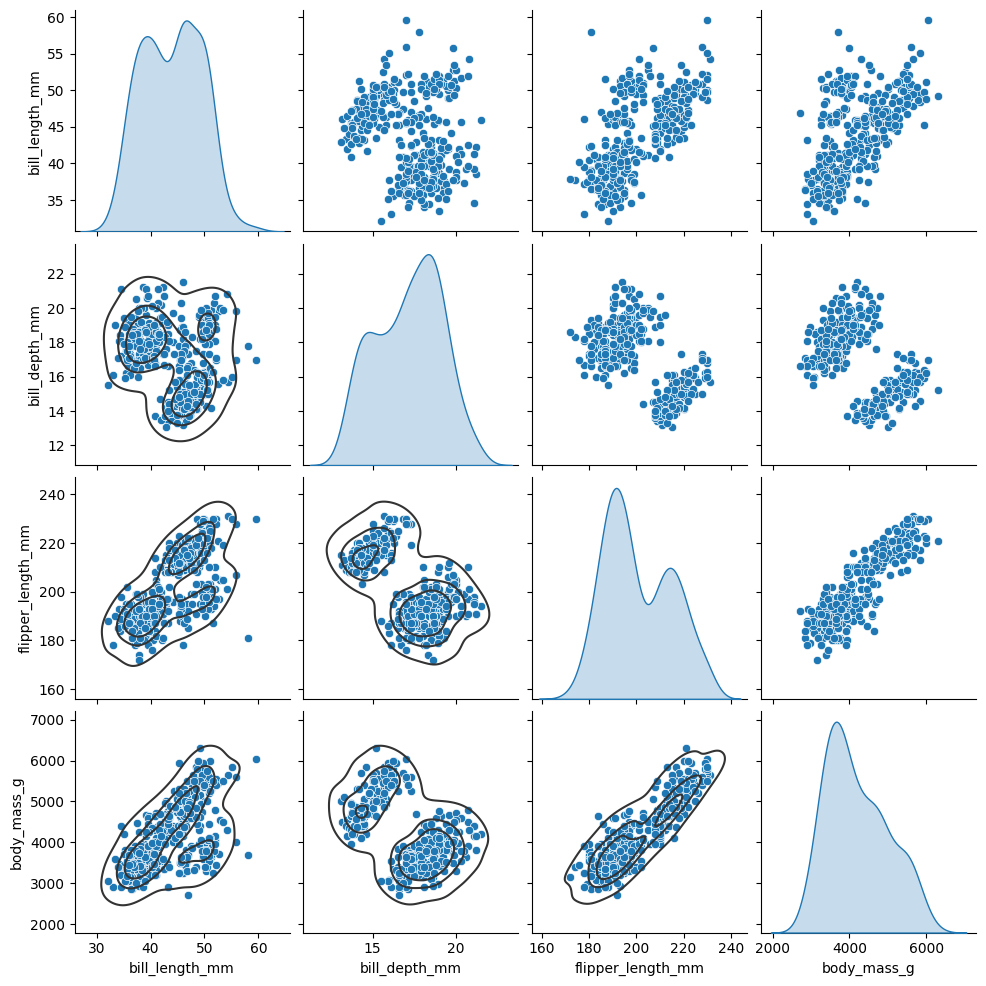

In [585]:
g = sns.pairplot(penguins, diag_kind='kde')
g.map_lower(sns.kdeplot, levels=4, color='.2')

#### sns.PairGrid

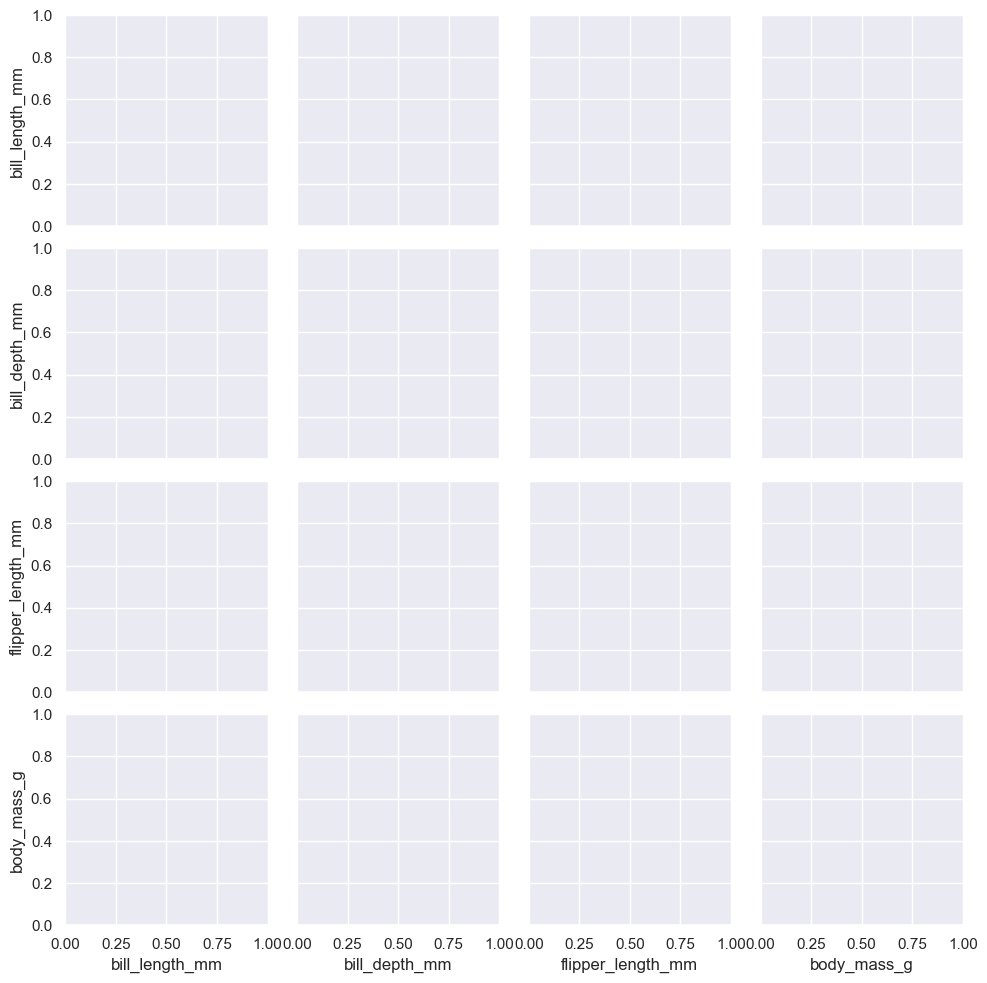

In [587]:
sns.set_theme()
g = sns.PairGrid(penguins)

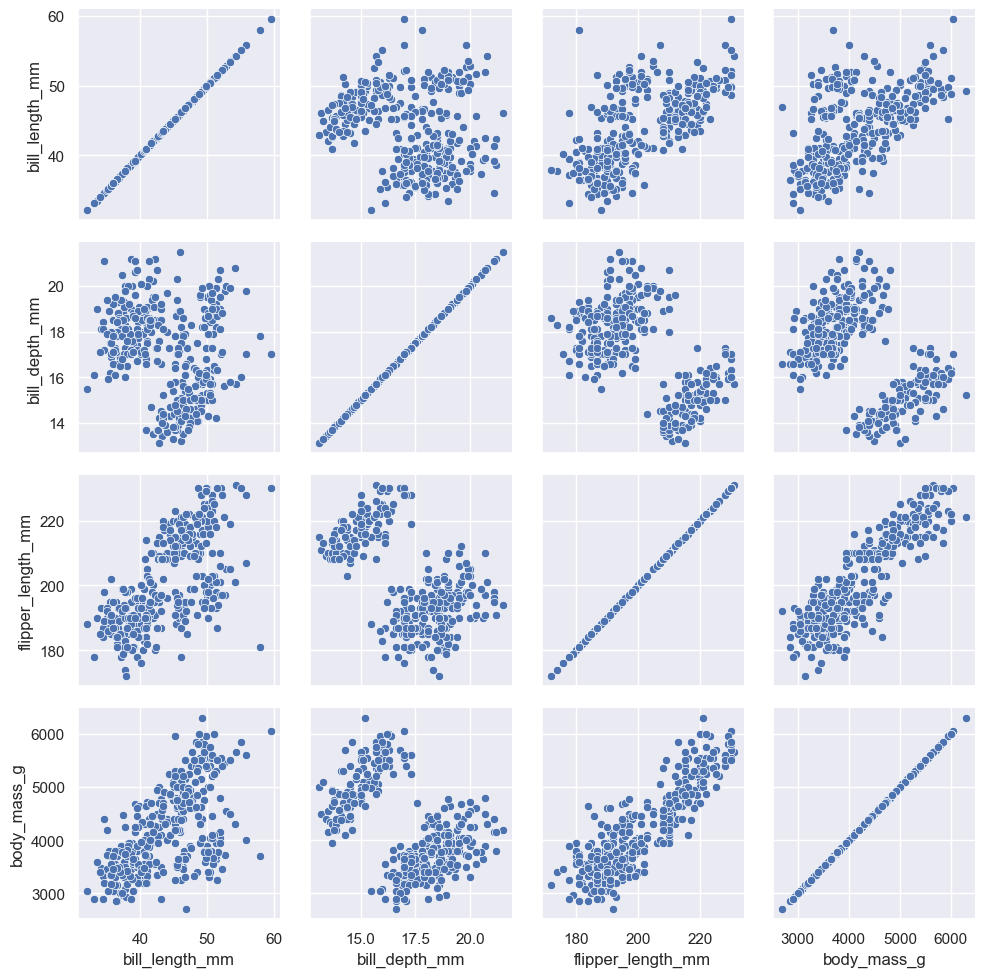

In [588]:
g = sns.PairGrid(penguins)
g.map(sns.scatterplot)

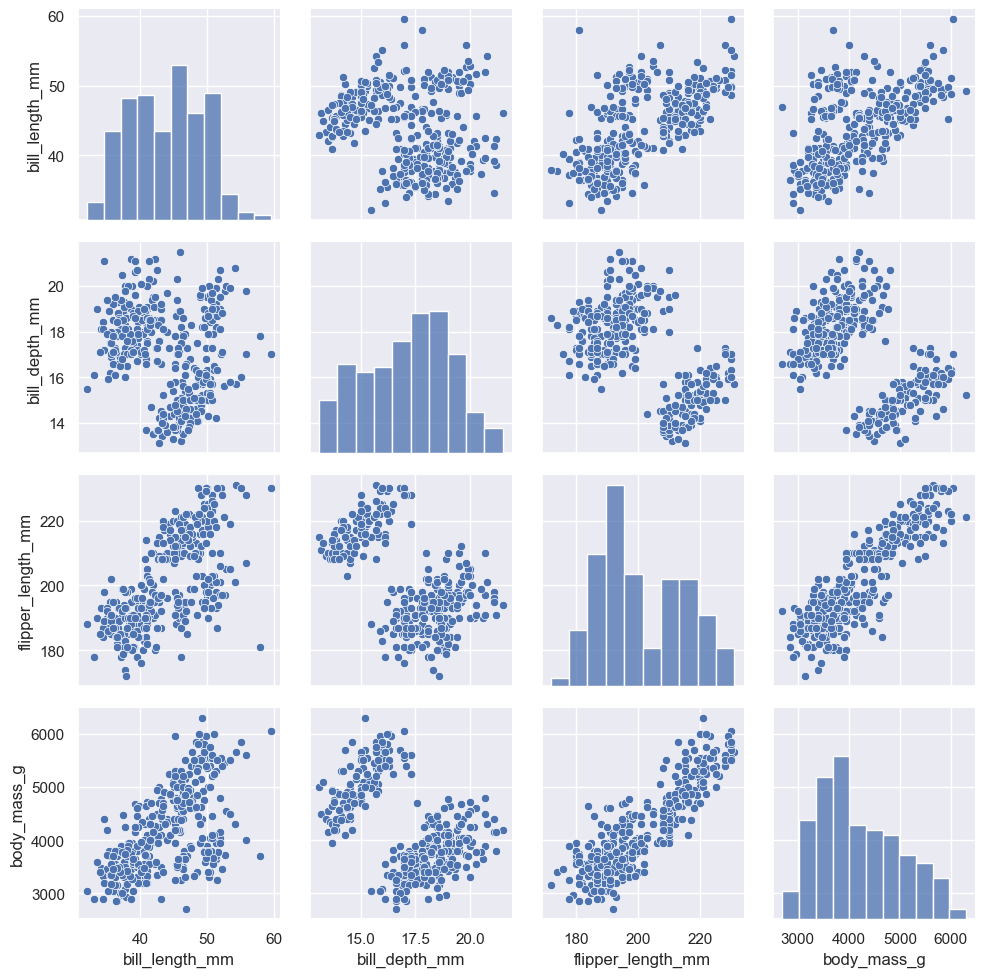

In [590]:
g = sns.PairGrid(penguins)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

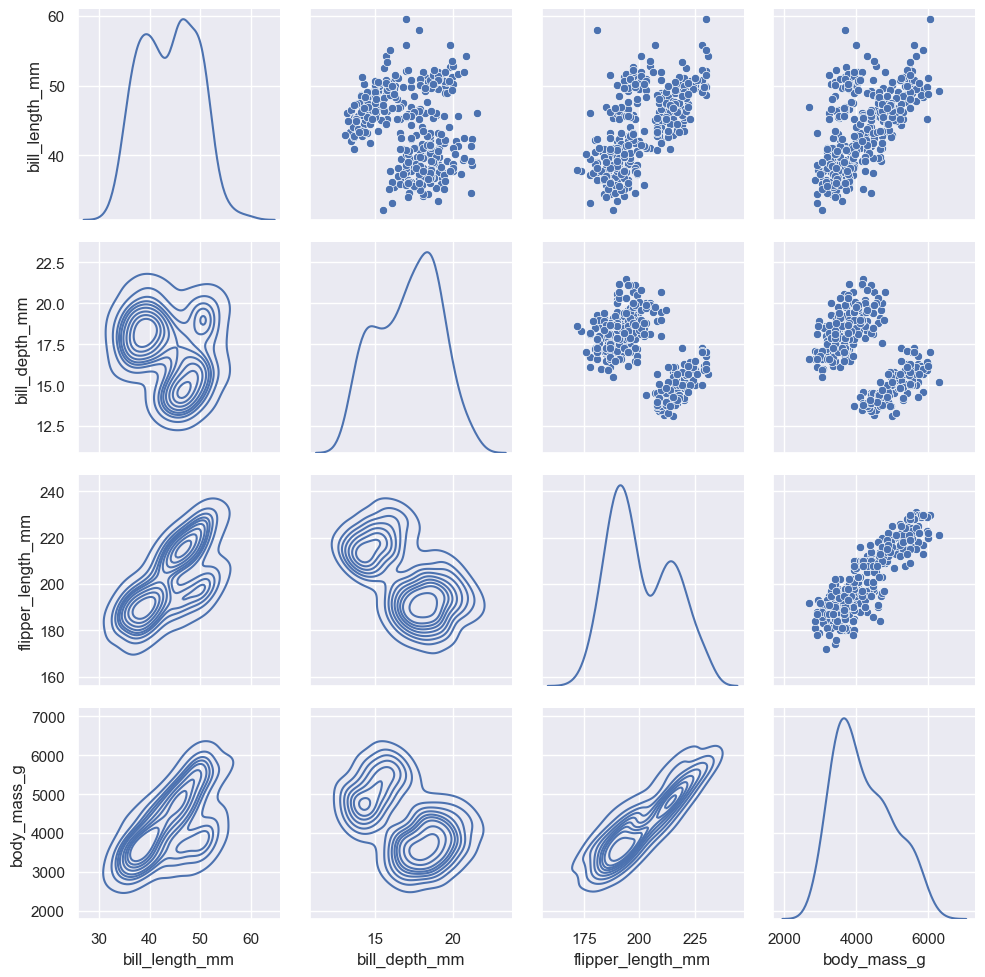

In [591]:
g = sns.PairGrid(penguins, diag_sharey=False)
g.map_upper(sns.scatterplot)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot)

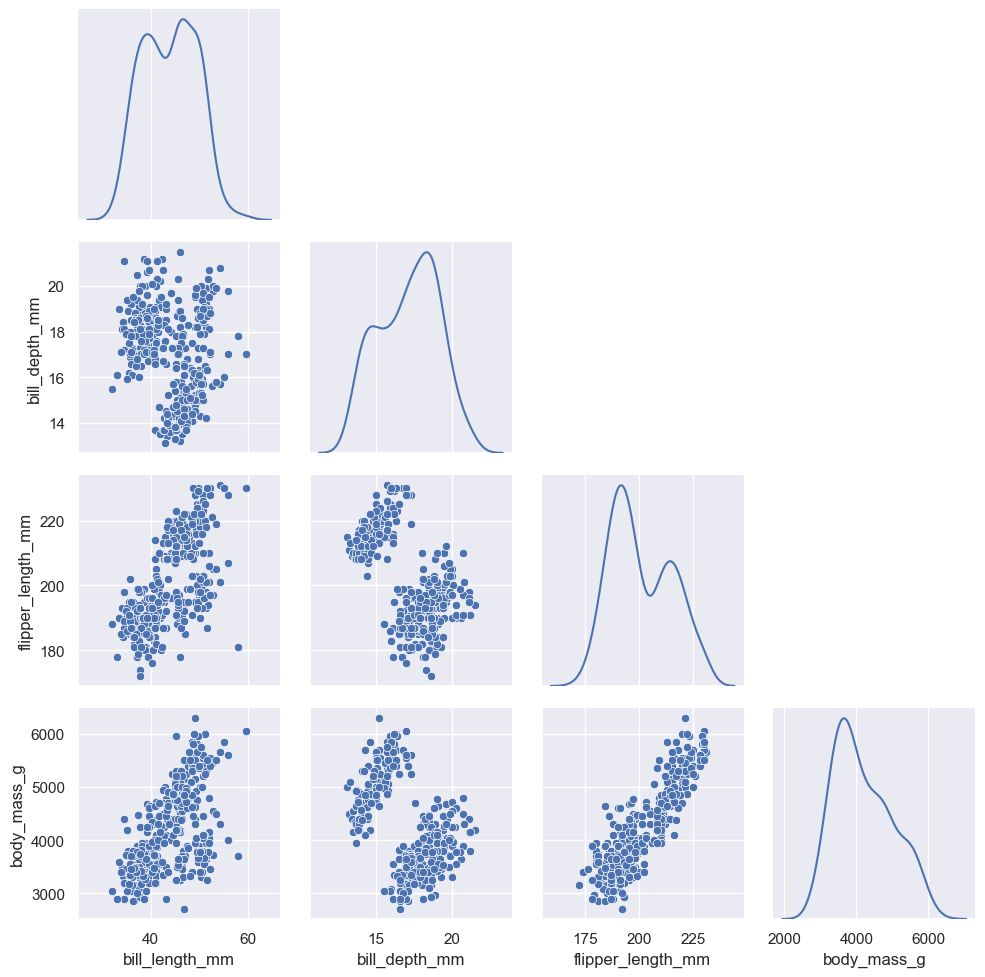

In [592]:
g = sns.PairGrid(penguins, diag_sharey=False, corner=True)
g.map_lower(sns.scatterplot)
g.map_diag(sns.kdeplot)

### Joint grids

#### sns.jointplot

#### sns.JointGrid

## Themeing

### sns.set_theme

### sns.axes_style

### sns.set_style

### sns.plotting_context

### sns.set_context

### sns.set_color_codes

### sns.reset_defaults

### sns.reset_orig

### sns.set

## Color palettes

### sns.set_palette

### sns.color_palette

### sns.husl_palette

### sns.hls_palette

### sns.cubehelix_palette

### sns.dark_palette

### sns.light_palette

### sns.diverging_palette

### sns.blend_palette

### sns.xkcd_palette

### sns.crayon_palette

### sns.mpl_palette

## Palette widgets

### sns.choose_colorbrewer_palette

### sns.choose_cubehelix_palette

### sns.choose_light_palette

### sns.choose_dark_palette

### sns.choose_diverging_palette

## Utility functions

### sns.despine

### sns.move_legend

### sns.saturate

### sns.desaturate

### sns.set_hls_values

### sns.load_dataset

### sns.get_dataset_names

### sns.get_data_home